In [1]:
import mujoco
import mediapy as media
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F 
import torch.autograd
from torch.autograd import Variable
import torch.optim as optim
import numpy as np
import gym
from collections import deque
import random
import sys
import pandas as pd
import matplotlib.pyplot as plt
from numpy import cos, sin
from gym import spaces
from gym.error import DependencyNotInstalled
from typing import Optional
from control.matlab import ss, lsim, linspace, c2d
from functools import partial
from state_estimation import Estimator
import math
import gym
from stable_baselines3 import PPO, SAC, TD3, DDPG, DQN, A2C
from stable_baselines3.common.env_checker import check_env

In [2]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [3]:
try:
    print('Checking that the installation succeeded:')
    import mujoco
    mujoco.MjModel.from_xml_string('<mujoco/>')
except Exception as e:
    raise e from RuntimeError(
      'Something went wrong during installation. Check the shell output above '
      'for more information.\n'
      'If using a hosted Colab runtime, make sure you enable GPU acceleration '
      'by going to the Runtime menu and selecting "Choose runtime type".')

print('Installation successful.')

Checking that the installation succeeded:
Installation successful.


In [4]:
with open('swimmer.xml', 'r',encoding='UTF-8') as f:
    xml = f.read()

In [5]:
model = mujoco.MjModel.from_xml_string(xml)
data = mujoco.MjData(model)
mujoco.mj_forward(model, data)

In [6]:
for key in range(model.nkey):
    mujoco.mj_resetDataKeyframe(model, data, key)
    mujoco.mj_forward(model, data)

In [16]:
class SwimmerEnv(gym.Env):
    """Custom Environment that follows gym interface."""

    metadata = {"render.modes": ["human"]}

    def __init__(self, render_mode: Optional[str] = None, g=10.0):
        super(SwimmerEnv).__init__()
        # Define action and observation space
        # They must be gym.spaces objects
        # Example when using discrete actions:
        ob_high = np.ones(10)
        action_high = np.ones(2)
        self.action_space = spaces.Box(low=-action_high, high=action_high, dtype=np.float32)
        self.observation_space = spaces.Box(low=-ob_high, high=ob_high, dtype=np.float32)
        self.step_const = 30
        self.freq = 0.1
        self.steps = 0
        self.center = [0.9,0,0,0,0,0,0,0,0,0]
        self.obstacle = [0,0.6,0,0,0,0,0,0,0,0]
        self.reward_cache = [] # cache distances to target norm ball center
        self.final_reward_cache = [] # cache final reward
        self.state = np.random.rand(10)*2-1
        self.target_norm_radius = 0.8
        self.max_reward_list = []
        self.quality_list = []
        self.total_steps = 0
        self.step_history = []
        self.reset_noise_scale = 0.2
        self.mod = mujoco.MjModel.from_xml_string(xml)
        self.data = mujoco.MjData(self.mod)
        self.init_qpos = self.data.qpos.ravel().copy()
        self.init_qvel = self.data.qvel.ravel().copy()
        self.safe_norm_radius = 0.2
        self.k = 20
    def step(self, action):
        terminated = False
        self.data.ctrl = action
        mujoco.mj_step(self.mod, self.data)
        self.state = self._get_obs()
        dist = np.linalg.norm(self.state - self.center)
        obs_dist = np.linalg.norm(self.state - self.obstacle)
        reward = self.target_norm_radius - dist
        self.reward_cache.append(reward)
        self.steps += 1
        self.total_steps +=1 
        # quantitative semantics
        # reach reward, encourage reaching target
        if self.steps < 10:
            reach_reward = max(self.reward_cache)
        else:
            reach_reward = max(self.reward_cache[-10:])
        final_reward = reach_reward

        if dist <= self.target_norm_radius:
            final_reward = 10
        self.final_reward_cache.append(final_reward)
        if self.steps == self.step_const or max(np.absolute(self.state))>2 or obs_dist<=self.safe_norm_radius:
            self.max_reward_list.append(max(self.final_reward_cache)) # use max final reward to measure episodes
            self.step_history.append(self.total_steps)
            self.quality_list.append(sum(self.final_reward_cache))
            terminated = True
            self.reset()

        # Return next state, reward, done, info
        return self.state, final_reward, terminated, {}

    def reset(self):
        self.steps = 0
        self.reward_cache = []
        self.step_const = self.k
        self.final_reward_cache = []
        noise_low = -self.reset_noise_scale
        noise_high = self.reset_noise_scale

        qpos = self.init_qpos + np.random.uniform(
            low=noise_low, high=noise_high, size=self.mod.nq
        )
        qvel = self.init_qvel + np.random.uniform(
            low=noise_low, high=noise_high, size=self.mod.nv
        )
        self.data.qpos[:] = np.copy(qpos)
        self.data.qvel[:] = np.copy(qvel)
        mujoco.mj_forward(self.mod, self.data)
        return self._get_obs()  # reward, done, info can't be included
    def _get_obs(self):
        position = self.data.qpos.flat.copy()
        velocity = self.data.qvel.flat.copy()
        observation = np.concatenate([position, velocity]).ravel()
        return observation
    def render(self, mode="human"):
        return

    def close(self):
        if self.screen is not None:
            import pygame
            pygame.display.quit()
            pygame.quit()
            self.isopen = False

In [17]:
# Training
reached = []
for k in [20,40,80,160]:
    env = SwimmerEnv()
    env.k = k
    print('Start training with PPO ...')
    # learning_rate = 1e-3, n_steps = 1024, tune these
    model = SAC("MlpPolicy", env, verbose=1)
    model.learn(total_timesteps=300000, progress_bar=False)
    vec_env = model.get_env()
    obs = vec_env.reset()
    # Test 50 traces
    env = SwimmerEnv()
    env.k = 160
    state = env.reset()
    dims0 = []
    dims1 = []
    dims2 = []
    euclids = []
    center = [0.9,0,0,0,0,0,0,0,0,0]
    obstacle = [0,0.6,0,0,0,0,0,0,0,0]
    num_reached = 0
    for j in range(1000):
        dim0 = []
        dim1 = []
        dim2 = []
        euclid = []
        state = env.reset()
        # Print initial state
        for i in range(30):
            action, _states = model.predict(state, deterministic=True)
            new_state, reward, done, _ = env.step(action)
            dist = np.linalg.norm(new_state-center)
            obs_dist = np.linalg.norm(new_state-obstacle)
            euclid.append(dist)
            state = new_state
            if obs_dist <=0.2:
                break
            if dist <= 0.8: # stop
                num_reached += 1
                break
        dims0.append(dim0)
        dims1.append(dim1)
        dims2.append(dim2)
        euclids.append(euclid)
#     print("Total number reached = " + str(num_reached))
    reached.append(num_reached)

Start training with PPO ...
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 2.49     |
| time/              |          |
|    episodes        | 4        |
|    fps             | 3597     |
|    time_elapsed    | 0        |
|    total_timesteps | 61       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | -1.12    |
| time/              |          |
|    episodes        | 8        |
|    fps             | 335      |
|    time_elapsed    | 0        |
|    total_timesteps | 133      |
| train/             |          |
|    actor_loss      | -2.55    |
|    critic_loss     | 4.42     |
|    ent_coef        | 0.991    |
|    ent_coef_loss   | -0.0314  |
|    learning_rate   | 0.0003   |
|    n_updates       | 32   

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | -0.914   |
| time/              |          |
|    episodes        | 64       |
|    fps             | 84       |
|    time_elapsed    | 14       |
|    total_timesteps | 1247     |
| train/             |          |
|    actor_loss      | -5.49    |
|    critic_loss     | 1.37     |
|    ent_coef        | 0.715    |
|    ent_coef_loss   | -0.969   |
|    learning_rate   | 0.0003   |
|    n_updates       | 1146     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | -1.1     |
| time/              |          |
|    episodes        | 68       |
|    fps             | 83       |
|    time_elapsed    | 15       |
|    total_timesteps | 1327     |
| train/             |          |
|    actor_loss      | -5.8     |
|    critic_loss     | 1.84     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 0.648    |
| time/              |          |
|    episodes        | 124      |
|    fps             | 67       |
|    time_elapsed    | 36       |
|    total_timesteps | 2447     |
| train/             |          |
|    actor_loss      | -6.93    |
|    critic_loss     | 3.51     |
|    ent_coef        | 0.51     |
|    ent_coef_loss   | -1.9     |
|    learning_rate   | 0.0003   |
|    n_updates       | 2346     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 0.701    |
| time/              |          |
|    episodes        | 128      |
|    fps             | 66       |
|    time_elapsed    | 38       |
|    total_timesteps | 2527     |
| train/             |          |
|    actor_loss      | -7.16    |
|    critic_loss     | 3.85     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 2.57     |
| time/              |          |
|    episodes        | 184      |
|    fps             | 62       |
|    time_elapsed    | 58       |
|    total_timesteps | 3647     |
| train/             |          |
|    actor_loss      | -9.02    |
|    critic_loss     | 6.01     |
|    ent_coef        | 0.365    |
|    ent_coef_loss   | -2.47    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3546     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 2.28     |
| time/              |          |
|    episodes        | 188      |
|    fps             | 62       |
|    time_elapsed    | 60       |
|    total_timesteps | 3727     |
| train/             |          |
|    actor_loss      | -8.5     |
|    critic_loss     | 4.26     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    episodes        | 244      |
|    fps             | 59       |
|    time_elapsed    | 81       |
|    total_timesteps | 4847     |
| train/             |          |
|    actor_loss      | -8.31    |
|    critic_loss     | 7.04     |
|    ent_coef        | 0.26     |
|    ent_coef_loss   | -3.18    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4746     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20       |
|    ep_rew_mean     | 6.74     |
| time/              |          |
|    episodes        | 248      |
|    fps             | 59       |
|    time_elapsed    | 82       |
|    total_timesteps | 4927     |
| train/             |          |
|    actor_loss      | -9.16    |
|    critic_loss     | 14.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 304      |
|    fps             | 58       |
|    time_elapsed    | 102      |
|    total_timesteps | 6024     |
| train/             |          |
|    actor_loss      | -9.04    |
|    critic_loss     | 30.7     |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -3.82    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5923     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 9.91     |
| time/              |          |
|    episodes        | 308      |
|    fps             | 58       |
|    time_elapsed    | 104      |
|    total_timesteps | 6104     |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 4.77     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.7     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 364      |
|    fps             | 57       |
|    time_elapsed    | 124      |
|    total_timesteps | 7202     |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 6.48     |
|    ent_coef        | 0.136    |
|    ent_coef_loss   | -4.05    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7101     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 368      |
|    fps             | 57       |
|    time_elapsed    | 126      |
|    total_timesteps | 7276     |
| train/             |          |
|    actor_loss      | -8.09    |
|    critic_loss     | 13.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.9     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 424      |
|    fps             | 57       |
|    time_elapsed    | 145      |
|    total_timesteps | 8296     |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 29.4     |
|    ent_coef        | 0.104    |
|    ent_coef_loss   | -3.58    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8195     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.8     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 428      |
|    fps             | 57       |
|    time_elapsed    | 146      |
|    total_timesteps | 8364     |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.2     |
|    ep_rew_mean     | 6.36     |
| time/              |          |
|    episodes        | 484      |
|    fps             | 55       |
|    time_elapsed    | 169      |
|    total_timesteps | 9390     |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0805   |
|    ent_coef_loss   | -2.67    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9289     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.1     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 488      |
|    fps             | 55       |
|    time_elapsed    | 171      |
|    total_timesteps | 9460     |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | -0.803   |
| time/              |          |
|    episodes        | 544      |
|    fps             | 52       |
|    time_elapsed    | 199      |
|    total_timesteps | 10515    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 30.2     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | -1.85    |
|    learning_rate   | 0.0003   |
|    n_updates       | 10414    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 0.852    |
| time/              |          |
|    episodes        | 548      |
|    fps             | 52       |
|    time_elapsed    | 200      |
|    total_timesteps | 10595    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 83       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19       |
|    ep_rew_mean     | 5.03     |
| time/              |          |
|    episodes        | 604      |
|    fps             | 50       |
|    time_elapsed    | 229      |
|    total_timesteps | 11669    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 46.4     |
|    ent_coef        | 0.0515   |
|    ent_coef_loss   | -0.439   |
|    learning_rate   | 0.0003   |
|    n_updates       | 11568    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19       |
|    ep_rew_mean     | 3.73     |
| time/              |          |
|    episodes        | 608      |
|    fps             | 50       |
|    time_elapsed    | 231      |
|    total_timesteps | 11749    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 35.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.7     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 664      |
|    fps             | 49       |
|    time_elapsed    | 260      |
|    total_timesteps | 12852    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 41.9     |
|    ent_coef        | 0.0451   |
|    ent_coef_loss   | -0.143   |
|    learning_rate   | 0.0003   |
|    n_updates       | 12751    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 668      |
|    fps             | 49       |
|    time_elapsed    | 262      |
|    total_timesteps | 12932    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 11.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 2.86     |
| time/              |          |
|    episodes        | 724      |
|    fps             | 47       |
|    time_elapsed    | 293      |
|    total_timesteps | 14045    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 27.4     |
|    ent_coef        | 0.0411   |
|    ent_coef_loss   | -0.0168  |
|    learning_rate   | 0.0003   |
|    n_updates       | 13944    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 2.84     |
| time/              |          |
|    episodes        | 728      |
|    fps             | 47       |
|    time_elapsed    | 296      |
|    total_timesteps | 14125    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 5.43     |
| time/              |          |
|    episodes        | 784      |
|    fps             | 46       |
|    time_elapsed    | 324      |
|    total_timesteps | 15224    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 32.4     |
|    ent_coef        | 0.0393   |
|    ent_coef_loss   | -0.0125  |
|    learning_rate   | 0.0003   |
|    n_updates       | 15123    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.8     |
|    ep_rew_mean     | 5.52     |
| time/              |          |
|    episodes        | 788      |
|    fps             | 46       |
|    time_elapsed    | 326      |
|    total_timesteps | 15304    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 62.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | 2.56     |
| time/              |          |
|    episodes        | 844      |
|    fps             | 46       |
|    time_elapsed    | 355      |
|    total_timesteps | 16407    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0395   |
|    ent_coef_loss   | -0.495   |
|    learning_rate   | 0.0003   |
|    n_updates       | 16306    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | 2.45     |
| time/              |          |
|    episodes        | 848      |
|    fps             | 46       |
|    time_elapsed    | 357      |
|    total_timesteps | 16487    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 32.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.1     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 904      |
|    fps             | 44       |
|    time_elapsed    | 392      |
|    total_timesteps | 17536    |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0472   |
|    ent_coef_loss   | 0.611    |
|    learning_rate   | 0.0003   |
|    n_updates       | 17435    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.9     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 908      |
|    fps             | 44       |
|    time_elapsed    | 394      |
|    total_timesteps | 17598    |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 27.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 3.71     |
| time/              |          |
|    episodes        | 964      |
|    fps             | 43       |
|    time_elapsed    | 430      |
|    total_timesteps | 18565    |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 146      |
|    ent_coef        | 0.0556   |
|    ent_coef_loss   | 1.32     |
|    learning_rate   | 0.0003   |
|    n_updates       | 18464    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 2.52     |
| time/              |          |
|    episodes        | 968      |
|    fps             | 43       |
|    time_elapsed    | 432      |
|    total_timesteps | 18645    |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 209      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 1024     |
|    fps             | 41       |
|    time_elapsed    | 471      |
|    total_timesteps | 19719    |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 182      |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | 0.0983   |
|    learning_rate   | 0.0003   |
|    n_updates       | 19618    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    episodes        | 1028     |
|    fps             | 41       |
|    time_elapsed    | 474      |
|    total_timesteps | 19799    |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 82.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 3        |
| time/              |          |
|    episodes        | 1084     |
|    fps             | 40       |
|    time_elapsed    | 510      |
|    total_timesteps | 20800    |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0545   |
|    ent_coef_loss   | -0.461   |
|    learning_rate   | 0.0003   |
|    n_updates       | 20699    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 3.11     |
| time/              |          |
|    episodes        | 1088     |
|    fps             | 40       |
|    time_elapsed    | 513      |
|    total_timesteps | 20868    |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 61.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.7     |
|    ep_rew_mean     | 0.853    |
| time/              |          |
|    episodes        | 1144     |
|    fps             | 39       |
|    time_elapsed    | 550      |
|    total_timesteps | 21860    |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 255      |
|    ent_coef        | 0.0516   |
|    ent_coef_loss   | 0.0713   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21759    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 0.883    |
| time/              |          |
|    episodes        | 1148     |
|    fps             | 39       |
|    time_elapsed    | 553      |
|    total_timesteps | 21940    |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 20.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    episodes        | 1204     |
|    fps             | 38       |
|    time_elapsed    | 595      |
|    total_timesteps | 23007    |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 138      |
|    ent_coef        | 0.05     |
|    ent_coef_loss   | 1.47     |
|    learning_rate   | 0.0003   |
|    n_updates       | 22906    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 1208     |
|    fps             | 38       |
|    time_elapsed    | 598      |
|    total_timesteps | 23075    |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 48.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.6     |
|    ep_rew_mean     | 4.16     |
| time/              |          |
|    episodes        | 1264     |
|    fps             | 37       |
|    time_elapsed    | 637      |
|    total_timesteps | 24095    |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 46.2     |
|    ent_coef        | 0.0516   |
|    ent_coef_loss   | -0.71    |
|    learning_rate   | 0.0003   |
|    n_updates       | 23994    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 3.48     |
| time/              |          |
|    episodes        | 1268     |
|    fps             | 37       |
|    time_elapsed    | 640      |
|    total_timesteps | 24162    |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 86.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.4     |
|    ep_rew_mean     | 2.88     |
| time/              |          |
|    episodes        | 1324     |
|    fps             | 36       |
|    time_elapsed    | 678      |
|    total_timesteps | 25098    |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 141      |
|    ent_coef        | 0.0567   |
|    ent_coef_loss   | 0.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 24997    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 1.47     |
| time/              |          |
|    episodes        | 1328     |
|    fps             | 36       |
|    time_elapsed    | 680      |
|    total_timesteps | 25163    |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 167      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 6.49     |
| time/              |          |
|    episodes        | 1384     |
|    fps             | 36       |
|    time_elapsed    | 713      |
|    total_timesteps | 26059    |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.0606   |
|    ent_coef_loss   | -0.527   |
|    learning_rate   | 0.0003   |
|    n_updates       | 25958    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 5.4      |
| time/              |          |
|    episodes        | 1388     |
|    fps             | 36       |
|    time_elapsed    | 715      |
|    total_timesteps | 26124    |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 264      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 1444     |
|    fps             | 36       |
|    time_elapsed    | 750      |
|    total_timesteps | 27048    |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 154      |
|    ent_coef        | 0.0606   |
|    ent_coef_loss   | 0.746    |
|    learning_rate   | 0.0003   |
|    n_updates       | 26947    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 4.29     |
| time/              |          |
|    episodes        | 1448     |
|    fps             | 36       |
|    time_elapsed    | 752      |
|    total_timesteps | 27114    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 239      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 8.13     |
| time/              |          |
|    episodes        | 1504     |
|    fps             | 35       |
|    time_elapsed    | 789      |
|    total_timesteps | 28013    |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 74.8     |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 0.475    |
|    learning_rate   | 0.0003   |
|    n_updates       | 27912    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 1508     |
|    fps             | 35       |
|    time_elapsed    | 791      |
|    total_timesteps | 28074    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 374      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 1564     |
|    fps             | 35       |
|    time_elapsed    | 823      |
|    total_timesteps | 28929    |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 21.1     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 28828    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 1568     |
|    fps             | 35       |
|    time_elapsed    | 825      |
|    total_timesteps | 28999    |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 85       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 1624     |
|    fps             | 34       |
|    time_elapsed    | 857      |
|    total_timesteps | 29875    |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 55.3     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.0397   |
|    learning_rate   | 0.0003   |
|    n_updates       | 29774    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 1628     |
|    fps             | 34       |
|    time_elapsed    | 859      |
|    total_timesteps | 29933    |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 73.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 3.74     |
| time/              |          |
|    episodes        | 1684     |
|    fps             | 34       |
|    time_elapsed    | 890      |
|    total_timesteps | 30768    |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 36.7     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.347   |
|    learning_rate   | 0.0003   |
|    n_updates       | 30667    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 3.61     |
| time/              |          |
|    episodes        | 1688     |
|    fps             | 34       |
|    time_elapsed    | 892      |
|    total_timesteps | 30827    |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 3.67     |
| time/              |          |
|    episodes        | 1744     |
|    fps             | 34       |
|    time_elapsed    | 923      |
|    total_timesteps | 31676    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 52.9     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.731   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31575    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 3.63     |
| time/              |          |
|    episodes        | 1748     |
|    fps             | 34       |
|    time_elapsed    | 925      |
|    total_timesteps | 31730    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 306      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    episodes        | 1804     |
|    fps             | 34       |
|    time_elapsed    | 955      |
|    total_timesteps | 32539    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.519   |
|    learning_rate   | 0.0003   |
|    n_updates       | 32438    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 1808     |
|    fps             | 34       |
|    time_elapsed    | 958      |
|    total_timesteps | 32604    |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 202      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 1864     |
|    fps             | 33       |
|    time_elapsed    | 989      |
|    total_timesteps | 33446    |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 85.8     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33345    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 4.61     |
| time/              |          |
|    episodes        | 1868     |
|    fps             | 33       |
|    time_elapsed    | 991      |
|    total_timesteps | 33503    |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 1924     |
|    fps             | 33       |
|    time_elapsed    | 1024     |
|    total_timesteps | 34382    |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 75       |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.0258  |
|    learning_rate   | 0.0003   |
|    n_updates       | 34281    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 1928     |
|    fps             | 33       |
|    time_elapsed    | 1026     |
|    total_timesteps | 34440    |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 56.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 7.27     |
| time/              |          |
|    episodes        | 1984     |
|    fps             | 33       |
|    time_elapsed    | 1053     |
|    total_timesteps | 35190    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.247    |
|    learning_rate   | 0.0003   |
|    n_updates       | 35089    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 1988     |
|    fps             | 33       |
|    time_elapsed    | 1056     |
|    total_timesteps | 35248    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 30.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    episodes        | 2044     |
|    fps             | 33       |
|    time_elapsed    | 1083     |
|    total_timesteps | 36003    |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 110      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.556   |
|    learning_rate   | 0.0003   |
|    n_updates       | 35902    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 3.98     |
| time/              |          |
|    episodes        | 2048     |
|    fps             | 33       |
|    time_elapsed    | 1086     |
|    total_timesteps | 36071    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 4.06     |
| time/              |          |
|    episodes        | 2104     |
|    fps             | 33       |
|    time_elapsed    | 1116     |
|    total_timesteps | 36838    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 201      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.829   |
|    learning_rate   | 0.0003   |
|    n_updates       | 36737    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 4.08     |
| time/              |          |
|    episodes        | 2108     |
|    fps             | 32       |
|    time_elapsed    | 1118     |
|    total_timesteps | 36894    |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 57.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 7.53     |
| time/              |          |
|    episodes        | 2164     |
|    fps             | 32       |
|    time_elapsed    | 1146     |
|    total_timesteps | 37665    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 26.3     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.3      |
|    learning_rate   | 0.0003   |
|    n_updates       | 37564    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 9.59     |
| time/              |          |
|    episodes        | 2168     |
|    fps             | 32       |
|    time_elapsed    | 1148     |
|    total_timesteps | 37732    |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 45.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 2224     |
|    fps             | 32       |
|    time_elapsed    | 1176     |
|    total_timesteps | 38462    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 367      |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.81    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38361    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 2228     |
|    fps             | 32       |
|    time_elapsed    | 1178     |
|    total_timesteps | 38514    |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 58.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 2284     |
|    fps             | 32       |
|    time_elapsed    | 1207     |
|    total_timesteps | 39300    |
| train/             |          |
|    actor_loss      | -19.2    |
|    critic_loss     | 27       |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | 0.158    |
|    learning_rate   | 0.0003   |
|    n_updates       | 39199    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    episodes        | 2288     |
|    fps             | 32       |
|    time_elapsed    | 1209     |
|    total_timesteps | 39335    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 2344     |
|    fps             | 32       |
|    time_elapsed    | 1239     |
|    total_timesteps | 40164    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 96.7     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.0461   |
|    learning_rate   | 0.0003   |
|    n_updates       | 40063    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    episodes        | 2348     |
|    fps             | 32       |
|    time_elapsed    | 1241     |
|    total_timesteps | 40204    |
| train/             |          |
|    actor_loss      | -20.1    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 4.96     |
| time/              |          |
|    episodes        | 2404     |
|    fps             | 32       |
|    time_elapsed    | 1267     |
|    total_timesteps | 40899    |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0746   |
|    ent_coef_loss   | 0.471    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40798    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 4.04     |
| time/              |          |
|    episodes        | 2408     |
|    fps             | 32       |
|    time_elapsed    | 1268     |
|    total_timesteps | 40941    |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 3.24     |
| time/              |          |
|    episodes        | 2464     |
|    fps             | 32       |
|    time_elapsed    | 1293     |
|    total_timesteps | 41603    |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 166      |
|    ent_coef        | 0.0755   |
|    ent_coef_loss   | 0.513    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41502    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 3.53     |
| time/              |          |
|    episodes        | 2468     |
|    fps             | 32       |
|    time_elapsed    | 1295     |
|    total_timesteps | 41655    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 11.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 2524     |
|    fps             | 32       |
|    time_elapsed    | 1323     |
|    total_timesteps | 42415    |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 182      |
|    ent_coef        | 0.0762   |
|    ent_coef_loss   | -0.0774  |
|    learning_rate   | 0.0003   |
|    n_updates       | 42314    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 2528     |
|    fps             | 32       |
|    time_elapsed    | 1325     |
|    total_timesteps | 42469    |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    episodes        | 2584     |
|    fps             | 31       |
|    time_elapsed    | 1350     |
|    total_timesteps | 43145    |
| train/             |          |
|    actor_loss      | -18.8    |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.0771   |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43044    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 2588     |
|    fps             | 31       |
|    time_elapsed    | 1353     |
|    total_timesteps | 43211    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 2644     |
|    fps             | 31       |
|    time_elapsed    | 1376     |
|    total_timesteps | 43840    |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 204      |
|    ent_coef        | 0.0753   |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43739    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 2648     |
|    fps             | 31       |
|    time_elapsed    | 1378     |
|    total_timesteps | 43894    |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 26       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 2704     |
|    fps             | 31       |
|    time_elapsed    | 1401     |
|    total_timesteps | 44572    |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 208      |
|    ent_coef        | 0.0784   |
|    ent_coef_loss   | 0.315    |
|    learning_rate   | 0.0003   |
|    n_updates       | 44471    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 2708     |
|    fps             | 31       |
|    time_elapsed    | 1403     |
|    total_timesteps | 44631    |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 18.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 2764     |
|    fps             | 31       |
|    time_elapsed    | 1431     |
|    total_timesteps | 45385    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 200      |
|    ent_coef        | 0.0748   |
|    ent_coef_loss   | -0.605   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45284    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 2768     |
|    fps             | 31       |
|    time_elapsed    | 1433     |
|    total_timesteps | 45438    |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 2824     |
|    fps             | 31       |
|    time_elapsed    | 1456     |
|    total_timesteps | 46090    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0766   |
|    ent_coef_loss   | 0.512    |
|    learning_rate   | 0.0003   |
|    n_updates       | 45989    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 2828     |
|    fps             | 31       |
|    time_elapsed    | 1459     |
|    total_timesteps | 46156    |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 3.8      |
| time/              |          |
|    episodes        | 2884     |
|    fps             | 31       |
|    time_elapsed    | 1484     |
|    total_timesteps | 46849    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 126      |
|    ent_coef        | 0.0753   |
|    ent_coef_loss   | 0.569    |
|    learning_rate   | 0.0003   |
|    n_updates       | 46748    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 3.83     |
| time/              |          |
|    episodes        | 2888     |
|    fps             | 31       |
|    time_elapsed    | 1485     |
|    total_timesteps | 46891    |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 30.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 7.14     |
| time/              |          |
|    episodes        | 2944     |
|    fps             | 31       |
|    time_elapsed    | 1510     |
|    total_timesteps | 47546    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 152      |
|    ent_coef        | 0.0772   |
|    ent_coef_loss   | -0.138   |
|    learning_rate   | 0.0003   |
|    n_updates       | 47445    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    episodes        | 2948     |
|    fps             | 31       |
|    time_elapsed    | 1512     |
|    total_timesteps | 47606    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 65.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 3004     |
|    fps             | 31       |
|    time_elapsed    | 1539     |
|    total_timesteps | 48334    |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0778   |
|    ent_coef_loss   | 0.259    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48233    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 3008     |
|    fps             | 31       |
|    time_elapsed    | 1542     |
|    total_timesteps | 48403    |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 3064     |
|    fps             | 31       |
|    time_elapsed    | 1567     |
|    total_timesteps | 49083    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 201      |
|    ent_coef        | 0.0761   |
|    ent_coef_loss   | -0.0898  |
|    learning_rate   | 0.0003   |
|    n_updates       | 48982    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 3068     |
|    fps             | 31       |
|    time_elapsed    | 1569     |
|    total_timesteps | 49140    |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 3124     |
|    fps             | 31       |
|    time_elapsed    | 1594     |
|    total_timesteps | 49791    |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 86       |
|    ent_coef        | 0.0783   |
|    ent_coef_loss   | -0.429   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49690    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 3128     |
|    fps             | 31       |
|    time_elapsed    | 1595     |
|    total_timesteps | 49831    |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 3184     |
|    fps             | 31       |
|    time_elapsed    | 1621     |
|    total_timesteps | 50508    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 65.9     |
|    ent_coef        | 0.0791   |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 50407    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 6.2      |
| time/              |          |
|    episodes        | 3188     |
|    fps             | 31       |
|    time_elapsed    | 1622     |
|    total_timesteps | 50551    |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 3244     |
|    fps             | 31       |
|    time_elapsed    | 1649     |
|    total_timesteps | 51279    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 179      |
|    ent_coef        | 0.0741   |
|    ent_coef_loss   | 0.3      |
|    learning_rate   | 0.0003   |
|    n_updates       | 51178    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 3248     |
|    fps             | 31       |
|    time_elapsed    | 1651     |
|    total_timesteps | 51344    |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 42.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 5.64     |
| time/              |          |
|    episodes        | 3304     |
|    fps             | 30       |
|    time_elapsed    | 1680     |
|    total_timesteps | 52076    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 52.9     |
|    ent_coef        | 0.0769   |
|    ent_coef_loss   | -0.368   |
|    learning_rate   | 0.0003   |
|    n_updates       | 51975    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 3308     |
|    fps             | 30       |
|    time_elapsed    | 1682     |
|    total_timesteps | 52140    |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 3364     |
|    fps             | 30       |
|    time_elapsed    | 1706     |
|    total_timesteps | 52781    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 127      |
|    ent_coef        | 0.0762   |
|    ent_coef_loss   | -0.354   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52680    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 8.2      |
| time/              |          |
|    episodes        | 3368     |
|    fps             | 30       |
|    time_elapsed    | 1708     |
|    total_timesteps | 52823    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 9.13     |
| time/              |          |
|    episodes        | 3424     |
|    fps             | 30       |
|    time_elapsed    | 1730     |
|    total_timesteps | 53434    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 32.3     |
|    ent_coef        | 0.0741   |
|    ent_coef_loss   | -0.486   |
|    learning_rate   | 0.0003   |
|    n_updates       | 53333    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 3428     |
|    fps             | 30       |
|    time_elapsed    | 1732     |
|    total_timesteps | 53491    |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 3484     |
|    fps             | 30       |
|    time_elapsed    | 1757     |
|    total_timesteps | 54160    |
| train/             |          |
|    actor_loss      | -17.8    |
|    critic_loss     | 13.3     |
|    ent_coef        | 0.0764   |
|    ent_coef_loss   | -0.382   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54059    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 3488     |
|    fps             | 30       |
|    time_elapsed    | 1758     |
|    total_timesteps | 54209    |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 74.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 3544     |
|    fps             | 30       |
|    time_elapsed    | 1786     |
|    total_timesteps | 54915    |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0765   |
|    ent_coef_loss   | -0.421   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54814    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 3548     |
|    fps             | 30       |
|    time_elapsed    | 1788     |
|    total_timesteps | 54977    |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 3604     |
|    fps             | 30       |
|    time_elapsed    | 1814     |
|    total_timesteps | 55669    |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 70.9     |
|    ent_coef        | 0.0785   |
|    ent_coef_loss   | -0.603   |
|    learning_rate   | 0.0003   |
|    n_updates       | 55568    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 3608     |
|    fps             | 30       |
|    time_elapsed    | 1817     |
|    total_timesteps | 55742    |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 81.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 3664     |
|    fps             | 30       |
|    time_elapsed    | 1840     |
|    total_timesteps | 56390    |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 46.6     |
|    ent_coef        | 0.0776   |
|    ent_coef_loss   | -0.122   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56289    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 3668     |
|    fps             | 30       |
|    time_elapsed    | 1842     |
|    total_timesteps | 56443    |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 3724     |
|    fps             | 30       |
|    time_elapsed    | 1869     |
|    total_timesteps | 57147    |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 237      |
|    ent_coef        | 0.0768   |
|    ent_coef_loss   | 0.343    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57046    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 3728     |
|    fps             | 30       |
|    time_elapsed    | 1871     |
|    total_timesteps | 57200    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 3784     |
|    fps             | 30       |
|    time_elapsed    | 1897     |
|    total_timesteps | 57890    |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 20.2     |
|    ent_coef        | 0.079    |
|    ent_coef_loss   | -0.799   |
|    learning_rate   | 0.0003   |
|    n_updates       | 57789    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 3788     |
|    fps             | 30       |
|    time_elapsed    | 1899     |
|    total_timesteps | 57944    |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 3844     |
|    fps             | 30       |
|    time_elapsed    | 1925     |
|    total_timesteps | 58627    |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0786   |
|    ent_coef_loss   | -0.209   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58526    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 3848     |
|    fps             | 30       |
|    time_elapsed    | 1926     |
|    total_timesteps | 58652    |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 382      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 3904     |
|    fps             | 30       |
|    time_elapsed    | 1955     |
|    total_timesteps | 59391    |
| train/             |          |
|    actor_loss      | -20.4    |
|    critic_loss     | 32.5     |
|    ent_coef        | 0.0751   |
|    ent_coef_loss   | 0.0886   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59290    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 3908     |
|    fps             | 30       |
|    time_elapsed    | 1957     |
|    total_timesteps | 59443    |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 151      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 3964     |
|    fps             | 30       |
|    time_elapsed    | 1981     |
|    total_timesteps | 60119    |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | -0.288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 60018    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 3968     |
|    fps             | 30       |
|    time_elapsed    | 1983     |
|    total_timesteps | 60185    |
| train/             |          |
|    actor_loss      | -19.9    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 4024     |
|    fps             | 30       |
|    time_elapsed    | 2007     |
|    total_timesteps | 60810    |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.076    |
|    ent_coef_loss   | 0.217    |
|    learning_rate   | 0.0003   |
|    n_updates       | 60709    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 4028     |
|    fps             | 30       |
|    time_elapsed    | 2009     |
|    total_timesteps | 60862    |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 4084     |
|    fps             | 30       |
|    time_elapsed    | 2037     |
|    total_timesteps | 61565    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 44.7     |
|    ent_coef        | 0.0754   |
|    ent_coef_loss   | -0.158   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61464    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 4088     |
|    fps             | 30       |
|    time_elapsed    | 2040     |
|    total_timesteps | 61642    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 74.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 4144     |
|    fps             | 30       |
|    time_elapsed    | 2065     |
|    total_timesteps | 62297    |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0776   |
|    ent_coef_loss   | -0.488   |
|    learning_rate   | 0.0003   |
|    n_updates       | 62196    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 4148     |
|    fps             | 30       |
|    time_elapsed    | 2066     |
|    total_timesteps | 62340    |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 12.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 4204     |
|    fps             | 30       |
|    time_elapsed    | 2095     |
|    total_timesteps | 63064    |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 192      |
|    ent_coef        | 0.0754   |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 62963    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 4208     |
|    fps             | 30       |
|    time_elapsed    | 2097     |
|    total_timesteps | 63106    |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 20.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 4264     |
|    fps             | 30       |
|    time_elapsed    | 2124     |
|    total_timesteps | 63800    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0777   |
|    ent_coef_loss   | -0.211   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63699    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 4268     |
|    fps             | 30       |
|    time_elapsed    | 2125     |
|    total_timesteps | 63839    |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 74.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 4324     |
|    fps             | 29       |
|    time_elapsed    | 2148     |
|    total_timesteps | 64433    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 67.2     |
|    ent_coef        | 0.0793   |
|    ent_coef_loss   | 0.656    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64332    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 4328     |
|    fps             | 29       |
|    time_elapsed    | 2150     |
|    total_timesteps | 64503    |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 4384     |
|    fps             | 29       |
|    time_elapsed    | 2173     |
|    total_timesteps | 65077    |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 56.7     |
|    ent_coef        | 0.076    |
|    ent_coef_loss   | -0.104   |
|    learning_rate   | 0.0003   |
|    n_updates       | 64976    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 4388     |
|    fps             | 29       |
|    time_elapsed    | 2175     |
|    total_timesteps | 65128    |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 97.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 4444     |
|    fps             | 29       |
|    time_elapsed    | 2200     |
|    total_timesteps | 65793    |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 41.9     |
|    ent_coef        | 0.077    |
|    ent_coef_loss   | 0.464    |
|    learning_rate   | 0.0003   |
|    n_updates       | 65692    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 4448     |
|    fps             | 29       |
|    time_elapsed    | 2201     |
|    total_timesteps | 65831    |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 56.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 4504     |
|    fps             | 29       |
|    time_elapsed    | 2227     |
|    total_timesteps | 66493    |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 249      |
|    ent_coef        | 0.0766   |
|    ent_coef_loss   | 0.811    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66392    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 4508     |
|    fps             | 29       |
|    time_elapsed    | 2228     |
|    total_timesteps | 66537    |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 4564     |
|    fps             | 29       |
|    time_elapsed    | 2244     |
|    total_timesteps | 67109    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 20.4     |
|    ent_coef        | 0.0771   |
|    ent_coef_loss   | -0.568   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67008    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 4568     |
|    fps             | 29       |
|    time_elapsed    | 2245     |
|    total_timesteps | 67147    |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 77       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 4624     |
|    fps             | 29       |
|    time_elapsed    | 2260     |
|    total_timesteps | 67712    |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 213      |
|    ent_coef        | 0.0783   |
|    ent_coef_loss   | 0.483    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67611    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 4628     |
|    fps             | 29       |
|    time_elapsed    | 2262     |
|    total_timesteps | 67781    |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 4684     |
|    fps             | 30       |
|    time_elapsed    | 2277     |
|    total_timesteps | 68380    |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0771   |
|    ent_coef_loss   | -0.322   |
|    learning_rate   | 0.0003   |
|    n_updates       | 68279    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 4688     |
|    fps             | 30       |
|    time_elapsed    | 2278     |
|    total_timesteps | 68420    |
| train/             |          |
|    actor_loss      | -19.6    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 3.15     |
| time/              |          |
|    episodes        | 4744     |
|    fps             | 30       |
|    time_elapsed    | 2294     |
|    total_timesteps | 68994    |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 101      |
|    ent_coef        | 0.078    |
|    ent_coef_loss   | 0.0707   |
|    learning_rate   | 0.0003   |
|    n_updates       | 68893    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 3.11     |
| time/              |          |
|    episodes        | 4748     |
|    fps             | 30       |
|    time_elapsed    | 2295     |
|    total_timesteps | 69047    |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 244      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 4804     |
|    fps             | 30       |
|    time_elapsed    | 2311     |
|    total_timesteps | 69684    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 15.8     |
|    ent_coef        | 0.0772   |
|    ent_coef_loss   | -0.0778  |
|    learning_rate   | 0.0003   |
|    n_updates       | 69583    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 4808     |
|    fps             | 30       |
|    time_elapsed    | 2312     |
|    total_timesteps | 69723    |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 18.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 4864     |
|    fps             | 30       |
|    time_elapsed    | 2329     |
|    total_timesteps | 70379    |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 40.1     |
|    ent_coef        | 0.0813   |
|    ent_coef_loss   | 0.319    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70278    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 4868     |
|    fps             | 30       |
|    time_elapsed    | 2330     |
|    total_timesteps | 70419    |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 4924     |
|    fps             | 30       |
|    time_elapsed    | 2345     |
|    total_timesteps | 71002    |
| train/             |          |
|    actor_loss      | -19.2    |
|    critic_loss     | 230      |
|    ent_coef        | 0.0804   |
|    ent_coef_loss   | -0.0724  |
|    learning_rate   | 0.0003   |
|    n_updates       | 70901    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 4928     |
|    fps             | 30       |
|    time_elapsed    | 2345     |
|    total_timesteps | 71027    |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 182      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 4984     |
|    fps             | 30       |
|    time_elapsed    | 2363     |
|    total_timesteps | 71656    |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0818   |
|    ent_coef_loss   | -0.507   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71555    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 4988     |
|    fps             | 30       |
|    time_elapsed    | 2364     |
|    total_timesteps | 71712    |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 5044     |
|    fps             | 30       |
|    time_elapsed    | 2382     |
|    total_timesteps | 72383    |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0805   |
|    ent_coef_loss   | -0.743   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72282    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 5048     |
|    fps             | 30       |
|    time_elapsed    | 2383     |
|    total_timesteps | 72423    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 24.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 5104     |
|    fps             | 30       |
|    time_elapsed    | 2400     |
|    total_timesteps | 73096    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 115      |
|    ent_coef        | 0.082    |
|    ent_coef_loss   | -0.0574  |
|    learning_rate   | 0.0003   |
|    n_updates       | 72995    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 5108     |
|    fps             | 30       |
|    time_elapsed    | 2401     |
|    total_timesteps | 73149    |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 202      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 5164     |
|    fps             | 30       |
|    time_elapsed    | 2414     |
|    total_timesteps | 73657    |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 156      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | 0.605    |
|    learning_rate   | 0.0003   |
|    n_updates       | 73556    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 9.64     |
| time/              |          |
|    episodes        | 5168     |
|    fps             | 30       |
|    time_elapsed    | 2416     |
|    total_timesteps | 73708    |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 75       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 5224     |
|    fps             | 30       |
|    time_elapsed    | 2431     |
|    total_timesteps | 74310    |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 62.4     |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74209    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 5228     |
|    fps             | 30       |
|    time_elapsed    | 2432     |
|    total_timesteps | 74337    |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 64.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 5284     |
|    fps             | 30       |
|    time_elapsed    | 2446     |
|    total_timesteps | 74888    |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0858   |
|    ent_coef_loss   | -0.786   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74787    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 5288     |
|    fps             | 30       |
|    time_elapsed    | 2447     |
|    total_timesteps | 74926    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 5344     |
|    fps             | 30       |
|    time_elapsed    | 2465     |
|    total_timesteps | 75621    |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0833   |
|    ent_coef_loss   | 0.303    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75520    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 5348     |
|    fps             | 30       |
|    time_elapsed    | 2466     |
|    total_timesteps | 75663    |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 276      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 5404     |
|    fps             | 30       |
|    time_elapsed    | 2481     |
|    total_timesteps | 76247    |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | 0.869    |
|    learning_rate   | 0.0003   |
|    n_updates       | 76146    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 5408     |
|    fps             | 30       |
|    time_elapsed    | 2482     |
|    total_timesteps | 76299    |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 93.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 5464     |
|    fps             | 30       |
|    time_elapsed    | 2499     |
|    total_timesteps | 76947    |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | -0.101   |
|    learning_rate   | 0.0003   |
|    n_updates       | 76846    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 5468     |
|    fps             | 30       |
|    time_elapsed    | 2500     |
|    total_timesteps | 76978    |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 36.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 5524     |
|    fps             | 30       |
|    time_elapsed    | 2516     |
|    total_timesteps | 77601    |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 162      |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | -0.364   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77500    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 5528     |
|    fps             | 30       |
|    time_elapsed    | 2518     |
|    total_timesteps | 77681    |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 5584     |
|    fps             | 30       |
|    time_elapsed    | 2534     |
|    total_timesteps | 78261    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 37.2     |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | 0.342    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78160    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 5588     |
|    fps             | 30       |
|    time_elapsed    | 2536     |
|    total_timesteps | 78314    |
| train/             |          |
|    actor_loss      | -19.8    |
|    critic_loss     | 236      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 5644     |
|    fps             | 30       |
|    time_elapsed    | 2550     |
|    total_timesteps | 78848    |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 53       |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | 0.663    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78747    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 9.79     |
| time/              |          |
|    episodes        | 5648     |
|    fps             | 30       |
|    time_elapsed    | 2550     |
|    total_timesteps | 78886    |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    episodes        | 5704     |
|    fps             | 30       |
|    time_elapsed    | 2568     |
|    total_timesteps | 79536    |
| train/             |          |
|    actor_loss      | -20.3    |
|    critic_loss     | 20.2     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | 0.0288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79435    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 7.61     |
| time/              |          |
|    episodes        | 5708     |
|    fps             | 30       |
|    time_elapsed    | 2569     |
|    total_timesteps | 79590    |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 337      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 5764     |
|    fps             | 30       |
|    time_elapsed    | 2588     |
|    total_timesteps | 80217    |
| train/             |          |
|    actor_loss      | -20.9    |
|    critic_loss     | 21.6     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | 0.35     |
|    learning_rate   | 0.0003   |
|    n_updates       | 80116    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 5768     |
|    fps             | 30       |
|    time_elapsed    | 2589     |
|    total_timesteps | 80262    |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 5824     |
|    fps             | 31       |
|    time_elapsed    | 2604     |
|    total_timesteps | 80809    |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80708    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 5828     |
|    fps             | 31       |
|    time_elapsed    | 2605     |
|    total_timesteps | 80848    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 5884     |
|    fps             | 31       |
|    time_elapsed    | 2620     |
|    total_timesteps | 81446    |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 38       |
|    ent_coef        | 0.081    |
|    ent_coef_loss   | -0.103   |
|    learning_rate   | 0.0003   |
|    n_updates       | 81345    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 5888     |
|    fps             | 31       |
|    time_elapsed    | 2621     |
|    total_timesteps | 81471    |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 5944     |
|    fps             | 31       |
|    time_elapsed    | 2636     |
|    total_timesteps | 82059    |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 79       |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 81958    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 5948     |
|    fps             | 31       |
|    time_elapsed    | 2637     |
|    total_timesteps | 82112    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 6004     |
|    fps             | 31       |
|    time_elapsed    | 2654     |
|    total_timesteps | 82762    |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 25.6     |
|    ent_coef        | 0.0836   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82661    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 6008     |
|    fps             | 31       |
|    time_elapsed    | 2655     |
|    total_timesteps | 82812    |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 6064     |
|    fps             | 31       |
|    time_elapsed    | 2672     |
|    total_timesteps | 83461    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | -0.0451  |
|    learning_rate   | 0.0003   |
|    n_updates       | 83360    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 6068     |
|    fps             | 31       |
|    time_elapsed    | 2673     |
|    total_timesteps | 83492    |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 6124     |
|    fps             | 31       |
|    time_elapsed    | 2689     |
|    total_timesteps | 84136    |
| train/             |          |
|    actor_loss      | -23      |
|    critic_loss     | 88.5     |
|    ent_coef        | 0.0851   |
|    ent_coef_loss   | 0.167    |
|    learning_rate   | 0.0003   |
|    n_updates       | 84035    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 6128     |
|    fps             | 31       |
|    time_elapsed    | 2690     |
|    total_timesteps | 84174    |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 74.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 6184     |
|    fps             | 31       |
|    time_elapsed    | 2708     |
|    total_timesteps | 84863    |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 21.9     |
|    ent_coef        | 0.0849   |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84762    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 6188     |
|    fps             | 31       |
|    time_elapsed    | 2709     |
|    total_timesteps | 84911    |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 6244     |
|    fps             | 31       |
|    time_elapsed    | 2725     |
|    total_timesteps | 85530    |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 203      |
|    ent_coef        | 0.0812   |
|    ent_coef_loss   | 0.584    |
|    learning_rate   | 0.0003   |
|    n_updates       | 85429    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 6248     |
|    fps             | 31       |
|    time_elapsed    | 2726     |
|    total_timesteps | 85586    |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 6304     |
|    fps             | 31       |
|    time_elapsed    | 2743     |
|    total_timesteps | 86236    |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 35.3     |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.143    |
|    learning_rate   | 0.0003   |
|    n_updates       | 86135    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 6308     |
|    fps             | 31       |
|    time_elapsed    | 2744     |
|    total_timesteps | 86281    |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 99.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 7.98     |
| time/              |          |
|    episodes        | 6364     |
|    fps             | 31       |
|    time_elapsed    | 2759     |
|    total_timesteps | 86859    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | 0.0587   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86758    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    episodes        | 6368     |
|    fps             | 31       |
|    time_elapsed    | 2760     |
|    total_timesteps | 86889    |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 6424     |
|    fps             | 31       |
|    time_elapsed    | 2774     |
|    total_timesteps | 87440    |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0818   |
|    ent_coef_loss   | 0.195    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87339    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.78     |
|    ep_rew_mean     | 9.22     |
| time/              |          |
|    episodes        | 6428     |
|    fps             | 31       |
|    time_elapsed    | 2775     |
|    total_timesteps | 87467    |
| train/             |          |
|    actor_loss      | -19      |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 6484     |
|    fps             | 31       |
|    time_elapsed    | 2790     |
|    total_timesteps | 88077    |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0802   |
|    ent_coef_loss   | 0.329    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87976    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 6488     |
|    fps             | 31       |
|    time_elapsed    | 2792     |
|    total_timesteps | 88129    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 63.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 6544     |
|    fps             | 31       |
|    time_elapsed    | 2808     |
|    total_timesteps | 88750    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 183      |
|    ent_coef        | 0.0814   |
|    ent_coef_loss   | -0.356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 88649    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 6548     |
|    fps             | 31       |
|    time_elapsed    | 2809     |
|    total_timesteps | 88789    |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 397      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 6604     |
|    fps             | 31       |
|    time_elapsed    | 2824     |
|    total_timesteps | 89356    |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 127      |
|    ent_coef        | 0.0824   |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89255    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 6608     |
|    fps             | 31       |
|    time_elapsed    | 2825     |
|    total_timesteps | 89389    |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 6664     |
|    fps             | 31       |
|    time_elapsed    | 2841     |
|    total_timesteps | 89993    |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 60.6     |
|    ent_coef        | 0.0819   |
|    ent_coef_loss   | -0.577   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89892    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 6668     |
|    fps             | 31       |
|    time_elapsed    | 2842     |
|    total_timesteps | 90033    |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 70.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 6724     |
|    fps             | 31       |
|    time_elapsed    | 2856     |
|    total_timesteps | 90614    |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 78.9     |
|    ent_coef        | 0.0801   |
|    ent_coef_loss   | -0.32    |
|    learning_rate   | 0.0003   |
|    n_updates       | 90513    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 6728     |
|    fps             | 31       |
|    time_elapsed    | 2857     |
|    total_timesteps | 90644    |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 47       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 6784     |
|    fps             | 31       |
|    time_elapsed    | 2873     |
|    total_timesteps | 91225    |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 98.6     |
|    ent_coef        | 0.0799   |
|    ent_coef_loss   | 0.317    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91124    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 6788     |
|    fps             | 31       |
|    time_elapsed    | 2874     |
|    total_timesteps | 91279    |
| train/             |          |
|    actor_loss      | -20.1    |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 6844     |
|    fps             | 31       |
|    time_elapsed    | 2890     |
|    total_timesteps | 91872    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0799   |
|    ent_coef_loss   | -0.672   |
|    learning_rate   | 0.0003   |
|    n_updates       | 91771    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 6848     |
|    fps             | 31       |
|    time_elapsed    | 2891     |
|    total_timesteps | 91925    |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 73.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 6904     |
|    fps             | 31       |
|    time_elapsed    | 2908     |
|    total_timesteps | 92550    |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 186      |
|    ent_coef        | 0.0809   |
|    ent_coef_loss   | 0.57     |
|    learning_rate   | 0.0003   |
|    n_updates       | 92449    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 6908     |
|    fps             | 31       |
|    time_elapsed    | 2909     |
|    total_timesteps | 92599    |
| train/             |          |
|    actor_loss      | -19.9    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 6964     |
|    fps             | 31       |
|    time_elapsed    | 2923     |
|    total_timesteps | 93151    |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 166      |
|    ent_coef        | 0.0802   |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 93050    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 6968     |
|    fps             | 31       |
|    time_elapsed    | 2924     |
|    total_timesteps | 93185    |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.83     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 7024     |
|    fps             | 31       |
|    time_elapsed    | 2939     |
|    total_timesteps | 93744    |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 12.6     |
|    ent_coef        | 0.0813   |
|    ent_coef_loss   | -0.0721  |
|    learning_rate   | 0.0003   |
|    n_updates       | 93643    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 7028     |
|    fps             | 31       |
|    time_elapsed    | 2940     |
|    total_timesteps | 93784    |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 7084     |
|    fps             | 31       |
|    time_elapsed    | 2955     |
|    total_timesteps | 94340    |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0806   |
|    ent_coef_loss   | 0.297    |
|    learning_rate   | 0.0003   |
|    n_updates       | 94239    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 7088     |
|    fps             | 31       |
|    time_elapsed    | 2956     |
|    total_timesteps | 94381    |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 7144     |
|    fps             | 31       |
|    time_elapsed    | 2973     |
|    total_timesteps | 95013    |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 179      |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | -0.298   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94912    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 7148     |
|    fps             | 31       |
|    time_elapsed    | 2973     |
|    total_timesteps | 95042    |
| train/             |          |
|    actor_loss      | -22.5    |
|    critic_loss     | 28.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 7204     |
|    fps             | 31       |
|    time_elapsed    | 2991     |
|    total_timesteps | 95692    |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 183      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.523    |
|    learning_rate   | 0.0003   |
|    n_updates       | 95591    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 7208     |
|    fps             | 31       |
|    time_elapsed    | 2992     |
|    total_timesteps | 95742    |
| train/             |          |
|    actor_loss      | -19      |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 7264     |
|    fps             | 32       |
|    time_elapsed    | 3007     |
|    total_timesteps | 96336    |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 99.6     |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | 0.0243   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96235    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 7268     |
|    fps             | 32       |
|    time_elapsed    | 3009     |
|    total_timesteps | 96401    |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 7324     |
|    fps             | 32       |
|    time_elapsed    | 3027     |
|    total_timesteps | 97076    |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 51.5     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | -0.537   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96975    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 7328     |
|    fps             | 32       |
|    time_elapsed    | 3028     |
|    total_timesteps | 97104    |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 38.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 7384     |
|    fps             | 32       |
|    time_elapsed    | 3044     |
|    total_timesteps | 97725    |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 178      |
|    ent_coef        | 0.0805   |
|    ent_coef_loss   | 0.211    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97624    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 7388     |
|    fps             | 32       |
|    time_elapsed    | 3045     |
|    total_timesteps | 97778    |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 61       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 7444     |
|    fps             | 32       |
|    time_elapsed    | 3060     |
|    total_timesteps | 98334    |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 48.2     |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 98233    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 7448     |
|    fps             | 32       |
|    time_elapsed    | 3061     |
|    total_timesteps | 98372    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 76.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 7504     |
|    fps             | 32       |
|    time_elapsed    | 3075     |
|    total_timesteps | 98946    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 264      |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | -0.276   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98845    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 7508     |
|    fps             | 32       |
|    time_elapsed    | 3077     |
|    total_timesteps | 99000    |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 7564     |
|    fps             | 32       |
|    time_elapsed    | 3091     |
|    total_timesteps | 99568    |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0839   |
|    ent_coef_loss   | 0.399    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99467    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 7568     |
|    fps             | 32       |
|    time_elapsed    | 3092     |
|    total_timesteps | 99601    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 7624     |
|    fps             | 32       |
|    time_elapsed    | 3107     |
|    total_timesteps | 100184   |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | -1.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100083   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 7628     |
|    fps             | 32       |
|    time_elapsed    | 3108     |
|    total_timesteps | 100216   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 7684     |
|    fps             | 32       |
|    time_elapsed    | 3123     |
|    total_timesteps | 100755   |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 32.7     |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | 0.0603   |
|    learning_rate   | 0.0003   |
|    n_updates       | 100654   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 8.92     |
| time/              |          |
|    episodes        | 7688     |
|    fps             | 32       |
|    time_elapsed    | 3124     |
|    total_timesteps | 100793   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 7744     |
|    fps             | 32       |
|    time_elapsed    | 3141     |
|    total_timesteps | 101363   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 25.1     |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | -0.148   |
|    learning_rate   | 0.0003   |
|    n_updates       | 101262   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 7748     |
|    fps             | 32       |
|    time_elapsed    | 3143     |
|    total_timesteps | 101416   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 7804     |
|    fps             | 32       |
|    time_elapsed    | 3157     |
|    total_timesteps | 102011   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 227      |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | -0.39    |
|    learning_rate   | 0.0003   |
|    n_updates       | 101910   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 7808     |
|    fps             | 32       |
|    time_elapsed    | 3158     |
|    total_timesteps | 102051   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 22.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 7864     |
|    fps             | 32       |
|    time_elapsed    | 3169     |
|    total_timesteps | 102543   |
| train/             |          |
|    actor_loss      | -27.4    |
|    critic_loss     | 285      |
|    ent_coef        | 0.0839   |
|    ent_coef_loss   | 0.701    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102442   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 7868     |
|    fps             | 32       |
|    time_elapsed    | 3170     |
|    total_timesteps | 102596   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 12.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 8.1      |
| time/              |          |
|    episodes        | 7924     |
|    fps             | 32       |
|    time_elapsed    | 3182     |
|    total_timesteps | 103209   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 279      |
|    ent_coef        | 0.0828   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103108   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 7928     |
|    fps             | 32       |
|    time_elapsed    | 3183     |
|    total_timesteps | 103254   |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 57.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 7984     |
|    fps             | 32       |
|    time_elapsed    | 3197     |
|    total_timesteps | 103916   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 83.7     |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | 0.201    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 7988     |
|    fps             | 32       |
|    time_elapsed    | 3198     |
|    total_timesteps | 103957   |
| train/             |          |
|    actor_loss      | -20.4    |
|    critic_loss     | 25.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 4.42     |
| time/              |          |
|    episodes        | 8044     |
|    fps             | 32       |
|    time_elapsed    | 3210     |
|    total_timesteps | 104541   |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 190      |
|    ent_coef        | 0.0837   |
|    ent_coef_loss   | -0.0495  |
|    learning_rate   | 0.0003   |
|    n_updates       | 104440   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 4.43     |
| time/              |          |
|    episodes        | 8048     |
|    fps             | 32       |
|    time_elapsed    | 3210     |
|    total_timesteps | 104581   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 8104     |
|    fps             | 32       |
|    time_elapsed    | 3222     |
|    total_timesteps | 105173   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 82.7     |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.0365   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105072   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 8108     |
|    fps             | 32       |
|    time_elapsed    | 3224     |
|    total_timesteps | 105239   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 8164     |
|    fps             | 32       |
|    time_elapsed    | 3237     |
|    total_timesteps | 105884   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 96       |
|    ent_coef        | 0.0842   |
|    ent_coef_loss   | 0.0266   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105783   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 8168     |
|    fps             | 32       |
|    time_elapsed    | 3238     |
|    total_timesteps | 105935   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 8224     |
|    fps             | 32       |
|    time_elapsed    | 3249     |
|    total_timesteps | 106520   |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 60.8     |
|    ent_coef        | 0.0852   |
|    ent_coef_loss   | 0.386    |
|    learning_rate   | 0.0003   |
|    n_updates       | 106419   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 8228     |
|    fps             | 32       |
|    time_elapsed    | 3250     |
|    total_timesteps | 106567   |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 8284     |
|    fps             | 32       |
|    time_elapsed    | 3261     |
|    total_timesteps | 107086   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 83.2     |
|    ent_coef        | 0.0851   |
|    ent_coef_loss   | -0.451   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106985   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 8288     |
|    fps             | 32       |
|    time_elapsed    | 3262     |
|    total_timesteps | 107145   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 75.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 8344     |
|    fps             | 32       |
|    time_elapsed    | 3273     |
|    total_timesteps | 107700   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 58       |
|    ent_coef        | 0.0843   |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 8348     |
|    fps             | 32       |
|    time_elapsed    | 3275     |
|    total_timesteps | 107758   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 71.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 8404     |
|    fps             | 32       |
|    time_elapsed    | 3288     |
|    total_timesteps | 108433   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 120      |
|    ent_coef        | 0.087    |
|    ent_coef_loss   | 0.23     |
|    learning_rate   | 0.0003   |
|    n_updates       | 108332   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 8408     |
|    fps             | 32       |
|    time_elapsed    | 3289     |
|    total_timesteps | 108490   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 198      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 8464     |
|    fps             | 33       |
|    time_elapsed    | 3302     |
|    total_timesteps | 109143   |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0881   |
|    ent_coef_loss   | 0.576    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 8468     |
|    fps             | 33       |
|    time_elapsed    | 3303     |
|    total_timesteps | 109170   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 8524     |
|    fps             | 33       |
|    time_elapsed    | 3314     |
|    total_timesteps | 109715   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 159      |
|    ent_coef        | 0.0893   |
|    ent_coef_loss   | 0.352    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109614   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 8528     |
|    fps             | 33       |
|    time_elapsed    | 3315     |
|    total_timesteps | 109767   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 258      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 8584     |
|    fps             | 33       |
|    time_elapsed    | 3327     |
|    total_timesteps | 110337   |
| train/             |          |
|    actor_loss      | -20.9    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0893   |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110236   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 8588     |
|    fps             | 33       |
|    time_elapsed    | 3327     |
|    total_timesteps | 110365   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 8644     |
|    fps             | 33       |
|    time_elapsed    | 3339     |
|    total_timesteps | 110935   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0878   |
|    ent_coef_loss   | 0.409    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110834   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.92     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 8648     |
|    fps             | 33       |
|    time_elapsed    | 3339     |
|    total_timesteps | 110961   |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.6      |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 8704     |
|    fps             | 33       |
|    time_elapsed    | 3350     |
|    total_timesteps | 111480   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0879   |
|    ent_coef_loss   | 0.0694   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111379   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.74     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 8708     |
|    fps             | 33       |
|    time_elapsed    | 3351     |
|    total_timesteps | 111547   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 238      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 8764     |
|    fps             | 33       |
|    time_elapsed    | 3363     |
|    total_timesteps | 112165   |
| train/             |          |
|    actor_loss      | -19.8    |
|    critic_loss     | 52.1     |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | -0.352   |
|    learning_rate   | 0.0003   |
|    n_updates       | 112064   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 8768     |
|    fps             | 33       |
|    time_elapsed    | 3364     |
|    total_timesteps | 112206   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 8824     |
|    fps             | 33       |
|    time_elapsed    | 3377     |
|    total_timesteps | 112841   |
| train/             |          |
|    actor_loss      | -25.1    |
|    critic_loss     | 59.4     |
|    ent_coef        | 0.087    |
|    ent_coef_loss   | 0.00804  |
|    learning_rate   | 0.0003   |
|    n_updates       | 112740   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 8828     |
|    fps             | 33       |
|    time_elapsed    | 3378     |
|    total_timesteps | 112884   |
| train/             |          |
|    actor_loss      | -20.1    |
|    critic_loss     | 274      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 8884     |
|    fps             | 33       |
|    time_elapsed    | 3389     |
|    total_timesteps | 113420   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 135      |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | 0.0941   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113319   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 8888     |
|    fps             | 33       |
|    time_elapsed    | 3390     |
|    total_timesteps | 113463   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 74.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 8944     |
|    fps             | 33       |
|    time_elapsed    | 3403     |
|    total_timesteps | 114131   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 202      |
|    ent_coef        | 0.0904   |
|    ent_coef_loss   | -0.137   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114030   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 8948     |
|    fps             | 33       |
|    time_elapsed    | 3404     |
|    total_timesteps | 114160   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 9004     |
|    fps             | 33       |
|    time_elapsed    | 3416     |
|    total_timesteps | 114769   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 274      |
|    ent_coef        | 0.0908   |
|    ent_coef_loss   | 0.206    |
|    learning_rate   | 0.0003   |
|    n_updates       | 114668   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 9008     |
|    fps             | 33       |
|    time_elapsed    | 3417     |
|    total_timesteps | 114792   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 9064     |
|    fps             | 33       |
|    time_elapsed    | 3428     |
|    total_timesteps | 115331   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 114      |
|    ent_coef        | 0.092    |
|    ent_coef_loss   | 0.443    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.98     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 9068     |
|    fps             | 33       |
|    time_elapsed    | 3428     |
|    total_timesteps | 115357   |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 9124     |
|    fps             | 33       |
|    time_elapsed    | 3440     |
|    total_timesteps | 115922   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.0897   |
|    ent_coef_loss   | 0.0358   |
|    learning_rate   | 0.0003   |
|    n_updates       | 115821   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 9128     |
|    fps             | 33       |
|    time_elapsed    | 3441     |
|    total_timesteps | 115976   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 20.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 9184     |
|    fps             | 33       |
|    time_elapsed    | 3453     |
|    total_timesteps | 116578   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0884   |
|    ent_coef_loss   | -0.671   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116477   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 9188     |
|    fps             | 33       |
|    time_elapsed    | 3454     |
|    total_timesteps | 116602   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 167      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 9.8      |
| time/              |          |
|    episodes        | 9244     |
|    fps             | 33       |
|    time_elapsed    | 3464     |
|    total_timesteps | 117098   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 65.2     |
|    ent_coef        | 0.088    |
|    ent_coef_loss   | -0.0344  |
|    learning_rate   | 0.0003   |
|    n_updates       | 116997   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.58     |
|    ep_rew_mean     | 9.8      |
| time/              |          |
|    episodes        | 9248     |
|    fps             | 33       |
|    time_elapsed    | 3465     |
|    total_timesteps | 117139   |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 18       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.07     |
|    ep_rew_mean     | 1.61     |
| time/              |          |
|    episodes        | 9304     |
|    fps             | 33       |
|    time_elapsed    | 3478     |
|    total_timesteps | 117677   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 255      |
|    ent_coef        | 0.0885   |
|    ent_coef_loss   | -0.225   |
|    learning_rate   | 0.0003   |
|    n_updates       | 117576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 1.62     |
| time/              |          |
|    episodes        | 9308     |
|    fps             | 33       |
|    time_elapsed    | 3478     |
|    total_timesteps | 117717   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 247      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 9364     |
|    fps             | 33       |
|    time_elapsed    | 3487     |
|    total_timesteps | 118255   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0888   |
|    ent_coef_loss   | -0.272   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118154   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    episodes        | 9368     |
|    fps             | 33       |
|    time_elapsed    | 3488     |
|    total_timesteps | 118307   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 9424     |
|    fps             | 33       |
|    time_elapsed    | 3497     |
|    total_timesteps | 118861   |
| train/             |          |
|    actor_loss      | -19.9    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0917   |
|    ent_coef_loss   | -0.79    |
|    learning_rate   | 0.0003   |
|    n_updates       | 118760   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 9428     |
|    fps             | 33       |
|    time_elapsed    | 3498     |
|    total_timesteps | 118899   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 93       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 9484     |
|    fps             | 34       |
|    time_elapsed    | 3507     |
|    total_timesteps | 119455   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 126      |
|    ent_coef        | 0.0892   |
|    ent_coef_loss   | 0.388    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119354   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 9488     |
|    fps             | 34       |
|    time_elapsed    | 3508     |
|    total_timesteps | 119495   |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 9544     |
|    fps             | 34       |
|    time_elapsed    | 3517     |
|    total_timesteps | 120015   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 50.6     |
|    ent_coef        | 0.0884   |
|    ent_coef_loss   | -0.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119914   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 6.18     |
| time/              |          |
|    episodes        | 9548     |
|    fps             | 34       |
|    time_elapsed    | 3517     |
|    total_timesteps | 120071   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 95.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.22     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 9604     |
|    fps             | 34       |
|    time_elapsed    | 3526     |
|    total_timesteps | 120585   |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 25       |
|    ent_coef        | 0.0871   |
|    ent_coef_loss   | 0.181    |
|    learning_rate   | 0.0003   |
|    n_updates       | 120484   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    episodes        | 9608     |
|    fps             | 34       |
|    time_elapsed    | 3527     |
|    total_timesteps | 120625   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 55.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 9664     |
|    fps             | 34       |
|    time_elapsed    | 3537     |
|    total_timesteps | 121216   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 20.6     |
|    ent_coef        | 0.0877   |
|    ent_coef_loss   | -0.566   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121115   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 9668     |
|    fps             | 34       |
|    time_elapsed    | 3537     |
|    total_timesteps | 121254   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 31.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 7.53     |
| time/              |          |
|    episodes        | 9724     |
|    fps             | 34       |
|    time_elapsed    | 3545     |
|    total_timesteps | 121732   |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 95.2     |
|    ent_coef        | 0.0897   |
|    ent_coef_loss   | -0.551   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121631   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 9728     |
|    fps             | 34       |
|    time_elapsed    | 3546     |
|    total_timesteps | 121772   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 9784     |
|    fps             | 34       |
|    time_elapsed    | 3556     |
|    total_timesteps | 122348   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0908   |
|    ent_coef_loss   | 0.646    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.64     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 9788     |
|    fps             | 34       |
|    time_elapsed    | 3556     |
|    total_timesteps | 122388   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 152      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.35     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 9844     |
|    fps             | 34       |
|    time_elapsed    | 3565     |
|    total_timesteps | 122883   |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 99.1     |
|    ent_coef        | 0.0917   |
|    ent_coef_loss   | -0.0778  |
|    learning_rate   | 0.0003   |
|    n_updates       | 122782   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 9848     |
|    fps             | 34       |
|    time_elapsed    | 3566     |
|    total_timesteps | 122963   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 9904     |
|    fps             | 34       |
|    time_elapsed    | 3575     |
|    total_timesteps | 123477   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 197      |
|    ent_coef        | 0.0923   |
|    ent_coef_loss   | -0.363   |
|    learning_rate   | 0.0003   |
|    n_updates       | 123376   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.46     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    episodes        | 9908     |
|    fps             | 34       |
|    time_elapsed    | 3576     |
|    total_timesteps | 123535   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 308      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 9964     |
|    fps             | 34       |
|    time_elapsed    | 3585     |
|    total_timesteps | 124118   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 93.6     |
|    ent_coef        | 0.0891   |
|    ent_coef_loss   | 0.235    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124017   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 9968     |
|    fps             | 34       |
|    time_elapsed    | 3586     |
|    total_timesteps | 124171   |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 10024    |
|    fps             | 34       |
|    time_elapsed    | 3596     |
|    total_timesteps | 124762   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 179      |
|    ent_coef        | 0.0897   |
|    ent_coef_loss   | -0.241   |
|    learning_rate   | 0.0003   |
|    n_updates       | 124661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 10028    |
|    fps             | 34       |
|    time_elapsed    | 3597     |
|    total_timesteps | 124818   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 69.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 10084    |
|    fps             | 34       |
|    time_elapsed    | 3606     |
|    total_timesteps | 125344   |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 44.3     |
|    ent_coef        | 0.0887   |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 125243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.67     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 10088    |
|    fps             | 34       |
|    time_elapsed    | 3607     |
|    total_timesteps | 125368   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 10144    |
|    fps             | 34       |
|    time_elapsed    | 3616     |
|    total_timesteps | 125946   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 175      |
|    ent_coef        | 0.0891   |
|    ent_coef_loss   | -0.775   |
|    learning_rate   | 0.0003   |
|    n_updates       | 125845   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.87     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 10148    |
|    fps             | 34       |
|    time_elapsed    | 3617     |
|    total_timesteps | 125970   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 10204    |
|    fps             | 34       |
|    time_elapsed    | 3626     |
|    total_timesteps | 126548   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 175      |
|    ent_coef        | 0.0865   |
|    ent_coef_loss   | 0.0912   |
|    learning_rate   | 0.0003   |
|    n_updates       | 126447   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 10208    |
|    fps             | 34       |
|    time_elapsed    | 3627     |
|    total_timesteps | 126576   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 17.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 10264    |
|    fps             | 34       |
|    time_elapsed    | 3636     |
|    total_timesteps | 127133   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0868   |
|    ent_coef_loss   | -0.197   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127032   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.91     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 10268    |
|    fps             | 34       |
|    time_elapsed    | 3637     |
|    total_timesteps | 127173   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 90.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 10324    |
|    fps             | 35       |
|    time_elapsed    | 3646     |
|    total_timesteps | 127730   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0876   |
|    ent_coef_loss   | 0.364    |
|    learning_rate   | 0.0003   |
|    n_updates       | 127629   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 10328    |
|    fps             | 35       |
|    time_elapsed    | 3647     |
|    total_timesteps | 127769   |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 77.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 10384    |
|    fps             | 35       |
|    time_elapsed    | 3657     |
|    total_timesteps | 128372   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 79.4     |
|    ent_coef        | 0.0871   |
|    ent_coef_loss   | -0.0529  |
|    learning_rate   | 0.0003   |
|    n_updates       | 128271   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 10388    |
|    fps             | 35       |
|    time_elapsed    | 3658     |
|    total_timesteps | 128415   |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 163      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 10444    |
|    fps             | 35       |
|    time_elapsed    | 3667     |
|    total_timesteps | 128956   |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 212      |
|    ent_coef        | 0.0863   |
|    ent_coef_loss   | -0.177   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128855   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 10448    |
|    fps             | 35       |
|    time_elapsed    | 3668     |
|    total_timesteps | 128979   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.41     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 10504    |
|    fps             | 35       |
|    time_elapsed    | 3677     |
|    total_timesteps | 129526   |
| train/             |          |
|    actor_loss      | -20.1    |
|    critic_loss     | 51       |
|    ent_coef        | 0.0865   |
|    ent_coef_loss   | -0.323   |
|    learning_rate   | 0.0003   |
|    n_updates       | 129425   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 10508    |
|    fps             | 35       |
|    time_elapsed    | 3678     |
|    total_timesteps | 129563   |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 53.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 10564    |
|    fps             | 35       |
|    time_elapsed    | 3688     |
|    total_timesteps | 130186   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 105      |
|    ent_coef        | 0.0863   |
|    ent_coef_loss   | -0.194   |
|    learning_rate   | 0.0003   |
|    n_updates       | 130085   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 10568    |
|    fps             | 35       |
|    time_elapsed    | 3689     |
|    total_timesteps | 130223   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 186      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 10624    |
|    fps             | 35       |
|    time_elapsed    | 3698     |
|    total_timesteps | 130760   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 77.7     |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | -0.504   |
|    learning_rate   | 0.0003   |
|    n_updates       | 130659   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 10628    |
|    fps             | 35       |
|    time_elapsed    | 3698     |
|    total_timesteps | 130803   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 10684    |
|    fps             | 35       |
|    time_elapsed    | 3706     |
|    total_timesteps | 131243   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 17.1     |
|    ent_coef        | 0.0852   |
|    ent_coef_loss   | -0.217   |
|    learning_rate   | 0.0003   |
|    n_updates       | 131142   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.15     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    episodes        | 10688    |
|    fps             | 35       |
|    time_elapsed    | 3707     |
|    total_timesteps | 131293   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 212      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 3.31     |
| time/              |          |
|    episodes        | 10744    |
|    fps             | 35       |
|    time_elapsed    | 3716     |
|    total_timesteps | 131861   |
| train/             |          |
|    actor_loss      | -32.2    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0857   |
|    ent_coef_loss   | 0.747    |
|    learning_rate   | 0.0003   |
|    n_updates       | 131760   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 4.84     |
| time/              |          |
|    episodes        | 10748    |
|    fps             | 35       |
|    time_elapsed    | 3717     |
|    total_timesteps | 131901   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 10804    |
|    fps             | 35       |
|    time_elapsed    | 3727     |
|    total_timesteps | 132481   |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 44       |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | -0.437   |
|    learning_rate   | 0.0003   |
|    n_updates       | 132380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 10808    |
|    fps             | 35       |
|    time_elapsed    | 3727     |
|    total_timesteps | 132507   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.68     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 10864    |
|    fps             | 35       |
|    time_elapsed    | 3736     |
|    total_timesteps | 133043   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 16.2     |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -1.05    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132942   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.58     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 10868    |
|    fps             | 35       |
|    time_elapsed    | 3737     |
|    total_timesteps | 133076   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 221      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.41     |
|    ep_rew_mean     | 8.05     |
| time/              |          |
|    episodes        | 10924    |
|    fps             | 35       |
|    time_elapsed    | 3745     |
|    total_timesteps | 133586   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 47.6     |
|    ent_coef        | 0.0823   |
|    ent_coef_loss   | -0.392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 133485   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    episodes        | 10928    |
|    fps             | 35       |
|    time_elapsed    | 3746     |
|    total_timesteps | 133624   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 10984    |
|    fps             | 35       |
|    time_elapsed    | 3755     |
|    total_timesteps | 134173   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 65.8     |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | -0.422   |
|    learning_rate   | 0.0003   |
|    n_updates       | 134072   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 10988    |
|    fps             | 35       |
|    time_elapsed    | 3756     |
|    total_timesteps | 134213   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 66.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.73     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 11044    |
|    fps             | 35       |
|    time_elapsed    | 3764     |
|    total_timesteps | 134738   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 172      |
|    ent_coef        | 0.0827   |
|    ent_coef_loss   | -0.0485  |
|    learning_rate   | 0.0003   |
|    n_updates       | 134637   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 11048    |
|    fps             | 35       |
|    time_elapsed    | 3765     |
|    total_timesteps | 134791   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 11104    |
|    fps             | 35       |
|    time_elapsed    | 3773     |
|    total_timesteps | 135249   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 154      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.454    |
|    learning_rate   | 0.0003   |
|    n_updates       | 135148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 11108    |
|    fps             | 35       |
|    time_elapsed    | 3774     |
|    total_timesteps | 135275   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.87     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 11164    |
|    fps             | 35       |
|    time_elapsed    | 3784     |
|    total_timesteps | 135896   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 152      |
|    ent_coef        | 0.086    |
|    ent_coef_loss   | 0.0706   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135795   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 11168    |
|    fps             | 35       |
|    time_elapsed    | 3785     |
|    total_timesteps | 135936   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 11224    |
|    fps             | 35       |
|    time_elapsed    | 3796     |
|    total_timesteps | 136600   |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 31.8     |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | -0.193   |
|    learning_rate   | 0.0003   |
|    n_updates       | 136499   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 11228    |
|    fps             | 35       |
|    time_elapsed    | 3796     |
|    total_timesteps | 136626   |
| train/             |          |
|    actor_loss      | -20.1    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 26.1     |
| time/              |          |
|    episodes        | 11284    |
|    fps             | 36       |
|    time_elapsed    | 3806     |
|    total_timesteps | 137183   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 84.8     |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.181    |
|    learning_rate   | 0.0003   |
|    n_updates       | 137082   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 11288    |
|    fps             | 36       |
|    time_elapsed    | 3806     |
|    total_timesteps | 137221   |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 250      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.46     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 11344    |
|    fps             | 36       |
|    time_elapsed    | 3814     |
|    total_timesteps | 137704   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 41       |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | -0.288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137603   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 11348    |
|    fps             | 36       |
|    time_elapsed    | 3815     |
|    total_timesteps | 137759   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 268      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 11404    |
|    fps             | 36       |
|    time_elapsed    | 3824     |
|    total_timesteps | 138300   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 199      |
|    ent_coef        | 0.0812   |
|    ent_coef_loss   | 0.00475  |
|    learning_rate   | 0.0003   |
|    n_updates       | 138199   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 11408    |
|    fps             | 36       |
|    time_elapsed    | 3825     |
|    total_timesteps | 138323   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 79       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 11464    |
|    fps             | 36       |
|    time_elapsed    | 3835     |
|    total_timesteps | 138911   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 210      |
|    ent_coef        | 0.0833   |
|    ent_coef_loss   | 0.781    |
|    learning_rate   | 0.0003   |
|    n_updates       | 138810   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 11468    |
|    fps             | 36       |
|    time_elapsed    | 3835     |
|    total_timesteps | 138939   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 11524    |
|    fps             | 36       |
|    time_elapsed    | 3844     |
|    total_timesteps | 139455   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 55.9     |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139354   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 11528    |
|    fps             | 36       |
|    time_elapsed    | 3845     |
|    total_timesteps | 139508   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.67     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 11584    |
|    fps             | 36       |
|    time_elapsed    | 3854     |
|    total_timesteps | 140071   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 80.7     |
|    ent_coef        | 0.0826   |
|    ent_coef_loss   | -0.571   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 11588    |
|    fps             | 36       |
|    time_elapsed    | 3855     |
|    total_timesteps | 140109   |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 70.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 11644    |
|    fps             | 36       |
|    time_elapsed    | 3863     |
|    total_timesteps | 140603   |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 73.7     |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | 0.635    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.35     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 11648    |
|    fps             | 36       |
|    time_elapsed    | 3864     |
|    total_timesteps | 140628   |
| train/             |          |
|    actor_loss      | -20.4    |
|    critic_loss     | 24.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 7.22     |
| time/              |          |
|    episodes        | 11704    |
|    fps             | 36       |
|    time_elapsed    | 3871     |
|    total_timesteps | 141089   |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 30       |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140988   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 11708    |
|    fps             | 36       |
|    time_elapsed    | 3872     |
|    total_timesteps | 141143   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 45.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.24     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 11764    |
|    fps             | 36       |
|    time_elapsed    | 3881     |
|    total_timesteps | 141675   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0824   |
|    ent_coef_loss   | 0.226    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141574   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 11768    |
|    fps             | 36       |
|    time_elapsed    | 3882     |
|    total_timesteps | 141711   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 257      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 11824    |
|    fps             | 36       |
|    time_elapsed    | 3891     |
|    total_timesteps | 142261   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 67       |
|    ent_coef        | 0.0811   |
|    ent_coef_loss   | 0.806    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142160   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 11828    |
|    fps             | 36       |
|    time_elapsed    | 3891     |
|    total_timesteps | 142288   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 63.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.6      |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 11884    |
|    fps             | 36       |
|    time_elapsed    | 3901     |
|    total_timesteps | 142853   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 56       |
|    ent_coef        | 0.0809   |
|    ent_coef_loss   | 0.00447  |
|    learning_rate   | 0.0003   |
|    n_updates       | 142752   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 11888    |
|    fps             | 36       |
|    time_elapsed    | 3902     |
|    total_timesteps | 142894   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 185      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 11944    |
|    fps             | 36       |
|    time_elapsed    | 3913     |
|    total_timesteps | 143557   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 91.9     |
|    ent_coef        | 0.0807   |
|    ent_coef_loss   | -1.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 143456   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 11948    |
|    fps             | 36       |
|    time_elapsed    | 3913     |
|    total_timesteps | 143593   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 81       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 12004    |
|    fps             | 36       |
|    time_elapsed    | 3923     |
|    total_timesteps | 144150   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 369      |
|    ent_coef        | 0.0811   |
|    ent_coef_loss   | 0.517    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144049   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 22.2     |
| time/              |          |
|    episodes        | 12008    |
|    fps             | 36       |
|    time_elapsed    | 3923     |
|    total_timesteps | 144172   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.47     |
|    ep_rew_mean     | 23.4     |
| time/              |          |
|    episodes        | 12064    |
|    fps             | 36       |
|    time_elapsed    | 3932     |
|    total_timesteps | 144718   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 246      |
|    ent_coef        | 0.0812   |
|    ent_coef_loss   | -0.109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144617   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.42     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 12068    |
|    fps             | 36       |
|    time_elapsed    | 3933     |
|    total_timesteps | 144756   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 12124    |
|    fps             | 36       |
|    time_elapsed    | 3940     |
|    total_timesteps | 145211   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 209      |
|    ent_coef        | 0.0808   |
|    ent_coef_loss   | -0.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 145110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 12128    |
|    fps             | 36       |
|    time_elapsed    | 3941     |
|    total_timesteps | 145236   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9        |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 12184    |
|    fps             | 36       |
|    time_elapsed    | 3949     |
|    total_timesteps | 145758   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 91.2     |
|    ent_coef        | 0.0828   |
|    ent_coef_loss   | -0.162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145657   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 12188    |
|    fps             | 36       |
|    time_elapsed    | 3950     |
|    total_timesteps | 145778   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.7      |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 12244    |
|    fps             | 36       |
|    time_elapsed    | 3959     |
|    total_timesteps | 146364   |
| train/             |          |
|    actor_loss      | -23      |
|    critic_loss     | 233      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | 0.177    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146263   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 12248    |
|    fps             | 36       |
|    time_elapsed    | 3960     |
|    total_timesteps | 146417   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 37.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 12304    |
|    fps             | 37       |
|    time_elapsed    | 3969     |
|    total_timesteps | 146943   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 280      |
|    ent_coef        | 0.0808   |
|    ent_coef_loss   | 0.532    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146842   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 12308    |
|    fps             | 37       |
|    time_elapsed    | 3970     |
|    total_timesteps | 146973   |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 186      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.77     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 12364    |
|    fps             | 37       |
|    time_elapsed    | 3980     |
|    total_timesteps | 147569   |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 108      |
|    ent_coef        | 0.08     |
|    ent_coef_loss   | -0.089   |
|    learning_rate   | 0.0003   |
|    n_updates       | 147468   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.65     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 12368    |
|    fps             | 37       |
|    time_elapsed    | 3980     |
|    total_timesteps | 147609   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 424      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 12424    |
|    fps             | 37       |
|    time_elapsed    | 3990     |
|    total_timesteps | 148173   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 44.5     |
|    ent_coef        | 0.0799   |
|    ent_coef_loss   | 0.351    |
|    learning_rate   | 0.0003   |
|    n_updates       | 148072   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 12428    |
|    fps             | 37       |
|    time_elapsed    | 3991     |
|    total_timesteps | 148212   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 385      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 12484    |
|    fps             | 37       |
|    time_elapsed    | 3999     |
|    total_timesteps | 148753   |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 141      |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | -0.498   |
|    learning_rate   | 0.0003   |
|    n_updates       | 148652   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.82     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 12488    |
|    fps             | 37       |
|    time_elapsed    | 4000     |
|    total_timesteps | 148803   |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 12544    |
|    fps             | 37       |
|    time_elapsed    | 4010     |
|    total_timesteps | 149368   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 37.9     |
|    ent_coef        | 0.0837   |
|    ent_coef_loss   | 0.427    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149267   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.78     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 12548    |
|    fps             | 37       |
|    time_elapsed    | 4010     |
|    total_timesteps | 149404   |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.66     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 12604    |
|    fps             | 37       |
|    time_elapsed    | 4019     |
|    total_timesteps | 149912   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 98.2     |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | -0.404   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.66     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 12608    |
|    fps             | 37       |
|    time_elapsed    | 4020     |
|    total_timesteps | 149946   |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.48     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 12664    |
|    fps             | 37       |
|    time_elapsed    | 4029     |
|    total_timesteps | 150492   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0819   |
|    ent_coef_loss   | -0.454   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150391   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 12668    |
|    fps             | 37       |
|    time_elapsed    | 4029     |
|    total_timesteps | 150534   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 12724    |
|    fps             | 37       |
|    time_elapsed    | 4040     |
|    total_timesteps | 151139   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 83.2     |
|    ent_coef        | 0.0819   |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 151038   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 12728    |
|    fps             | 37       |
|    time_elapsed    | 4040     |
|    total_timesteps | 151166   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 8.17     |
| time/              |          |
|    episodes        | 12784    |
|    fps             | 37       |
|    time_elapsed    | 4049     |
|    total_timesteps | 151670   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0839   |
|    ent_coef_loss   | 0.0711   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151569   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 4.23     |
| time/              |          |
|    episodes        | 12788    |
|    fps             | 37       |
|    time_elapsed    | 4049     |
|    total_timesteps | 151694   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 17       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 12844    |
|    fps             | 37       |
|    time_elapsed    | 4059     |
|    total_timesteps | 152291   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 182      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | -0.00855 |
|    learning_rate   | 0.0003   |
|    n_updates       | 152190   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 12848    |
|    fps             | 37       |
|    time_elapsed    | 4060     |
|    total_timesteps | 152334   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.74     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 12904    |
|    fps             | 37       |
|    time_elapsed    | 4068     |
|    total_timesteps | 152822   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | 0.148    |
|    learning_rate   | 0.0003   |
|    n_updates       | 152721   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 12908    |
|    fps             | 37       |
|    time_elapsed    | 4069     |
|    total_timesteps | 152874   |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 43.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 12964    |
|    fps             | 37       |
|    time_elapsed    | 4080     |
|    total_timesteps | 153517   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 356      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.319    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153416   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 12968    |
|    fps             | 37       |
|    time_elapsed    | 4080     |
|    total_timesteps | 153571   |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 60.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 13024    |
|    fps             | 37       |
|    time_elapsed    | 4090     |
|    total_timesteps | 154144   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 206      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 1        |
|    learning_rate   | 0.0003   |
|    n_updates       | 154043   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 13028    |
|    fps             | 37       |
|    time_elapsed    | 4091     |
|    total_timesteps | 154201   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 94       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 13084    |
|    fps             | 37       |
|    time_elapsed    | 4099     |
|    total_timesteps | 154714   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 89.6     |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154613   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 13088    |
|    fps             | 37       |
|    time_elapsed    | 4100     |
|    total_timesteps | 154754   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 13144    |
|    fps             | 37       |
|    time_elapsed    | 4108     |
|    total_timesteps | 155246   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 101      |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -0.0452  |
|    learning_rate   | 0.0003   |
|    n_updates       | 155145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 13148    |
|    fps             | 37       |
|    time_elapsed    | 4109     |
|    total_timesteps | 155286   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 59.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 13204    |
|    fps             | 37       |
|    time_elapsed    | 4118     |
|    total_timesteps | 155807   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 39.4     |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | -0.199   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155706   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 13208    |
|    fps             | 37       |
|    time_elapsed    | 4118     |
|    total_timesteps | 155845   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.98     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 13264    |
|    fps             | 37       |
|    time_elapsed    | 4127     |
|    total_timesteps | 156358   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 173      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | -0.299   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156257   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    episodes        | 13268    |
|    fps             | 37       |
|    time_elapsed    | 4127     |
|    total_timesteps | 156383   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.39     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 13324    |
|    fps             | 37       |
|    time_elapsed    | 4137     |
|    total_timesteps | 156948   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 187      |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | 0.681    |
|    learning_rate   | 0.0003   |
|    n_updates       | 156847   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.39     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 13328    |
|    fps             | 37       |
|    time_elapsed    | 4137     |
|    total_timesteps | 156973   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 58.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 13384    |
|    fps             | 37       |
|    time_elapsed    | 4146     |
|    total_timesteps | 157465   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 57.4     |
|    ent_coef        | 0.0868   |
|    ent_coef_loss   | 0.519    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157364   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.41     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 13388    |
|    fps             | 37       |
|    time_elapsed    | 4147     |
|    total_timesteps | 157519   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 56.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.77     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 13444    |
|    fps             | 38       |
|    time_elapsed    | 4156     |
|    total_timesteps | 158077   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 12.7     |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 157976   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 13448    |
|    fps             | 38       |
|    time_elapsed    | 4157     |
|    total_timesteps | 158127   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 13504    |
|    fps             | 38       |
|    time_elapsed    | 4165     |
|    total_timesteps | 158632   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 29.1     |
|    ent_coef        | 0.0856   |
|    ent_coef_loss   | -0.0407  |
|    learning_rate   | 0.0003   |
|    n_updates       | 158531   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 13508    |
|    fps             | 38       |
|    time_elapsed    | 4166     |
|    total_timesteps | 158661   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 34.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 13564    |
|    fps             | 38       |
|    time_elapsed    | 4174     |
|    total_timesteps | 159165   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 47.9     |
|    ent_coef        | 0.0849   |
|    ent_coef_loss   | -0.276   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159064   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.99     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 13568    |
|    fps             | 38       |
|    time_elapsed    | 4175     |
|    total_timesteps | 159194   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 243      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 13624    |
|    fps             | 38       |
|    time_elapsed    | 4185     |
|    total_timesteps | 159815   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 71.7     |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | -0.0634  |
|    learning_rate   | 0.0003   |
|    n_updates       | 159714   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 13628    |
|    fps             | 38       |
|    time_elapsed    | 4186     |
|    total_timesteps | 159866   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 69.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 13684    |
|    fps             | 38       |
|    time_elapsed    | 4194     |
|    total_timesteps | 160366   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 342      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | -0.0562  |
|    learning_rate   | 0.0003   |
|    n_updates       | 160265   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 13688    |
|    fps             | 38       |
|    time_elapsed    | 4195     |
|    total_timesteps | 160395   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 36.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 13744    |
|    fps             | 38       |
|    time_elapsed    | 4204     |
|    total_timesteps | 160929   |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 63.5     |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | -0.341   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.94     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 13748    |
|    fps             | 38       |
|    time_elapsed    | 4204     |
|    total_timesteps | 160952   |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 13804    |
|    fps             | 38       |
|    time_elapsed    | 4213     |
|    total_timesteps | 161450   |
| train/             |          |
|    actor_loss      | -22.5    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0828   |
|    ent_coef_loss   | 0.0175   |
|    learning_rate   | 0.0003   |
|    n_updates       | 161349   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.56     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 13808    |
|    fps             | 38       |
|    time_elapsed    | 4214     |
|    total_timesteps | 161530   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 313      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 13864    |
|    fps             | 38       |
|    time_elapsed    | 4222     |
|    total_timesteps | 162038   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 18.6     |
|    ent_coef        | 0.0826   |
|    ent_coef_loss   | 0.427    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161937   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 13868    |
|    fps             | 38       |
|    time_elapsed    | 4223     |
|    total_timesteps | 162103   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 233      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 13924    |
|    fps             | 38       |
|    time_elapsed    | 4232     |
|    total_timesteps | 162595   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 224      |
|    ent_coef        | 0.0815   |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162494   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.13     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 13928    |
|    fps             | 38       |
|    time_elapsed    | 4232     |
|    total_timesteps | 162633   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.82     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 13984    |
|    fps             | 38       |
|    time_elapsed    | 4242     |
|    total_timesteps | 163187   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 277      |
|    ent_coef        | 0.082    |
|    ent_coef_loss   | 0.108    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163086   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.67     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 13988    |
|    fps             | 38       |
|    time_elapsed    | 4242     |
|    total_timesteps | 163223   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.64     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 14044    |
|    fps             | 38       |
|    time_elapsed    | 4251     |
|    total_timesteps | 163732   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 41       |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | -0.751   |
|    learning_rate   | 0.0003   |
|    n_updates       | 163631   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 14048    |
|    fps             | 38       |
|    time_elapsed    | 4251     |
|    total_timesteps | 163758   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 72       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.51     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 14104    |
|    fps             | 38       |
|    time_elapsed    | 4261     |
|    total_timesteps | 164352   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 26.9     |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | 0.445    |
|    learning_rate   | 0.0003   |
|    n_updates       | 164251   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.64     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 14108    |
|    fps             | 38       |
|    time_elapsed    | 4262     |
|    total_timesteps | 164389   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 14164    |
|    fps             | 38       |
|    time_elapsed    | 4273     |
|    total_timesteps | 165003   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 51.1     |
|    ent_coef        | 0.0843   |
|    ent_coef_loss   | -0.294   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164902   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 14168    |
|    fps             | 38       |
|    time_elapsed    | 4274     |
|    total_timesteps | 165054   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 81.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.35     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 14224    |
|    fps             | 38       |
|    time_elapsed    | 4282     |
|    total_timesteps | 165513   |
| train/             |          |
|    actor_loss      | -20.3    |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.0825   |
|    ent_coef_loss   | -0.171   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165412   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.4      |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 14228    |
|    fps             | 38       |
|    time_elapsed    | 4283     |
|    total_timesteps | 165538   |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 14284    |
|    fps             | 38       |
|    time_elapsed    | 4292     |
|    total_timesteps | 166070   |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 153      |
|    ent_coef        | 0.0828   |
|    ent_coef_loss   | -0.0692  |
|    learning_rate   | 0.0003   |
|    n_updates       | 165969   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 14288    |
|    fps             | 38       |
|    time_elapsed    | 4293     |
|    total_timesteps | 166111   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.83     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 14344    |
|    fps             | 38       |
|    time_elapsed    | 4302     |
|    total_timesteps | 166648   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0839   |
|    ent_coef_loss   | 0.265    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166547   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 14348    |
|    fps             | 38       |
|    time_elapsed    | 4303     |
|    total_timesteps | 166688   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 161      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 14404    |
|    fps             | 38       |
|    time_elapsed    | 4313     |
|    total_timesteps | 167241   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 307      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.154    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167140   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.94     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 14408    |
|    fps             | 38       |
|    time_elapsed    | 4314     |
|    total_timesteps | 167275   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 14464    |
|    fps             | 38       |
|    time_elapsed    | 4323     |
|    total_timesteps | 167869   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 291      |
|    ent_coef        | 0.0833   |
|    ent_coef_loss   | 0.265    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167768   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 14468    |
|    fps             | 38       |
|    time_elapsed    | 4324     |
|    total_timesteps | 167911   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 21.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 14524    |
|    fps             | 38       |
|    time_elapsed    | 4334     |
|    total_timesteps | 168524   |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 198      |
|    ent_coef        | 0.0843   |
|    ent_coef_loss   | 0.414    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168423   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 14528    |
|    fps             | 38       |
|    time_elapsed    | 4335     |
|    total_timesteps | 168551   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 305      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 14584    |
|    fps             | 38       |
|    time_elapsed    | 4343     |
|    total_timesteps | 169053   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 328      |
|    ent_coef        | 0.0822   |
|    ent_coef_loss   | 0.547    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168952   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.43     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 14588    |
|    fps             | 38       |
|    time_elapsed    | 4344     |
|    total_timesteps | 169087   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 170      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.48     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 14644    |
|    fps             | 38       |
|    time_elapsed    | 4353     |
|    total_timesteps | 169642   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 290      |
|    ent_coef        | 0.0825   |
|    ent_coef_loss   | 0.0535   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169541   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.49     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 14648    |
|    fps             | 38       |
|    time_elapsed    | 4354     |
|    total_timesteps | 169694   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 29.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 19.7     |
| time/              |          |
|    episodes        | 14704    |
|    fps             | 39       |
|    time_elapsed    | 4364     |
|    total_timesteps | 170275   |
| train/             |          |
|    actor_loss      | -23      |
|    critic_loss     | 211      |
|    ent_coef        | 0.082    |
|    ent_coef_loss   | -0.0723  |
|    learning_rate   | 0.0003   |
|    n_updates       | 170174   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 14708    |
|    fps             | 39       |
|    time_elapsed    | 4364     |
|    total_timesteps | 170303   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 63.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 14764    |
|    fps             | 39       |
|    time_elapsed    | 4375     |
|    total_timesteps | 170761   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | 0.992    |
|    learning_rate   | 0.0003   |
|    n_updates       | 170660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 14768    |
|    fps             | 39       |
|    time_elapsed    | 4375     |
|    total_timesteps | 170810   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.24     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 14824    |
|    fps             | 39       |
|    time_elapsed    | 4385     |
|    total_timesteps | 171368   |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 216      |
|    ent_coef        | 0.084    |
|    ent_coef_loss   | -0.0582  |
|    learning_rate   | 0.0003   |
|    n_updates       | 171267   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.12     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 14828    |
|    fps             | 39       |
|    time_elapsed    | 4385     |
|    total_timesteps | 171391   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.24     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 14884    |
|    fps             | 39       |
|    time_elapsed    | 4393     |
|    total_timesteps | 171887   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 209      |
|    ent_coef        | 0.0836   |
|    ent_coef_loss   | 0.347    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 14888    |
|    fps             | 39       |
|    time_elapsed    | 4394     |
|    total_timesteps | 171941   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 50.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.8      |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 14944    |
|    fps             | 39       |
|    time_elapsed    | 4404     |
|    total_timesteps | 172532   |
| train/             |          |
|    actor_loss      | -21.9    |
|    critic_loss     | 203      |
|    ent_coef        | 0.0836   |
|    ent_coef_loss   | -0.201   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172431   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 14948    |
|    fps             | 39       |
|    time_elapsed    | 4405     |
|    total_timesteps | 172562   |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 51.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 15004    |
|    fps             | 39       |
|    time_elapsed    | 4413     |
|    total_timesteps | 173072   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 46.1     |
|    ent_coef        | 0.0822   |
|    ent_coef_loss   | 0.476    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172971   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 15008    |
|    fps             | 39       |
|    time_elapsed    | 4414     |
|    total_timesteps | 173110   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 48.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.93     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 15064    |
|    fps             | 39       |
|    time_elapsed    | 4422     |
|    total_timesteps | 173604   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 173503   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 15068    |
|    fps             | 39       |
|    time_elapsed    | 4423     |
|    total_timesteps | 173669   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 224      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 15124    |
|    fps             | 39       |
|    time_elapsed    | 4431     |
|    total_timesteps | 174132   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | -0.0823  |
|    learning_rate   | 0.0003   |
|    n_updates       | 174031   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 15128    |
|    fps             | 39       |
|    time_elapsed    | 4432     |
|    total_timesteps | 174172   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.36     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 15184    |
|    fps             | 39       |
|    time_elapsed    | 4441     |
|    total_timesteps | 174730   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0822   |
|    ent_coef_loss   | 0.644    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174629   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 15188    |
|    fps             | 39       |
|    time_elapsed    | 4442     |
|    total_timesteps | 174784   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 29.5     |
| time/              |          |
|    episodes        | 15244    |
|    fps             | 39       |
|    time_elapsed    | 4450     |
|    total_timesteps | 175284   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 181      |
|    ent_coef        | 0.084    |
|    ent_coef_loss   | 0.0207   |
|    learning_rate   | 0.0003   |
|    n_updates       | 175183   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.78     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 15248    |
|    fps             | 39       |
|    time_elapsed    | 4451     |
|    total_timesteps | 175353   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 15304    |
|    fps             | 39       |
|    time_elapsed    | 4461     |
|    total_timesteps | 175926   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 107      |
|    ent_coef        | 0.084    |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175825   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 15308    |
|    fps             | 39       |
|    time_elapsed    | 4461     |
|    total_timesteps | 175947   |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 97.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 15364    |
|    fps             | 39       |
|    time_elapsed    | 4470     |
|    total_timesteps | 176459   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 170      |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176358   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.36     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 15368    |
|    fps             | 39       |
|    time_elapsed    | 4470     |
|    total_timesteps | 176488   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.67     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 15424    |
|    fps             | 39       |
|    time_elapsed    | 4479     |
|    total_timesteps | 177039   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 211      |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | 0.587    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176938   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.64     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 15428    |
|    fps             | 39       |
|    time_elapsed    | 4480     |
|    total_timesteps | 177062   |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 15484    |
|    fps             | 39       |
|    time_elapsed    | 4490     |
|    total_timesteps | 177657   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 63.7     |
|    ent_coef        | 0.0804   |
|    ent_coef_loss   | 0.498    |
|    learning_rate   | 0.0003   |
|    n_updates       | 177556   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 15488    |
|    fps             | 39       |
|    time_elapsed    | 4490     |
|    total_timesteps | 177695   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.8      |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 15544    |
|    fps             | 39       |
|    time_elapsed    | 4499     |
|    total_timesteps | 178199   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 243      |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | -0.212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178098   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 30       |
| time/              |          |
|    episodes        | 15548    |
|    fps             | 39       |
|    time_elapsed    | 4500     |
|    total_timesteps | 178253   |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 61.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.55     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 15604    |
|    fps             | 39       |
|    time_elapsed    | 4509     |
|    total_timesteps | 178791   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 67.5     |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | -0.168   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178690   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.24     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 15608    |
|    fps             | 39       |
|    time_elapsed    | 4509     |
|    total_timesteps | 178812   |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 43.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 15664    |
|    fps             | 39       |
|    time_elapsed    | 4520     |
|    total_timesteps | 179420   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 187      |
|    ent_coef        | 0.0842   |
|    ent_coef_loss   | 0.261    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179319   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 15668    |
|    fps             | 39       |
|    time_elapsed    | 4520     |
|    total_timesteps | 179469   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.93     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 15724    |
|    fps             | 39       |
|    time_elapsed    | 4529     |
|    total_timesteps | 179981   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 119      |
|    ent_coef        | 0.0867   |
|    ent_coef_loss   | -0.28    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179880   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 15728    |
|    fps             | 39       |
|    time_elapsed    | 4530     |
|    total_timesteps | 180027   |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 82.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 15784    |
|    fps             | 39       |
|    time_elapsed    | 4540     |
|    total_timesteps | 180666   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 65.5     |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | -0.434   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180565   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 15788    |
|    fps             | 39       |
|    time_elapsed    | 4541     |
|    total_timesteps | 180708   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 15844    |
|    fps             | 39       |
|    time_elapsed    | 4550     |
|    total_timesteps | 181201   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 72.3     |
|    ent_coef        | 0.0873   |
|    ent_coef_loss   | -0.792   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.58     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 15848    |
|    fps             | 39       |
|    time_elapsed    | 4550     |
|    total_timesteps | 181223   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 15904    |
|    fps             | 39       |
|    time_elapsed    | 4558     |
|    total_timesteps | 181712   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 253      |
|    ent_coef        | 0.0874   |
|    ent_coef_loss   | 0.825    |
|    learning_rate   | 0.0003   |
|    n_updates       | 181611   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 15908    |
|    fps             | 39       |
|    time_elapsed    | 4559     |
|    total_timesteps | 181738   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 37.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 15964    |
|    fps             | 39       |
|    time_elapsed    | 4567     |
|    total_timesteps | 182217   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 186      |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | -0.618   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 15968    |
|    fps             | 39       |
|    time_elapsed    | 4568     |
|    total_timesteps | 182268   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 7.63     |
| time/              |          |
|    episodes        | 16024    |
|    fps             | 39       |
|    time_elapsed    | 4577     |
|    total_timesteps | 182805   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0849   |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 182704   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.31     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 16028    |
|    fps             | 39       |
|    time_elapsed    | 4577     |
|    total_timesteps | 182845   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 16084    |
|    fps             | 39       |
|    time_elapsed    | 4587     |
|    total_timesteps | 183432   |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 35       |
|    ent_coef        | 0.0831   |
|    ent_coef_loss   | 0.139    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183331   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.73     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 16088    |
|    fps             | 39       |
|    time_elapsed    | 4588     |
|    total_timesteps | 183472   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 32       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.72     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 16144    |
|    fps             | 40       |
|    time_elapsed    | 4597     |
|    total_timesteps | 183997   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 35.2     |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | 0.557    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.73     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 16148    |
|    fps             | 40       |
|    time_elapsed    | 4597     |
|    total_timesteps | 184035   |
| train/             |          |
|    actor_loss      | -19.2    |
|    critic_loss     | 69.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 16204    |
|    fps             | 40       |
|    time_elapsed    | 4607     |
|    total_timesteps | 184619   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0858   |
|    ent_coef_loss   | -0.407   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184518   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 16208    |
|    fps             | 40       |
|    time_elapsed    | 4607     |
|    total_timesteps | 184642   |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.85     |
|    ep_rew_mean     | 20.9     |
| time/              |          |
|    episodes        | 16264    |
|    fps             | 40       |
|    time_elapsed    | 4616     |
|    total_timesteps | 185174   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 116      |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | -0.497   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185073   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.84     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 16268    |
|    fps             | 40       |
|    time_elapsed    | 4617     |
|    total_timesteps | 185224   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 215      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 16324    |
|    fps             | 40       |
|    time_elapsed    | 4626     |
|    total_timesteps | 185765   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | -0.463   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185664   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.8      |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 16328    |
|    fps             | 40       |
|    time_elapsed    | 4627     |
|    total_timesteps | 185790   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.37     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 16384    |
|    fps             | 40       |
|    time_elapsed    | 4635     |
|    total_timesteps | 186312   |
| train/             |          |
|    actor_loss      | -23.1    |
|    critic_loss     | 280      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | -0.472   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186211   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.41     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 16388    |
|    fps             | 40       |
|    time_elapsed    | 4636     |
|    total_timesteps | 186339   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 29.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.42     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 16444    |
|    fps             | 40       |
|    time_elapsed    | 4645     |
|    total_timesteps | 186875   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0843   |
|    ent_coef_loss   | 0.837    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186774   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.43     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 16448    |
|    fps             | 40       |
|    time_elapsed    | 4645     |
|    total_timesteps | 186902   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 153      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.42     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 16504    |
|    fps             | 40       |
|    time_elapsed    | 4655     |
|    total_timesteps | 187454   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 15.8     |
|    ent_coef        | 0.0836   |
|    ent_coef_loss   | -0.59    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187353   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.45     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 16508    |
|    fps             | 40       |
|    time_elapsed    | 4655     |
|    total_timesteps | 187496   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 178      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.37     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 16564    |
|    fps             | 40       |
|    time_elapsed    | 4663     |
|    total_timesteps | 187972   |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 344      |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -0.319   |
|    learning_rate   | 0.0003   |
|    n_updates       | 187871   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 16568    |
|    fps             | 40       |
|    time_elapsed    | 4664     |
|    total_timesteps | 187994   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 16624    |
|    fps             | 40       |
|    time_elapsed    | 4672     |
|    total_timesteps | 188473   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 22.2     |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | 0.469    |
|    learning_rate   | 0.0003   |
|    n_updates       | 188372   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 6.51     |
| time/              |          |
|    episodes        | 16628    |
|    fps             | 40       |
|    time_elapsed    | 4672     |
|    total_timesteps | 188493   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 218      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 16684    |
|    fps             | 40       |
|    time_elapsed    | 4680     |
|    total_timesteps | 188997   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 212      |
|    ent_coef        | 0.081    |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 7.64     |
| time/              |          |
|    episodes        | 16688    |
|    fps             | 40       |
|    time_elapsed    | 4681     |
|    total_timesteps | 189033   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 16744    |
|    fps             | 40       |
|    time_elapsed    | 4690     |
|    total_timesteps | 189562   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 39.2     |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | 0.499    |
|    learning_rate   | 0.0003   |
|    n_updates       | 189461   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 16748    |
|    fps             | 40       |
|    time_elapsed    | 4691     |
|    total_timesteps | 189615   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 92.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 16804    |
|    fps             | 40       |
|    time_elapsed    | 4700     |
|    total_timesteps | 190197   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 290      |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | 0.143    |
|    learning_rate   | 0.0003   |
|    n_updates       | 190096   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.82     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 16808    |
|    fps             | 40       |
|    time_elapsed    | 4701     |
|    total_timesteps | 190235   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 16864    |
|    fps             | 40       |
|    time_elapsed    | 4710     |
|    total_timesteps | 190771   |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.0843   |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 190670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 16868    |
|    fps             | 40       |
|    time_elapsed    | 4711     |
|    total_timesteps | 190823   |
| train/             |          |
|    actor_loss      | -24.3    |
|    critic_loss     | 96.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 16924    |
|    fps             | 40       |
|    time_elapsed    | 4722     |
|    total_timesteps | 191466   |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 142      |
|    ent_coef        | 0.0818   |
|    ent_coef_loss   | -0.479   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191365   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 16928    |
|    fps             | 40       |
|    time_elapsed    | 4722     |
|    total_timesteps | 191503   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 16984    |
|    fps             | 40       |
|    time_elapsed    | 4731     |
|    total_timesteps | 192022   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 83.3     |
|    ent_coef        | 0.0829   |
|    ent_coef_loss   | -1.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 191921   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.1     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 16988    |
|    fps             | 40       |
|    time_elapsed    | 4732     |
|    total_timesteps | 192058   |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 31.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 17044    |
|    fps             | 40       |
|    time_elapsed    | 4741     |
|    total_timesteps | 192619   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0827   |
|    ent_coef_loss   | 0.566    |
|    learning_rate   | 0.0003   |
|    n_updates       | 192518   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.77     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 17048    |
|    fps             | 40       |
|    time_elapsed    | 4742     |
|    total_timesteps | 192657   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 17104    |
|    fps             | 40       |
|    time_elapsed    | 4751     |
|    total_timesteps | 193195   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 50.2     |
|    ent_coef        | 0.0852   |
|    ent_coef_loss   | -0.144   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193094   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 17108    |
|    fps             | 40       |
|    time_elapsed    | 4752     |
|    total_timesteps | 193253   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.67     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 17164    |
|    fps             | 40       |
|    time_elapsed    | 4761     |
|    total_timesteps | 193780   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 173      |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -0.135   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193679   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 17168    |
|    fps             | 40       |
|    time_elapsed    | 4761     |
|    total_timesteps | 193829   |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 17224    |
|    fps             | 40       |
|    time_elapsed    | 4769     |
|    total_timesteps | 194312   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0855   |
|    ent_coef_loss   | -0.534   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194211   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 17228    |
|    fps             | 40       |
|    time_elapsed    | 4770     |
|    total_timesteps | 194354   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 32.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 17284    |
|    fps             | 40       |
|    time_elapsed    | 4778     |
|    total_timesteps | 194821   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 72.4     |
|    ent_coef        | 0.0852   |
|    ent_coef_loss   | 0.165    |
|    learning_rate   | 0.0003   |
|    n_updates       | 194720   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 17288    |
|    fps             | 40       |
|    time_elapsed    | 4778     |
|    total_timesteps | 194856   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 153      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 17344    |
|    fps             | 40       |
|    time_elapsed    | 4787     |
|    total_timesteps | 195380   |
| train/             |          |
|    actor_loss      | -22.1    |
|    critic_loss     | 84.9     |
|    ent_coef        | 0.084    |
|    ent_coef_loss   | -0.629   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195279   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 17348    |
|    fps             | 40       |
|    time_elapsed    | 4788     |
|    total_timesteps | 195437   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 82.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 17404    |
|    fps             | 40       |
|    time_elapsed    | 4796     |
|    total_timesteps | 195940   |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 26.3     |
|    ent_coef        | 0.0839   |
|    ent_coef_loss   | -0.796   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195839   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 17408    |
|    fps             | 40       |
|    time_elapsed    | 4797     |
|    total_timesteps | 195983   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 17464    |
|    fps             | 40       |
|    time_elapsed    | 4804     |
|    total_timesteps | 196418   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 184      |
|    ent_coef        | 0.0837   |
|    ent_coef_loss   | 0.894    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196317   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 5.86     |
| time/              |          |
|    episodes        | 17468    |
|    fps             | 40       |
|    time_elapsed    | 4805     |
|    total_timesteps | 196440   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 43.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 7.04     |
| time/              |          |
|    episodes        | 17524    |
|    fps             | 40       |
|    time_elapsed    | 4813     |
|    total_timesteps | 196921   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 39.3     |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | -0.681   |
|    learning_rate   | 0.0003   |
|    n_updates       | 196820   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 17528    |
|    fps             | 40       |
|    time_elapsed    | 4814     |
|    total_timesteps | 196987   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 17.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.6      |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 17584    |
|    fps             | 40       |
|    time_elapsed    | 4822     |
|    total_timesteps | 197520   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | 0.138    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197419   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 17588    |
|    fps             | 40       |
|    time_elapsed    | 4823     |
|    total_timesteps | 197559   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.92     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 17644    |
|    fps             | 40       |
|    time_elapsed    | 4832     |
|    total_timesteps | 198127   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 50.1     |
|    ent_coef        | 0.086    |
|    ent_coef_loss   | 0.295    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198026   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 17648    |
|    fps             | 40       |
|    time_elapsed    | 4833     |
|    total_timesteps | 198163   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 84.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 17704    |
|    fps             | 41       |
|    time_elapsed    | 4840     |
|    total_timesteps | 198627   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 250      |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | 0.874    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198526   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 17708    |
|    fps             | 41       |
|    time_elapsed    | 4841     |
|    total_timesteps | 198655   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 60.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 17764    |
|    fps             | 41       |
|    time_elapsed    | 4848     |
|    total_timesteps | 199112   |
| train/             |          |
|    actor_loss      | -26.6    |
|    critic_loss     | 234      |
|    ent_coef        | 0.0853   |
|    ent_coef_loss   | 0.327    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.28     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 17768    |
|    fps             | 41       |
|    time_elapsed    | 4849     |
|    total_timesteps | 199146   |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 81.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 17824    |
|    fps             | 41       |
|    time_elapsed    | 4859     |
|    total_timesteps | 199751   |
| train/             |          |
|    actor_loss      | -22.3    |
|    critic_loss     | 294      |
|    ent_coef        | 0.0835   |
|    ent_coef_loss   | -0.67    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199650   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 17828    |
|    fps             | 41       |
|    time_elapsed    | 4859     |
|    total_timesteps | 199788   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 17884    |
|    fps             | 41       |
|    time_elapsed    | 4869     |
|    total_timesteps | 200351   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 189      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | 0.174    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200250   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.79     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 17888    |
|    fps             | 41       |
|    time_elapsed    | 4869     |
|    total_timesteps | 200375   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 17944    |
|    fps             | 41       |
|    time_elapsed    | 4877     |
|    total_timesteps | 200841   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 173      |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.225    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200740   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.33     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 17948    |
|    fps             | 41       |
|    time_elapsed    | 4877     |
|    total_timesteps | 200874   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 18004    |
|    fps             | 41       |
|    time_elapsed    | 4886     |
|    total_timesteps | 201415   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | 0.796    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201314   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 18008    |
|    fps             | 41       |
|    time_elapsed    | 4887     |
|    total_timesteps | 201440   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 31.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.5      |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 18064    |
|    fps             | 41       |
|    time_elapsed    | 4895     |
|    total_timesteps | 201940   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0833   |
|    ent_coef_loss   | -0.345   |
|    learning_rate   | 0.0003   |
|    n_updates       | 201839   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.48     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 18068    |
|    fps             | 41       |
|    time_elapsed    | 4895     |
|    total_timesteps | 201978   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.58     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 18124    |
|    fps             | 41       |
|    time_elapsed    | 4905     |
|    total_timesteps | 202532   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 274      |
|    ent_coef        | 0.0827   |
|    ent_coef_loss   | -0.121   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202431   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.57     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 18128    |
|    fps             | 41       |
|    time_elapsed    | 4905     |
|    total_timesteps | 202567   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.16     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 18184    |
|    fps             | 41       |
|    time_elapsed    | 4914     |
|    total_timesteps | 203034   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0825   |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 202933   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.33     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 18188    |
|    fps             | 41       |
|    time_elapsed    | 4915     |
|    total_timesteps | 203071   |
| train/             |          |
|    actor_loss      | -25.8    |
|    critic_loss     | 66.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 18244    |
|    fps             | 41       |
|    time_elapsed    | 4923     |
|    total_timesteps | 203581   |
| train/             |          |
|    actor_loss      | -20.6    |
|    critic_loss     | 76.9     |
|    ent_coef        | 0.0827   |
|    ent_coef_loss   | -0.465   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 18248    |
|    fps             | 41       |
|    time_elapsed    | 4923     |
|    total_timesteps | 203600   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 224      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 18304    |
|    fps             | 41       |
|    time_elapsed    | 4932     |
|    total_timesteps | 204143   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | 0.0356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.33     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 18308    |
|    fps             | 41       |
|    time_elapsed    | 4933     |
|    total_timesteps | 204180   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 48.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 18364    |
|    fps             | 41       |
|    time_elapsed    | 4941     |
|    total_timesteps | 204686   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 69       |
|    ent_coef        | 0.0808   |
|    ent_coef_loss   | 0.812    |
|    learning_rate   | 0.0003   |
|    n_updates       | 204585   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 18368    |
|    fps             | 41       |
|    time_elapsed    | 4941     |
|    total_timesteps | 204717   |
| train/             |          |
|    actor_loss      | -23.1    |
|    critic_loss     | 285      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 18424    |
|    fps             | 41       |
|    time_elapsed    | 4949     |
|    total_timesteps | 205220   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 58.6     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | -0.392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205119   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 18428    |
|    fps             | 41       |
|    time_elapsed    | 4950     |
|    total_timesteps | 205272   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 94.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.36     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 18484    |
|    fps             | 41       |
|    time_elapsed    | 4958     |
|    total_timesteps | 205756   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0807   |
|    ent_coef_loss   | 0.446    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205655   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 18488    |
|    fps             | 41       |
|    time_elapsed    | 4959     |
|    total_timesteps | 205797   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 31.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 18544    |
|    fps             | 41       |
|    time_elapsed    | 4967     |
|    total_timesteps | 206298   |
| train/             |          |
|    actor_loss      | -22      |
|    critic_loss     | 27.9     |
|    ent_coef        | 0.081    |
|    ent_coef_loss   | -0.278   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206197   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 18548    |
|    fps             | 41       |
|    time_elapsed    | 4967     |
|    total_timesteps | 206321   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 18604    |
|    fps             | 41       |
|    time_elapsed    | 4975     |
|    total_timesteps | 206761   |
| train/             |          |
|    actor_loss      | -20.5    |
|    critic_loss     | 25.3     |
|    ent_coef        | 0.08     |
|    ent_coef_loss   | -0.171   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 18608    |
|    fps             | 41       |
|    time_elapsed    | 4975     |
|    total_timesteps | 206796   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 60.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 18664    |
|    fps             | 41       |
|    time_elapsed    | 4984     |
|    total_timesteps | 207335   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 27.3     |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | -0.372   |
|    learning_rate   | 0.0003   |
|    n_updates       | 207234   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.6      |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 18668    |
|    fps             | 41       |
|    time_elapsed    | 4984     |
|    total_timesteps | 207374   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 18724    |
|    fps             | 41       |
|    time_elapsed    | 4993     |
|    total_timesteps | 207874   |
| train/             |          |
|    actor_loss      | -22.4    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0826   |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207773   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.49     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 18728    |
|    fps             | 41       |
|    time_elapsed    | 4993     |
|    total_timesteps | 207923   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 61.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.21     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 18784    |
|    fps             | 41       |
|    time_elapsed    | 5001     |
|    total_timesteps | 208377   |
| train/             |          |
|    actor_loss      | -38.1    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0823   |
|    ent_coef_loss   | 0.662    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208276   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 18788    |
|    fps             | 41       |
|    time_elapsed    | 5001     |
|    total_timesteps | 208406   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 18844    |
|    fps             | 41       |
|    time_elapsed    | 5010     |
|    total_timesteps | 208912   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 25.5     |
|    ent_coef        | 0.0806   |
|    ent_coef_loss   | 0.158    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208811   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.68     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 18848    |
|    fps             | 41       |
|    time_elapsed    | 5011     |
|    total_timesteps | 208949   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 56.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 18904    |
|    fps             | 41       |
|    time_elapsed    | 5018     |
|    total_timesteps | 209390   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 17.3     |
|    ent_coef        | 0.0788   |
|    ent_coef_loss   | -0.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 209289   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 18908    |
|    fps             | 41       |
|    time_elapsed    | 5019     |
|    total_timesteps | 209431   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 237      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 18964    |
|    fps             | 41       |
|    time_elapsed    | 5027     |
|    total_timesteps | 209928   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 95.4     |
|    ent_coef        | 0.0779   |
|    ent_coef_loss   | 0.411    |
|    learning_rate   | 0.0003   |
|    n_updates       | 209827   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.18     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 18968    |
|    fps             | 41       |
|    time_elapsed    | 5027     |
|    total_timesteps | 209948   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 73.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 19024    |
|    fps             | 41       |
|    time_elapsed    | 5035     |
|    total_timesteps | 210387   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 99.6     |
|    ent_coef        | 0.08     |
|    ent_coef_loss   | -0.812   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210286   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.37     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    episodes        | 19028    |
|    fps             | 41       |
|    time_elapsed    | 5035     |
|    total_timesteps | 210423   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 60.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 19084    |
|    fps             | 41       |
|    time_elapsed    | 5045     |
|    total_timesteps | 211019   |
| train/             |          |
|    actor_loss      | -19.9    |
|    critic_loss     | 69.6     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | -0.116   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.92     |
|    ep_rew_mean     | 29.3     |
| time/              |          |
|    episodes        | 19088    |
|    fps             | 41       |
|    time_elapsed    | 5046     |
|    total_timesteps | 211099   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 90.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 38.4     |
| time/              |          |
|    episodes        | 19144    |
|    fps             | 41       |
|    time_elapsed    | 5057     |
|    total_timesteps | 211747   |
| train/             |          |
|    actor_loss      | -31.2    |
|    critic_loss     | 42.6     |
|    ent_coef        | 0.081    |
|    ent_coef_loss   | 1.22     |
|    learning_rate   | 0.0003   |
|    n_updates       | 211646   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 36.4     |
| time/              |          |
|    episodes        | 19148    |
|    fps             | 41       |
|    time_elapsed    | 5058     |
|    total_timesteps | 211802   |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 19204    |
|    fps             | 41       |
|    time_elapsed    | 5066     |
|    total_timesteps | 212344   |
| train/             |          |
|    actor_loss      | -32.7    |
|    critic_loss     | 85.9     |
|    ent_coef        | 0.0805   |
|    ent_coef_loss   | 0.951    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 19208    |
|    fps             | 41       |
|    time_elapsed    | 5067     |
|    total_timesteps | 212375   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 19264    |
|    fps             | 41       |
|    time_elapsed    | 5075     |
|    total_timesteps | 212867   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 198      |
|    ent_coef        | 0.08     |
|    ent_coef_loss   | 0.777    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 19268    |
|    fps             | 41       |
|    time_elapsed    | 5075     |
|    total_timesteps | 212901   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 56.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.23     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 19324    |
|    fps             | 41       |
|    time_elapsed    | 5084     |
|    total_timesteps | 213463   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 187      |
|    ent_coef        | 0.0793   |
|    ent_coef_loss   | -0.59    |
|    learning_rate   | 0.0003   |
|    n_updates       | 213362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.28     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 19328    |
|    fps             | 41       |
|    time_elapsed    | 5085     |
|    total_timesteps | 213488   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 18.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.37     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 19384    |
|    fps             | 42       |
|    time_elapsed    | 5093     |
|    total_timesteps | 213977   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 98.3     |
|    ent_coef        | 0.0809   |
|    ent_coef_loss   | -0.37    |
|    learning_rate   | 0.0003   |
|    n_updates       | 213876   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.43     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 19388    |
|    fps             | 42       |
|    time_elapsed    | 5093     |
|    total_timesteps | 214014   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 19444    |
|    fps             | 42       |
|    time_elapsed    | 5101     |
|    total_timesteps | 214499   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 93       |
|    ent_coef        | 0.0797   |
|    ent_coef_loss   | 0.451    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214398   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.55     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 19448    |
|    fps             | 42       |
|    time_elapsed    | 5101     |
|    total_timesteps | 214518   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 202      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 19504    |
|    fps             | 42       |
|    time_elapsed    | 5109     |
|    total_timesteps | 215015   |
| train/             |          |
|    actor_loss      | -25.1    |
|    critic_loss     | 234      |
|    ent_coef        | 0.0807   |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214914   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.5      |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 19508    |
|    fps             | 42       |
|    time_elapsed    | 5110     |
|    total_timesteps | 215037   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 209      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 35.4     |
| time/              |          |
|    episodes        | 19564    |
|    fps             | 42       |
|    time_elapsed    | 5120     |
|    total_timesteps | 215676   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 157      |
|    ent_coef        | 0.0815   |
|    ent_coef_loss   | -0.423   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215575   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 19568    |
|    fps             | 42       |
|    time_elapsed    | 5121     |
|    total_timesteps | 215729   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 88.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 19624    |
|    fps             | 42       |
|    time_elapsed    | 5130     |
|    total_timesteps | 216289   |
| train/             |          |
|    actor_loss      | -31.6    |
|    critic_loss     | 156      |
|    ent_coef        | 0.0809   |
|    ent_coef_loss   | -0.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216188   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 19628    |
|    fps             | 42       |
|    time_elapsed    | 5131     |
|    total_timesteps | 216339   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 35.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 19684    |
|    fps             | 42       |
|    time_elapsed    | 5139     |
|    total_timesteps | 216871   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 371      |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | -0.839   |
|    learning_rate   | 0.0003   |
|    n_updates       | 216770   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.87     |
|    ep_rew_mean     | 21.2     |
| time/              |          |
|    episodes        | 19688    |
|    fps             | 42       |
|    time_elapsed    | 5140     |
|    total_timesteps | 216906   |
| train/             |          |
|    actor_loss      | -35.6    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 19744    |
|    fps             | 42       |
|    time_elapsed    | 5149     |
|    total_timesteps | 217457   |
| train/             |          |
|    actor_loss      | -22.8    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0814   |
|    ent_coef_loss   | 0.27     |
|    learning_rate   | 0.0003   |
|    n_updates       | 217356   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 19748    |
|    fps             | 42       |
|    time_elapsed    | 5150     |
|    total_timesteps | 217487   |
| train/             |          |
|    actor_loss      | -20.3    |
|    critic_loss     | 24.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.62     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 19804    |
|    fps             | 42       |
|    time_elapsed    | 5158     |
|    total_timesteps | 217997   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 120      |
|    ent_coef        | 0.082    |
|    ent_coef_loss   | 0.563    |
|    learning_rate   | 0.0003   |
|    n_updates       | 217896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.65     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 19808    |
|    fps             | 42       |
|    time_elapsed    | 5159     |
|    total_timesteps | 218049   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 64       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 19864    |
|    fps             | 42       |
|    time_elapsed    | 5168     |
|    total_timesteps | 218555   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 68.6     |
|    ent_coef        | 0.0826   |
|    ent_coef_loss   | -0.164   |
|    learning_rate   | 0.0003   |
|    n_updates       | 218454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.2      |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 19868    |
|    fps             | 42       |
|    time_elapsed    | 5168     |
|    total_timesteps | 218593   |
| train/             |          |
|    actor_loss      | -23.1    |
|    critic_loss     | 36.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 19924    |
|    fps             | 42       |
|    time_elapsed    | 5176     |
|    total_timesteps | 219068   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 218      |
|    ent_coef        | 0.0814   |
|    ent_coef_loss   | 0.477    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218967   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 19928    |
|    fps             | 42       |
|    time_elapsed    | 5177     |
|    total_timesteps | 219117   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 97.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 18.2     |
| time/              |          |
|    episodes        | 19984    |
|    fps             | 42       |
|    time_elapsed    | 5185     |
|    total_timesteps | 219595   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0818   |
|    ent_coef_loss   | 0.376    |
|    learning_rate   | 0.0003   |
|    n_updates       | 219494   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 19988    |
|    fps             | 42       |
|    time_elapsed    | 5185     |
|    total_timesteps | 219626   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 34.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 20044    |
|    fps             | 42       |
|    time_elapsed    | 5193     |
|    total_timesteps | 220102   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 97.7     |
|    ent_coef        | 0.0804   |
|    ent_coef_loss   | 0.0652   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220001   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 20048    |
|    fps             | 42       |
|    time_elapsed    | 5194     |
|    total_timesteps | 220152   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 28.4     |
| time/              |          |
|    episodes        | 20104    |
|    fps             | 42       |
|    time_elapsed    | 5203     |
|    total_timesteps | 220722   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 273      |
|    ent_coef        | 0.0816   |
|    ent_coef_loss   | -0.00716 |
|    learning_rate   | 0.0003   |
|    n_updates       | 220621   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.61     |
|    ep_rew_mean     | 28.4     |
| time/              |          |
|    episodes        | 20108    |
|    fps             | 42       |
|    time_elapsed    | 5203     |
|    total_timesteps | 220744   |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 19.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 26.4     |
| time/              |          |
|    episodes        | 20164    |
|    fps             | 42       |
|    time_elapsed    | 5212     |
|    total_timesteps | 221290   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 63.1     |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | -0.0891  |
|    learning_rate   | 0.0003   |
|    n_updates       | 221189   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.71     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 20168    |
|    fps             | 42       |
|    time_elapsed    | 5212     |
|    total_timesteps | 221308   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 262      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 20224    |
|    fps             | 42       |
|    time_elapsed    | 5220     |
|    total_timesteps | 221776   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 98.1     |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | 0.873    |
|    learning_rate   | 0.0003   |
|    n_updates       | 221675   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 20228    |
|    fps             | 42       |
|    time_elapsed    | 5220     |
|    total_timesteps | 221811   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 20284    |
|    fps             | 42       |
|    time_elapsed    | 5228     |
|    total_timesteps | 222288   |
| train/             |          |
|    actor_loss      | -21      |
|    critic_loss     | 143      |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | -0.503   |
|    learning_rate   | 0.0003   |
|    n_updates       | 222187   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 20288    |
|    fps             | 42       |
|    time_elapsed    | 5228     |
|    total_timesteps | 222312   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 20344    |
|    fps             | 42       |
|    time_elapsed    | 5235     |
|    total_timesteps | 222729   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 215      |
|    ent_coef        | 0.0853   |
|    ent_coef_loss   | -0.616   |
|    learning_rate   | 0.0003   |
|    n_updates       | 222628   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 20348    |
|    fps             | 42       |
|    time_elapsed    | 5236     |
|    total_timesteps | 222761   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.34     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 20404    |
|    fps             | 42       |
|    time_elapsed    | 5245     |
|    total_timesteps | 223348   |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0855   |
|    ent_coef_loss   | -0.259   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 20408    |
|    fps             | 42       |
|    time_elapsed    | 5246     |
|    total_timesteps | 223382   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 73.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 20464    |
|    fps             | 42       |
|    time_elapsed    | 5254     |
|    total_timesteps | 223894   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 85.3     |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | -0.488   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223793   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 20468    |
|    fps             | 42       |
|    time_elapsed    | 5254     |
|    total_timesteps | 223933   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 35.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 20524    |
|    fps             | 42       |
|    time_elapsed    | 5262     |
|    total_timesteps | 224395   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0841   |
|    ent_coef_loss   | 0.0888   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224294   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 20528    |
|    fps             | 42       |
|    time_elapsed    | 5263     |
|    total_timesteps | 224430   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 20584    |
|    fps             | 42       |
|    time_elapsed    | 5273     |
|    total_timesteps | 224926   |
| train/             |          |
|    actor_loss      | -33.2    |
|    critic_loss     | 238      |
|    ent_coef        | 0.0826   |
|    ent_coef_loss   | 0.593    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224825   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 20588    |
|    fps             | 42       |
|    time_elapsed    | 5274     |
|    total_timesteps | 224963   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 65       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.1      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 20644    |
|    fps             | 42       |
|    time_elapsed    | 5283     |
|    total_timesteps | 225522   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 70.9     |
|    ent_coef        | 0.0818   |
|    ent_coef_loss   | 0.308    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225421   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.2      |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 20648    |
|    fps             | 42       |
|    time_elapsed    | 5283     |
|    total_timesteps | 225556   |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 371      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 20704    |
|    fps             | 42       |
|    time_elapsed    | 5291     |
|    total_timesteps | 226029   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 176      |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | -0.275   |
|    learning_rate   | 0.0003   |
|    n_updates       | 225928   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 20708    |
|    fps             | 42       |
|    time_elapsed    | 5292     |
|    total_timesteps | 226079   |
| train/             |          |
|    actor_loss      | -20.9    |
|    critic_loss     | 76.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 20764    |
|    fps             | 42       |
|    time_elapsed    | 5299     |
|    total_timesteps | 226527   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 22.1     |
|    ent_coef        | 0.0824   |
|    ent_coef_loss   | -0.384   |
|    learning_rate   | 0.0003   |
|    n_updates       | 226426   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 20768    |
|    fps             | 42       |
|    time_elapsed    | 5300     |
|    total_timesteps | 226561   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 312      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 20824    |
|    fps             | 42       |
|    time_elapsed    | 5307     |
|    total_timesteps | 227054   |
| train/             |          |
|    actor_loss      | -20.8    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0834   |
|    ent_coef_loss   | -0.317   |
|    learning_rate   | 0.0003   |
|    n_updates       | 226953   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 20828    |
|    fps             | 42       |
|    time_elapsed    | 5308     |
|    total_timesteps | 227120   |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 75       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 20884    |
|    fps             | 42       |
|    time_elapsed    | 5316     |
|    total_timesteps | 227608   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 43.1     |
|    ent_coef        | 0.0817   |
|    ent_coef_loss   | -0.324   |
|    learning_rate   | 0.0003   |
|    n_updates       | 227507   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 21.1     |
| time/              |          |
|    episodes        | 20888    |
|    fps             | 42       |
|    time_elapsed    | 5317     |
|    total_timesteps | 227650   |
| train/             |          |
|    actor_loss      | -24.1    |
|    critic_loss     | 94.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 20944    |
|    fps             | 42       |
|    time_elapsed    | 5324     |
|    total_timesteps | 228115   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0819   |
|    ent_coef_loss   | 0.0278   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228014   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 20948    |
|    fps             | 42       |
|    time_elapsed    | 5325     |
|    total_timesteps | 228136   |
| train/             |          |
|    actor_loss      | -22.9    |
|    critic_loss     | 43.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 21004    |
|    fps             | 42       |
|    time_elapsed    | 5332     |
|    total_timesteps | 228624   |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 26.4     |
|    ent_coef        | 0.0821   |
|    ent_coef_loss   | -0.625   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228523   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 23.7     |
| time/              |          |
|    episodes        | 21008    |
|    fps             | 42       |
|    time_elapsed    | 5333     |
|    total_timesteps | 228659   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 71.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 21064    |
|    fps             | 42       |
|    time_elapsed    | 5340     |
|    total_timesteps | 229075   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 174      |
|    ent_coef        | 0.0823   |
|    ent_coef_loss   | 0.211    |
|    learning_rate   | 0.0003   |
|    n_updates       | 228974   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 17       |
| time/              |          |
|    episodes        | 21068    |
|    fps             | 42       |
|    time_elapsed    | 5340     |
|    total_timesteps | 229109   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.26     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 21124    |
|    fps             | 42       |
|    time_elapsed    | 5348     |
|    total_timesteps | 229565   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 185      |
|    ent_coef        | 0.0855   |
|    ent_coef_loss   | -0.00607 |
|    learning_rate   | 0.0003   |
|    n_updates       | 229464   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 21128    |
|    fps             | 42       |
|    time_elapsed    | 5348     |
|    total_timesteps | 229600   |
| train/             |          |
|    actor_loss      | -22.6    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 21184    |
|    fps             | 42       |
|    time_elapsed    | 5357     |
|    total_timesteps | 230141   |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 28.6     |
|    ent_coef        | 0.085    |
|    ent_coef_loss   | -0.2     |
|    learning_rate   | 0.0003   |
|    n_updates       | 230040   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 21188    |
|    fps             | 42       |
|    time_elapsed    | 5357     |
|    total_timesteps | 230175   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 21244    |
|    fps             | 42       |
|    time_elapsed    | 5365     |
|    total_timesteps | 230648   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0842   |
|    ent_coef_loss   | -0.402   |
|    learning_rate   | 0.0003   |
|    n_updates       | 230547   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.33     |
|    ep_rew_mean     | 27.2     |
| time/              |          |
|    episodes        | 21248    |
|    fps             | 42       |
|    time_elapsed    | 5366     |
|    total_timesteps | 230713   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 98       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 21304    |
|    fps             | 43       |
|    time_elapsed    | 5373     |
|    total_timesteps | 231180   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 104      |
|    ent_coef        | 0.0853   |
|    ent_coef_loss   | -0.303   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231079   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 21308    |
|    fps             | 43       |
|    time_elapsed    | 5375     |
|    total_timesteps | 231245   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 98.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 21364    |
|    fps             | 43       |
|    time_elapsed    | 5382     |
|    total_timesteps | 231732   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 158      |
|    ent_coef        | 0.0848   |
|    ent_coef_loss   | -0.272   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231631   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 21368    |
|    fps             | 43       |
|    time_elapsed    | 5383     |
|    total_timesteps | 231770   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.69     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 21424    |
|    fps             | 43       |
|    time_elapsed    | 5391     |
|    total_timesteps | 232248   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 56.9     |
|    ent_coef        | 0.086    |
|    ent_coef_loss   | -0.116   |
|    learning_rate   | 0.0003   |
|    n_updates       | 232147   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.18     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 21428    |
|    fps             | 43       |
|    time_elapsed    | 5392     |
|    total_timesteps | 232315   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 21484    |
|    fps             | 43       |
|    time_elapsed    | 5399     |
|    total_timesteps | 232794   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | 0.467    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232693   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 21488    |
|    fps             | 43       |
|    time_elapsed    | 5400     |
|    total_timesteps | 232825   |
| train/             |          |
|    actor_loss      | -19.7    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 21544    |
|    fps             | 43       |
|    time_elapsed    | 5407     |
|    total_timesteps | 233264   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0859   |
|    ent_coef_loss   | 0.517    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233163   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.15     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 21548    |
|    fps             | 43       |
|    time_elapsed    | 5408     |
|    total_timesteps | 233314   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 21604    |
|    fps             | 43       |
|    time_elapsed    | 5416     |
|    total_timesteps | 233832   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 117      |
|    ent_coef        | 0.0866   |
|    ent_coef_loss   | 0.548    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 30.1     |
| time/              |          |
|    episodes        | 21608    |
|    fps             | 43       |
|    time_elapsed    | 5417     |
|    total_timesteps | 233866   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 54.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.68     |
|    ep_rew_mean     | 31.3     |
| time/              |          |
|    episodes        | 21664    |
|    fps             | 43       |
|    time_elapsed    | 5425     |
|    total_timesteps | 234394   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0842   |
|    ent_coef_loss   | -0.392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | 36.7     |
| time/              |          |
|    episodes        | 21668    |
|    fps             | 43       |
|    time_elapsed    | 5426     |
|    total_timesteps | 234460   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.47     |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 21724    |
|    fps             | 43       |
|    time_elapsed    | 5434     |
|    total_timesteps | 234938   |
| train/             |          |
|    actor_loss      | -23.6    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0849   |
|    ent_coef_loss   | -0.325   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234837   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.48     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 21728    |
|    fps             | 43       |
|    time_elapsed    | 5435     |
|    total_timesteps | 234975   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 37.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 21784    |
|    fps             | 43       |
|    time_elapsed    | 5442     |
|    total_timesteps | 235453   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 58.9     |
|    ent_coef        | 0.0845   |
|    ent_coef_loss   | 0.426    |
|    learning_rate   | 0.0003   |
|    n_updates       | 235352   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 21788    |
|    fps             | 43       |
|    time_elapsed    | 5443     |
|    total_timesteps | 235502   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 27.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.41     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 21844    |
|    fps             | 43       |
|    time_elapsed    | 5451     |
|    total_timesteps | 236008   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 53.1     |
|    ent_coef        | 0.0838   |
|    ent_coef_loss   | 0.55     |
|    learning_rate   | 0.0003   |
|    n_updates       | 235907   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 21848    |
|    fps             | 43       |
|    time_elapsed    | 5452     |
|    total_timesteps | 236057   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.72     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 21904    |
|    fps             | 43       |
|    time_elapsed    | 5461     |
|    total_timesteps | 236588   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 154      |
|    ent_coef        | 0.0825   |
|    ent_coef_loss   | 0.274    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236487   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.72     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 21908    |
|    fps             | 43       |
|    time_elapsed    | 5461     |
|    total_timesteps | 236611   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 26.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.91     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 21964    |
|    fps             | 43       |
|    time_elapsed    | 5468     |
|    total_timesteps | 237023   |
| train/             |          |
|    actor_loss      | -32.1    |
|    critic_loss     | 209      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.511    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236922   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 21968    |
|    fps             | 43       |
|    time_elapsed    | 5469     |
|    total_timesteps | 237040   |
| train/             |          |
|    actor_loss      | -21.7    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 22024    |
|    fps             | 43       |
|    time_elapsed    | 5476     |
|    total_timesteps | 237513   |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 70       |
|    ent_coef        | 0.0844   |
|    ent_coef_loss   | -0.958   |
|    learning_rate   | 0.0003   |
|    n_updates       | 237412   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 22028    |
|    fps             | 43       |
|    time_elapsed    | 5477     |
|    total_timesteps | 237551   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 109      |
|    ent_coef 

----------------------------------
| rollout/           |           |
|    ep_len_mean     | 8.22      |
|    ep_rew_mean     | 12.2      |
| time/              |           |
|    episodes        | 22084     |
|    fps             | 43        |
|    time_elapsed    | 5484      |
|    total_timesteps | 238021    |
| train/             |           |
|    actor_loss      | -32.4     |
|    critic_loss     | 381       |
|    ent_coef        | 0.0857    |
|    ent_coef_loss   | -0.000296 |
|    learning_rate   | 0.0003    |
|    n_updates       | 237920    |
----------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 22088    |
|    fps             | 43       |
|    time_elapsed    | 5485     |
|    total_timesteps | 238059   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 47      

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 22144    |
|    fps             | 43       |
|    time_elapsed    | 5493     |
|    total_timesteps | 238541   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 224      |
|    ent_coef        | 0.0858   |
|    ent_coef_loss   | -0.313   |
|    learning_rate   | 0.0003   |
|    n_updates       | 238440   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 22148    |
|    fps             | 43       |
|    time_elapsed    | 5493     |
|    total_timesteps | 238575   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 48.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 22204    |
|    fps             | 43       |
|    time_elapsed    | 5502     |
|    total_timesteps | 239104   |
| train/             |          |
|    actor_loss      | -26.4    |
|    critic_loss     | 262      |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | -0.0927  |
|    learning_rate   | 0.0003   |
|    n_updates       | 239003   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 22208    |
|    fps             | 43       |
|    time_elapsed    | 5502     |
|    total_timesteps | 239126   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 48.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 22264    |
|    fps             | 43       |
|    time_elapsed    | 5510     |
|    total_timesteps | 239597   |
| train/             |          |
|    actor_loss      | -22.5    |
|    critic_loss     | 51.4     |
|    ent_coef        | 0.0853   |
|    ent_coef_loss   | -0.487   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239496   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 22268    |
|    fps             | 43       |
|    time_elapsed    | 5510     |
|    total_timesteps | 239621   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.69     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 22324    |
|    fps             | 43       |
|    time_elapsed    | 5518     |
|    total_timesteps | 240074   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 87.4     |
|    ent_coef        | 0.0842   |
|    ent_coef_loss   | 0.088    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239973   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.62     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 22328    |
|    fps             | 43       |
|    time_elapsed    | 5518     |
|    total_timesteps | 240093   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 176      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 22384    |
|    fps             | 43       |
|    time_elapsed    | 5525     |
|    total_timesteps | 240517   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 209      |
|    ent_coef        | 0.0832   |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240416   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 22388    |
|    fps             | 43       |
|    time_elapsed    | 5525     |
|    total_timesteps | 240538   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.79     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 22444    |
|    fps             | 43       |
|    time_elapsed    | 5533     |
|    total_timesteps | 240996   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 146      |
|    ent_coef        | 0.0854   |
|    ent_coef_loss   | 0.651    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.66     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 22448    |
|    fps             | 43       |
|    time_elapsed    | 5533     |
|    total_timesteps | 241018   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 510      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.25     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 22504    |
|    fps             | 43       |
|    time_elapsed    | 5541     |
|    total_timesteps | 241555   |
| train/             |          |
|    actor_loss      | -26.5    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.0849   |
|    ent_coef_loss   | 0.279    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.95     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 22508    |
|    fps             | 43       |
|    time_elapsed    | 5542     |
|    total_timesteps | 241578   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 47.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22564    |
|    fps             | 43       |
|    time_elapsed    | 5549     |
|    total_timesteps | 242033   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 214      |
|    ent_coef        | 0.0866   |
|    ent_coef_loss   | 0.618    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241932   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22568    |
|    fps             | 43       |
|    time_elapsed    | 5549     |
|    total_timesteps | 242051   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 9.95     |
| time/              |          |
|    episodes        | 22624    |
|    fps             | 43       |
|    time_elapsed    | 5556     |
|    total_timesteps | 242473   |
| train/             |          |
|    actor_loss      | -21.6    |
|    critic_loss     | 201      |
|    ent_coef        | 0.0856   |
|    ent_coef_loss   | -0.166   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242372   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.56     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 22628    |
|    fps             | 43       |
|    time_elapsed    | 5557     |
|    total_timesteps | 242507   |
| train/             |          |
|    actor_loss      | -21.8    |
|    critic_loss     | 65.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.87     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 22684    |
|    fps             | 43       |
|    time_elapsed    | 5564     |
|    total_timesteps | 242962   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0846   |
|    ent_coef_loss   | -0.093   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242861   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.02     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 22688    |
|    fps             | 43       |
|    time_elapsed    | 5565     |
|    total_timesteps | 242998   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 64.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 15.1     |
| time/              |          |
|    episodes        | 22744    |
|    fps             | 43       |
|    time_elapsed    | 5572     |
|    total_timesteps | 243452   |
| train/             |          |
|    actor_loss      | -28.5    |
|    critic_loss     | 167      |
|    ent_coef        | 0.0836   |
|    ent_coef_loss   | -0.28    |
|    learning_rate   | 0.0003   |
|    n_updates       | 243351   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 22748    |
|    fps             | 43       |
|    time_elapsed    | 5573     |
|    total_timesteps | 243471   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.84     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 22804    |
|    fps             | 43       |
|    time_elapsed    | 5581     |
|    total_timesteps | 243996   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 77.9     |
|    ent_coef        | 0.083    |
|    ent_coef_loss   | 0.0154   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.15     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 22808    |
|    fps             | 43       |
|    time_elapsed    | 5582     |
|    total_timesteps | 244050   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 500      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 22864    |
|    fps             | 43       |
|    time_elapsed    | 5589     |
|    total_timesteps | 244510   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 63.7     |
|    ent_coef        | 0.0828   |
|    ent_coef_loss   | -0.165   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244409   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 22868    |
|    fps             | 43       |
|    time_elapsed    | 5590     |
|    total_timesteps | 244544   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 32.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.91     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 22924    |
|    fps             | 43       |
|    time_elapsed    | 5597     |
|    total_timesteps | 244992   |
| train/             |          |
|    actor_loss      | -31.5    |
|    critic_loss     | 314      |
|    ent_coef        | 0.0864   |
|    ent_coef_loss   | 0.525    |
|    learning_rate   | 0.0003   |
|    n_updates       | 244891   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 22928    |
|    fps             | 43       |
|    time_elapsed    | 5597     |
|    total_timesteps | 245031   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 22984    |
|    fps             | 43       |
|    time_elapsed    | 5605     |
|    total_timesteps | 245480   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 68.3     |
|    ent_coef        | 0.0872   |
|    ent_coef_loss   | -0.422   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245379   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 22988    |
|    fps             | 43       |
|    time_elapsed    | 5605     |
|    total_timesteps | 245501   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 23044    |
|    fps             | 43       |
|    time_elapsed    | 5613     |
|    total_timesteps | 245970   |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 240      |
|    ent_coef        | 0.0858   |
|    ent_coef_loss   | -0.0389  |
|    learning_rate   | 0.0003   |
|    n_updates       | 245869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.17     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 23048    |
|    fps             | 43       |
|    time_elapsed    | 5613     |
|    total_timesteps | 246006   |
| train/             |          |
|    actor_loss      | -26.8    |
|    critic_loss     | 81.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9        |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 23104    |
|    fps             | 43       |
|    time_elapsed    | 5622     |
|    total_timesteps | 246534   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0848   |
|    ent_coef_loss   | 0.0345   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 23108    |
|    fps             | 43       |
|    time_elapsed    | 5622     |
|    total_timesteps | 246555   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 239      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 23164    |
|    fps             | 43       |
|    time_elapsed    | 5630     |
|    total_timesteps | 247020   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | -0.456   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246919   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 23168    |
|    fps             | 43       |
|    time_elapsed    | 5631     |
|    total_timesteps | 247056   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 241      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.2      |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 23224    |
|    fps             | 43       |
|    time_elapsed    | 5638     |
|    total_timesteps | 247531   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 271      |
|    ent_coef        | 0.087    |
|    ent_coef_loss   | 0.161    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247430   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 23228    |
|    fps             | 43       |
|    time_elapsed    | 5639     |
|    total_timesteps | 247565   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 19.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.05     |
|    ep_rew_mean     | 19.3     |
| time/              |          |
|    episodes        | 23284    |
|    fps             | 43       |
|    time_elapsed    | 5647     |
|    total_timesteps | 248014   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 168      |
|    ent_coef        | 0.0861   |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 247913   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.01     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 23288    |
|    fps             | 43       |
|    time_elapsed    | 5647     |
|    total_timesteps | 248049   |
| train/             |          |
|    actor_loss      | -21.2    |
|    critic_loss     | 53.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 23344    |
|    fps             | 43       |
|    time_elapsed    | 5655     |
|    total_timesteps | 248546   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 31.8     |
|    ent_coef        | 0.0869   |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 248445   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 23348    |
|    fps             | 43       |
|    time_elapsed    | 5656     |
|    total_timesteps | 248587   |
| train/             |          |
|    actor_loss      | -34.8    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 23404    |
|    fps             | 43       |
|    time_elapsed    | 5663     |
|    total_timesteps | 249008   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 464      |
|    ent_coef        | 0.0869   |
|    ent_coef_loss   | 0.323    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248907   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 23408    |
|    fps             | 43       |
|    time_elapsed    | 5664     |
|    total_timesteps | 249050   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 23464    |
|    fps             | 43       |
|    time_elapsed    | 5671     |
|    total_timesteps | 249510   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 113      |
|    ent_coef        | 0.0901   |
|    ent_coef_loss   | -0.242   |
|    learning_rate   | 0.0003   |
|    n_updates       | 249409   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 23468    |
|    fps             | 43       |
|    time_elapsed    | 5672     |
|    total_timesteps | 249546   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 23524    |
|    fps             | 44       |
|    time_elapsed    | 5679     |
|    total_timesteps | 250001   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 401      |
|    ent_coef        | 0.0876   |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249900   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.57     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 23528    |
|    fps             | 44       |
|    time_elapsed    | 5680     |
|    total_timesteps | 250036   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 23584    |
|    fps             | 44       |
|    time_elapsed    | 5687     |
|    total_timesteps | 250463   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0864   |
|    ent_coef_loss   | -0.379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 23588    |
|    fps             | 44       |
|    time_elapsed    | 5687     |
|    total_timesteps | 250500   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 56.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 23644    |
|    fps             | 44       |
|    time_elapsed    | 5695     |
|    total_timesteps | 250992   |
| train/             |          |
|    actor_loss      | -27.9    |
|    critic_loss     | 189      |
|    ent_coef        | 0.0868   |
|    ent_coef_loss   | 0.413    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250891   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 23648    |
|    fps             | 44       |
|    time_elapsed    | 5696     |
|    total_timesteps | 251033   |
| train/             |          |
|    actor_loss      | -34.8    |
|    critic_loss     | 33.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.38     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 23704    |
|    fps             | 44       |
|    time_elapsed    | 5705     |
|    total_timesteps | 251590   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 185      |
|    ent_coef        | 0.0881   |
|    ent_coef_loss   | -0.222   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251489   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 23708    |
|    fps             | 44       |
|    time_elapsed    | 5705     |
|    total_timesteps | 251609   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 23764    |
|    fps             | 44       |
|    time_elapsed    | 5715     |
|    total_timesteps | 252200   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 85.1     |
|    ent_coef        | 0.0875   |
|    ent_coef_loss   | -0.573   |
|    learning_rate   | 0.0003   |
|    n_updates       | 252099   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.9      |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 23768    |
|    fps             | 44       |
|    time_elapsed    | 5715     |
|    total_timesteps | 252221   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 29.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.52     |
|    ep_rew_mean     | 26.8     |
| time/              |          |
|    episodes        | 23824    |
|    fps             | 44       |
|    time_elapsed    | 5723     |
|    total_timesteps | 252742   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 174      |
|    ent_coef        | 0.087    |
|    ent_coef_loss   | 0.355    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252641   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.51     |
|    ep_rew_mean     | 26.8     |
| time/              |          |
|    episodes        | 23828    |
|    fps             | 44       |
|    time_elapsed    | 5724     |
|    total_timesteps | 252763   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 23884    |
|    fps             | 44       |
|    time_elapsed    | 5731     |
|    total_timesteps | 253201   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.175    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253100   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.23     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 23888    |
|    fps             | 44       |
|    time_elapsed    | 5731     |
|    total_timesteps | 253241   |
| train/             |          |
|    actor_loss      | -37.1    |
|    critic_loss     | 357      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.44     |
|    ep_rew_mean     | 31.7     |
| time/              |          |
|    episodes        | 23944    |
|    fps             | 44       |
|    time_elapsed    | 5739     |
|    total_timesteps | 253727   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 73.1     |
|    ent_coef        | 0.0896   |
|    ent_coef_loss   | -0.941   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253626   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 23948    |
|    fps             | 44       |
|    time_elapsed    | 5740     |
|    total_timesteps | 253762   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 79.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 24004    |
|    fps             | 44       |
|    time_elapsed    | 5747     |
|    total_timesteps | 254209   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 210      |
|    ent_coef        | 0.0913   |
|    ent_coef_loss   | -0.286   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254108   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.25     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 24008    |
|    fps             | 44       |
|    time_elapsed    | 5748     |
|    total_timesteps | 254258   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 182      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.98     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 24064    |
|    fps             | 44       |
|    time_elapsed    | 5755     |
|    total_timesteps | 254677   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 231      |
|    ent_coef        | 0.0878   |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 254576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.85     |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 24068    |
|    fps             | 44       |
|    time_elapsed    | 5755     |
|    total_timesteps | 254697   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.65     |
|    ep_rew_mean     | 3.82     |
| time/              |          |
|    episodes        | 24124    |
|    fps             | 44       |
|    time_elapsed    | 5762     |
|    total_timesteps | 255149   |
| train/             |          |
|    actor_loss      | -28.7    |
|    critic_loss     | 44.9     |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | -0.0672  |
|    learning_rate   | 0.0003   |
|    n_updates       | 255048   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 24128    |
|    fps             | 44       |
|    time_elapsed    | 5763     |
|    total_timesteps | 255184   |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 24184    |
|    fps             | 44       |
|    time_elapsed    | 5771     |
|    total_timesteps | 255697   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 159      |
|    ent_coef        | 0.0892   |
|    ent_coef_loss   | 0.192    |
|    learning_rate   | 0.0003   |
|    n_updates       | 255596   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 24188    |
|    fps             | 44       |
|    time_elapsed    | 5772     |
|    total_timesteps | 255718   |
| train/             |          |
|    actor_loss      | -34      |
|    critic_loss     | 281      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.75     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 24244    |
|    fps             | 44       |
|    time_elapsed    | 5778     |
|    total_timesteps | 256112   |
| train/             |          |
|    actor_loss      | -34.9    |
|    critic_loss     | 80.7     |
|    ent_coef        | 0.0883   |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 24248    |
|    fps             | 44       |
|    time_elapsed    | 5779     |
|    total_timesteps | 256149   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 39.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.34     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 24304    |
|    fps             | 44       |
|    time_elapsed    | 5787     |
|    total_timesteps | 256666   |
| train/             |          |
|    actor_loss      | -37.4    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0907   |
|    ent_coef_loss   | 1.04     |
|    learning_rate   | 0.0003   |
|    n_updates       | 256565   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.48     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 24308    |
|    fps             | 44       |
|    time_elapsed    | 5787     |
|    total_timesteps | 256700   |
| train/             |          |
|    actor_loss      | -30.3    |
|    critic_loss     | 37.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9        |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 24364    |
|    fps             | 44       |
|    time_elapsed    | 5796     |
|    total_timesteps | 257217   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 46.1     |
|    ent_coef        | 0.092    |
|    ent_coef_loss   | -0.179   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257116   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 24368    |
|    fps             | 44       |
|    time_elapsed    | 5797     |
|    total_timesteps | 257255   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 24424    |
|    fps             | 44       |
|    time_elapsed    | 5804     |
|    total_timesteps | 257736   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 106      |
|    ent_coef        | 0.0923   |
|    ent_coef_loss   | 0.0511   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257635   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 24428    |
|    fps             | 44       |
|    time_elapsed    | 5805     |
|    total_timesteps | 257756   |
| train/             |          |
|    actor_loss      | -26.9    |
|    critic_loss     | 143      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 24484    |
|    fps             | 44       |
|    time_elapsed    | 5812     |
|    total_timesteps | 258195   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 132      |
|    ent_coef        | 0.0921   |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258094   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 24488    |
|    fps             | 44       |
|    time_elapsed    | 5812     |
|    total_timesteps | 258228   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    episodes        | 24544    |
|    fps             | 44       |
|    time_elapsed    | 5820     |
|    total_timesteps | 258700   |
| train/             |          |
|    actor_loss      | -25.2    |
|    critic_loss     | 91.3     |
|    ent_coef        | 0.0912   |
|    ent_coef_loss   | 0.209    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 24548    |
|    fps             | 44       |
|    time_elapsed    | 5820     |
|    total_timesteps | 258739   |
| train/             |          |
|    actor_loss      | -31.9    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 24604    |
|    fps             | 44       |
|    time_elapsed    | 5831     |
|    total_timesteps | 259390   |
| train/             |          |
|    actor_loss      | -31      |
|    critic_loss     | 118      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | 0.455    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259289   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 24608    |
|    fps             | 44       |
|    time_elapsed    | 5831     |
|    total_timesteps | 259416   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.44     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 24664    |
|    fps             | 44       |
|    time_elapsed    | 5839     |
|    total_timesteps | 259877   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 167      |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.157    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259776   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.53     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 24668    |
|    fps             | 44       |
|    time_elapsed    | 5839     |
|    total_timesteps | 259920   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 24724    |
|    fps             | 44       |
|    time_elapsed    | 5846     |
|    total_timesteps | 260352   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 98.7     |
|    ent_coef        | 0.0883   |
|    ent_coef_loss   | 0.58     |
|    learning_rate   | 0.0003   |
|    n_updates       | 260251   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 24728    |
|    fps             | 44       |
|    time_elapsed    | 5847     |
|    total_timesteps | 260400   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 195      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 24784    |
|    fps             | 44       |
|    time_elapsed    | 5855     |
|    total_timesteps | 260881   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 230      |
|    ent_coef        | 0.09     |
|    ent_coef_loss   | -0.479   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260780   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 24788    |
|    fps             | 44       |
|    time_elapsed    | 5855     |
|    total_timesteps | 260906   |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 396      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 24844    |
|    fps             | 44       |
|    time_elapsed    | 5863     |
|    total_timesteps | 261400   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 47.1     |
|    ent_coef        | 0.0921   |
|    ent_coef_loss   | -0.176   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261299   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.8      |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 24848    |
|    fps             | 44       |
|    time_elapsed    | 5864     |
|    total_timesteps | 261435   |
| train/             |          |
|    actor_loss      | -34.5    |
|    critic_loss     | 61.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 24904    |
|    fps             | 44       |
|    time_elapsed    | 5872     |
|    total_timesteps | 261916   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 156      |
|    ent_coef        | 0.0904   |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 24908    |
|    fps             | 44       |
|    time_elapsed    | 5873     |
|    total_timesteps | 261965   |
| train/             |          |
|    actor_loss      | -24.4    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.75     |
|    ep_rew_mean     | 21.2     |
| time/              |          |
|    episodes        | 24964    |
|    fps             | 44       |
|    time_elapsed    | 5881     |
|    total_timesteps | 262457   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 127      |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | 0.0678   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262356   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 24968    |
|    fps             | 44       |
|    time_elapsed    | 5881     |
|    total_timesteps | 262495   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 232      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 25024    |
|    fps             | 44       |
|    time_elapsed    | 5889     |
|    total_timesteps | 262924   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 340      |
|    ent_coef        | 0.0876   |
|    ent_coef_loss   | -0.409   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 20.8     |
| time/              |          |
|    episodes        | 25028    |
|    fps             | 44       |
|    time_elapsed    | 5890     |
|    total_timesteps | 262975   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.19     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 25084    |
|    fps             | 44       |
|    time_elapsed    | 5899     |
|    total_timesteps | 263530   |
| train/             |          |
|    actor_loss      | -34.6    |
|    critic_loss     | 171      |
|    ent_coef        | 0.0883   |
|    ent_coef_loss   | 0.559    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263429   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.02     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 25088    |
|    fps             | 44       |
|    time_elapsed    | 5899     |
|    total_timesteps | 263546   |
| train/             |          |
|    actor_loss      | -23.5    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 25144    |
|    fps             | 44       |
|    time_elapsed    | 5906     |
|    total_timesteps | 263960   |
| train/             |          |
|    actor_loss      | -27.1    |
|    critic_loss     | 33.8     |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | 0.294    |
|    learning_rate   | 0.0003   |
|    n_updates       | 263859   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 25148    |
|    fps             | 44       |
|    time_elapsed    | 5906     |
|    total_timesteps | 263979   |
| train/             |          |
|    actor_loss      | -32.4    |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.97     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 25204    |
|    fps             | 44       |
|    time_elapsed    | 5914     |
|    total_timesteps | 264453   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 55.3     |
|    ent_coef        | 0.0876   |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264352   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8        |
|    ep_rew_mean     | 8.91     |
| time/              |          |
|    episodes        | 25208    |
|    fps             | 44       |
|    time_elapsed    | 5914     |
|    total_timesteps | 264490   |
| train/             |          |
|    actor_loss      | -34.7    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 25264    |
|    fps             | 44       |
|    time_elapsed    | 5923     |
|    total_timesteps | 264980   |
| train/             |          |
|    actor_loss      | -23.8    |
|    critic_loss     | 73.6     |
|    ent_coef        | 0.0885   |
|    ent_coef_loss   | -0.228   |
|    learning_rate   | 0.0003   |
|    n_updates       | 264879   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 25268    |
|    fps             | 44       |
|    time_elapsed    | 5923     |
|    total_timesteps | 265013   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 78.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 25324    |
|    fps             | 44       |
|    time_elapsed    | 5932     |
|    total_timesteps | 265503   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 130      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | 0.285    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265402   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 18.6     |
| time/              |          |
|    episodes        | 25328    |
|    fps             | 44       |
|    time_elapsed    | 5932     |
|    total_timesteps | 265522   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 167      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.89     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 25384    |
|    fps             | 44       |
|    time_elapsed    | 5940     |
|    total_timesteps | 265972   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0927   |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265871   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.95     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 25388    |
|    fps             | 44       |
|    time_elapsed    | 5941     |
|    total_timesteps | 265997   |
| train/             |          |
|    actor_loss      | -38      |
|    critic_loss     | 31.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 25444    |
|    fps             | 44       |
|    time_elapsed    | 5950     |
|    total_timesteps | 266534   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 97.5     |
|    ent_coef        | 0.0916   |
|    ent_coef_loss   | 0.396    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266433   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.78     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 25448    |
|    fps             | 44       |
|    time_elapsed    | 5951     |
|    total_timesteps | 266567   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 81.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 25504    |
|    fps             | 44       |
|    time_elapsed    | 5958     |
|    total_timesteps | 266998   |
| train/             |          |
|    actor_loss      | -21.5    |
|    critic_loss     | 52.2     |
|    ent_coef        | 0.093    |
|    ent_coef_loss   | -0.559   |
|    learning_rate   | 0.0003   |
|    n_updates       | 266897   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 25508    |
|    fps             | 44       |
|    time_elapsed    | 5959     |
|    total_timesteps | 267033   |
| train/             |          |
|    actor_loss      | -29.7    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 19       |
| time/              |          |
|    episodes        | 25564    |
|    fps             | 44       |
|    time_elapsed    | 5967     |
|    total_timesteps | 267543   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | -0.134   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267442   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.29     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 25568    |
|    fps             | 44       |
|    time_elapsed    | 5967     |
|    total_timesteps | 267578   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 90.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.77     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 25624    |
|    fps             | 44       |
|    time_elapsed    | 5974     |
|    total_timesteps | 267964   |
| train/             |          |
|    actor_loss      | -31.3    |
|    critic_loss     | 329      |
|    ent_coef        | 0.0891   |
|    ent_coef_loss   | 0.413    |
|    learning_rate   | 0.0003   |
|    n_updates       | 267863   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.72     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 25628    |
|    fps             | 44       |
|    time_elapsed    | 5974     |
|    total_timesteps | 267983   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 219      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 25684    |
|    fps             | 44       |
|    time_elapsed    | 5984     |
|    total_timesteps | 268548   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 283      |
|    ent_coef        | 0.0913   |
|    ent_coef_loss   | 0.918    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268447   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 25688    |
|    fps             | 44       |
|    time_elapsed    | 5984     |
|    total_timesteps | 268567   |
| train/             |          |
|    actor_loss      | -31.8    |
|    critic_loss     | 82.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.56     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 25744    |
|    fps             | 44       |
|    time_elapsed    | 5992     |
|    total_timesteps | 269041   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.0902   |
|    ent_coef_loss   | -0.279   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268940   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 23.6     |
| time/              |          |
|    episodes        | 25748    |
|    fps             | 44       |
|    time_elapsed    | 5993     |
|    total_timesteps | 269061   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 73.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 25804    |
|    fps             | 44       |
|    time_elapsed    | 6001     |
|    total_timesteps | 269588   |
| train/             |          |
|    actor_loss      | -30.9    |
|    critic_loss     | 46       |
|    ent_coef        | 0.0891   |
|    ent_coef_loss   | 0.0722   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269487   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.62     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 25808    |
|    fps             | 44       |
|    time_elapsed    | 6002     |
|    total_timesteps | 269627   |
| train/             |          |
|    actor_loss      | -22.2    |
|    critic_loss     | 17.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.24     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 25864    |
|    fps             | 44       |
|    time_elapsed    | 6010     |
|    total_timesteps | 270100   |
| train/             |          |
|    actor_loss      | -23.1    |
|    critic_loss     | 281      |
|    ent_coef        | 0.0887   |
|    ent_coef_loss   | -0.668   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269999   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.3      |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 25868    |
|    fps             | 44       |
|    time_elapsed    | 6010     |
|    total_timesteps | 270136   |
| train/             |          |
|    actor_loss      | -32.5    |
|    critic_loss     | 57.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.81     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 25924    |
|    fps             | 44       |
|    time_elapsed    | 6017     |
|    total_timesteps | 270560   |
| train/             |          |
|    actor_loss      | -24      |
|    critic_loss     | 137      |
|    ent_coef        | 0.0892   |
|    ent_coef_loss   | 0.214    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270459   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 25928    |
|    fps             | 44       |
|    time_elapsed    | 6018     |
|    total_timesteps | 270621   |
| train/             |          |
|    actor_loss      | -26      |
|    critic_loss     | 49.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.8      |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 25984    |
|    fps             | 44       |
|    time_elapsed    | 6025     |
|    total_timesteps | 271034   |
| train/             |          |
|    actor_loss      | -26.7    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.53     |
|    learning_rate   | 0.0003   |
|    n_updates       | 270933   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.96     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 25988    |
|    fps             | 44       |
|    time_elapsed    | 6025     |
|    total_timesteps | 271067   |
| train/             |          |
|    actor_loss      | -32      |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.11     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 26044    |
|    fps             | 45       |
|    time_elapsed    | 6033     |
|    total_timesteps | 271540   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 195      |
|    ent_coef        | 0.0899   |
|    ent_coef_loss   | -0.312   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271439   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 26048    |
|    fps             | 45       |
|    time_elapsed    | 6033     |
|    total_timesteps | 271564   |
| train/             |          |
|    actor_loss      | -19.2    |
|    critic_loss     | 25.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.47     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 26104    |
|    fps             | 45       |
|    time_elapsed    | 6041     |
|    total_timesteps | 272056   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 19.8     |
|    ent_coef        | 0.0893   |
|    ent_coef_loss   | -0.285   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271955   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 26108    |
|    fps             | 45       |
|    time_elapsed    | 6042     |
|    total_timesteps | 272092   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.06     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 26164    |
|    fps             | 45       |
|    time_elapsed    | 6051     |
|    total_timesteps | 272599   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 93       |
|    ent_coef        | 0.0882   |
|    ent_coef_loss   | 0.367    |
|    learning_rate   | 0.0003   |
|    n_updates       | 272498   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.21     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 26168    |
|    fps             | 45       |
|    time_elapsed    | 6052     |
|    total_timesteps | 272663   |
| train/             |          |
|    actor_loss      | -30.5    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.31     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 26224    |
|    fps             | 45       |
|    time_elapsed    | 6060     |
|    total_timesteps | 273148   |
| train/             |          |
|    actor_loss      | -32.9    |
|    critic_loss     | 349      |
|    ent_coef        | 0.0873   |
|    ent_coef_loss   | 0.388    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273047   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.48     |
|    ep_rew_mean     | 30.7     |
| time/              |          |
|    episodes        | 26228    |
|    fps             | 45       |
|    time_elapsed    | 6061     |
|    total_timesteps | 273198   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 358      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.61     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 26284    |
|    fps             | 45       |
|    time_elapsed    | 6070     |
|    total_timesteps | 273699   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 179      |
|    ent_coef        | 0.0872   |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 273598   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.76     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 26288    |
|    fps             | 45       |
|    time_elapsed    | 6071     |
|    total_timesteps | 273747   |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 95.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.04     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 26344    |
|    fps             | 45       |
|    time_elapsed    | 6079     |
|    total_timesteps | 274254   |
| train/             |          |
|    actor_loss      | -30      |
|    critic_loss     | 77.2     |
|    ent_coef        | 0.0875   |
|    ent_coef_loss   | 0.108    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274153   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 26348    |
|    fps             | 45       |
|    time_elapsed    | 6080     |
|    total_timesteps | 274271   |
| train/             |          |
|    actor_loss      | -30.6    |
|    critic_loss     | 226      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 17.7     |
| time/              |          |
|    episodes        | 26404    |
|    fps             | 45       |
|    time_elapsed    | 6087     |
|    total_timesteps | 274745   |
| train/             |          |
|    actor_loss      | -33.5    |
|    critic_loss     | 180      |
|    ent_coef        | 0.0867   |
|    ent_coef_loss   | 1.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 274644   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 26408    |
|    fps             | 45       |
|    time_elapsed    | 6088     |
|    total_timesteps | 274783   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 91.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.05     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 26464    |
|    fps             | 45       |
|    time_elapsed    | 6098     |
|    total_timesteps | 275331   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 43.6     |
|    ent_coef        | 0.0881   |
|    ent_coef_loss   | -0.562   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.1      |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 26468    |
|    fps             | 45       |
|    time_elapsed    | 6098     |
|    total_timesteps | 275356   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 96.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.92     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 26524    |
|    fps             | 45       |
|    time_elapsed    | 6106     |
|    total_timesteps | 275850   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 83.5     |
|    ent_coef        | 0.0865   |
|    ent_coef_loss   | -0.252   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275749   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 26.1     |
| time/              |          |
|    episodes        | 26528    |
|    fps             | 45       |
|    time_elapsed    | 6107     |
|    total_timesteps | 275885   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 255      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 26584    |
|    fps             | 45       |
|    time_elapsed    | 6114     |
|    total_timesteps | 276348   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 30       |
|    ent_coef        | 0.0884   |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 26588    |
|    fps             | 45       |
|    time_elapsed    | 6115     |
|    total_timesteps | 276384   |
| train/             |          |
|    actor_loss      | -20.7    |
|    critic_loss     | 25.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.3      |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 26644    |
|    fps             | 45       |
|    time_elapsed    | 6122     |
|    total_timesteps | 276832   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0872   |
|    ent_coef_loss   | -0.232   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 26648    |
|    fps             | 45       |
|    time_elapsed    | 6123     |
|    total_timesteps | 276866   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 26704    |
|    fps             | 45       |
|    time_elapsed    | 6131     |
|    total_timesteps | 277362   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 163      |
|    ent_coef        | 0.0868   |
|    ent_coef_loss   | -0.321   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277261   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.87     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 26708    |
|    fps             | 45       |
|    time_elapsed    | 6131     |
|    total_timesteps | 277398   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 26764    |
|    fps             | 45       |
|    time_elapsed    | 6139     |
|    total_timesteps | 277863   |
| train/             |          |
|    actor_loss      | -28.2    |
|    critic_loss     | 95.3     |
|    ent_coef        | 0.0878   |
|    ent_coef_loss   | 0.49     |
|    learning_rate   | 0.0003   |
|    n_updates       | 277762   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.73     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 26768    |
|    fps             | 45       |
|    time_elapsed    | 6140     |
|    total_timesteps | 277913   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 89.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.59     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 26824    |
|    fps             | 45       |
|    time_elapsed    | 6147     |
|    total_timesteps | 278345   |
| train/             |          |
|    actor_loss      | -33.1    |
|    critic_loss     | 193      |
|    ent_coef        | 0.0884   |
|    ent_coef_loss   | 0.223    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 26828    |
|    fps             | 45       |
|    time_elapsed    | 6147     |
|    total_timesteps | 278378   |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 24.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.42     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 26884    |
|    fps             | 45       |
|    time_elapsed    | 6155     |
|    total_timesteps | 278863   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 228      |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278762   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.36     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 26888    |
|    fps             | 45       |
|    time_elapsed    | 6155     |
|    total_timesteps | 278895   |
| train/             |          |
|    actor_loss      | -25.7    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.01     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 26944    |
|    fps             | 45       |
|    time_elapsed    | 6163     |
|    total_timesteps | 279372   |
| train/             |          |
|    actor_loss      | -29.6    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0897   |
|    ent_coef_loss   | 0.113    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279271   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.09     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 26948    |
|    fps             | 45       |
|    time_elapsed    | 6164     |
|    total_timesteps | 279423   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 27004    |
|    fps             | 45       |
|    time_elapsed    | 6173     |
|    total_timesteps | 279786   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 79.7     |
|    ent_coef        | 0.0895   |
|    ent_coef_loss   | -0.00521 |
|    learning_rate   | 0.0003   |
|    n_updates       | 279685   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 27008    |
|    fps             | 45       |
|    time_elapsed    | 6174     |
|    total_timesteps | 279836   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.83     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 27064    |
|    fps             | 45       |
|    time_elapsed    | 6181     |
|    total_timesteps | 280309   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | -0.259   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280208   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 27068    |
|    fps             | 45       |
|    time_elapsed    | 6182     |
|    total_timesteps | 280347   |
| train/             |          |
|    actor_loss      | -24.5    |
|    critic_loss     | 95.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.96     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 27124    |
|    fps             | 45       |
|    time_elapsed    | 6191     |
|    total_timesteps | 280865   |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 47.5     |
|    ent_coef        | 0.0896   |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280764   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.81     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 27128    |
|    fps             | 45       |
|    time_elapsed    | 6191     |
|    total_timesteps | 280899   |
| train/             |          |
|    actor_loss      | -25.4    |
|    critic_loss     | 63.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 27184    |
|    fps             | 45       |
|    time_elapsed    | 6200     |
|    total_timesteps | 281435   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 73.7     |
|    ent_coef        | 0.0887   |
|    ent_coef_loss   | -0.189   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281334   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.58     |
|    ep_rew_mean     | 19.8     |
| time/              |          |
|    episodes        | 27188    |
|    fps             | 45       |
|    time_elapsed    | 6200     |
|    total_timesteps | 281454   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 74.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.77     |
|    ep_rew_mean     | 23       |
| time/              |          |
|    episodes        | 27244    |
|    fps             | 45       |
|    time_elapsed    | 6208     |
|    total_timesteps | 281952   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 92.2     |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | -0.576   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281851   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.91     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 27248    |
|    fps             | 45       |
|    time_elapsed    | 6209     |
|    total_timesteps | 282003   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.77     |
|    ep_rew_mean     | 25.8     |
| time/              |          |
|    episodes        | 27304    |
|    fps             | 45       |
|    time_elapsed    | 6218     |
|    total_timesteps | 282578   |
| train/             |          |
|    actor_loss      | -24.7    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282477   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.42     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 27308    |
|    fps             | 45       |
|    time_elapsed    | 6219     |
|    total_timesteps | 282610   |
| train/             |          |
|    actor_loss      | -33.9    |
|    critic_loss     | 46.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.76     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 27364    |
|    fps             | 45       |
|    time_elapsed    | 6227     |
|    total_timesteps | 283102   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 171      |
|    ent_coef        | 0.0913   |
|    ent_coef_loss   | 0.296    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283001   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.8      |
|    ep_rew_mean     | 26.8     |
| time/              |          |
|    episodes        | 27368    |
|    fps             | 45       |
|    time_elapsed    | 6228     |
|    total_timesteps | 283141   |
| train/             |          |
|    actor_loss      | -21.3    |
|    critic_loss     | 83       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.71     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 27424    |
|    fps             | 45       |
|    time_elapsed    | 6236     |
|    total_timesteps | 283625   |
| train/             |          |
|    actor_loss      | -31.1    |
|    critic_loss     | 243      |
|    ent_coef        | 0.0903   |
|    ent_coef_loss   | 0.284    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283524   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 27428    |
|    fps             | 45       |
|    time_elapsed    | 6236     |
|    total_timesteps | 283644   |
| train/             |          |
|    actor_loss      | -25.1    |
|    critic_loss     | 23.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 27484    |
|    fps             | 45       |
|    time_elapsed    | 6244     |
|    total_timesteps | 284148   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 192      |
|    ent_coef        | 0.0912   |
|    ent_coef_loss   | -0.127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284047   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.54     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 27488    |
|    fps             | 45       |
|    time_elapsed    | 6245     |
|    total_timesteps | 284167   |
| train/             |          |
|    actor_loss      | -29      |
|    critic_loss     | 192      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.83     |
|    ep_rew_mean     | 20.5     |
| time/              |          |
|    episodes        | 27544    |
|    fps             | 45       |
|    time_elapsed    | 6253     |
|    total_timesteps | 284682   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 38.6     |
|    ent_coef        | 0.091    |
|    ent_coef_loss   | -0.298   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284581   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.11     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 27548    |
|    fps             | 45       |
|    time_elapsed    | 6254     |
|    total_timesteps | 284730   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 55.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.63     |
|    ep_rew_mean     | 21.2     |
| time/              |          |
|    episodes        | 27604    |
|    fps             | 45       |
|    time_elapsed    | 6261     |
|    total_timesteps | 285164   |
| train/             |          |
|    actor_loss      | -23.7    |
|    critic_loss     | 253      |
|    ent_coef        | 0.0924   |
|    ent_coef_loss   | 0.0875   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285063   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 27608    |
|    fps             | 45       |
|    time_elapsed    | 6261     |
|    total_timesteps | 285198   |
| train/             |          |
|    actor_loss      | -28.9    |
|    critic_loss     | 151      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.57     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 27664    |
|    fps             | 45       |
|    time_elapsed    | 6268     |
|    total_timesteps | 285621   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 35.3     |
|    ent_coef        | 0.0929   |
|    ent_coef_loss   | 0.0475   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285520   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.58     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 27668    |
|    fps             | 45       |
|    time_elapsed    | 6269     |
|    total_timesteps | 285654   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 72.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.64     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 27724    |
|    fps             | 45       |
|    time_elapsed    | 6277     |
|    total_timesteps | 286188   |
| train/             |          |
|    actor_loss      | -23.4    |
|    critic_loss     | 279      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | -0.459   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286087   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.46     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 27728    |
|    fps             | 45       |
|    time_elapsed    | 6278     |
|    total_timesteps | 286210   |
| train/             |          |
|    actor_loss      | -29.5    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.52     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 27784    |
|    fps             | 45       |
|    time_elapsed    | 6285     |
|    total_timesteps | 286648   |
| train/             |          |
|    actor_loss      | -29.3    |
|    critic_loss     | 236      |
|    ent_coef        | 0.0902   |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 286547   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 27788    |
|    fps             | 45       |
|    time_elapsed    | 6285     |
|    total_timesteps | 286669   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 298      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 27844    |
|    fps             | 45       |
|    time_elapsed    | 6293     |
|    total_timesteps | 287171   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 61       |
|    ent_coef        | 0.0897   |
|    ent_coef_loss   | 0.181    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287070   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 27848    |
|    fps             | 45       |
|    time_elapsed    | 6294     |
|    total_timesteps | 287206   |
| train/             |          |
|    actor_loss      | -28.3    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.27     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 27904    |
|    fps             | 45       |
|    time_elapsed    | 6301     |
|    total_timesteps | 287646   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 39.5     |
|    ent_coef        | 0.0915   |
|    ent_coef_loss   | 0.275    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.99     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 27908    |
|    fps             | 45       |
|    time_elapsed    | 6301     |
|    total_timesteps | 287668   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.41     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 27964    |
|    fps             | 45       |
|    time_elapsed    | 6310     |
|    total_timesteps | 288178   |
| train/             |          |
|    actor_loss      | -23.2    |
|    critic_loss     | 90.9     |
|    ent_coef        | 0.0909   |
|    ent_coef_loss   | -0.557   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288077   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.51     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 27968    |
|    fps             | 45       |
|    time_elapsed    | 6310     |
|    total_timesteps | 288212   |
| train/             |          |
|    actor_loss      | -24.8    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.59     |
|    ep_rew_mean     | 21.7     |
| time/              |          |
|    episodes        | 28024    |
|    fps             | 45       |
|    time_elapsed    | 6319     |
|    total_timesteps | 288762   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 143      |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.652    |
|    learning_rate   | 0.0003   |
|    n_updates       | 288661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.6      |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 28028    |
|    fps             | 45       |
|    time_elapsed    | 6319     |
|    total_timesteps | 288797   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.58     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 28084    |
|    fps             | 45       |
|    time_elapsed    | 6326     |
|    total_timesteps | 289228   |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0896   |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289127   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 28088    |
|    fps             | 45       |
|    time_elapsed    | 6327     |
|    total_timesteps | 289252   |
| train/             |          |
|    actor_loss      | -26.1    |
|    critic_loss     | 73.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 28144    |
|    fps             | 45       |
|    time_elapsed    | 6335     |
|    total_timesteps | 289773   |
| train/             |          |
|    actor_loss      | -30.8    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0908   |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289672   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.03     |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 28148    |
|    fps             | 45       |
|    time_elapsed    | 6336     |
|    total_timesteps | 289823   |
| train/             |          |
|    actor_loss      | -29.1    |
|    critic_loss     | 216      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 28204    |
|    fps             | 45       |
|    time_elapsed    | 6344     |
|    total_timesteps | 290295   |
| train/             |          |
|    actor_loss      | -29.8    |
|    critic_loss     | 97.4     |
|    ent_coef        | 0.0894   |
|    ent_coef_loss   | 0.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 290194   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.97     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 28208    |
|    fps             | 45       |
|    time_elapsed    | 6344     |
|    total_timesteps | 290328   |
| train/             |          |
|    actor_loss      | -30.4    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.72     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 28264    |
|    fps             | 45       |
|    time_elapsed    | 6352     |
|    total_timesteps | 290813   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 109      |
|    ent_coef        | 0.0911   |
|    ent_coef_loss   | -0.117   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290712   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.74     |
|    ep_rew_mean     | 15.9     |
| time/              |          |
|    episodes        | 28268    |
|    fps             | 45       |
|    time_elapsed    | 6353     |
|    total_timesteps | 290852   |
| train/             |          |
|    actor_loss      | -22.7    |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.66     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 28324    |
|    fps             | 45       |
|    time_elapsed    | 6361     |
|    total_timesteps | 291328   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 152      |
|    ent_coef        | 0.0893   |
|    ent_coef_loss   | -0.906   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291227   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.53     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 28328    |
|    fps             | 45       |
|    time_elapsed    | 6361     |
|    total_timesteps | 291348   |
| train/             |          |
|    actor_loss      | -28.4    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.35     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 28384    |
|    fps             | 45       |
|    time_elapsed    | 6369     |
|    total_timesteps | 291853   |
| train/             |          |
|    actor_loss      | -28.1    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0895   |
|    ent_coef_loss   | -0.42    |
|    learning_rate   | 0.0003   |
|    n_updates       | 291752   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.22     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 28388    |
|    fps             | 45       |
|    time_elapsed    | 6369     |
|    total_timesteps | 291873   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 55.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.12     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 28444    |
|    fps             | 45       |
|    time_elapsed    | 6377     |
|    total_timesteps | 292344   |
| train/             |          |
|    actor_loss      | -29.2    |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0891   |
|    ent_coef_loss   | 0.204    |
|    learning_rate   | 0.0003   |
|    n_updates       | 292243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 20       |
| time/              |          |
|    episodes        | 28448    |
|    fps             | 45       |
|    time_elapsed    | 6378     |
|    total_timesteps | 292364   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.19     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 28504    |
|    fps             | 45       |
|    time_elapsed    | 6385     |
|    total_timesteps | 292819   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 97.8     |
|    ent_coef        | 0.0887   |
|    ent_coef_loss   | 0.0453   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292718   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 28508    |
|    fps             | 45       |
|    time_elapsed    | 6386     |
|    total_timesteps | 292839   |
| train/             |          |
|    actor_loss      | -21.4    |
|    critic_loss     | 344      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.32     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 28564    |
|    fps             | 45       |
|    time_elapsed    | 6394     |
|    total_timesteps | 293351   |
| train/             |          |
|    actor_loss      | -27.8    |
|    critic_loss     | 168      |
|    ent_coef        | 0.0916   |
|    ent_coef_loss   | -0.0274  |
|    learning_rate   | 0.0003   |
|    n_updates       | 293250   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.09     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 28568    |
|    fps             | 45       |
|    time_elapsed    | 6395     |
|    total_timesteps | 293372   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.86     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 28624    |
|    fps             | 45       |
|    time_elapsed    | 6403     |
|    total_timesteps | 293846   |
| train/             |          |
|    actor_loss      | -24.2    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0914   |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293745   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.31     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 28628    |
|    fps             | 45       |
|    time_elapsed    | 6404     |
|    total_timesteps | 293911   |
| train/             |          |
|    actor_loss      | -25      |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.35     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 28684    |
|    fps             | 45       |
|    time_elapsed    | 6412     |
|    total_timesteps | 294429   |
| train/             |          |
|    actor_loss      | -25.6    |
|    critic_loss     | 28.5     |
|    ent_coef        | 0.0904   |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 294328   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.37     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 28688    |
|    fps             | 45       |
|    time_elapsed    | 6413     |
|    total_timesteps | 294449   |
| train/             |          |
|    actor_loss      | -21.1    |
|    critic_loss     | 72.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.31     |
|    ep_rew_mean     | 23.7     |
| time/              |          |
|    episodes        | 28744    |
|    fps             | 45       |
|    time_elapsed    | 6419     |
|    total_timesteps | 294881   |
| train/             |          |
|    actor_loss      | -24.6    |
|    critic_loss     | 138      |
|    ent_coef        | 0.0875   |
|    ent_coef_loss   | -0.225   |
|    learning_rate   | 0.0003   |
|    n_updates       | 294780   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.14     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 28748    |
|    fps             | 45       |
|    time_elapsed    | 6420     |
|    total_timesteps | 294913   |
| train/             |          |
|    actor_loss      | -25.3    |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 28804    |
|    fps             | 45       |
|    time_elapsed    | 6427     |
|    total_timesteps | 295344   |
| train/             |          |
|    actor_loss      | -28.8    |
|    critic_loss     | 83.3     |
|    ent_coef        | 0.0902   |
|    ent_coef_loss   | 0.0841   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 28808    |
|    fps             | 45       |
|    time_elapsed    | 6427     |
|    total_timesteps | 295361   |
| train/             |          |
|    actor_loss      | -30.7    |
|    critic_loss     | 43.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.78     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 28864    |
|    fps             | 45       |
|    time_elapsed    | 6435     |
|    total_timesteps | 295837   |
| train/             |          |
|    actor_loss      | -31.7    |
|    critic_loss     | 245      |
|    ent_coef        | 0.0896   |
|    ent_coef_loss   | 0.421    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295736   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.1      |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 28868    |
|    fps             | 45       |
|    time_elapsed    | 6436     |
|    total_timesteps | 295893   |
| train/             |          |
|    actor_loss      | -27.6    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 28924    |
|    fps             | 45       |
|    time_elapsed    | 6443     |
|    total_timesteps | 296344   |
| train/             |          |
|    actor_loss      | -27      |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | -0.0456  |
|    learning_rate   | 0.0003   |
|    n_updates       | 296243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.67     |
|    ep_rew_mean     | 17.8     |
| time/              |          |
|    episodes        | 28928    |
|    fps             | 45       |
|    time_elapsed    | 6443     |
|    total_timesteps | 296379   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.7      |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 28984    |
|    fps             | 46       |
|    time_elapsed    | 6449     |
|    total_timesteps | 296805   |
| train/             |          |
|    actor_loss      | -24.9    |
|    critic_loss     | 549      |
|    ent_coef        | 0.0889   |
|    ent_coef_loss   | -0.306   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296704   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.84     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 28988    |
|    fps             | 46       |
|    time_elapsed    | 6450     |
|    total_timesteps | 296858   |
| train/             |          |
|    actor_loss      | -29.9    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.7      |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 29044    |
|    fps             | 46       |
|    time_elapsed    | 6457     |
|    total_timesteps | 297371   |
| train/             |          |
|    actor_loss      | -27.2    |
|    critic_loss     | 215      |
|    ent_coef        | 0.0892   |
|    ent_coef_loss   | 0.406    |
|    learning_rate   | 0.0003   |
|    n_updates       | 297270   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 29048    |
|    fps             | 46       |
|    time_elapsed    | 6458     |
|    total_timesteps | 297422   |
| train/             |          |
|    actor_loss      | -25.9    |
|    critic_loss     | 61.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 29104    |
|    fps             | 46       |
|    time_elapsed    | 6466     |
|    total_timesteps | 297970   |
| train/             |          |
|    actor_loss      | -29.4    |
|    critic_loss     | 203      |
|    ent_coef        | 0.0901   |
|    ent_coef_loss   | 0.323    |
|    learning_rate   | 0.0003   |
|    n_updates       | 297869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 29108    |
|    fps             | 46       |
|    time_elapsed    | 6466     |
|    total_timesteps | 298005   |
| train/             |          |
|    actor_loss      | -30.2    |
|    critic_loss     | 50.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.29     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 29164    |
|    fps             | 46       |
|    time_elapsed    | 6473     |
|    total_timesteps | 298482   |
| train/             |          |
|    actor_loss      | -27.7    |
|    critic_loss     | 231      |
|    ent_coef        | 0.0895   |
|    ent_coef_loss   | 0.0493   |
|    learning_rate   | 0.0003   |
|    n_updates       | 298381   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.43     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 29168    |
|    fps             | 46       |
|    time_elapsed    | 6473     |
|    total_timesteps | 298530   |
| train/             |          |
|    actor_loss      | -32.6    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.9      |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 29224    |
|    fps             | 46       |
|    time_elapsed    | 6479     |
|    total_timesteps | 298937   |
| train/             |          |
|    actor_loss      | -28      |
|    critic_loss     | 61.3     |
|    ent_coef        | 0.0892   |
|    ent_coef_loss   | -0.0427  |
|    learning_rate   | 0.0003   |
|    n_updates       | 298836   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.88     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 29228    |
|    fps             | 46       |
|    time_elapsed    | 6479     |
|    total_timesteps | 298959   |
| train/             |          |
|    actor_loss      | -26.3    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.79     |
|    ep_rew_mean     | 17.4     |
| time/              |          |
|    episodes        | 29284    |
|    fps             | 46       |
|    time_elapsed    | 6487     |
|    total_timesteps | 299515   |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0893   |
|    ent_coef_loss   | 0.524    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299414   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.82     |
|    ep_rew_mean     | 17.5     |
| time/              |          |
|    episodes        | 29288    |
|    fps             | 46       |
|    time_elapsed    | 6487     |
|    total_timesteps | 299534   |
| train/             |          |
|    actor_loss      | -25.5    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.49     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 29344    |
|    fps             | 46       |
|    time_elapsed    | 6493     |
|    total_timesteps | 299942   |
| train/             |          |
|    actor_loss      | -23.3    |
|    critic_loss     | 19.9     |
|    ent_coef        | 0.0905   |
|    ent_coef_loss   | 0.367    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299841   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.65     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 29348    |
|    fps             | 46       |
|    time_elapsed    | 6493     |
|    total_timesteps | 299974   |
| train/             |          |
|    actor_loss      | -27.5    |
|    critic_loss     | 193      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.1     |
|    ep_rew_mean     | -6.91    |
| time/              |          |
|    episodes        | 56       |
|    fps             | 85       |
|    time_elapsed    | 22       |
|    total_timesteps | 1912     |
| train/             |          |
|    actor_loss      | -6.44    |
|    critic_loss     | 0.316    |
|    ent_coef        | 0.584    |
|    ent_coef_loss   | -1.68    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1811     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.5     |
|    ep_rew_mean     | -6.9     |
| time/              |          |
|    episodes        | 60       |
|    fps             | 85       |
|    time_elapsed    | 24       |
|    total_timesteps | 2072     |
| train/             |          |
|    actor_loss      | -6.47    |
|    critic_loss     | 1.22     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.5     |
|    ep_rew_mean     | -0.655   |
| time/              |          |
|    episodes        | 116      |
|    fps             | 82       |
|    time_elapsed    | 52       |
|    total_timesteps | 4312     |
| train/             |          |
|    actor_loss      | -7.2     |
|    critic_loss     | 1.35     |
|    ent_coef        | 0.292    |
|    ent_coef_loss   | -3.33    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4211     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.7     |
|    ep_rew_mean     | -0.444   |
| time/              |          |
|    episodes        | 120      |
|    fps             | 82       |
|    time_elapsed    | 54       |
|    total_timesteps | 4472     |
| train/             |          |
|    actor_loss      | -7.23    |
|    critic_loss     | 1.78     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.5     |
|    ep_rew_mean     | 21.2     |
| time/              |          |
|    episodes        | 176      |
|    fps             | 81       |
|    time_elapsed    | 81       |
|    total_timesteps | 6660     |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 4.95     |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -3.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6559     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39.5     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 180      |
|    fps             | 81       |
|    time_elapsed    | 83       |
|    total_timesteps | 6820     |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 4.29     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.5     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 236      |
|    fps             | 80       |
|    time_elapsed    | 109      |
|    total_timesteps | 8866     |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 46       |
|    ent_coef        | 0.0933   |
|    ent_coef_loss   | -2.93    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8765     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37       |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 240      |
|    fps             | 80       |
|    time_elapsed    | 111      |
|    total_timesteps | 8974     |
| train/             |          |
|    actor_loss      | -17.9    |
|    critic_loss     | 42.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.5     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 296      |
|    fps             | 80       |
|    time_elapsed    | 132      |
|    total_timesteps | 10688    |
| train/             |          |
|    actor_loss      | -23.9    |
|    critic_loss     | 22.4     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.568   |
|    learning_rate   | 0.0003   |
|    n_updates       | 10587    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.5     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 300      |
|    fps             | 80       |
|    time_elapsed    | 134      |
|    total_timesteps | 10844    |
| train/             |          |
|    actor_loss      | -31.4    |
|    critic_loss     | 27.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30       |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 356      |
|    fps             | 80       |
|    time_elapsed    | 155      |
|    total_timesteps | 12489    |
| train/             |          |
|    actor_loss      | -30.1    |
|    critic_loss     | 13.8     |
|    ent_coef        | 0.0593   |
|    ent_coef_loss   | -0.0328  |
|    learning_rate   | 0.0003   |
|    n_updates       | 12388    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 360      |
|    fps             | 80       |
|    time_elapsed    | 156      |
|    total_timesteps | 12578    |
| train/             |          |
|    actor_loss      | -26.2    |
|    critic_loss     | 28.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 416      |
|    fps             | 79       |
|    time_elapsed    | 175      |
|    total_timesteps | 14039    |
| train/             |          |
|    actor_loss      | -28.6    |
|    critic_loss     | 15.8     |
|    ent_coef        | 0.0789   |
|    ent_coef_loss   | 0.825    |
|    learning_rate   | 0.0003   |
|    n_updates       | 13938    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 420      |
|    fps             | 79       |
|    time_elapsed    | 177      |
|    total_timesteps | 14199    |
| train/             |          |
|    actor_loss      | -34.2    |
|    critic_loss     | 57.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22       |
|    ep_rew_mean     | 27.2     |
| time/              |          |
|    episodes        | 476      |
|    fps             | 79       |
|    time_elapsed    | 190      |
|    total_timesteps | 15215    |
| train/             |          |
|    actor_loss      | -45.6    |
|    critic_loss     | 323      |
|    ent_coef        | 0.104    |
|    ent_coef_loss   | 1.18     |
|    learning_rate   | 0.0003   |
|    n_updates       | 15114    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 26.7     |
| time/              |          |
|    episodes        | 480      |
|    fps             | 79       |
|    time_elapsed    | 191      |
|    total_timesteps | 15269    |
| train/             |          |
|    actor_loss      | -37      |
|    critic_loss     | 277      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | 16.7     |
| time/              |          |
|    episodes        | 536      |
|    fps             | 79       |
|    time_elapsed    | 206      |
|    total_timesteps | 16488    |
| train/             |          |
|    actor_loss      | -35      |
|    critic_loss     | 11.1     |
|    ent_coef        | 0.106    |
|    ent_coef_loss   | -0.6     |
|    learning_rate   | 0.0003   |
|    n_updates       | 16387    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.3     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 540      |
|    fps             | 79       |
|    time_elapsed    | 208      |
|    total_timesteps | 16612    |
| train/             |          |
|    actor_loss      | -39.3    |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.9     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 596      |
|    fps             | 79       |
|    time_elapsed    | 225      |
|    total_timesteps | 17966    |
| train/             |          |
|    actor_loss      | -48.6    |
|    critic_loss     | 112      |
|    ent_coef        | 0.102    |
|    ent_coef_loss   | 0.36     |
|    learning_rate   | 0.0003   |
|    n_updates       | 17865    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.8     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 600      |
|    fps             | 79       |
|    time_elapsed    | 225      |
|    total_timesteps | 18023    |
| train/             |          |
|    actor_loss      | -44.1    |
|    critic_loss     | 384      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.8     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 656      |
|    fps             | 79       |
|    time_elapsed    | 240      |
|    total_timesteps | 19219    |
| train/             |          |
|    actor_loss      | -44.5    |
|    critic_loss     | 98.4     |
|    ent_coef        | 0.109    |
|    ent_coef_loss   | 0.34     |
|    learning_rate   | 0.0003   |
|    n_updates       | 19118    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.8     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 660      |
|    fps             | 79       |
|    time_elapsed    | 242      |
|    total_timesteps | 19379    |
| train/             |          |
|    actor_loss      | -41.9    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.4     |
|    ep_rew_mean     | 35.1     |
| time/              |          |
|    episodes        | 716      |
|    fps             | 79       |
|    time_elapsed    | 259      |
|    total_timesteps | 20687    |
| train/             |          |
|    actor_loss      | -51.7    |
|    critic_loss     | 333      |
|    ent_coef        | 0.114    |
|    ent_coef_loss   | 0.382    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20586    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23       |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 720      |
|    fps             | 79       |
|    time_elapsed    | 260      |
|    total_timesteps | 20750    |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 215      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 776      |
|    fps             | 79       |
|    time_elapsed    | 274      |
|    total_timesteps | 21923    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 454      |
|    ent_coef        | 0.13     |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 21822    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.1     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 780      |
|    fps             | 79       |
|    time_elapsed    | 275      |
|    total_timesteps | 21968    |
| train/             |          |
|    actor_loss      | -55.2    |
|    critic_loss     | 276      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 836      |
|    fps             | 79       |
|    time_elapsed    | 291      |
|    total_timesteps | 23250    |
| train/             |          |
|    actor_loss      | -51.9    |
|    critic_loss     | 141      |
|    ent_coef        | 0.132    |
|    ent_coef_loss   | -0.00286 |
|    learning_rate   | 0.0003   |
|    n_updates       | 23149    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.9     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 840      |
|    fps             | 79       |
|    time_elapsed    | 293      |
|    total_timesteps | 23374    |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.2     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 896      |
|    fps             | 79       |
|    time_elapsed    | 307      |
|    total_timesteps | 24532    |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 23.9     |
|    ent_coef        | 0.135    |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 24431    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21       |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 900      |
|    fps             | 79       |
|    time_elapsed    | 308      |
|    total_timesteps | 24574    |
| train/             |          |
|    actor_loss      | -43.2    |
|    critic_loss     | 24.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.7     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 956      |
|    fps             | 79       |
|    time_elapsed    | 323      |
|    total_timesteps | 25776    |
| train/             |          |
|    actor_loss      | -46.8    |
|    critic_loss     | 22.6     |
|    ent_coef        | 0.135    |
|    ent_coef_loss   | -0.081   |
|    learning_rate   | 0.0003   |
|    n_updates       | 25675    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.8     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 960      |
|    fps             | 79       |
|    time_elapsed    | 324      |
|    total_timesteps | 25840    |
| train/             |          |
|    actor_loss      | -57.5    |
|    critic_loss     | 148      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.2     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 1016     |
|    fps             | 79       |
|    time_elapsed    | 337      |
|    total_timesteps | 26874    |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 404      |
|    ent_coef        | 0.137    |
|    ent_coef_loss   | 0.768    |
|    learning_rate   | 0.0003   |
|    n_updates       | 26773    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.2     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 1020     |
|    fps             | 79       |
|    time_elapsed    | 338      |
|    total_timesteps | 27002    |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 237      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.8     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 1076     |
|    fps             | 79       |
|    time_elapsed    | 354      |
|    total_timesteps | 28257    |
| train/             |          |
|    actor_loss      | -53.6    |
|    critic_loss     | 148      |
|    ent_coef        | 0.14     |
|    ent_coef_loss   | -0.058   |
|    learning_rate   | 0.0003   |
|    n_updates       | 28156    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.7     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 1080     |
|    fps             | 79       |
|    time_elapsed    | 355      |
|    total_timesteps | 28302    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 65.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 1136     |
|    fps             | 79       |
|    time_elapsed    | 370      |
|    total_timesteps | 29543    |
| train/             |          |
|    actor_loss      | -68.8    |
|    critic_loss     | 154      |
|    ent_coef        | 0.135    |
|    ent_coef_loss   | 1.18     |
|    learning_rate   | 0.0003   |
|    n_updates       | 29442    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 27.2     |
| time/              |          |
|    episodes        | 1140     |
|    fps             | 79       |
|    time_elapsed    | 371      |
|    total_timesteps | 29604    |
| train/             |          |
|    actor_loss      | -53.2    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.7     |
|    ep_rew_mean     | 24.8     |
| time/              |          |
|    episodes        | 1196     |
|    fps             | 79       |
|    time_elapsed    | 387      |
|    total_timesteps | 30881    |
| train/             |          |
|    actor_loss      | -50      |
|    critic_loss     | 231      |
|    ent_coef        | 0.135    |
|    ent_coef_loss   | 0.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 30780    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.4     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 1200     |
|    fps             | 79       |
|    time_elapsed    | 388      |
|    total_timesteps | 30969    |
| train/             |          |
|    actor_loss      | -45.7    |
|    critic_loss     | 218      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 1256     |
|    fps             | 79       |
|    time_elapsed    | 402      |
|    total_timesteps | 32051    |
| train/             |          |
|    actor_loss      | -49.3    |
|    critic_loss     | 209      |
|    ent_coef        | 0.136    |
|    ent_coef_loss   | -0.085   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31950    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 1260     |
|    fps             | 79       |
|    time_elapsed    | 403      |
|    total_timesteps | 32104    |
| train/             |          |
|    actor_loss      | -50.7    |
|    critic_loss     | 654      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.3     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 1316     |
|    fps             | 79       |
|    time_elapsed    | 419      |
|    total_timesteps | 33453    |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 615      |
|    ent_coef        | 0.138    |
|    ent_coef_loss   | 0.315    |
|    learning_rate   | 0.0003   |
|    n_updates       | 33352    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.2     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 1320     |
|    fps             | 79       |
|    time_elapsed    | 420      |
|    total_timesteps | 33512    |
| train/             |          |
|    actor_loss      | -61      |
|    critic_loss     | 341      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.2     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 1376     |
|    fps             | 79       |
|    time_elapsed    | 437      |
|    total_timesteps | 34852    |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 400      |
|    ent_coef        | 0.146    |
|    ent_coef_loss   | -0.019   |
|    learning_rate   | 0.0003   |
|    n_updates       | 34751    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 1380     |
|    fps             | 79       |
|    time_elapsed    | 437      |
|    total_timesteps | 34879    |
| train/             |          |
|    actor_loss      | -54.4    |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 27.2     |
| time/              |          |
|    episodes        | 1436     |
|    fps             | 79       |
|    time_elapsed    | 451      |
|    total_timesteps | 35953    |
| train/             |          |
|    actor_loss      | -53.6    |
|    critic_loss     | 30.8     |
|    ent_coef        | 0.147    |
|    ent_coef_loss   | 0.217    |
|    learning_rate   | 0.0003   |
|    n_updates       | 35852    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.7     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 1440     |
|    fps             | 79       |
|    time_elapsed    | 452      |
|    total_timesteps | 36012    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 583      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.4     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 1496     |
|    fps             | 79       |
|    time_elapsed    | 468      |
|    total_timesteps | 37331    |
| train/             |          |
|    actor_loss      | -60.3    |
|    critic_loss     | 358      |
|    ent_coef        | 0.145    |
|    ent_coef_loss   | 0.53     |
|    learning_rate   | 0.0003   |
|    n_updates       | 37230    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 1500     |
|    fps             | 79       |
|    time_elapsed    | 469      |
|    total_timesteps | 37432    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 69.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.1     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 1556     |
|    fps             | 79       |
|    time_elapsed    | 482      |
|    total_timesteps | 38441    |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.152    |
|    ent_coef_loss   | 0.22     |
|    learning_rate   | 0.0003   |
|    n_updates       | 38340    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.3     |
|    ep_rew_mean     | 25.8     |
| time/              |          |
|    episodes        | 1560     |
|    fps             | 79       |
|    time_elapsed    | 483      |
|    total_timesteps | 38502    |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.3     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 1616     |
|    fps             | 79       |
|    time_elapsed    | 500      |
|    total_timesteps | 39887    |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 370      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | 0.152    |
|    learning_rate   | 0.0003   |
|    n_updates       | 39786    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22       |
|    ep_rew_mean     | 35.3     |
| time/              |          |
|    episodes        | 1620     |
|    fps             | 79       |
|    time_elapsed    | 502      |
|    total_timesteps | 40011    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 53.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 1676     |
|    fps             | 79       |
|    time_elapsed    | 519      |
|    total_timesteps | 41362    |
| train/             |          |
|    actor_loss      | -50.9    |
|    critic_loss     | 224      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.0194  |
|    learning_rate   | 0.0003   |
|    n_updates       | 41261    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 32.8     |
| time/              |          |
|    episodes        | 1680     |
|    fps             | 79       |
|    time_elapsed    | 520      |
|    total_timesteps | 41495    |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 200      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 1736     |
|    fps             | 79       |
|    time_elapsed    | 534      |
|    total_timesteps | 42607    |
| train/             |          |
|    actor_loss      | -66.1    |
|    critic_loss     | 352      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.368    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42506    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.4     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 1740     |
|    fps             | 79       |
|    time_elapsed    | 536      |
|    total_timesteps | 42735    |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 430      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 18.1     |
| time/              |          |
|    episodes        | 1796     |
|    fps             | 79       |
|    time_elapsed    | 551      |
|    total_timesteps | 43962    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 174      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.207   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43861    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 1800     |
|    fps             | 79       |
|    time_elapsed    | 552      |
|    total_timesteps | 44058    |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 391      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 34.1     |
| time/              |          |
|    episodes        | 1856     |
|    fps             | 79       |
|    time_elapsed    | 568      |
|    total_timesteps | 45103    |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 67.1     |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.0943   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45002    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.8     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 1860     |
|    fps             | 79       |
|    time_elapsed    | 569      |
|    total_timesteps | 45186    |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 366      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 47.5     |
| time/              |          |
|    episodes        | 1916     |
|    fps             | 79       |
|    time_elapsed    | 586      |
|    total_timesteps | 46454    |
| train/             |          |
|    actor_loss      | -64.6    |
|    critic_loss     | 129      |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | -0.252   |
|    learning_rate   | 0.0003   |
|    n_updates       | 46353    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.5     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 1920     |
|    fps             | 79       |
|    time_elapsed    | 587      |
|    total_timesteps | 46544    |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 368      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 1976     |
|    fps             | 79       |
|    time_elapsed    | 600      |
|    total_timesteps | 47503    |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 270      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 47402    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.1     |
|    ep_rew_mean     | 25.7     |
| time/              |          |
|    episodes        | 1980     |
|    fps             | 79       |
|    time_elapsed    | 601      |
|    total_timesteps | 47556    |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 60.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.4     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 2036     |
|    fps             | 78       |
|    time_elapsed    | 617      |
|    total_timesteps | 48738    |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 39.3     |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.443    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48637    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 2040     |
|    fps             | 78       |
|    time_elapsed    | 617      |
|    total_timesteps | 48760    |
| train/             |          |
|    actor_loss      | -66.8    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.5     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 2096     |
|    fps             | 78       |
|    time_elapsed    | 630      |
|    total_timesteps | 49700    |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 344      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | 0.0131   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49599    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.3     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 2100     |
|    fps             | 78       |
|    time_elapsed    | 632      |
|    total_timesteps | 49860    |
| train/             |          |
|    actor_loss      | -51.4    |
|    critic_loss     | 298      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 2156     |
|    fps             | 78       |
|    time_elapsed    | 642      |
|    total_timesteps | 50638    |
| train/             |          |
|    actor_loss      | -53.1    |
|    critic_loss     | 478      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 50537    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 2160     |
|    fps             | 78       |
|    time_elapsed    | 643      |
|    total_timesteps | 50704    |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 64.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.6     |
|    ep_rew_mean     | 23.1     |
| time/              |          |
|    episodes        | 2216     |
|    fps             | 78       |
|    time_elapsed    | 660      |
|    total_timesteps | 51981    |
| train/             |          |
|    actor_loss      | -51.7    |
|    critic_loss     | 213      |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.0575  |
|    learning_rate   | 0.0003   |
|    n_updates       | 51880    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.1     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 2220     |
|    fps             | 78       |
|    time_elapsed    | 661      |
|    total_timesteps | 52073    |
| train/             |          |
|    actor_loss      | -60.3    |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.9     |
|    ep_rew_mean     | 19.2     |
| time/              |          |
|    episodes        | 2276     |
|    fps             | 78       |
|    time_elapsed    | 674      |
|    total_timesteps | 53057    |
| train/             |          |
|    actor_loss      | -65      |
|    critic_loss     | 664      |
|    ent_coef        | 0.179    |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 52956    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21       |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 2280     |
|    fps             | 78       |
|    time_elapsed    | 675      |
|    total_timesteps | 53181    |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 316      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.8     |
|    ep_rew_mean     | 16.5     |
| time/              |          |
|    episodes        | 2336     |
|    fps             | 78       |
|    time_elapsed    | 687      |
|    total_timesteps | 54122    |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 778      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.794    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54021    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 20.3     |
| time/              |          |
|    episodes        | 2340     |
|    fps             | 78       |
|    time_elapsed    | 689      |
|    total_timesteps | 54245    |
| train/             |          |
|    actor_loss      | -55.5    |
|    critic_loss     | 31.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 2396     |
|    fps             | 78       |
|    time_elapsed    | 703      |
|    total_timesteps | 55312    |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 132      |
|    ent_coef        | 0.177    |
|    ent_coef_loss   | 0.0214   |
|    learning_rate   | 0.0003   |
|    n_updates       | 55211    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.3     |
|    ep_rew_mean     | 18.7     |
| time/              |          |
|    episodes        | 2400     |
|    fps             | 78       |
|    time_elapsed    | 703      |
|    total_timesteps | 55368    |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 61.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.9     |
|    ep_rew_mean     | 9.62     |
| time/              |          |
|    episodes        | 2456     |
|    fps             | 78       |
|    time_elapsed    | 716      |
|    total_timesteps | 56310    |
| train/             |          |
|    actor_loss      | -49.4    |
|    critic_loss     | 295      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | -0.297   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56209    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.8     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 2460     |
|    fps             | 78       |
|    time_elapsed    | 716      |
|    total_timesteps | 56329    |
| train/             |          |
|    actor_loss      | -51.4    |
|    critic_loss     | 40.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 21.8     |
| time/              |          |
|    episodes        | 2516     |
|    fps             | 78       |
|    time_elapsed    | 728      |
|    total_timesteps | 57251    |
| train/             |          |
|    actor_loss      | -55.5    |
|    critic_loss     | 527      |
|    ent_coef        | 0.176    |
|    ent_coef_loss   | 0.169    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57150    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 23.7     |
| time/              |          |
|    episodes        | 2520     |
|    fps             | 78       |
|    time_elapsed    | 729      |
|    total_timesteps | 57318    |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 2576     |
|    fps             | 78       |
|    time_elapsed    | 740      |
|    total_timesteps | 58166    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 63.5     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | 0.219    |
|    learning_rate   | 0.0003   |
|    n_updates       | 58065    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 2580     |
|    fps             | 78       |
|    time_elapsed    | 740      |
|    total_timesteps | 58218    |
| train/             |          |
|    actor_loss      | -55.7    |
|    critic_loss     | 31.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.1     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 2636     |
|    fps             | 78       |
|    time_elapsed    | 754      |
|    total_timesteps | 59276    |
| train/             |          |
|    actor_loss      | -40.1    |
|    critic_loss     | 58.8     |
|    ent_coef        | 0.178    |
|    ent_coef_loss   | -0.307   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59175    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.5     |
|    ep_rew_mean     | 28.4     |
| time/              |          |
|    episodes        | 2640     |
|    fps             | 78       |
|    time_elapsed    | 755      |
|    total_timesteps | 59369    |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 215      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.7     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 2696     |
|    fps             | 78       |
|    time_elapsed    | 768      |
|    total_timesteps | 60349    |
| train/             |          |
|    actor_loss      | -46.1    |
|    critic_loss     | 245      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.193    |
|    learning_rate   | 0.0003   |
|    n_updates       | 60248    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 18.5     |
| time/              |          |
|    episodes        | 2700     |
|    fps             | 78       |
|    time_elapsed    | 769      |
|    total_timesteps | 60406    |
| train/             |          |
|    actor_loss      | -43.9    |
|    critic_loss     | 488      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 20.4     |
| time/              |          |
|    episodes        | 2756     |
|    fps             | 78       |
|    time_elapsed    | 781      |
|    total_timesteps | 61281    |
| train/             |          |
|    actor_loss      | -49.6    |
|    critic_loss     | 285      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.549   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61180    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 2760     |
|    fps             | 78       |
|    time_elapsed    | 782      |
|    total_timesteps | 61371    |
| train/             |          |
|    actor_loss      | -53.5    |
|    critic_loss     | 29.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 2816     |
|    fps             | 78       |
|    time_elapsed    | 794      |
|    total_timesteps | 62356    |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 423      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.0903  |
|    learning_rate   | 0.0003   |
|    n_updates       | 62255    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.1     |
|    ep_rew_mean     | 24       |
| time/              |          |
|    episodes        | 2820     |
|    fps             | 78       |
|    time_elapsed    | 795      |
|    total_timesteps | 62407    |
| train/             |          |
|    actor_loss      | -47      |
|    critic_loss     | 278      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.9     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 2876     |
|    fps             | 78       |
|    time_elapsed    | 808      |
|    total_timesteps | 63395    |
| train/             |          |
|    actor_loss      | -50.5    |
|    critic_loss     | 34.9     |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.095   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63294    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 2880     |
|    fps             | 78       |
|    time_elapsed    | 809      |
|    total_timesteps | 63446    |
| train/             |          |
|    actor_loss      | -48.4    |
|    critic_loss     | 358      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 18       |
| time/              |          |
|    episodes        | 2936     |
|    fps             | 78       |
|    time_elapsed    | 821      |
|    total_timesteps | 64401    |
| train/             |          |
|    actor_loss      | -45.9    |
|    critic_loss     | 470      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64300    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 2940     |
|    fps             | 78       |
|    time_elapsed    | 822      |
|    total_timesteps | 64491    |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 366      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.2     |
|    ep_rew_mean     | 19.6     |
| time/              |          |
|    episodes        | 2996     |
|    fps             | 78       |
|    time_elapsed    | 835      |
|    total_timesteps | 65479    |
| train/             |          |
|    actor_loss      | -50.6    |
|    critic_loss     | 194      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.0718  |
|    learning_rate   | 0.0003   |
|    n_updates       | 65378    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.4     |
|    ep_rew_mean     | 19.1     |
| time/              |          |
|    episodes        | 3000     |
|    fps             | 78       |
|    time_elapsed    | 836      |
|    total_timesteps | 65566    |
| train/             |          |
|    actor_loss      | -41.1    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.5     |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 3056     |
|    fps             | 78       |
|    time_elapsed    | 851      |
|    total_timesteps | 66697    |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 277      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.216    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66596    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 3060     |
|    fps             | 78       |
|    time_elapsed    | 852      |
|    total_timesteps | 66784    |
| train/             |          |
|    actor_loss      | -45.4    |
|    critic_loss     | 72.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.5     |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 3116     |
|    fps             | 78       |
|    time_elapsed    | 863      |
|    total_timesteps | 67643    |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 307      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.0915   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67542    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.4     |
|    ep_rew_mean     | 29       |
| time/              |          |
|    episodes        | 3120     |
|    fps             | 78       |
|    time_elapsed    | 864      |
|    total_timesteps | 67733    |
| train/             |          |
|    actor_loss      | -51.8    |
|    critic_loss     | 245      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.5     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 3176     |
|    fps             | 78       |
|    time_elapsed    | 878      |
|    total_timesteps | 68746    |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 159      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.0466  |
|    learning_rate   | 0.0003   |
|    n_updates       | 68645    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.1     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 3180     |
|    fps             | 78       |
|    time_elapsed    | 879      |
|    total_timesteps | 68836    |
| train/             |          |
|    actor_loss      | -50.2    |
|    critic_loss     | 24.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 3236     |
|    fps             | 78       |
|    time_elapsed    | 890      |
|    total_timesteps | 69677    |
| train/             |          |
|    actor_loss      | -52.3    |
|    critic_loss     | 149      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.055   |
|    learning_rate   | 0.0003   |
|    n_updates       | 69576    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 3240     |
|    fps             | 78       |
|    time_elapsed    | 890      |
|    total_timesteps | 69701    |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 956      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 3296     |
|    fps             | 78       |
|    time_elapsed    | 901      |
|    total_timesteps | 70540    |
| train/             |          |
|    actor_loss      | -46.7    |
|    critic_loss     | 509      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.192   |
|    learning_rate   | 0.0003   |
|    n_updates       | 70439    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 29.8     |
| time/              |          |
|    episodes        | 3300     |
|    fps             | 78       |
|    time_elapsed    | 902      |
|    total_timesteps | 70593    |
| train/             |          |
|    actor_loss      | -55.9    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 3356     |
|    fps             | 78       |
|    time_elapsed    | 913      |
|    total_timesteps | 71411    |
| train/             |          |
|    actor_loss      | -49.6    |
|    critic_loss     | 347      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.0983   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71310    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 3360     |
|    fps             | 78       |
|    time_elapsed    | 914      |
|    total_timesteps | 71469    |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 351      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 3416     |
|    fps             | 78       |
|    time_elapsed    | 923      |
|    total_timesteps | 72126    |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 243      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.172   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72025    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 3420     |
|    fps             | 78       |
|    time_elapsed    | 924      |
|    total_timesteps | 72228    |
| train/             |          |
|    actor_loss      | -54.7    |
|    critic_loss     | 39.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 3476     |
|    fps             | 78       |
|    time_elapsed    | 937      |
|    total_timesteps | 73207    |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 636      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.0827   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73106    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 3480     |
|    fps             | 78       |
|    time_elapsed    | 939      |
|    total_timesteps | 73333    |
| train/             |          |
|    actor_loss      | -47.2    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 44.4     |
| time/              |          |
|    episodes        | 3536     |
|    fps             | 77       |
|    time_elapsed    | 950      |
|    total_timesteps | 74143    |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 370      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74042    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 41.7     |
| time/              |          |
|    episodes        | 3540     |
|    fps             | 77       |
|    time_elapsed    | 951      |
|    total_timesteps | 74160    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 418      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 3596     |
|    fps             | 77       |
|    time_elapsed    | 961      |
|    total_timesteps | 74943    |
| train/             |          |
|    actor_loss      | -46.8    |
|    critic_loss     | 37.2     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.145   |
|    learning_rate   | 0.0003   |
|    n_updates       | 74842    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 3600     |
|    fps             | 77       |
|    time_elapsed    | 963      |
|    total_timesteps | 75069    |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 436      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 3656     |
|    fps             | 77       |
|    time_elapsed    | 974      |
|    total_timesteps | 75911    |
| train/             |          |
|    actor_loss      | -52.2    |
|    critic_loss     | 55.1     |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.141    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75810    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 3660     |
|    fps             | 77       |
|    time_elapsed    | 975      |
|    total_timesteps | 75999    |
| train/             |          |
|    actor_loss      | -49.1    |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 3716     |
|    fps             | 77       |
|    time_elapsed    | 989      |
|    total_timesteps | 77051    |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 221      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 76950    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 22       |
| time/              |          |
|    episodes        | 3720     |
|    fps             | 77       |
|    time_elapsed    | 990      |
|    total_timesteps | 77066    |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 677      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.4     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 3776     |
|    fps             | 77       |
|    time_elapsed    | 1002     |
|    total_timesteps | 78029    |
| train/             |          |
|    actor_loss      | -46.3    |
|    critic_loss     | 247      |
|    ent_coef        | 0.175    |
|    ent_coef_loss   | 0.146    |
|    learning_rate   | 0.0003   |
|    n_updates       | 77928    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18       |
|    ep_rew_mean     | 33.8     |
| time/              |          |
|    episodes        | 3780     |
|    fps             | 77       |
|    time_elapsed    | 1003     |
|    total_timesteps | 78109    |
| train/             |          |
|    actor_loss      | -46.5    |
|    critic_loss     | 40.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 3836     |
|    fps             | 77       |
|    time_elapsed    | 1012     |
|    total_timesteps | 78771    |
| train/             |          |
|    actor_loss      | -46.5    |
|    critic_loss     | 191      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.213   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78670    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 3840     |
|    fps             | 77       |
|    time_elapsed    | 1013     |
|    total_timesteps | 78831    |
| train/             |          |
|    actor_loss      | -56.4    |
|    critic_loss     | 33.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 3896     |
|    fps             | 77       |
|    time_elapsed    | 1025     |
|    total_timesteps | 79688    |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 408      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 79587    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 3900     |
|    fps             | 77       |
|    time_elapsed    | 1025     |
|    total_timesteps | 79754    |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 30.4     |
| time/              |          |
|    episodes        | 3956     |
|    fps             | 77       |
|    time_elapsed    | 1038     |
|    total_timesteps | 80713    |
| train/             |          |
|    actor_loss      | -50.2    |
|    critic_loss     | 226      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.0433   |
|    learning_rate   | 0.0003   |
|    n_updates       | 80612    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 3960     |
|    fps             | 77       |
|    time_elapsed    | 1039     |
|    total_timesteps | 80771    |
| train/             |          |
|    actor_loss      | -44.7    |
|    critic_loss     | 278      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 35.1     |
| time/              |          |
|    episodes        | 4016     |
|    fps             | 77       |
|    time_elapsed    | 1049     |
|    total_timesteps | 81523    |
| train/             |          |
|    actor_loss      | -64.8    |
|    critic_loss     | 439      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.61     |
|    learning_rate   | 0.0003   |
|    n_updates       | 81422    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 4020     |
|    fps             | 77       |
|    time_elapsed    | 1050     |
|    total_timesteps | 81614    |
| train/             |          |
|    actor_loss      | -49.2    |
|    critic_loss     | 30.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 44.4     |
| time/              |          |
|    episodes        | 4076     |
|    fps             | 77       |
|    time_elapsed    | 1063     |
|    total_timesteps | 82525    |
| train/             |          |
|    actor_loss      | -47.1    |
|    critic_loss     | 36       |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.753   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82424    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 44.5     |
| time/              |          |
|    episodes        | 4080     |
|    fps             | 77       |
|    time_elapsed    | 1063     |
|    total_timesteps | 82546    |
| train/             |          |
|    actor_loss      | -45      |
|    critic_loss     | 82.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 4136     |
|    fps             | 77       |
|    time_elapsed    | 1072     |
|    total_timesteps | 83189    |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 47.7     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.447    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83088    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 4140     |
|    fps             | 77       |
|    time_elapsed    | 1073     |
|    total_timesteps | 83315    |
| train/             |          |
|    actor_loss      | -38.9    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 4196     |
|    fps             | 77       |
|    time_elapsed    | 1084     |
|    total_timesteps | 84117    |
| train/             |          |
|    actor_loss      | -52.2    |
|    critic_loss     | 402      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.239   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84016    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 4200     |
|    fps             | 77       |
|    time_elapsed    | 1086     |
|    total_timesteps | 84255    |
| train/             |          |
|    actor_loss      | -47.4    |
|    critic_loss     | 379      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 31.4     |
| time/              |          |
|    episodes        | 4256     |
|    fps             | 77       |
|    time_elapsed    | 1099     |
|    total_timesteps | 85210    |
| train/             |          |
|    actor_loss      | -46.5    |
|    critic_loss     | 407      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0194  |
|    learning_rate   | 0.0003   |
|    n_updates       | 85109    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 32.5     |
| time/              |          |
|    episodes        | 4260     |
|    fps             | 77       |
|    time_elapsed    | 1100     |
|    total_timesteps | 85262    |
| train/             |          |
|    actor_loss      | -50.6    |
|    critic_loss     | 191      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 36.5     |
| time/              |          |
|    episodes        | 4316     |
|    fps             | 77       |
|    time_elapsed    | 1109     |
|    total_timesteps | 85976    |
| train/             |          |
|    actor_loss      | -51.8    |
|    critic_loss     | 40.7     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.17    |
|    learning_rate   | 0.0003   |
|    n_updates       | 85875    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 32.5     |
| time/              |          |
|    episodes        | 4320     |
|    fps             | 77       |
|    time_elapsed    | 1109     |
|    total_timesteps | 85995    |
| train/             |          |
|    actor_loss      | -50.3    |
|    critic_loss     | 165      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 4376     |
|    fps             | 77       |
|    time_elapsed    | 1120     |
|    total_timesteps | 86746    |
| train/             |          |
|    actor_loss      | -46.9    |
|    critic_loss     | 39.3     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.202   |
|    learning_rate   | 0.0003   |
|    n_updates       | 86645    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 4380     |
|    fps             | 77       |
|    time_elapsed    | 1121     |
|    total_timesteps | 86834    |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 359      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 25.3     |
| time/              |          |
|    episodes        | 4436     |
|    fps             | 77       |
|    time_elapsed    | 1130     |
|    total_timesteps | 87571    |
| train/             |          |
|    actor_loss      | -55.7    |
|    critic_loss     | 452      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87470    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 26.5     |
| time/              |          |
|    episodes        | 4440     |
|    fps             | 77       |
|    time_elapsed    | 1132     |
|    total_timesteps | 87692    |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 55.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 32.1     |
| time/              |          |
|    episodes        | 4496     |
|    fps             | 77       |
|    time_elapsed    | 1143     |
|    total_timesteps | 88504    |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 32.8     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.338    |
|    learning_rate   | 0.0003   |
|    n_updates       | 88403    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 32.1     |
| time/              |          |
|    episodes        | 4500     |
|    fps             | 77       |
|    time_elapsed    | 1144     |
|    total_timesteps | 88554    |
| train/             |          |
|    actor_loss      | -52.7    |
|    critic_loss     | 35       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 37.7     |
| time/              |          |
|    episodes        | 4556     |
|    fps             | 77       |
|    time_elapsed    | 1157     |
|    total_timesteps | 89518    |
| train/             |          |
|    actor_loss      | -51.5    |
|    critic_loss     | 86.4     |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.282   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89417    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 37.7     |
| time/              |          |
|    episodes        | 4560     |
|    fps             | 77       |
|    time_elapsed    | 1157     |
|    total_timesteps | 89545    |
| train/             |          |
|    actor_loss      | -66.5    |
|    critic_loss     | 48.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 4616     |
|    fps             | 77       |
|    time_elapsed    | 1165     |
|    total_timesteps | 90166    |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 305      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.0545  |
|    learning_rate   | 0.0003   |
|    n_updates       | 90065    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 4620     |
|    fps             | 77       |
|    time_elapsed    | 1165     |
|    total_timesteps | 90185    |
| train/             |          |
|    actor_loss      | -51.3    |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 4676     |
|    fps             | 77       |
|    time_elapsed    | 1178     |
|    total_timesteps | 91097    |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 32.6     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.224   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90996    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 19.9     |
| time/              |          |
|    episodes        | 4680     |
|    fps             | 77       |
|    time_elapsed    | 1179     |
|    total_timesteps | 91188    |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 83.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 4736     |
|    fps             | 77       |
|    time_elapsed    | 1189     |
|    total_timesteps | 91974    |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 358      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 91873    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 4740     |
|    fps             | 77       |
|    time_elapsed    | 1191     |
|    total_timesteps | 92067    |
| train/             |          |
|    actor_loss      | -53.5    |
|    critic_loss     | 78.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 4796     |
|    fps             | 77       |
|    time_elapsed    | 1202     |
|    total_timesteps | 92914    |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 120      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.000952 |
|    learning_rate   | 0.0003   |
|    n_updates       | 92813    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 4800     |
|    fps             | 77       |
|    time_elapsed    | 1202     |
|    total_timesteps | 92940    |
| train/             |          |
|    actor_loss      | -49.2    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 4856     |
|    fps             | 77       |
|    time_elapsed    | 1212     |
|    total_timesteps | 93652    |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 326      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.21     |
|    learning_rate   | 0.0003   |
|    n_updates       | 93551    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 9.57     |
| time/              |          |
|    episodes        | 4860     |
|    fps             | 77       |
|    time_elapsed    | 1214     |
|    total_timesteps | 93812    |
| train/             |          |
|    actor_loss      | -59.6    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 4916     |
|    fps             | 77       |
|    time_elapsed    | 1225     |
|    total_timesteps | 94559    |
| train/             |          |
|    actor_loss      | -56.8    |
|    critic_loss     | 66.5     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.0481   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94458    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 4920     |
|    fps             | 77       |
|    time_elapsed    | 1225     |
|    total_timesteps | 94572    |
| train/             |          |
|    actor_loss      | -47.2    |
|    critic_loss     | 221      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.9     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 4976     |
|    fps             | 77       |
|    time_elapsed    | 1240     |
|    total_timesteps | 95658    |
| train/             |          |
|    actor_loss      | -62.6    |
|    critic_loss     | 458      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.497    |
|    learning_rate   | 0.0003   |
|    n_updates       | 95557    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 22.1     |
| time/              |          |
|    episodes        | 4980     |
|    fps             | 77       |
|    time_elapsed    | 1240     |
|    total_timesteps | 95704    |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 318      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18       |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 5036     |
|    fps             | 77       |
|    time_elapsed    | 1253     |
|    total_timesteps | 96626    |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 235      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 96525    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 5040     |
|    fps             | 77       |
|    time_elapsed    | 1253     |
|    total_timesteps | 96642    |
| train/             |          |
|    actor_loss      | -63.8    |
|    critic_loss     | 552      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 5096     |
|    fps             | 77       |
|    time_elapsed    | 1265     |
|    total_timesteps | 97485    |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 109      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.081   |
|    learning_rate   | 0.0003   |
|    n_updates       | 97384    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 5100     |
|    fps             | 77       |
|    time_elapsed    | 1266     |
|    total_timesteps | 97539    |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 466      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 5156     |
|    fps             | 76       |
|    time_elapsed    | 1278     |
|    total_timesteps | 98402    |
| train/             |          |
|    actor_loss      | -48.1    |
|    critic_loss     | 191      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.00749  |
|    learning_rate   | 0.0003   |
|    n_updates       | 98301    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 5160     |
|    fps             | 76       |
|    time_elapsed    | 1279     |
|    total_timesteps | 98456    |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 482      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 5216     |
|    fps             | 76       |
|    time_elapsed    | 1293     |
|    total_timesteps | 99440    |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 375      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99339    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 5220     |
|    fps             | 76       |
|    time_elapsed    | 1293     |
|    total_timesteps | 99455    |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 29.6     |
| time/              |          |
|    episodes        | 5276     |
|    fps             | 76       |
|    time_elapsed    | 1306     |
|    total_timesteps | 100434   |
| train/             |          |
|    actor_loss      | -50.3    |
|    critic_loss     | 113      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 100333   |
---------------------------------
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 16.8      |
|    ep_rew_mean     | 29.6      |
| time/              |           |
|    episodes        | 5280      |
|    fps             | 76        |
|    time_elapsed    | 1306      |
|    total_timesteps | 100448    |
| train/             |           |
|    actor_loss      | -60.6     |
|    critic_loss     | 179       |
| 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 5336     |
|    fps             | 76       |
|    time_elapsed    | 1317     |
|    total_timesteps | 101183   |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 37.2     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.257   |
|    learning_rate   | 0.0003   |
|    n_updates       | 101082   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 5340     |
|    fps             | 76       |
|    time_elapsed    | 1318     |
|    total_timesteps | 101243   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 95.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 33.7     |
| time/              |          |
|    episodes        | 5396     |
|    fps             | 76       |
|    time_elapsed    | 1335     |
|    total_timesteps | 102246   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 384      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.124    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 31.6     |
| time/              |          |
|    episodes        | 5400     |
|    fps             | 76       |
|    time_elapsed    | 1335     |
|    total_timesteps | 102300   |
| train/             |          |
|    actor_loss      | -47.7    |
|    critic_loss     | 540      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 5456     |
|    fps             | 76       |
|    time_elapsed    | 1349     |
|    total_timesteps | 103119   |
| train/             |          |
|    actor_loss      | -51.6    |
|    critic_loss     | 194      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.294   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103018   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 28.5     |
| time/              |          |
|    episodes        | 5460     |
|    fps             | 76       |
|    time_elapsed    | 1351     |
|    total_timesteps | 103245   |
| train/             |          |
|    actor_loss      | -46.1    |
|    critic_loss     | 617      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 27.7     |
| time/              |          |
|    episodes        | 5516     |
|    fps             | 76       |
|    time_elapsed    | 1367     |
|    total_timesteps | 104188   |
| train/             |          |
|    actor_loss      | -48.7    |
|    critic_loss     | 43       |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.146   |
|    learning_rate   | 0.0003   |
|    n_updates       | 104087   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 5520     |
|    fps             | 76       |
|    time_elapsed    | 1368     |
|    total_timesteps | 104252   |
| train/             |          |
|    actor_loss      | -52.9    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.4     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 5576     |
|    fps             | 75       |
|    time_elapsed    | 1385     |
|    total_timesteps | 105166   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 217      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.31     |
|    learning_rate   | 0.0003   |
|    n_updates       | 105065   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 30.4     |
| time/              |          |
|    episodes        | 5580     |
|    fps             | 75       |
|    time_elapsed    | 1385     |
|    total_timesteps | 105208   |
| train/             |          |
|    actor_loss      | -52.9    |
|    critic_loss     | 283      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 22.6     |
| time/              |          |
|    episodes        | 5636     |
|    fps             | 75       |
|    time_elapsed    | 1401     |
|    total_timesteps | 106109   |
| train/             |          |
|    actor_loss      | -49.4    |
|    critic_loss     | 444      |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | -0.00497 |
|    learning_rate   | 0.0003   |
|    n_updates       | 106008   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 5640     |
|    fps             | 75       |
|    time_elapsed    | 1402     |
|    total_timesteps | 106165   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 43.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 29.6     |
| time/              |          |
|    episodes        | 5696     |
|    fps             | 75       |
|    time_elapsed    | 1418     |
|    total_timesteps | 107075   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 572      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | 0.179    |
|    learning_rate   | 0.0003   |
|    n_updates       | 106974   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 5700     |
|    fps             | 75       |
|    time_elapsed    | 1420     |
|    total_timesteps | 107163   |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 226      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.1     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 5756     |
|    fps             | 75       |
|    time_elapsed    | 1436     |
|    total_timesteps | 108082   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 141      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107981   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 5760     |
|    fps             | 75       |
|    time_elapsed    | 1437     |
|    total_timesteps | 108102   |
| train/             |          |
|    actor_loss      | -51.8    |
|    critic_loss     | 672      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 5816     |
|    fps             | 75       |
|    time_elapsed    | 1451     |
|    total_timesteps | 108944   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 220      |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | 0.528    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108843   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 23.9     |
| time/              |          |
|    episodes        | 5820     |
|    fps             | 75       |
|    time_elapsed    | 1452     |
|    total_timesteps | 109002   |
| train/             |          |
|    actor_loss      | -50.5    |
|    critic_loss     | 505      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    episodes        | 5876     |
|    fps             | 74       |
|    time_elapsed    | 1461     |
|    total_timesteps | 109539   |
| train/             |          |
|    actor_loss      | -48      |
|    critic_loss     | 466      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | 0.121    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109438   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 5880     |
|    fps             | 74       |
|    time_elapsed    | 1462     |
|    total_timesteps | 109562   |
| train/             |          |
|    actor_loss      | -49.7    |
|    critic_loss     | 37.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 5936     |
|    fps             | 74       |
|    time_elapsed    | 1477     |
|    total_timesteps | 110313   |
| train/             |          |
|    actor_loss      | -48.5    |
|    critic_loss     | 374      |
|    ent_coef        | 0.154    |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110212   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 5940     |
|    fps             | 74       |
|    time_elapsed    | 1479     |
|    total_timesteps | 110428   |
| train/             |          |
|    actor_loss      | -60      |
|    critic_loss     | 527      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 5996     |
|    fps             | 74       |
|    time_elapsed    | 1492     |
|    total_timesteps | 111249   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 253      |
|    ent_coef        | 0.149    |
|    ent_coef_loss   | 0.0589   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 25.1     |
| time/              |          |
|    episodes        | 6000     |
|    fps             | 74       |
|    time_elapsed    | 1493     |
|    total_timesteps | 111304   |
| train/             |          |
|    actor_loss      | -52.7    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 6056     |
|    fps             | 74       |
|    time_elapsed    | 1507     |
|    total_timesteps | 112120   |
| train/             |          |
|    actor_loss      | -53.4    |
|    critic_loss     | 140      |
|    ent_coef        | 0.149    |
|    ent_coef_loss   | 0.0553   |
|    learning_rate   | 0.0003   |
|    n_updates       | 112019   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 6060     |
|    fps             | 74       |
|    time_elapsed    | 1509     |
|    total_timesteps | 112244   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18       |
|    ep_rew_mean     | 41       |
| time/              |          |
|    episodes        | 6116     |
|    fps             | 74       |
|    time_elapsed    | 1527     |
|    total_timesteps | 113353   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 582      |
|    ent_coef        | 0.151    |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 113252   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.6     |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 6120     |
|    fps             | 74       |
|    time_elapsed    | 1528     |
|    total_timesteps | 113373   |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 29.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 26.5     |
| time/              |          |
|    episodes        | 6176     |
|    fps             | 74       |
|    time_elapsed    | 1539     |
|    total_timesteps | 114075   |
| train/             |          |
|    actor_loss      | -49.5    |
|    critic_loss     | 227      |
|    ent_coef        | 0.151    |
|    ent_coef_loss   | 0.0178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 113974   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 26.6     |
| time/              |          |
|    episodes        | 6180     |
|    fps             | 74       |
|    time_elapsed    | 1540     |
|    total_timesteps | 114128   |
| train/             |          |
|    actor_loss      | -51.9    |
|    critic_loss     | 225      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 34.1     |
| time/              |          |
|    episodes        | 6236     |
|    fps             | 73       |
|    time_elapsed    | 1558     |
|    total_timesteps | 115189   |
| train/             |          |
|    actor_loss      | -54.9    |
|    critic_loss     | 344      |
|    ent_coef        | 0.149    |
|    ent_coef_loss   | 0.0408   |
|    learning_rate   | 0.0003   |
|    n_updates       | 115088   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 34.2     |
| time/              |          |
|    episodes        | 6240     |
|    fps             | 73       |
|    time_elapsed    | 1558     |
|    total_timesteps | 115204   |
| train/             |          |
|    actor_loss      | -61      |
|    critic_loss     | 413      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 41.4     |
| time/              |          |
|    episodes        | 6296     |
|    fps             | 73       |
|    time_elapsed    | 1573     |
|    total_timesteps | 116177   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 265      |
|    ent_coef        | 0.151    |
|    ent_coef_loss   | -0.113   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116076   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 6300     |
|    fps             | 73       |
|    time_elapsed    | 1574     |
|    total_timesteps | 116234   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 421      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 42       |
| time/              |          |
|    episodes        | 6356     |
|    fps             | 73       |
|    time_elapsed    | 1589     |
|    total_timesteps | 117155   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 298      |
|    ent_coef        | 0.149    |
|    ent_coef_loss   | -0.00444 |
|    learning_rate   | 0.0003   |
|    n_updates       | 117054   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.3     |
|    ep_rew_mean     | 42.9     |
| time/              |          |
|    episodes        | 6360     |
|    fps             | 73       |
|    time_elapsed    | 1590     |
|    total_timesteps | 117216   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 208      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.4     |
|    ep_rew_mean     | 48.9     |
| time/              |          |
|    episodes        | 6416     |
|    fps             | 73       |
|    time_elapsed    | 1607     |
|    total_timesteps | 118191   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 421      |
|    ent_coef        | 0.151    |
|    ent_coef_loss   | 0.232    |
|    learning_rate   | 0.0003   |
|    n_updates       | 118090   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.1     |
|    ep_rew_mean     | 46.3     |
| time/              |          |
|    episodes        | 6420     |
|    fps             | 73       |
|    time_elapsed    | 1608     |
|    total_timesteps | 118281   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 470      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 6476     |
|    fps             | 73       |
|    time_elapsed    | 1620     |
|    total_timesteps | 118964   |
| train/             |          |
|    actor_loss      | -67.4    |
|    critic_loss     | 209      |
|    ent_coef        | 0.152    |
|    ent_coef_loss   | 0.344    |
|    learning_rate   | 0.0003   |
|    n_updates       | 118863   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 42.7     |
| time/              |          |
|    episodes        | 6480     |
|    fps             | 73       |
|    time_elapsed    | 1621     |
|    total_timesteps | 119021   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 52.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 24.2     |
| time/              |          |
|    episodes        | 6536     |
|    fps             | 73       |
|    time_elapsed    | 1634     |
|    total_timesteps | 119786   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 546      |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | 0.0899   |
|    learning_rate   | 0.0003   |
|    n_updates       | 119685   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 6540     |
|    fps             | 73       |
|    time_elapsed    | 1636     |
|    total_timesteps | 119876   |
| train/             |          |
|    actor_loss      | -60.6    |
|    critic_loss     | 391      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 35.7     |
| time/              |          |
|    episodes        | 6596     |
|    fps             | 73       |
|    time_elapsed    | 1649     |
|    total_timesteps | 120638   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 318      |
|    ent_coef        | 0.152    |
|    ent_coef_loss   | -0.196   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120537   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 29.1     |
| time/              |          |
|    episodes        | 6600     |
|    fps             | 73       |
|    time_elapsed    | 1650     |
|    total_timesteps | 120685   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 6656     |
|    fps             | 72       |
|    time_elapsed    | 1666     |
|    total_timesteps | 121603   |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 266      |
|    ent_coef        | 0.149    |
|    ent_coef_loss   | -0.266   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 6660     |
|    fps             | 72       |
|    time_elapsed    | 1667     |
|    total_timesteps | 121656   |
| train/             |          |
|    actor_loss      | -52.8    |
|    critic_loss     | 56       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 6716     |
|    fps             | 72       |
|    time_elapsed    | 1683     |
|    total_timesteps | 122497   |
| train/             |          |
|    actor_loss      | -55.7    |
|    critic_loss     | 142      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | -0.0187  |
|    learning_rate   | 0.0003   |
|    n_updates       | 122396   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 6720     |
|    fps             | 72       |
|    time_elapsed    | 1683     |
|    total_timesteps | 122521   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 654      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 6776     |
|    fps             | 72       |
|    time_elapsed    | 1696     |
|    total_timesteps | 123269   |
| train/             |          |
|    actor_loss      | -65.6    |
|    critic_loss     | 144      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | 0.421    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123168   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 24.4     |
| time/              |          |
|    episodes        | 6780     |
|    fps             | 72       |
|    time_elapsed    | 1697     |
|    total_timesteps | 123361   |
| train/             |          |
|    actor_loss      | -49.2    |
|    critic_loss     | 27.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 23.5     |
| time/              |          |
|    episodes        | 6836     |
|    fps             | 72       |
|    time_elapsed    | 1709     |
|    total_timesteps | 124021   |
| train/             |          |
|    actor_loss      | -54.9    |
|    critic_loss     | 381      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | -0.47    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123920   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 22.4     |
| time/              |          |
|    episodes        | 6840     |
|    fps             | 72       |
|    time_elapsed    | 1709     |
|    total_timesteps | 124043   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 479      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 6896     |
|    fps             | 72       |
|    time_elapsed    | 1723     |
|    total_timesteps | 124882   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 267      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | 0.283    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124781   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 22.9     |
| time/              |          |
|    episodes        | 6900     |
|    fps             | 72       |
|    time_elapsed    | 1725     |
|    total_timesteps | 124972   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 86.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 28.8     |
| time/              |          |
|    episodes        | 6956     |
|    fps             | 72       |
|    time_elapsed    | 1741     |
|    total_timesteps | 125937   |
| train/             |          |
|    actor_loss      | -52.8    |
|    critic_loss     | 35.4     |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | 0.0583   |
|    learning_rate   | 0.0003   |
|    n_updates       | 125836   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 6960     |
|    fps             | 72       |
|    time_elapsed    | 1742     |
|    total_timesteps | 126000   |
| train/             |          |
|    actor_loss      | -51.7    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 33.6     |
| time/              |          |
|    episodes        | 7016     |
|    fps             | 72       |
|    time_elapsed    | 1755     |
|    total_timesteps | 126756   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 289      |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | 0.165    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126655   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 33.7     |
| time/              |          |
|    episodes        | 7020     |
|    fps             | 72       |
|    time_elapsed    | 1756     |
|    total_timesteps | 126811   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 55.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 27.7     |
| time/              |          |
|    episodes        | 7076     |
|    fps             | 72       |
|    time_elapsed    | 1771     |
|    total_timesteps | 127719   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 371      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | -0.278   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127618   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 27.7     |
| time/              |          |
|    episodes        | 7080     |
|    fps             | 72       |
|    time_elapsed    | 1772     |
|    total_timesteps | 127745   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 21.6     |
| time/              |          |
|    episodes        | 7136     |
|    fps             | 71       |
|    time_elapsed    | 1787     |
|    total_timesteps | 128642   |
| train/             |          |
|    actor_loss      | -54.4    |
|    critic_loss     | 372      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | -0.396   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128541   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 7140     |
|    fps             | 71       |
|    time_elapsed    | 1789     |
|    total_timesteps | 128766   |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 7196     |
|    fps             | 71       |
|    time_elapsed    | 1803     |
|    total_timesteps | 129580   |
| train/             |          |
|    actor_loss      | -48.8    |
|    critic_loss     | 58.5     |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | -0.373   |
|    learning_rate   | 0.0003   |
|    n_updates       | 129479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 7200     |
|    fps             | 71       |
|    time_elapsed    | 1803     |
|    total_timesteps | 129603   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 432      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 7256     |
|    fps             | 71       |
|    time_elapsed    | 1817     |
|    total_timesteps | 130426   |
| train/             |          |
|    actor_loss      | -58.7    |
|    critic_loss     | 225      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.135   |
|    learning_rate   | 0.0003   |
|    n_updates       | 130325   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 36.2     |
| time/              |          |
|    episodes        | 7260     |
|    fps             | 71       |
|    time_elapsed    | 1817     |
|    total_timesteps | 130476   |
| train/             |          |
|    actor_loss      | -61      |
|    critic_loss     | 419      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 7316     |
|    fps             | 71       |
|    time_elapsed    | 1832     |
|    total_timesteps | 131351   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 297      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.0792  |
|    learning_rate   | 0.0003   |
|    n_updates       | 131250   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 7320     |
|    fps             | 71       |
|    time_elapsed    | 1833     |
|    total_timesteps | 131405   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 171      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 20.1     |
| time/              |          |
|    episodes        | 7376     |
|    fps             | 71       |
|    time_elapsed    | 1847     |
|    total_timesteps | 132246   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 79.1     |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.299    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 7380     |
|    fps             | 71       |
|    time_elapsed    | 1848     |
|    total_timesteps | 132296   |
| train/             |          |
|    actor_loss      | -65.3    |
|    critic_loss     | 211      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 30       |
| time/              |          |
|    episodes        | 7436     |
|    fps             | 71       |
|    time_elapsed    | 1861     |
|    total_timesteps | 133087   |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 557      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.294    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 7440     |
|    fps             | 71       |
|    time_elapsed    | 1863     |
|    total_timesteps | 133177   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 696      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 7496     |
|    fps             | 71       |
|    time_elapsed    | 1875     |
|    total_timesteps | 133868   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 282      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.253    |
|    learning_rate   | 0.0003   |
|    n_updates       | 133767   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 7500     |
|    fps             | 71       |
|    time_elapsed    | 1875     |
|    total_timesteps | 133922   |
| train/             |          |
|    actor_loss      | -54.7    |
|    critic_loss     | 521      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 7556     |
|    fps             | 71       |
|    time_elapsed    | 1887     |
|    total_timesteps | 134628   |
| train/             |          |
|    actor_loss      | -58.7    |
|    critic_loss     | 318      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.221    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134527   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 7560     |
|    fps             | 71       |
|    time_elapsed    | 1888     |
|    total_timesteps | 134645   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 637      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 7616     |
|    fps             | 71       |
|    time_elapsed    | 1902     |
|    total_timesteps | 135492   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 347      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.401   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135391   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 31       |
| time/              |          |
|    episodes        | 7620     |
|    fps             | 71       |
|    time_elapsed    | 1903     |
|    total_timesteps | 135543   |
| train/             |          |
|    actor_loss      | -53.1    |
|    critic_loss     | 334      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 48.6     |
| time/              |          |
|    episodes        | 7676     |
|    fps             | 71       |
|    time_elapsed    | 1915     |
|    total_timesteps | 136311   |
| train/             |          |
|    actor_loss      | -48.5    |
|    critic_loss     | 903      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.0526  |
|    learning_rate   | 0.0003   |
|    n_updates       | 136210   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 50.2     |
| time/              |          |
|    episodes        | 7680     |
|    fps             | 71       |
|    time_elapsed    | 1917     |
|    total_timesteps | 136420   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 242      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 43       |
| time/              |          |
|    episodes        | 7736     |
|    fps             | 71       |
|    time_elapsed    | 1930     |
|    total_timesteps | 137174   |
| train/             |          |
|    actor_loss      | -50.4    |
|    critic_loss     | 439      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137073   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 7740     |
|    fps             | 71       |
|    time_elapsed    | 1930     |
|    total_timesteps | 137226   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 243      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 7796     |
|    fps             | 71       |
|    time_elapsed    | 1942     |
|    total_timesteps | 137948   |
| train/             |          |
|    actor_loss      | -50.9    |
|    critic_loss     | 293      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137847   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 7800     |
|    fps             | 71       |
|    time_elapsed    | 1943     |
|    total_timesteps | 137979   |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 78.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 7856     |
|    fps             | 70       |
|    time_elapsed    | 1957     |
|    total_timesteps | 138808   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 28.2     |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.0137  |
|    learning_rate   | 0.0003   |
|    n_updates       | 138707   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 22.7     |
| time/              |          |
|    episodes        | 7860     |
|    fps             | 70       |
|    time_elapsed    | 1958     |
|    total_timesteps | 138899   |
| train/             |          |
|    actor_loss      | -55.4    |
|    critic_loss     | 81.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 7916     |
|    fps             | 70       |
|    time_elapsed    | 1973     |
|    total_timesteps | 139792   |
| train/             |          |
|    actor_loss      | -68.3    |
|    critic_loss     | 144      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.0976   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139691   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 25.7     |
| time/              |          |
|    episodes        | 7920     |
|    fps             | 70       |
|    time_elapsed    | 1974     |
|    total_timesteps | 139852   |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 348      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 18.9     |
| time/              |          |
|    episodes        | 7976     |
|    fps             | 70       |
|    time_elapsed    | 1985     |
|    total_timesteps | 140502   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 40.7     |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.133   |
|    learning_rate   | 0.0003   |
|    n_updates       | 140401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 7980     |
|    fps             | 70       |
|    time_elapsed    | 1986     |
|    total_timesteps | 140537   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 337      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 8036     |
|    fps             | 70       |
|    time_elapsed    | 2003     |
|    total_timesteps | 141554   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 140      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.263    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141453   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 38.8     |
| time/              |          |
|    episodes        | 8040     |
|    fps             | 70       |
|    time_elapsed    | 2005     |
|    total_timesteps | 141678   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 30.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 51.7     |
| time/              |          |
|    episodes        | 8096     |
|    fps             | 70       |
|    time_elapsed    | 2018     |
|    total_timesteps | 142509   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 340      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.241    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142408   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 8100     |
|    fps             | 70       |
|    time_elapsed    | 2019     |
|    total_timesteps | 142563   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 93.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 30.1     |
| time/              |          |
|    episodes        | 8156     |
|    fps             | 70       |
|    time_elapsed    | 2030     |
|    total_timesteps | 143231   |
| train/             |          |
|    actor_loss      | -64.2    |
|    critic_loss     | 115      |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | 0.349    |
|    learning_rate   | 0.0003   |
|    n_updates       | 143130   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 8160     |
|    fps             | 70       |
|    time_elapsed    | 2030     |
|    total_timesteps | 143245   |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 40.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 8216     |
|    fps             | 70       |
|    time_elapsed    | 2041     |
|    total_timesteps | 143899   |
| train/             |          |
|    actor_loss      | -45.1    |
|    critic_loss     | 363      |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | -0.297   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143798   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 15.4     |
| time/              |          |
|    episodes        | 8220     |
|    fps             | 70       |
|    time_elapsed    | 2042     |
|    total_timesteps | 143953   |
| train/             |          |
|    actor_loss      | -52.6    |
|    critic_loss     | 218      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 8276     |
|    fps             | 70       |
|    time_elapsed    | 2054     |
|    total_timesteps | 144655   |
| train/             |          |
|    actor_loss      | -49.5    |
|    critic_loss     | 37.9     |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.386   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144554   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 8280     |
|    fps             | 70       |
|    time_elapsed    | 2054     |
|    total_timesteps | 144671   |
| train/             |          |
|    actor_loss      | -62.2    |
|    critic_loss     | 499      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 8336     |
|    fps             | 70       |
|    time_elapsed    | 2066     |
|    total_timesteps | 145374   |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 206      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | -0.176   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145273   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 36.6     |
| time/              |          |
|    episodes        | 8340     |
|    fps             | 70       |
|    time_elapsed    | 2068     |
|    total_timesteps | 145499   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 38.5     |
| time/              |          |
|    episodes        | 8396     |
|    fps             | 70       |
|    time_elapsed    | 2081     |
|    total_timesteps | 146271   |
| train/             |          |
|    actor_loss      | -52.3    |
|    critic_loss     | 34.4     |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | -0.308   |
|    learning_rate   | 0.0003   |
|    n_updates       | 146170   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 8400     |
|    fps             | 70       |
|    time_elapsed    | 2082     |
|    total_timesteps | 146362   |
| train/             |          |
|    actor_loss      | -62      |
|    critic_loss     | 544      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 47       |
| time/              |          |
|    episodes        | 8456     |
|    fps             | 70       |
|    time_elapsed    | 2097     |
|    total_timesteps | 147244   |
| train/             |          |
|    actor_loss      | -52.5    |
|    critic_loss     | 33.8     |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.111    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147143   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 51.6     |
| time/              |          |
|    episodes        | 8460     |
|    fps             | 70       |
|    time_elapsed    | 2098     |
|    total_timesteps | 147332   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 57.6     |
| time/              |          |
|    episodes        | 8516     |
|    fps             | 70       |
|    time_elapsed    | 2109     |
|    total_timesteps | 148012   |
| train/             |          |
|    actor_loss      | -57      |
|    critic_loss     | 23.3     |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147911   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 53.7     |
| time/              |          |
|    episodes        | 8520     |
|    fps             | 70       |
|    time_elapsed    | 2111     |
|    total_timesteps | 148099   |
| train/             |          |
|    actor_loss      | -59.8    |
|    critic_loss     | 307      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 8576     |
|    fps             | 70       |
|    time_elapsed    | 2125     |
|    total_timesteps | 148939   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 146      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.534    |
|    learning_rate   | 0.0003   |
|    n_updates       | 148838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 38.6     |
| time/              |          |
|    episodes        | 8580     |
|    fps             | 70       |
|    time_elapsed    | 2125     |
|    total_timesteps | 148954   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 35.2     |
| time/              |          |
|    episodes        | 8636     |
|    fps             | 70       |
|    time_elapsed    | 2139     |
|    total_timesteps | 149823   |
| train/             |          |
|    actor_loss      | -54.9    |
|    critic_loss     | 21.3     |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149722   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 37.2     |
| time/              |          |
|    episodes        | 8640     |
|    fps             | 70       |
|    time_elapsed    | 2140     |
|    total_timesteps | 149882   |
| train/             |          |
|    actor_loss      | -55.6    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 8696     |
|    fps             | 69       |
|    time_elapsed    | 2154     |
|    total_timesteps | 150692   |
| train/             |          |
|    actor_loss      | -56.4    |
|    critic_loss     | 54.3     |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.196   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150591   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 8700     |
|    fps             | 69       |
|    time_elapsed    | 2154     |
|    total_timesteps | 150746   |
| train/             |          |
|    actor_loss      | -46.7    |
|    critic_loss     | 22.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 8756     |
|    fps             | 69       |
|    time_elapsed    | 2166     |
|    total_timesteps | 151426   |
| train/             |          |
|    actor_loss      | -50.1    |
|    critic_loss     | 27.7     |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.257   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151325   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 8760     |
|    fps             | 69       |
|    time_elapsed    | 2167     |
|    total_timesteps | 151519   |
| train/             |          |
|    actor_loss      | -61.8    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 44       |
| time/              |          |
|    episodes        | 8816     |
|    fps             | 69       |
|    time_elapsed    | 2181     |
|    total_timesteps | 152384   |
| train/             |          |
|    actor_loss      | -55.7    |
|    critic_loss     | 161      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.137   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152283   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 44.1     |
| time/              |          |
|    episodes        | 8820     |
|    fps             | 69       |
|    time_elapsed    | 2182     |
|    total_timesteps | 152437   |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 188      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 46.1     |
| time/              |          |
|    episodes        | 8876     |
|    fps             | 69       |
|    time_elapsed    | 2195     |
|    total_timesteps | 153223   |
| train/             |          |
|    actor_loss      | -53.4    |
|    critic_loss     | 44.8     |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.285    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153122   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 46.3     |
| time/              |          |
|    episodes        | 8880     |
|    fps             | 69       |
|    time_elapsed    | 2196     |
|    total_timesteps | 153275   |
| train/             |          |
|    actor_loss      | -53.9    |
|    critic_loss     | 64.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 41.9     |
| time/              |          |
|    episodes        | 8936     |
|    fps             | 69       |
|    time_elapsed    | 2210     |
|    total_timesteps | 154136   |
| train/             |          |
|    actor_loss      | -55.7    |
|    critic_loss     | 119      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.253    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 43.2     |
| time/              |          |
|    episodes        | 8940     |
|    fps             | 69       |
|    time_elapsed    | 2212     |
|    total_timesteps | 154248   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 26.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 8996     |
|    fps             | 69       |
|    time_elapsed    | 2224     |
|    total_timesteps | 154938   |
| train/             |          |
|    actor_loss      | -48.1    |
|    critic_loss     | 214      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154837   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 41       |
| time/              |          |
|    episodes        | 9000     |
|    fps             | 69       |
|    time_elapsed    | 2225     |
|    total_timesteps | 155036   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 328      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 40.5     |
| time/              |          |
|    episodes        | 9056     |
|    fps             | 69       |
|    time_elapsed    | 2240     |
|    total_timesteps | 155921   |
| train/             |          |
|    actor_loss      | -50.2    |
|    critic_loss     | 169      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.421   |
|    learning_rate   | 0.0003   |
|    n_updates       | 155820   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 40.5     |
| time/              |          |
|    episodes        | 9060     |
|    fps             | 69       |
|    time_elapsed    | 2240     |
|    total_timesteps | 155941   |
| train/             |          |
|    actor_loss      | -50.4    |
|    critic_loss     | 30.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 38.9     |
| time/              |          |
|    episodes        | 9116     |
|    fps             | 69       |
|    time_elapsed    | 2254     |
|    total_timesteps | 156775   |
| train/             |          |
|    actor_loss      | -53.1    |
|    critic_loss     | 185      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.219   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156674   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 9120     |
|    fps             | 69       |
|    time_elapsed    | 2255     |
|    total_timesteps | 156827   |
| train/             |          |
|    actor_loss      | -50.8    |
|    critic_loss     | 98       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 31.4     |
| time/              |          |
|    episodes        | 9176     |
|    fps             | 69       |
|    time_elapsed    | 2266     |
|    total_timesteps | 157494   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 43.5     |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.273    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157393   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 31.4     |
| time/              |          |
|    episodes        | 9180     |
|    fps             | 69       |
|    time_elapsed    | 2267     |
|    total_timesteps | 157546   |
| train/             |          |
|    actor_loss      | -54.7    |
|    critic_loss     | 22       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 40.8     |
| time/              |          |
|    episodes        | 9236     |
|    fps             | 69       |
|    time_elapsed    | 2281     |
|    total_timesteps | 158374   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 310      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.0103   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158273   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 42.5     |
| time/              |          |
|    episodes        | 9240     |
|    fps             | 69       |
|    time_elapsed    | 2282     |
|    total_timesteps | 158462   |
| train/             |          |
|    actor_loss      | -44.9    |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 32.3     |
| time/              |          |
|    episodes        | 9296     |
|    fps             | 69       |
|    time_elapsed    | 2295     |
|    total_timesteps | 159238   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 119      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.341   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159137   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 32.3     |
| time/              |          |
|    episodes        | 9300     |
|    fps             | 69       |
|    time_elapsed    | 2295     |
|    total_timesteps | 159259   |
| train/             |          |
|    actor_loss      | -51      |
|    critic_loss     | 94.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 40.1     |
| time/              |          |
|    episodes        | 9356     |
|    fps             | 69       |
|    time_elapsed    | 2307     |
|    total_timesteps | 159983   |
| train/             |          |
|    actor_loss      | -46.4    |
|    critic_loss     | 48.7     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.151   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159882   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 40.2     |
| time/              |          |
|    episodes        | 9360     |
|    fps             | 69       |
|    time_elapsed    | 2308     |
|    total_timesteps | 160037   |
| train/             |          |
|    actor_loss      | -54.1    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 9416     |
|    fps             | 69       |
|    time_elapsed    | 2323     |
|    total_timesteps | 160898   |
| train/             |          |
|    actor_loss      | -51      |
|    critic_loss     | 78.9     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.216   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 26.2     |
| time/              |          |
|    episodes        | 9420     |
|    fps             | 69       |
|    time_elapsed    | 2323     |
|    total_timesteps | 160924   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 260      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 9476     |
|    fps             | 69       |
|    time_elapsed    | 2336     |
|    total_timesteps | 161687   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 221      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.57     |
|    learning_rate   | 0.0003   |
|    n_updates       | 161586   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 23.8     |
| time/              |          |
|    episodes        | 9480     |
|    fps             | 69       |
|    time_elapsed    | 2336     |
|    total_timesteps | 161710   |
| train/             |          |
|    actor_loss      | -52.6    |
|    critic_loss     | 295      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 9536     |
|    fps             | 69       |
|    time_elapsed    | 2347     |
|    total_timesteps | 162379   |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 721      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.0767  |
|    learning_rate   | 0.0003   |
|    n_updates       | 162278   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 9540     |
|    fps             | 69       |
|    time_elapsed    | 2349     |
|    total_timesteps | 162468   |
| train/             |          |
|    actor_loss      | -43.7    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 25.6     |
| time/              |          |
|    episodes        | 9596     |
|    fps             | 69       |
|    time_elapsed    | 2360     |
|    total_timesteps | 163135   |
| train/             |          |
|    actor_loss      | -45.3    |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.511   |
|    learning_rate   | 0.0003   |
|    n_updates       | 163034   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 9600     |
|    fps             | 69       |
|    time_elapsed    | 2360     |
|    total_timesteps | 163151   |
| train/             |          |
|    actor_loss      | -51.9    |
|    critic_loss     | 37.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 9656     |
|    fps             | 68       |
|    time_elapsed    | 2375     |
|    total_timesteps | 163863   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 194      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.482    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163762   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 20.2     |
| time/              |          |
|    episodes        | 9660     |
|    fps             | 68       |
|    time_elapsed    | 2376     |
|    total_timesteps | 163915   |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 215      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 19.5     |
| time/              |          |
|    episodes        | 9716     |
|    fps             | 68       |
|    time_elapsed    | 2388     |
|    total_timesteps | 164627   |
| train/             |          |
|    actor_loss      | -53.5    |
|    critic_loss     | 181      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.107   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164526   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 19.4     |
| time/              |          |
|    episodes        | 9720     |
|    fps             | 68       |
|    time_elapsed    | 2389     |
|    total_timesteps | 164692   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 74.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 9776     |
|    fps             | 68       |
|    time_elapsed    | 2403     |
|    total_timesteps | 165568   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 532      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.0738  |
|    learning_rate   | 0.0003   |
|    n_updates       | 165467   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 9780     |
|    fps             | 68       |
|    time_elapsed    | 2404     |
|    total_timesteps | 165626   |
| train/             |          |
|    actor_loss      | -48.8    |
|    critic_loss     | 73.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 25.4     |
| time/              |          |
|    episodes        | 9836     |
|    fps             | 68       |
|    time_elapsed    | 2415     |
|    total_timesteps | 166290   |
| train/             |          |
|    actor_loss      | -43.1    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | 0.022    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166189   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 21.3     |
| time/              |          |
|    episodes        | 9840     |
|    fps             | 68       |
|    time_elapsed    | 2416     |
|    total_timesteps | 166312   |
| train/             |          |
|    actor_loss      | -50.5    |
|    critic_loss     | 50.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 9896     |
|    fps             | 68       |
|    time_elapsed    | 2427     |
|    total_timesteps | 166990   |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 384      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.372    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166889   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 38.4     |
| time/              |          |
|    episodes        | 9900     |
|    fps             | 68       |
|    time_elapsed    | 2428     |
|    total_timesteps | 167044   |
| train/             |          |
|    actor_loss      | -51      |
|    critic_loss     | 277      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 36.9     |
| time/              |          |
|    episodes        | 9956     |
|    fps             | 68       |
|    time_elapsed    | 2439     |
|    total_timesteps | 167721   |
| train/             |          |
|    actor_loss      | -54      |
|    critic_loss     | 114      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.515    |
|    learning_rate   | 0.0003   |
|    n_updates       | 167620   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 9960     |
|    fps             | 68       |
|    time_elapsed    | 2441     |
|    total_timesteps | 167814   |
| train/             |          |
|    actor_loss      | -50.8    |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 10016    |
|    fps             | 68       |
|    time_elapsed    | 2452     |
|    total_timesteps | 168463   |
| train/             |          |
|    actor_loss      | -50.1    |
|    critic_loss     | 310      |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | 0.226    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168362   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 40.1     |
| time/              |          |
|    episodes        | 10020    |
|    fps             | 68       |
|    time_elapsed    | 2452     |
|    total_timesteps | 168494   |
| train/             |          |
|    actor_loss      | -46.6    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 27.1     |
| time/              |          |
|    episodes        | 10076    |
|    fps             | 68       |
|    time_elapsed    | 2463     |
|    total_timesteps | 169168   |
| train/             |          |
|    actor_loss      | -50.3    |
|    critic_loss     | 97.8     |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 169067   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 10080    |
|    fps             | 68       |
|    time_elapsed    | 2465     |
|    total_timesteps | 169257   |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 245      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 10136    |
|    fps             | 68       |
|    time_elapsed    | 2481     |
|    total_timesteps | 170238   |
| train/             |          |
|    actor_loss      | -56.4    |
|    critic_loss     | 158      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | -0.155   |
|    learning_rate   | 0.0003   |
|    n_updates       | 170137   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 41.3     |
| time/              |          |
|    episodes        | 10140    |
|    fps             | 68       |
|    time_elapsed    | 2482     |
|    total_timesteps | 170317   |
| train/             |          |
|    actor_loss      | -55      |
|    critic_loss     | 49.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 10196    |
|    fps             | 68       |
|    time_elapsed    | 2497     |
|    total_timesteps | 171121   |
| train/             |          |
|    actor_loss      | -45.7    |
|    critic_loss     | 324      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.0391  |
|    learning_rate   | 0.0003   |
|    n_updates       | 171020   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 10200    |
|    fps             | 68       |
|    time_elapsed    | 2498     |
|    total_timesteps | 171175   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 24.3     |
| time/              |          |
|    episodes        | 10256    |
|    fps             | 68       |
|    time_elapsed    | 2510     |
|    total_timesteps | 171877   |
| train/             |          |
|    actor_loss      | -50.7    |
|    critic_loss     | 87.8     |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | 0.168    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171776   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 10260    |
|    fps             | 68       |
|    time_elapsed    | 2511     |
|    total_timesteps | 171936   |
| train/             |          |
|    actor_loss      | -48.5    |
|    critic_loss     | 341      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 10316    |
|    fps             | 68       |
|    time_elapsed    | 2525     |
|    total_timesteps | 172738   |
| train/             |          |
|    actor_loss      | -45.6    |
|    critic_loss     | 192      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | 0.202    |
|    learning_rate   | 0.0003   |
|    n_updates       | 172637   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 10320    |
|    fps             | 68       |
|    time_elapsed    | 2526     |
|    total_timesteps | 172793   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 42.5     |
| time/              |          |
|    episodes        | 10376    |
|    fps             | 68       |
|    time_elapsed    | 2541     |
|    total_timesteps | 173508   |
| train/             |          |
|    actor_loss      | -54.4    |
|    critic_loss     | 25       |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.169    |
|    learning_rate   | 0.0003   |
|    n_updates       | 173407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 10380    |
|    fps             | 68       |
|    time_elapsed    | 2541     |
|    total_timesteps | 173526   |
| train/             |          |
|    actor_loss      | -47.1    |
|    critic_loss     | 30.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 22.3     |
| time/              |          |
|    episodes        | 10436    |
|    fps             | 68       |
|    time_elapsed    | 2553     |
|    total_timesteps | 174107   |
| train/             |          |
|    actor_loss      | -48.4    |
|    critic_loss     | 131      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.413    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174006   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.94     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 10440    |
|    fps             | 68       |
|    time_elapsed    | 2554     |
|    total_timesteps | 174128   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 189      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 10496    |
|    fps             | 68       |
|    time_elapsed    | 2566     |
|    total_timesteps | 174802   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 258      |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | -0.04    |
|    learning_rate   | 0.0003   |
|    n_updates       | 174701   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 27.4     |
| time/              |          |
|    episodes        | 10500    |
|    fps             | 68       |
|    time_elapsed    | 2567     |
|    total_timesteps | 174821   |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 33.6     |
| time/              |          |
|    episodes        | 10556    |
|    fps             | 68       |
|    time_elapsed    | 2579     |
|    total_timesteps | 175503   |
| train/             |          |
|    actor_loss      | -53.1    |
|    critic_loss     | 30.4     |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | 0.387    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175402   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 10560    |
|    fps             | 68       |
|    time_elapsed    | 2581     |
|    total_timesteps | 175592   |
| train/             |          |
|    actor_loss      | -45.9    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 10616    |
|    fps             | 67       |
|    time_elapsed    | 2593     |
|    total_timesteps | 176269   |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 28.1     |
|    ent_coef        | 0.162    |
|    ent_coef_loss   | -0.143   |
|    learning_rate   | 0.0003   |
|    n_updates       | 176168   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 33.1     |
| time/              |          |
|    episodes        | 10620    |
|    fps             | 67       |
|    time_elapsed    | 2594     |
|    total_timesteps | 176327   |
| train/             |          |
|    actor_loss      | -49.5    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 10676    |
|    fps             | 67       |
|    time_elapsed    | 2608     |
|    total_timesteps | 177099   |
| train/             |          |
|    actor_loss      | -46.6    |
|    critic_loss     | 44.9     |
|    ent_coef        | 0.16     |
|    ent_coef_loss   | -0.356   |
|    learning_rate   | 0.0003   |
|    n_updates       | 176998   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 33.6     |
| time/              |          |
|    episodes        | 10680    |
|    fps             | 67       |
|    time_elapsed    | 2608     |
|    total_timesteps | 177119   |
| train/             |          |
|    actor_loss      | -47.2    |
|    critic_loss     | 23.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 10736    |
|    fps             | 67       |
|    time_elapsed    | 2623     |
|    total_timesteps | 177903   |
| train/             |          |
|    actor_loss      | -40.8    |
|    critic_loss     | 246      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.631   |
|    learning_rate   | 0.0003   |
|    n_updates       | 177802   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 20.7     |
| time/              |          |
|    episodes        | 10740    |
|    fps             | 67       |
|    time_elapsed    | 2624     |
|    total_timesteps | 177939   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 327      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 38.4     |
| time/              |          |
|    episodes        | 10796    |
|    fps             | 67       |
|    time_elapsed    | 2639     |
|    total_timesteps | 178691   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 21.1     |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.0801   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178590   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 36       |
| time/              |          |
|    episodes        | 10800    |
|    fps             | 67       |
|    time_elapsed    | 2639     |
|    total_timesteps | 178723   |
| train/             |          |
|    actor_loss      | -48.4    |
|    critic_loss     | 50.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 33.5     |
| time/              |          |
|    episodes        | 10856    |
|    fps             | 67       |
|    time_elapsed    | 2653     |
|    total_timesteps | 179399   |
| train/             |          |
|    actor_loss      | -48.4    |
|    critic_loss     | 165      |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | -0.206   |
|    learning_rate   | 0.0003   |
|    n_updates       | 179298   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 10860    |
|    fps             | 67       |
|    time_elapsed    | 2654     |
|    total_timesteps | 179415   |
| train/             |          |
|    actor_loss      | -45.8    |
|    critic_loss     | 50.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 35       |
| time/              |          |
|    episodes        | 10916    |
|    fps             | 67       |
|    time_elapsed    | 2668     |
|    total_timesteps | 180193   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 66.5     |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.237    |
|    learning_rate   | 0.0003   |
|    n_updates       | 180092   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 10920    |
|    fps             | 67       |
|    time_elapsed    | 2669     |
|    total_timesteps | 180245   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 42.1     |
| time/              |          |
|    episodes        | 10976    |
|    fps             | 67       |
|    time_elapsed    | 2680     |
|    total_timesteps | 180923   |
| train/             |          |
|    actor_loss      | -46      |
|    critic_loss     | 166      |
|    ent_coef        | 0.156    |
|    ent_coef_loss   | -0.101   |
|    learning_rate   | 0.0003   |
|    n_updates       | 180822   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 46.1     |
| time/              |          |
|    episodes        | 10980    |
|    fps             | 67       |
|    time_elapsed    | 2682     |
|    total_timesteps | 181030   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 45.8     |
| time/              |          |
|    episodes        | 11036    |
|    fps             | 67       |
|    time_elapsed    | 2694     |
|    total_timesteps | 181694   |
| train/             |          |
|    actor_loss      | -39.5    |
|    critic_loss     | 277      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.693   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181593   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 45.8     |
| time/              |          |
|    episodes        | 11040    |
|    fps             | 67       |
|    time_elapsed    | 2694     |
|    total_timesteps | 181710   |
| train/             |          |
|    actor_loss      | -47.9    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 48.5     |
| time/              |          |
|    episodes        | 11096    |
|    fps             | 67       |
|    time_elapsed    | 2709     |
|    total_timesteps | 182573   |
| train/             |          |
|    actor_loss      | -55.6    |
|    critic_loss     | 87.9     |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.368    |
|    learning_rate   | 0.0003   |
|    n_updates       | 182472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 48.6     |
| time/              |          |
|    episodes        | 11100    |
|    fps             | 67       |
|    time_elapsed    | 2710     |
|    total_timesteps | 182625   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 257      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 46.2     |
| time/              |          |
|    episodes        | 11156    |
|    fps             | 67       |
|    time_elapsed    | 2723     |
|    total_timesteps | 183340   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 624      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | -0.102   |
|    learning_rate   | 0.0003   |
|    n_updates       | 183239   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 49.2     |
| time/              |          |
|    episodes        | 11160    |
|    fps             | 67       |
|    time_elapsed    | 2724     |
|    total_timesteps | 183428   |
| train/             |          |
|    actor_loss      | -49      |
|    critic_loss     | 93.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 11216    |
|    fps             | 67       |
|    time_elapsed    | 2738     |
|    total_timesteps | 184219   |
| train/             |          |
|    actor_loss      | -45.6    |
|    critic_loss     | 55.6     |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.217   |
|    learning_rate   | 0.0003   |
|    n_updates       | 184118   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 36       |
| time/              |          |
|    episodes        | 11220    |
|    fps             | 67       |
|    time_elapsed    | 2738     |
|    total_timesteps | 184245   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 58.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 11276    |
|    fps             | 67       |
|    time_elapsed    | 2751     |
|    total_timesteps | 185046   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 312      |
|    ent_coef        | 0.157    |
|    ent_coef_loss   | 0.563    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184945   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 35.3     |
| time/              |          |
|    episodes        | 11280    |
|    fps             | 67       |
|    time_elapsed    | 2752     |
|    total_timesteps | 185068   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 45.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 58.4     |
| time/              |          |
|    episodes        | 11336    |
|    fps             | 67       |
|    time_elapsed    | 2766     |
|    total_timesteps | 185906   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 227      |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | 0.218    |
|    learning_rate   | 0.0003   |
|    n_updates       | 185805   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 60.4     |
| time/              |          |
|    episodes        | 11340    |
|    fps             | 67       |
|    time_elapsed    | 2767     |
|    total_timesteps | 185995   |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 58.9     |
| time/              |          |
|    episodes        | 11396    |
|    fps             | 67       |
|    time_elapsed    | 2777     |
|    total_timesteps | 186581   |
| train/             |          |
|    actor_loss      | -48.8    |
|    critic_loss     | 47.2     |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.207   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 60.5     |
| time/              |          |
|    episodes        | 11400    |
|    fps             | 67       |
|    time_elapsed    | 2778     |
|    total_timesteps | 186634   |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 24.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 11456    |
|    fps             | 67       |
|    time_elapsed    | 2791     |
|    total_timesteps | 187430   |
| train/             |          |
|    actor_loss      | -49.3    |
|    critic_loss     | 157      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 187329   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 49.2     |
| time/              |          |
|    episodes        | 11460    |
|    fps             | 67       |
|    time_elapsed    | 2792     |
|    total_timesteps | 187460   |
| train/             |          |
|    actor_loss      | -53.5    |
|    critic_loss     | 59.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 50.7     |
| time/              |          |
|    episodes        | 11516    |
|    fps             | 67       |
|    time_elapsed    | 2805     |
|    total_timesteps | 188232   |
| train/             |          |
|    actor_loss      | -59.6    |
|    critic_loss     | 26.5     |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.143    |
|    learning_rate   | 0.0003   |
|    n_updates       | 188131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 50.7     |
| time/              |          |
|    episodes        | 11520    |
|    fps             | 67       |
|    time_elapsed    | 2805     |
|    total_timesteps | 188250   |
| train/             |          |
|    actor_loss      | -50.5    |
|    critic_loss     | 69.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 49.8     |
| time/              |          |
|    episodes        | 11576    |
|    fps             | 67       |
|    time_elapsed    | 2820     |
|    total_timesteps | 189143   |
| train/             |          |
|    actor_loss      | -51.7    |
|    critic_loss     | 187      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.132    |
|    learning_rate   | 0.0003   |
|    n_updates       | 189042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 51.5     |
| time/              |          |
|    episodes        | 11580    |
|    fps             | 67       |
|    time_elapsed    | 2822     |
|    total_timesteps | 189264   |
| train/             |          |
|    actor_loss      | -60      |
|    critic_loss     | 67.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 11636    |
|    fps             | 67       |
|    time_elapsed    | 2834     |
|    total_timesteps | 189919   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 481      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.0616   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189818   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 11640    |
|    fps             | 67       |
|    time_elapsed    | 2834     |
|    total_timesteps | 189939   |
| train/             |          |
|    actor_loss      | -48.4    |
|    critic_loss     | 74.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 47.2     |
| time/              |          |
|    episodes        | 11696    |
|    fps             | 66       |
|    time_elapsed    | 2850     |
|    total_timesteps | 190774   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 291      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.0582   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190673   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 49.7     |
| time/              |          |
|    episodes        | 11700    |
|    fps             | 66       |
|    time_elapsed    | 2851     |
|    total_timesteps | 190823   |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 22.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 35.8     |
| time/              |          |
|    episodes        | 11756    |
|    fps             | 66       |
|    time_elapsed    | 2861     |
|    total_timesteps | 191354   |
| train/             |          |
|    actor_loss      | -55.6    |
|    critic_loss     | 220      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.323    |
|    learning_rate   | 0.0003   |
|    n_updates       | 191253   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 36.3     |
| time/              |          |
|    episodes        | 11760    |
|    fps             | 66       |
|    time_elapsed    | 2862     |
|    total_timesteps | 191408   |
| train/             |          |
|    actor_loss      | -51      |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 48.4     |
| time/              |          |
|    episodes        | 11816    |
|    fps             | 66       |
|    time_elapsed    | 2879     |
|    total_timesteps | 192366   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 43.3     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 192265   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 49.5     |
| time/              |          |
|    episodes        | 11820    |
|    fps             | 66       |
|    time_elapsed    | 2880     |
|    total_timesteps | 192444   |
| train/             |          |
|    actor_loss      | -54.1    |
|    critic_loss     | 19.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17       |
|    ep_rew_mean     | 54.2     |
| time/              |          |
|    episodes        | 11876    |
|    fps             | 66       |
|    time_elapsed    | 2897     |
|    total_timesteps | 193407   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 63.8     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.365   |
|    learning_rate   | 0.0003   |
|    n_updates       | 193306   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.7     |
|    ep_rew_mean     | 49.8     |
| time/              |          |
|    episodes        | 11880    |
|    fps             | 66       |
|    time_elapsed    | 2898     |
|    total_timesteps | 193461   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 81       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 50.9     |
| time/              |          |
|    episodes        | 11936    |
|    fps             | 66       |
|    time_elapsed    | 2913     |
|    total_timesteps | 194311   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 69.1     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.41     |
|    learning_rate   | 0.0003   |
|    n_updates       | 194210   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 48.8     |
| time/              |          |
|    episodes        | 11940    |
|    fps             | 66       |
|    time_elapsed    | 2914     |
|    total_timesteps | 194331   |
| train/             |          |
|    actor_loss      | -56.5    |
|    critic_loss     | 499      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 43.9     |
| time/              |          |
|    episodes        | 11996    |
|    fps             | 66       |
|    time_elapsed    | 2928     |
|    total_timesteps | 195160   |
| train/             |          |
|    actor_loss      | -48.5    |
|    critic_loss     | 94.1     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.411   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195059   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 41.3     |
| time/              |          |
|    episodes        | 12000    |
|    fps             | 66       |
|    time_elapsed    | 2929     |
|    total_timesteps | 195190   |
| train/             |          |
|    actor_loss      | -46.6    |
|    critic_loss     | 21       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 35.7     |
| time/              |          |
|    episodes        | 12056    |
|    fps             | 66       |
|    time_elapsed    | 2942     |
|    total_timesteps | 195920   |
| train/             |          |
|    actor_loss      | -48.8    |
|    critic_loss     | 40.4     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.0873   |
|    learning_rate   | 0.0003   |
|    n_updates       | 195819   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 37       |
| time/              |          |
|    episodes        | 12060    |
|    fps             | 66       |
|    time_elapsed    | 2944     |
|    total_timesteps | 196009   |
| train/             |          |
|    actor_loss      | -53.3    |
|    critic_loss     | 151      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 50.5     |
| time/              |          |
|    episodes        | 12116    |
|    fps             | 66       |
|    time_elapsed    | 2961     |
|    total_timesteps | 196998   |
| train/             |          |
|    actor_loss      | -55.1    |
|    critic_loss     | 125      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.416   |
|    learning_rate   | 0.0003   |
|    n_updates       | 196897   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 47.4     |
| time/              |          |
|    episodes        | 12120    |
|    fps             | 66       |
|    time_elapsed    | 2962     |
|    total_timesteps | 197065   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 186      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.6     |
|    ep_rew_mean     | 66       |
| time/              |          |
|    episodes        | 12176    |
|    fps             | 66       |
|    time_elapsed    | 2979     |
|    total_timesteps | 197983   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 209      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.0178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 197882   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 58.4     |
| time/              |          |
|    episodes        | 12180    |
|    fps             | 66       |
|    time_elapsed    | 2980     |
|    total_timesteps | 198073   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 22.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 12236    |
|    fps             | 66       |
|    time_elapsed    | 2996     |
|    total_timesteps | 198969   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 237      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.105   |
|    learning_rate   | 0.0003   |
|    n_updates       | 198868   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 12240    |
|    fps             | 66       |
|    time_elapsed    | 2998     |
|    total_timesteps | 199056   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 20.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 44.6     |
| time/              |          |
|    episodes        | 12296    |
|    fps             | 66       |
|    time_elapsed    | 3010     |
|    total_timesteps | 199771   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 183      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.0621   |
|    learning_rate   | 0.0003   |
|    n_updates       | 199670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 12300    |
|    fps             | 66       |
|    time_elapsed    | 3011     |
|    total_timesteps | 199790   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 339      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 12356    |
|    fps             | 66       |
|    time_elapsed    | 3024     |
|    total_timesteps | 200522   |
| train/             |          |
|    actor_loss      | -56.2    |
|    critic_loss     | 234      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.17    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200421   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 31.8     |
| time/              |          |
|    episodes        | 12360    |
|    fps             | 66       |
|    time_elapsed    | 3025     |
|    total_timesteps | 200576   |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 566      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 12416    |
|    fps             | 66       |
|    time_elapsed    | 3040     |
|    total_timesteps | 201368   |
| train/             |          |
|    actor_loss      | -51.5    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.416   |
|    learning_rate   | 0.0003   |
|    n_updates       | 201267   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 12420    |
|    fps             | 66       |
|    time_elapsed    | 3041     |
|    total_timesteps | 201392   |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 31       |
| time/              |          |
|    episodes        | 12476    |
|    fps             | 66       |
|    time_elapsed    | 3053     |
|    total_timesteps | 202073   |
| train/             |          |
|    actor_loss      | -55.5    |
|    critic_loss     | 39.9     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201972   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 35.1     |
| time/              |          |
|    episodes        | 12480    |
|    fps             | 66       |
|    time_elapsed    | 3055     |
|    total_timesteps | 202161   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 12536    |
|    fps             | 66       |
|    time_elapsed    | 3070     |
|    total_timesteps | 202954   |
| train/             |          |
|    actor_loss      | -50.1    |
|    critic_loss     | 138      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.283   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202853   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 12540    |
|    fps             | 66       |
|    time_elapsed    | 3071     |
|    total_timesteps | 203010   |
| train/             |          |
|    actor_loss      | -67.8    |
|    critic_loss     | 241      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 12596    |
|    fps             | 65       |
|    time_elapsed    | 3089     |
|    total_timesteps | 203888   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 277      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.259   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203787   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 41.1     |
| time/              |          |
|    episodes        | 12600    |
|    fps             | 65       |
|    time_elapsed    | 3090     |
|    total_timesteps | 203927   |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 412      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 37.8     |
| time/              |          |
|    episodes        | 12656    |
|    fps             | 65       |
|    time_elapsed    | 3107     |
|    total_timesteps | 204845   |
| train/             |          |
|    actor_loss      | -54.1    |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.381   |
|    learning_rate   | 0.0003   |
|    n_updates       | 204744   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 36.9     |
| time/              |          |
|    episodes        | 12660    |
|    fps             | 65       |
|    time_elapsed    | 3108     |
|    total_timesteps | 204934   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 12716    |
|    fps             | 65       |
|    time_elapsed    | 3122     |
|    total_timesteps | 205649   |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 115      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.355   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205548   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 39.6     |
| time/              |          |
|    episodes        | 12720    |
|    fps             | 65       |
|    time_elapsed    | 3123     |
|    total_timesteps | 205702   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 89.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 12776    |
|    fps             | 65       |
|    time_elapsed    | 3139     |
|    total_timesteps | 206565   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 242      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.0937   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206464   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 39.8     |
| time/              |          |
|    episodes        | 12780    |
|    fps             | 65       |
|    time_elapsed    | 3139     |
|    total_timesteps | 206586   |
| train/             |          |
|    actor_loss      | -47.9    |
|    critic_loss     | 240      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 27.3     |
| time/              |          |
|    episodes        | 12836    |
|    fps             | 65       |
|    time_elapsed    | 3151     |
|    total_timesteps | 207242   |
| train/             |          |
|    actor_loss      | -56.9    |
|    critic_loss     | 64.1     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.541   |
|    learning_rate   | 0.0003   |
|    n_updates       | 207141   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 12840    |
|    fps             | 65       |
|    time_elapsed    | 3152     |
|    total_timesteps | 207301   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 37.3     |
| time/              |          |
|    episodes        | 12896    |
|    fps             | 65       |
|    time_elapsed    | 3169     |
|    total_timesteps | 208180   |
| train/             |          |
|    actor_loss      | -44.3    |
|    critic_loss     | 45.8     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.669   |
|    learning_rate   | 0.0003   |
|    n_updates       | 208079   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 38.3     |
| time/              |          |
|    episodes        | 12900    |
|    fps             | 65       |
|    time_elapsed    | 3170     |
|    total_timesteps | 208239   |
| train/             |          |
|    actor_loss      | -57.7    |
|    critic_loss     | 553      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 30.5     |
| time/              |          |
|    episodes        | 12956    |
|    fps             | 65       |
|    time_elapsed    | 3180     |
|    total_timesteps | 208795   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 28.1     |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.0823  |
|    learning_rate   | 0.0003   |
|    n_updates       | 208694   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 28.7     |
| time/              |          |
|    episodes        | 12960    |
|    fps             | 65       |
|    time_elapsed    | 3181     |
|    total_timesteps | 208822   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 96.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 13016    |
|    fps             | 65       |
|    time_elapsed    | 3197     |
|    total_timesteps | 209690   |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 176      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.0997  |
|    learning_rate   | 0.0003   |
|    n_updates       | 209589   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 13020    |
|    fps             | 65       |
|    time_elapsed    | 3198     |
|    total_timesteps | 209743   |
| train/             |          |
|    actor_loss      | -49.8    |
|    critic_loss     | 406      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 49.3     |
| time/              |          |
|    episodes        | 13076    |
|    fps             | 65       |
|    time_elapsed    | 3210     |
|    total_timesteps | 210386   |
| train/             |          |
|    actor_loss      | -53.5    |
|    critic_loss     | 164      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.0755  |
|    learning_rate   | 0.0003   |
|    n_updates       | 210285   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 56.1     |
| time/              |          |
|    episodes        | 13080    |
|    fps             | 65       |
|    time_elapsed    | 3212     |
|    total_timesteps | 210511   |
| train/             |          |
|    actor_loss      | -50.7    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 39.9     |
| time/              |          |
|    episodes        | 13136    |
|    fps             | 65       |
|    time_elapsed    | 3223     |
|    total_timesteps | 211091   |
| train/             |          |
|    actor_loss      | -53.2    |
|    critic_loss     | 140      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.265   |
|    learning_rate   | 0.0003   |
|    n_updates       | 210990   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 34.9     |
| time/              |          |
|    episodes        | 13140    |
|    fps             | 65       |
|    time_elapsed    | 3224     |
|    total_timesteps | 211151   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 68.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 13196    |
|    fps             | 65       |
|    time_elapsed    | 3238     |
|    total_timesteps | 211924   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 109      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.664    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 33.3     |
| time/              |          |
|    episodes        | 13200    |
|    fps             | 65       |
|    time_elapsed    | 3239     |
|    total_timesteps | 211976   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 26       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 50.7     |
| time/              |          |
|    episodes        | 13256    |
|    fps             | 65       |
|    time_elapsed    | 3253     |
|    total_timesteps | 212677   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 246      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0172  |
|    learning_rate   | 0.0003   |
|    n_updates       | 212576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 51       |
| time/              |          |
|    episodes        | 13260    |
|    fps             | 65       |
|    time_elapsed    | 3254     |
|    total_timesteps | 212725   |
| train/             |          |
|    actor_loss      | -51.4    |
|    critic_loss     | 236      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 24.6     |
| time/              |          |
|    episodes        | 13316    |
|    fps             | 65       |
|    time_elapsed    | 3274     |
|    total_timesteps | 213650   |
| train/             |          |
|    actor_loss      | -55.9    |
|    critic_loss     | 43.3     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.443   |
|    learning_rate   | 0.0003   |
|    n_updates       | 213549   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 24.9     |
| time/              |          |
|    episodes        | 13320    |
|    fps             | 65       |
|    time_elapsed    | 3275     |
|    total_timesteps | 213703   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 44.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 27.8     |
| time/              |          |
|    episodes        | 13376    |
|    fps             | 65       |
|    time_elapsed    | 3288     |
|    total_timesteps | 214412   |
| train/             |          |
|    actor_loss      | -69.3    |
|    critic_loss     | 21.5     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.624    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214311   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 27.8     |
| time/              |          |
|    episodes        | 13380    |
|    fps             | 65       |
|    time_elapsed    | 3289     |
|    total_timesteps | 214465   |
| train/             |          |
|    actor_loss      | -62.8    |
|    critic_loss     | 71.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 13436    |
|    fps             | 65       |
|    time_elapsed    | 3303     |
|    total_timesteps | 215227   |
| train/             |          |
|    actor_loss      | -47.3    |
|    critic_loss     | 154      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.33    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 13440    |
|    fps             | 65       |
|    time_elapsed    | 3304     |
|    total_timesteps | 215280   |
| train/             |          |
|    actor_loss      | -60.1    |
|    critic_loss     | 177      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 31       |
| time/              |          |
|    episodes        | 13496    |
|    fps             | 65       |
|    time_elapsed    | 3321     |
|    total_timesteps | 216216   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 86.8     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.174    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216115   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 30       |
| time/              |          |
|    episodes        | 13500    |
|    fps             | 65       |
|    time_elapsed    | 3321     |
|    total_timesteps | 216232   |
| train/             |          |
|    actor_loss      | -53.1    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 28.9     |
| time/              |          |
|    episodes        | 13556    |
|    fps             | 65       |
|    time_elapsed    | 3330     |
|    total_timesteps | 216673   |
| train/             |          |
|    actor_loss      | -48.7    |
|    critic_loss     | 286      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 216572   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 28.1     |
| time/              |          |
|    episodes        | 13560    |
|    fps             | 65       |
|    time_elapsed    | 3331     |
|    total_timesteps | 216695   |
| train/             |          |
|    actor_loss      | -56.4    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 21.5     |
| time/              |          |
|    episodes        | 13616    |
|    fps             | 65       |
|    time_elapsed    | 3345     |
|    total_timesteps | 217431   |
| train/             |          |
|    actor_loss      | -52.2    |
|    critic_loss     | 261      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.299   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217330   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 25       |
| time/              |          |
|    episodes        | 13620    |
|    fps             | 64       |
|    time_elapsed    | 3346     |
|    total_timesteps | 217485   |
| train/             |          |
|    actor_loss      | -57.6    |
|    critic_loss     | 272      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 13676    |
|    fps             | 64       |
|    time_elapsed    | 3360     |
|    total_timesteps | 218236   |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 37.6     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.0016   |
|    learning_rate   | 0.0003   |
|    n_updates       | 218135   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 29.2     |
| time/              |          |
|    episodes        | 13680    |
|    fps             | 64       |
|    time_elapsed    | 3360     |
|    total_timesteps | 218254   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 446      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 33.3     |
| time/              |          |
|    episodes        | 13736    |
|    fps             | 64       |
|    time_elapsed    | 3376     |
|    total_timesteps | 219019   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 156      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.375    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 33.6     |
| time/              |          |
|    episodes        | 13740    |
|    fps             | 64       |
|    time_elapsed    | 3378     |
|    total_timesteps | 219115   |
| train/             |          |
|    actor_loss      | -58      |
|    critic_loss     | 242      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 13796    |
|    fps             | 64       |
|    time_elapsed    | 3392     |
|    total_timesteps | 219857   |
| train/             |          |
|    actor_loss      | -60.1    |
|    critic_loss     | 116      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.024    |
|    learning_rate   | 0.0003   |
|    n_updates       | 219756   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 25.5     |
| time/              |          |
|    episodes        | 13800    |
|    fps             | 64       |
|    time_elapsed    | 3393     |
|    total_timesteps | 219911   |
| train/             |          |
|    actor_loss      | -53.3    |
|    critic_loss     | 311      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 36.8     |
| time/              |          |
|    episodes        | 13856    |
|    fps             | 64       |
|    time_elapsed    | 3408     |
|    total_timesteps | 220722   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 135      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.0781  |
|    learning_rate   | 0.0003   |
|    n_updates       | 220621   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 35.3     |
| time/              |          |
|    episodes        | 13860    |
|    fps             | 64       |
|    time_elapsed    | 3408     |
|    total_timesteps | 220740   |
| train/             |          |
|    actor_loss      | -67.9    |
|    critic_loss     | 204      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 48.7     |
| time/              |          |
|    episodes        | 13916    |
|    fps             | 64       |
|    time_elapsed    | 3420     |
|    total_timesteps | 221426   |
| train/             |          |
|    actor_loss      | -62.9    |
|    critic_loss     | 91.4     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.443    |
|    learning_rate   | 0.0003   |
|    n_updates       | 221325   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 46.6     |
| time/              |          |
|    episodes        | 13920    |
|    fps             | 64       |
|    time_elapsed    | 3421     |
|    total_timesteps | 221455   |
| train/             |          |
|    actor_loss      | -53.7    |
|    critic_loss     | 444      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 60.8     |
| time/              |          |
|    episodes        | 13976    |
|    fps             | 64       |
|    time_elapsed    | 3437     |
|    total_timesteps | 222332   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 69.6     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.468    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222231   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 59       |
| time/              |          |
|    episodes        | 13980    |
|    fps             | 64       |
|    time_elapsed    | 3438     |
|    total_timesteps | 222386   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 197      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 63.2     |
| time/              |          |
|    episodes        | 14036    |
|    fps             | 64       |
|    time_elapsed    | 3453     |
|    total_timesteps | 223248   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 154      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223147   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.7     |
|    ep_rew_mean     | 59.2     |
| time/              |          |
|    episodes        | 14040    |
|    fps             | 64       |
|    time_elapsed    | 3454     |
|    total_timesteps | 223306   |
| train/             |          |
|    actor_loss      | -59.6    |
|    critic_loss     | 220      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.9     |
|    ep_rew_mean     | 49.6     |
| time/              |          |
|    episodes        | 14096    |
|    fps             | 64       |
|    time_elapsed    | 3468     |
|    total_timesteps | 224064   |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 18.6     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.273   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223963   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 14100    |
|    fps             | 64       |
|    time_elapsed    | 3468     |
|    total_timesteps | 224080   |
| train/             |          |
|    actor_loss      | -49.7    |
|    critic_loss     | 283      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 47.2     |
| time/              |          |
|    episodes        | 14156    |
|    fps             | 64       |
|    time_elapsed    | 3483     |
|    total_timesteps | 224906   |
| train/             |          |
|    actor_loss      | -48.1    |
|    critic_loss     | 30.6     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.285   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224805   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 39.1     |
| time/              |          |
|    episodes        | 14160    |
|    fps             | 64       |
|    time_elapsed    | 3483     |
|    total_timesteps | 224923   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 168      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 30.4     |
| time/              |          |
|    episodes        | 14216    |
|    fps             | 64       |
|    time_elapsed    | 3496     |
|    total_timesteps | 225638   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 157      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.516    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225537   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 33       |
| time/              |          |
|    episodes        | 14220    |
|    fps             | 64       |
|    time_elapsed    | 3497     |
|    total_timesteps | 225693   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 62.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 28.2     |
| time/              |          |
|    episodes        | 14276    |
|    fps             | 64       |
|    time_elapsed    | 3509     |
|    total_timesteps | 226390   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 79.6     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.499    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226289   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 14280    |
|    fps             | 64       |
|    time_elapsed    | 3510     |
|    total_timesteps | 226408   |
| train/             |          |
|    actor_loss      | -58.7    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 18.4     |
| time/              |          |
|    episodes        | 14336    |
|    fps             | 64       |
|    time_elapsed    | 3521     |
|    total_timesteps | 227011   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 25.8     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226910   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 23.3     |
| time/              |          |
|    episodes        | 14340    |
|    fps             | 64       |
|    time_elapsed    | 3523     |
|    total_timesteps | 227136   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 14396    |
|    fps             | 64       |
|    time_elapsed    | 3538     |
|    total_timesteps | 227966   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 119      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | -0.496   |
|    learning_rate   | 0.0003   |
|    n_updates       | 227865   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 14400    |
|    fps             | 64       |
|    time_elapsed    | 3539     |
|    total_timesteps | 227986   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 252      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 55.9     |
| time/              |          |
|    episodes        | 14456    |
|    fps             | 64       |
|    time_elapsed    | 3553     |
|    total_timesteps | 228804   |
| train/             |          |
|    actor_loss      | -47.8    |
|    critic_loss     | 249      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.635   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228703   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 59.9     |
| time/              |          |
|    episodes        | 14460    |
|    fps             | 64       |
|    time_elapsed    | 3554     |
|    total_timesteps | 228860   |
| train/             |          |
|    actor_loss      | -62.4    |
|    critic_loss     | 395      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.6     |
|    ep_rew_mean     | 66.4     |
| time/              |          |
|    episodes        | 14516    |
|    fps             | 64       |
|    time_elapsed    | 3572     |
|    total_timesteps | 229833   |
| train/             |          |
|    actor_loss      | -66.7    |
|    critic_loss     | 137      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.325    |
|    learning_rate   | 0.0003   |
|    n_updates       | 229732   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 64.1     |
| time/              |          |
|    episodes        | 14520    |
|    fps             | 64       |
|    time_elapsed    | 3573     |
|    total_timesteps | 229886   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 51       |
| time/              |          |
|    episodes        | 14576    |
|    fps             | 64       |
|    time_elapsed    | 3585     |
|    total_timesteps | 230558   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 338      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.44     |
|    learning_rate   | 0.0003   |
|    n_updates       | 230457   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 47.9     |
| time/              |          |
|    episodes        | 14580    |
|    fps             | 64       |
|    time_elapsed    | 3586     |
|    total_timesteps | 230613   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 222      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 31.9     |
| time/              |          |
|    episodes        | 14636    |
|    fps             | 64       |
|    time_elapsed    | 3600     |
|    total_timesteps | 231403   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 231302   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 34.6     |
| time/              |          |
|    episodes        | 14640    |
|    fps             | 64       |
|    time_elapsed    | 3601     |
|    total_timesteps | 231461   |
| train/             |          |
|    actor_loss      | -64.3    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15       |
|    ep_rew_mean     | 52.5     |
| time/              |          |
|    episodes        | 14696    |
|    fps             | 64       |
|    time_elapsed    | 3617     |
|    total_timesteps | 232296   |
| train/             |          |
|    actor_loss      | -57.9    |
|    critic_loss     | 300      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.133    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232195   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 54.2     |
| time/              |          |
|    episodes        | 14700    |
|    fps             | 64       |
|    time_elapsed    | 3618     |
|    total_timesteps | 232348   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 92.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 76.3     |
| time/              |          |
|    episodes        | 14756    |
|    fps             | 64       |
|    time_elapsed    | 3634     |
|    total_timesteps | 233207   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 234      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.223    |
|    learning_rate   | 0.0003   |
|    n_updates       | 233106   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.4     |
|    ep_rew_mean     | 75.3     |
| time/              |          |
|    episodes        | 14760    |
|    fps             | 64       |
|    time_elapsed    | 3635     |
|    total_timesteps | 233261   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 373      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 58.3     |
| time/              |          |
|    episodes        | 14816    |
|    fps             | 64       |
|    time_elapsed    | 3649     |
|    total_timesteps | 234027   |
| train/             |          |
|    actor_loss      | -49.4    |
|    critic_loss     | 247      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.472   |
|    learning_rate   | 0.0003   |
|    n_updates       | 233926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 58.3     |
| time/              |          |
|    episodes        | 14820    |
|    fps             | 64       |
|    time_elapsed    | 3649     |
|    total_timesteps | 234042   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 48.5     |
| time/              |          |
|    episodes        | 14876    |
|    fps             | 64       |
|    time_elapsed    | 3665     |
|    total_timesteps | 234887   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 215      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0112  |
|    learning_rate   | 0.0003   |
|    n_updates       | 234786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 52.5     |
| time/              |          |
|    episodes        | 14880    |
|    fps             | 64       |
|    time_elapsed    | 3666     |
|    total_timesteps | 234939   |
| train/             |          |
|    actor_loss      | -51.4    |
|    critic_loss     | 89.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 41.8     |
| time/              |          |
|    episodes        | 14936    |
|    fps             | 64       |
|    time_elapsed    | 3677     |
|    total_timesteps | 235538   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 347      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.0434   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235437   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 41.8     |
| time/              |          |
|    episodes        | 14940    |
|    fps             | 64       |
|    time_elapsed    | 3677     |
|    total_timesteps | 235553   |
| train/             |          |
|    actor_loss      | -66.2    |
|    critic_loss     | 229      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.1     |
|    ep_rew_mean     | 34.3     |
| time/              |          |
|    episodes        | 14996    |
|    fps             | 64       |
|    time_elapsed    | 3691     |
|    total_timesteps | 236299   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 86.2     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.399   |
|    learning_rate   | 0.0003   |
|    n_updates       | 236198   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 34.4     |
| time/              |          |
|    episodes        | 15000    |
|    fps             | 64       |
|    time_elapsed    | 3691     |
|    total_timesteps | 236318   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 396      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 51.2     |
| time/              |          |
|    episodes        | 15056    |
|    fps             | 63       |
|    time_elapsed    | 3706     |
|    total_timesteps | 237088   |
| train/             |          |
|    actor_loss      | -61.4    |
|    critic_loss     | 133      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.163    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236987   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 15060    |
|    fps             | 63       |
|    time_elapsed    | 3707     |
|    total_timesteps | 237162   |
| train/             |          |
|    actor_loss      | -53.8    |
|    critic_loss     | 144      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 45.5     |
| time/              |          |
|    episodes        | 15116    |
|    fps             | 63       |
|    time_elapsed    | 3720     |
|    total_timesteps | 237839   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 217      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.0321   |
|    learning_rate   | 0.0003   |
|    n_updates       | 237738   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 45.5     |
| time/              |          |
|    episodes        | 15120    |
|    fps             | 63       |
|    time_elapsed    | 3720     |
|    total_timesteps | 237854   |
| train/             |          |
|    actor_loss      | -63      |
|    critic_loss     | 94.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 15176    |
|    fps             | 63       |
|    time_elapsed    | 3733     |
|    total_timesteps | 238543   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 242      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.17    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238442   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 15180    |
|    fps             | 63       |
|    time_elapsed    | 3733     |
|    total_timesteps | 238561   |
| train/             |          |
|    actor_loss      | -60.1    |
|    critic_loss     | 88.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 61.4     |
| time/              |          |
|    episodes        | 15236    |
|    fps             | 63       |
|    time_elapsed    | 3748     |
|    total_timesteps | 239352   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 120      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.122   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239251   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 60.2     |
| time/              |          |
|    episodes        | 15240    |
|    fps             | 63       |
|    time_elapsed    | 3749     |
|    total_timesteps | 239409   |
| train/             |          |
|    actor_loss      | -54.4    |
|    critic_loss     | 21.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 41.5     |
| time/              |          |
|    episodes        | 15296    |
|    fps             | 63       |
|    time_elapsed    | 3761     |
|    total_timesteps | 240060   |
| train/             |          |
|    actor_loss      | -61.1    |
|    critic_loss     | 534      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.234    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239959   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 41.5     |
| time/              |          |
|    episodes        | 15300    |
|    fps             | 63       |
|    time_elapsed    | 3762     |
|    total_timesteps | 240117   |
| train/             |          |
|    actor_loss      | -54.3    |
|    critic_loss     | 235      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 35.6     |
| time/              |          |
|    episodes        | 15356    |
|    fps             | 63       |
|    time_elapsed    | 3776     |
|    total_timesteps | 240886   |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 140      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.413   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240785   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 37.6     |
| time/              |          |
|    episodes        | 15360    |
|    fps             | 63       |
|    time_elapsed    | 3777     |
|    total_timesteps | 240945   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 23.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 57.3     |
| time/              |          |
|    episodes        | 15416    |
|    fps             | 63       |
|    time_elapsed    | 3793     |
|    total_timesteps | 241786   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 157      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.424    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241685   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 15420    |
|    fps             | 63       |
|    time_elapsed    | 3793     |
|    total_timesteps | 241814   |
| train/             |          |
|    actor_loss      | -56.7    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 15476    |
|    fps             | 63       |
|    time_elapsed    | 3804     |
|    total_timesteps | 242392   |
| train/             |          |
|    actor_loss      | -61.7    |
|    critic_loss     | 297      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.381    |
|    learning_rate   | 0.0003   |
|    n_updates       | 242291   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 28.3     |
| time/              |          |
|    episodes        | 15480    |
|    fps             | 63       |
|    time_elapsed    | 3804     |
|    total_timesteps | 242409   |
| train/             |          |
|    actor_loss      | -52.8    |
|    critic_loss     | 97.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 28       |
| time/              |          |
|    episodes        | 15536    |
|    fps             | 63       |
|    time_elapsed    | 3816     |
|    total_timesteps | 243019   |
| train/             |          |
|    actor_loss      | -54.7    |
|    critic_loss     | 101      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.25     |
|    learning_rate   | 0.0003   |
|    n_updates       | 242918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 30.2     |
| time/              |          |
|    episodes        | 15540    |
|    fps             | 63       |
|    time_elapsed    | 3817     |
|    total_timesteps | 243107   |
| train/             |          |
|    actor_loss      | -73.3    |
|    critic_loss     | 294      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | 21.9     |
| time/              |          |
|    episodes        | 15596    |
|    fps             | 63       |
|    time_elapsed    | 3827     |
|    total_timesteps | 243620   |
| train/             |          |
|    actor_loss      | -55.8    |
|    critic_loss     | 26.7     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.361   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243519   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 25.9     |
| time/              |          |
|    episodes        | 15600    |
|    fps             | 63       |
|    time_elapsed    | 3829     |
|    total_timesteps | 243712   |
| train/             |          |
|    actor_loss      | -67.7    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.6     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 15656    |
|    fps             | 63       |
|    time_elapsed    | 3842     |
|    total_timesteps | 244350   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 163      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244249   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 27.7     |
| time/              |          |
|    episodes        | 15660    |
|    fps             | 63       |
|    time_elapsed    | 3842     |
|    total_timesteps | 244365   |
| train/             |          |
|    actor_loss      | -62.4    |
|    critic_loss     | 66.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 25.7     |
| time/              |          |
|    episodes        | 15716    |
|    fps             | 63       |
|    time_elapsed    | 3852     |
|    total_timesteps | 244939   |
| train/             |          |
|    actor_loss      | -63.5    |
|    critic_loss     | 515      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.128    |
|    learning_rate   | 0.0003   |
|    n_updates       | 244838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.86     |
|    ep_rew_mean     | 24.5     |
| time/              |          |
|    episodes        | 15720    |
|    fps             | 63       |
|    time_elapsed    | 3853     |
|    total_timesteps | 244959   |
| train/             |          |
|    actor_loss      | -54.1    |
|    critic_loss     | 43.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 31.2     |
| time/              |          |
|    episodes        | 15776    |
|    fps             | 63       |
|    time_elapsed    | 3865     |
|    total_timesteps | 245590   |
| train/             |          |
|    actor_loss      | -60.7    |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.0988   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245489   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 37       |
| time/              |          |
|    episodes        | 15780    |
|    fps             | 63       |
|    time_elapsed    | 3866     |
|    total_timesteps | 245678   |
| train/             |          |
|    actor_loss      | -68      |
|    critic_loss     | 386      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 52.3     |
| time/              |          |
|    episodes        | 15836    |
|    fps             | 63       |
|    time_elapsed    | 3880     |
|    total_timesteps | 246442   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 311      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 246341   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 53.4     |
| time/              |          |
|    episodes        | 15840    |
|    fps             | 63       |
|    time_elapsed    | 3881     |
|    total_timesteps | 246494   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 75.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 68.4     |
| time/              |          |
|    episodes        | 15896    |
|    fps             | 63       |
|    time_elapsed    | 3896     |
|    total_timesteps | 247334   |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 393      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247233   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 67.9     |
| time/              |          |
|    episodes        | 15900    |
|    fps             | 63       |
|    time_elapsed    | 3897     |
|    total_timesteps | 247357   |
| train/             |          |
|    actor_loss      | -50.9    |
|    critic_loss     | 68.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.7     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 15956    |
|    fps             | 63       |
|    time_elapsed    | 3912     |
|    total_timesteps | 248177   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 153      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.00136  |
|    learning_rate   | 0.0003   |
|    n_updates       | 248076   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 15960    |
|    fps             | 63       |
|    time_elapsed    | 3912     |
|    total_timesteps | 248195   |
| train/             |          |
|    actor_loss      | -67.2    |
|    critic_loss     | 270      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 16016    |
|    fps             | 63       |
|    time_elapsed    | 3924     |
|    total_timesteps | 248867   |
| train/             |          |
|    actor_loss      | -62.5    |
|    critic_loss     | 181      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.0306   |
|    learning_rate   | 0.0003   |
|    n_updates       | 248766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 42.4     |
| time/              |          |
|    episodes        | 16020    |
|    fps             | 63       |
|    time_elapsed    | 3925     |
|    total_timesteps | 248921   |
| train/             |          |
|    actor_loss      | -59.2    |
|    critic_loss     | 214      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 31.4     |
| time/              |          |
|    episodes        | 16076    |
|    fps             | 63       |
|    time_elapsed    | 3938     |
|    total_timesteps | 249599   |
| train/             |          |
|    actor_loss      | -65.4    |
|    critic_loss     | 179      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.42     |
|    learning_rate   | 0.0003   |
|    n_updates       | 249498   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 27.6     |
| time/              |          |
|    episodes        | 16080    |
|    fps             | 63       |
|    time_elapsed    | 3939     |
|    total_timesteps | 249663   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 41       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 30.1     |
| time/              |          |
|    episodes        | 16136    |
|    fps             | 63       |
|    time_elapsed    | 3951     |
|    total_timesteps | 250320   |
| train/             |          |
|    actor_loss      | -64.5    |
|    critic_loss     | 345      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 250219   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 16140    |
|    fps             | 63       |
|    time_elapsed    | 3952     |
|    total_timesteps | 250406   |
| train/             |          |
|    actor_loss      | -56.4    |
|    critic_loss     | 61.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 30.9     |
| time/              |          |
|    episodes        | 16196    |
|    fps             | 63       |
|    time_elapsed    | 3964     |
|    total_timesteps | 251022   |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 456      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250921   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 16200    |
|    fps             | 63       |
|    time_elapsed    | 3964     |
|    total_timesteps | 251038   |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 97       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 29.7     |
| time/              |          |
|    episodes        | 16256    |
|    fps             | 63       |
|    time_elapsed    | 3980     |
|    total_timesteps | 251835   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 96.3     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.187   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 34.2     |
| time/              |          |
|    episodes        | 16260    |
|    fps             | 63       |
|    time_elapsed    | 3982     |
|    total_timesteps | 251925   |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 16316    |
|    fps             | 63       |
|    time_elapsed    | 3998     |
|    total_timesteps | 252814   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 72.2     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252713   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 54       |
| time/              |          |
|    episodes        | 16320    |
|    fps             | 63       |
|    time_elapsed    | 4000     |
|    total_timesteps | 252904   |
| train/             |          |
|    actor_loss      | -48.1    |
|    critic_loss     | 89.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 17.2     |
|    ep_rew_mean     | 75.6     |
| time/              |          |
|    episodes        | 16376    |
|    fps             | 63       |
|    time_elapsed    | 4017     |
|    total_timesteps | 253828   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 55.9     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.0867   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253727   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.5     |
|    ep_rew_mean     | 67.7     |
| time/              |          |
|    episodes        | 16380    |
|    fps             | 63       |
|    time_elapsed    | 4018     |
|    total_timesteps | 253878   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 74.5     |
| time/              |          |
|    episodes        | 16436    |
|    fps             | 63       |
|    time_elapsed    | 4033     |
|    total_timesteps | 254728   |
| train/             |          |
|    actor_loss      | -56      |
|    critic_loss     | 111      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.296   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254627   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 74.4     |
| time/              |          |
|    episodes        | 16440    |
|    fps             | 63       |
|    time_elapsed    | 4034     |
|    total_timesteps | 254750   |
| train/             |          |
|    actor_loss      | -52.4    |
|    critic_loss     | 383      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 54.3     |
| time/              |          |
|    episodes        | 16496    |
|    fps             | 63       |
|    time_elapsed    | 4048     |
|    total_timesteps | 255549   |
| train/             |          |
|    actor_loss      | -57.5    |
|    critic_loss     | 122      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.0597   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255448   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 16500    |
|    fps             | 63       |
|    time_elapsed    | 4049     |
|    total_timesteps | 255573   |
| train/             |          |
|    actor_loss      | -57.3    |
|    critic_loss     | 320      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 46.2     |
| time/              |          |
|    episodes        | 16556    |
|    fps             | 63       |
|    time_elapsed    | 4062     |
|    total_timesteps | 256324   |
| train/             |          |
|    actor_loss      | -64.7    |
|    critic_loss     | 171      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256223   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 49.9     |
| time/              |          |
|    episodes        | 16560    |
|    fps             | 63       |
|    time_elapsed    | 4064     |
|    total_timesteps | 256399   |
| train/             |          |
|    actor_loss      | -57.4    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 48.3     |
| time/              |          |
|    episodes        | 16616    |
|    fps             | 63       |
|    time_elapsed    | 4077     |
|    total_timesteps | 257115   |
| train/             |          |
|    actor_loss      | -58.8    |
|    critic_loss     | 242      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0242  |
|    learning_rate   | 0.0003   |
|    n_updates       | 257014   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 48.3     |
| time/              |          |
|    episodes        | 16620    |
|    fps             | 63       |
|    time_elapsed    | 4077     |
|    total_timesteps | 257141   |
| train/             |          |
|    actor_loss      | -60.8    |
|    critic_loss     | 35       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 40.8     |
| time/              |          |
|    episodes        | 16676    |
|    fps             | 63       |
|    time_elapsed    | 4091     |
|    total_timesteps | 257900   |
| train/             |          |
|    actor_loss      | -59.4    |
|    critic_loss     | 120      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.0701  |
|    learning_rate   | 0.0003   |
|    n_updates       | 257799   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 16680    |
|    fps             | 63       |
|    time_elapsed    | 4093     |
|    total_timesteps | 258023   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 46.8     |
| time/              |          |
|    episodes        | 16736    |
|    fps             | 63       |
|    time_elapsed    | 4109     |
|    total_timesteps | 258908   |
| train/             |          |
|    actor_loss      | -57      |
|    critic_loss     | 229      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.258    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258807   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 50.8     |
| time/              |          |
|    episodes        | 16740    |
|    fps             | 62       |
|    time_elapsed    | 4110     |
|    total_timesteps | 258960   |
| train/             |          |
|    actor_loss      | -64      |
|    critic_loss     | 81.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 49.2     |
| time/              |          |
|    episodes        | 16796    |
|    fps             | 62       |
|    time_elapsed    | 4123     |
|    total_timesteps | 259703   |
| train/             |          |
|    actor_loss      | -68      |
|    critic_loss     | 314      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.131   |
|    learning_rate   | 0.0003   |
|    n_updates       | 259602   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.5     |
|    ep_rew_mean     | 51.2     |
| time/              |          |
|    episodes        | 16800    |
|    fps             | 62       |
|    time_elapsed    | 4124     |
|    total_timesteps | 259756   |
| train/             |          |
|    actor_loss      | -72.5    |
|    critic_loss     | 280      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 56.5     |
| time/              |          |
|    episodes        | 16856    |
|    fps             | 62       |
|    time_elapsed    | 4139     |
|    total_timesteps | 260587   |
| train/             |          |
|    actor_loss      | -57.8    |
|    critic_loss     | 124      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260486   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 54.1     |
| time/              |          |
|    episodes        | 16860    |
|    fps             | 62       |
|    time_elapsed    | 4140     |
|    total_timesteps | 260641   |
| train/             |          |
|    actor_loss      | -60.5    |
|    critic_loss     | 69.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.3     |
|    ep_rew_mean     | 62.2     |
| time/              |          |
|    episodes        | 16916    |
|    fps             | 62       |
|    time_elapsed    | 4157     |
|    total_timesteps | 261564   |
| train/             |          |
|    actor_loss      | -66.1    |
|    critic_loss     | 229      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261463   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.6     |
|    ep_rew_mean     | 64.2     |
| time/              |          |
|    episodes        | 16920    |
|    fps             | 62       |
|    time_elapsed    | 4158     |
|    total_timesteps | 261653   |
| train/             |          |
|    actor_loss      | -58.5    |
|    critic_loss     | 297      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.8     |
|    ep_rew_mean     | 65.9     |
| time/              |          |
|    episodes        | 16976    |
|    fps             | 62       |
|    time_elapsed    | 4176     |
|    total_timesteps | 262445   |
| train/             |          |
|    actor_loss      | -59.3    |
|    critic_loss     | 142      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | 0.199    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262344   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.5     |
|    ep_rew_mean     | 66.6     |
| time/              |          |
|    episodes        | 16980    |
|    fps             | 62       |
|    time_elapsed    | 4178     |
|    total_timesteps | 262537   |
| train/             |          |
|    actor_loss      | -61      |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 56.4     |
| time/              |          |
|    episodes        | 17036    |
|    fps             | 62       |
|    time_elapsed    | 4194     |
|    total_timesteps | 263434   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 75.8     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.0287   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263333   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16       |
|    ep_rew_mean     | 52.9     |
| time/              |          |
|    episodes        | 17040    |
|    fps             | 62       |
|    time_elapsed    | 4194     |
|    total_timesteps | 263455   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 226      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 54.6     |
| time/              |          |
|    episodes        | 17096    |
|    fps             | 62       |
|    time_elapsed    | 4210     |
|    total_timesteps | 264369   |
| train/             |          |
|    actor_loss      | -58.9    |
|    critic_loss     | 231      |
|    ent_coef        | 0.173    |
|    ent_coef_loss   | -0.0109  |
|    learning_rate   | 0.0003   |
|    n_updates       | 264268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 53.6     |
| time/              |          |
|    episodes        | 17100    |
|    fps             | 62       |
|    time_elapsed    | 4210     |
|    total_timesteps | 264384   |
| train/             |          |
|    actor_loss      | -66.9    |
|    critic_loss     | 51.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 33.2     |
| time/              |          |
|    episodes        | 17156    |
|    fps             | 62       |
|    time_elapsed    | 4221     |
|    total_timesteps | 264966   |
| train/             |          |
|    actor_loss      | -54.2    |
|    critic_loss     | 515      |
|    ent_coef        | 0.172    |
|    ent_coef_loss   | -0.0699  |
|    learning_rate   | 0.0003   |
|    n_updates       | 264865   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 17160    |
|    fps             | 62       |
|    time_elapsed    | 4222     |
|    total_timesteps | 265057   |
| train/             |          |
|    actor_loss      | -64.1    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 17216    |
|    fps             | 62       |
|    time_elapsed    | 4236     |
|    total_timesteps | 265788   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 429      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.416    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265687   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 50.4     |
| time/              |          |
|    episodes        | 17220    |
|    fps             | 62       |
|    time_elapsed    | 4237     |
|    total_timesteps | 265876   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 53.3     |
| time/              |          |
|    episodes        | 17276    |
|    fps             | 62       |
|    time_elapsed    | 4251     |
|    total_timesteps | 266630   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 207      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.0734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 266529   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14       |
|    ep_rew_mean     | 60.1     |
| time/              |          |
|    episodes        | 17280    |
|    fps             | 62       |
|    time_elapsed    | 4252     |
|    total_timesteps | 266723   |
| train/             |          |
|    actor_loss      | -63.2    |
|    critic_loss     | 251      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 49.3     |
| time/              |          |
|    episodes        | 17336    |
|    fps             | 62       |
|    time_elapsed    | 4267     |
|    total_timesteps | 267522   |
| train/             |          |
|    actor_loss      | -59.9    |
|    critic_loss     | 149      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | -0.0535  |
|    learning_rate   | 0.0003   |
|    n_updates       | 267421   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.6     |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 17340    |
|    fps             | 62       |
|    time_elapsed    | 4267     |
|    total_timesteps | 267546   |
| train/             |          |
|    actor_loss      | -54.7    |
|    critic_loss     | 173      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 17396    |
|    fps             | 62       |
|    time_elapsed    | 4277     |
|    total_timesteps | 268075   |
| train/             |          |
|    actor_loss      | -63.3    |
|    critic_loss     | 37.6     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.0284   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267974   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 34       |
| time/              |          |
|    episodes        | 17400    |
|    fps             | 62       |
|    time_elapsed    | 4278     |
|    total_timesteps | 268130   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 244      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 46.8     |
| time/              |          |
|    episodes        | 17456    |
|    fps             | 62       |
|    time_elapsed    | 4294     |
|    total_timesteps | 269022   |
| train/             |          |
|    actor_loss      | -67.1    |
|    critic_loss     | 91.3     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.329    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268921   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 50.9     |
| time/              |          |
|    episodes        | 17460    |
|    fps             | 62       |
|    time_elapsed    | 4295     |
|    total_timesteps | 269080   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 281      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.8     |
|    ep_rew_mean     | 48       |
| time/              |          |
|    episodes        | 17516    |
|    fps             | 62       |
|    time_elapsed    | 4308     |
|    total_timesteps | 269790   |
| train/             |          |
|    actor_loss      | -64.4    |
|    critic_loss     | 121      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.379    |
|    learning_rate   | 0.0003   |
|    n_updates       | 269689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.5     |
|    ep_rew_mean     | 48       |
| time/              |          |
|    episodes        | 17520    |
|    fps             | 62       |
|    time_elapsed    | 4308     |
|    total_timesteps | 269807   |
| train/             |          |
|    actor_loss      | -58.4    |
|    critic_loss     | 338      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 42.9     |
| time/              |          |
|    episodes        | 17576    |
|    fps             | 62       |
|    time_elapsed    | 4321     |
|    total_timesteps | 270526   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 295      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.313   |
|    learning_rate   | 0.0003   |
|    n_updates       | 270425   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 41.5     |
| time/              |          |
|    episodes        | 17580    |
|    fps             | 62       |
|    time_elapsed    | 4322     |
|    total_timesteps | 270614   |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 274      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 17636    |
|    fps             | 62       |
|    time_elapsed    | 4334     |
|    total_timesteps | 271249   |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 43.6     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.0761  |
|    learning_rate   | 0.0003   |
|    n_updates       | 271148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 17640    |
|    fps             | 62       |
|    time_elapsed    | 4334     |
|    total_timesteps | 271268   |
| train/             |          |
|    actor_loss      | -52.9    |
|    critic_loss     | 269      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.3     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 17696    |
|    fps             | 62       |
|    time_elapsed    | 4345     |
|    total_timesteps | 271865   |
| train/             |          |
|    actor_loss      | -68.1    |
|    critic_loss     | 238      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.709    |
|    learning_rate   | 0.0003   |
|    n_updates       | 271764   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.2     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 17700    |
|    fps             | 62       |
|    time_elapsed    | 4345     |
|    total_timesteps | 271881   |
| train/             |          |
|    actor_loss      | -65.1    |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 44.7     |
| time/              |          |
|    episodes        | 17756    |
|    fps             | 62       |
|    time_elapsed    | 4359     |
|    total_timesteps | 272617   |
| train/             |          |
|    actor_loss      | -54.2    |
|    critic_loss     | 228      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.486   |
|    learning_rate   | 0.0003   |
|    n_updates       | 272516   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.8     |
|    ep_rew_mean     | 45.7     |
| time/              |          |
|    episodes        | 17760    |
|    fps             | 62       |
|    time_elapsed    | 4360     |
|    total_timesteps | 272670   |
| train/             |          |
|    actor_loss      | -66.9    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 34.9     |
| time/              |          |
|    episodes        | 17816    |
|    fps             | 62       |
|    time_elapsed    | 4373     |
|    total_timesteps | 273388   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 129      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.267    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273287   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 30.8     |
| time/              |          |
|    episodes        | 17820    |
|    fps             | 62       |
|    time_elapsed    | 4374     |
|    total_timesteps | 273433   |
| train/             |          |
|    actor_loss      | -63.4    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 49.1     |
| time/              |          |
|    episodes        | 17876    |
|    fps             | 62       |
|    time_elapsed    | 4388     |
|    total_timesteps | 274227   |
| train/             |          |
|    actor_loss      | -54.8    |
|    critic_loss     | 107      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.149   |
|    learning_rate   | 0.0003   |
|    n_updates       | 274126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 49.1     |
| time/              |          |
|    episodes        | 17880    |
|    fps             | 62       |
|    time_elapsed    | 4389     |
|    total_timesteps | 274258   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 48.4     |
| time/              |          |
|    episodes        | 17936    |
|    fps             | 62       |
|    time_elapsed    | 4402     |
|    total_timesteps | 274998   |
| train/             |          |
|    actor_loss      | -57.2    |
|    critic_loss     | 43.3     |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 274897   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 44.4     |
| time/              |          |
|    episodes        | 17940    |
|    fps             | 62       |
|    time_elapsed    | 4403     |
|    total_timesteps | 275040   |
| train/             |          |
|    actor_loss      | -58.6    |
|    critic_loss     | 183      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 39.1     |
| time/              |          |
|    episodes        | 17996    |
|    fps             | 62       |
|    time_elapsed    | 4417     |
|    total_timesteps | 275824   |
| train/             |          |
|    actor_loss      | -69.8    |
|    critic_loss     | 173      |
|    ent_coef        | 0.171    |
|    ent_coef_loss   | 0.259    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275723   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 35.1     |
| time/              |          |
|    episodes        | 18000    |
|    fps             | 62       |
|    time_elapsed    | 4417     |
|    total_timesteps | 275842   |
| train/             |          |
|    actor_loss      | -54.6    |
|    critic_loss     | 255      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.2     |
|    ep_rew_mean     | 32.2     |
| time/              |          |
|    episodes        | 18056    |
|    fps             | 62       |
|    time_elapsed    | 4430     |
|    total_timesteps | 276566   |
| train/             |          |
|    actor_loss      | -61.6    |
|    critic_loss     | 459      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 276465   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.9     |
|    ep_rew_mean     | 31.1     |
| time/              |          |
|    episodes        | 18060    |
|    fps             | 62       |
|    time_elapsed    | 4431     |
|    total_timesteps | 276581   |
| train/             |          |
|    actor_loss      | -55.3    |
|    critic_loss     | 16.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.1     |
|    ep_rew_mean     | 38.7     |
| time/              |          |
|    episodes        | 18116    |
|    fps             | 62       |
|    time_elapsed    | 4444     |
|    total_timesteps | 277345   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 24.4     |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | 0.421    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 34.5     |
| time/              |          |
|    episodes        | 18120    |
|    fps             | 62       |
|    time_elapsed    | 4445     |
|    total_timesteps | 277369   |
| train/             |          |
|    actor_loss      | -66.8    |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 31.6     |
| time/              |          |
|    episodes        | 18176    |
|    fps             | 62       |
|    time_elapsed    | 4456     |
|    total_timesteps | 278029   |
| train/             |          |
|    actor_loss      | -67.5    |
|    critic_loss     | 18.5     |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.185   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277928   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.6     |
|    ep_rew_mean     | 31.6     |
| time/              |          |
|    episodes        | 18180    |
|    fps             | 62       |
|    time_elapsed    | 4457     |
|    total_timesteps | 278049   |
| train/             |          |
|    actor_loss      | -67.3    |
|    critic_loss     | 41.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 18236    |
|    fps             | 62       |
|    time_elapsed    | 4468     |
|    total_timesteps | 278646   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 79.5     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.513    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 30.3     |
| time/              |          |
|    episodes        | 18240    |
|    fps             | 62       |
|    time_elapsed    | 4468     |
|    total_timesteps | 278673   |
| train/             |          |
|    actor_loss      | -71      |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 18296    |
|    fps             | 62       |
|    time_elapsed    | 4482     |
|    total_timesteps | 279422   |
| train/             |          |
|    actor_loss      | -62.1    |
|    critic_loss     | 444      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.038    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279321   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 41.6     |
| time/              |          |
|    episodes        | 18300    |
|    fps             | 62       |
|    time_elapsed    | 4483     |
|    total_timesteps | 279443   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 265      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.4     |
|    ep_rew_mean     | 70.9     |
| time/              |          |
|    episodes        | 18356    |
|    fps             | 62       |
|    time_elapsed    | 4499     |
|    total_timesteps | 280308   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 137      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280207   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.1     |
|    ep_rew_mean     | 67.4     |
| time/              |          |
|    episodes        | 18360    |
|    fps             | 62       |
|    time_elapsed    | 4500     |
|    total_timesteps | 280361   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 24.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.3     |
|    ep_rew_mean     | 78.8     |
| time/              |          |
|    episodes        | 18416    |
|    fps             | 62       |
|    time_elapsed    | 4516     |
|    total_timesteps | 281274   |
| train/             |          |
|    actor_loss      | -70.4    |
|    critic_loss     | 159      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.812    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281173   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.6     |
|    ep_rew_mean     | 70.2     |
| time/              |          |
|    episodes        | 18420    |
|    fps             | 62       |
|    time_elapsed    | 4517     |
|    total_timesteps | 281329   |
| train/             |          |
|    actor_loss      | -61.3    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.2     |
|    ep_rew_mean     | 70.8     |
| time/              |          |
|    episodes        | 18476    |
|    fps             | 62       |
|    time_elapsed    | 4532     |
|    total_timesteps | 282171   |
| train/             |          |
|    actor_loss      | -60.4    |
|    critic_loss     | 117      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.576   |
|    learning_rate   | 0.0003   |
|    n_updates       | 282070   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 74.8     |
| time/              |          |
|    episodes        | 18480    |
|    fps             | 62       |
|    time_elapsed    | 4533     |
|    total_timesteps | 282227   |
| train/             |          |
|    actor_loss      | -70.9    |
|    critic_loss     | 320      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.4     |
|    ep_rew_mean     | 63.2     |
| time/              |          |
|    episodes        | 18536    |
|    fps             | 62       |
|    time_elapsed    | 4550     |
|    total_timesteps | 283155   |
| train/             |          |
|    actor_loss      | -59.1    |
|    critic_loss     | 150      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.116   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283054   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.9     |
|    ep_rew_mean     | 61.7     |
| time/              |          |
|    episodes        | 18540    |
|    fps             | 62       |
|    time_elapsed    | 4550     |
|    total_timesteps | 283175   |
| train/             |          |
|    actor_loss      | -59      |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.4     |
|    ep_rew_mean     | 34.8     |
| time/              |          |
|    episodes        | 18596    |
|    fps             | 62       |
|    time_elapsed    | 4562     |
|    total_timesteps | 283817   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 76.6     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.0598   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283716   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 18600    |
|    fps             | 62       |
|    time_elapsed    | 4563     |
|    total_timesteps | 283869   |
| train/             |          |
|    actor_loss      | -54.5    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 38.1     |
| time/              |          |
|    episodes        | 18656    |
|    fps             | 62       |
|    time_elapsed    | 4578     |
|    total_timesteps | 284657   |
| train/             |          |
|    actor_loss      | -68.7    |
|    critic_loss     | 147      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.0663   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284556   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 38       |
| time/              |          |
|    episodes        | 18660    |
|    fps             | 62       |
|    time_elapsed    | 4578     |
|    total_timesteps | 284674   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 18716    |
|    fps             | 62       |
|    time_elapsed    | 4588     |
|    total_timesteps | 285246   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 55.7     |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.409   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11       |
|    ep_rew_mean     | 27.9     |
| time/              |          |
|    episodes        | 18720    |
|    fps             | 62       |
|    time_elapsed    | 4589     |
|    total_timesteps | 285303   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12       |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 18776    |
|    fps             | 62       |
|    time_elapsed    | 4602     |
|    total_timesteps | 286015   |
| train/             |          |
|    actor_loss      | -52.1    |
|    critic_loss     | 92.2     |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | -0.671   |
|    learning_rate   | 0.0003   |
|    n_updates       | 285914   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 18780    |
|    fps             | 62       |
|    time_elapsed    | 4603     |
|    total_timesteps | 286073   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.4     |
|    ep_rew_mean     | 29.4     |
| time/              |          |
|    episodes        | 18836    |
|    fps             | 62       |
|    time_elapsed    | 4616     |
|    total_timesteps | 286768   |
| train/             |          |
|    actor_loss      | -56.1    |
|    critic_loss     | 139      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.0869  |
|    learning_rate   | 0.0003   |
|    n_updates       | 286667   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 37.7     |
| time/              |          |
|    episodes        | 18840    |
|    fps             | 62       |
|    time_elapsed    | 4618     |
|    total_timesteps | 286892   |
| train/             |          |
|    actor_loss      | -68      |
|    critic_loss     | 410      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.7     |
|    ep_rew_mean     | 37.8     |
| time/              |          |
|    episodes        | 18896    |
|    fps             | 62       |
|    time_elapsed    | 4629     |
|    total_timesteps | 287527   |
| train/             |          |
|    actor_loss      | -77.1    |
|    critic_loss     | 295      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | 0.773    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287426   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.5     |
|    ep_rew_mean     | 36.5     |
| time/              |          |
|    episodes        | 18900    |
|    fps             | 62       |
|    time_elapsed    | 4630     |
|    total_timesteps | 287578   |
| train/             |          |
|    actor_loss      | -63.1    |
|    critic_loss     | 53.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 37.1     |
| time/              |          |
|    episodes        | 18956    |
|    fps             | 62       |
|    time_elapsed    | 4644     |
|    total_timesteps | 288328   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 44.3     |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.21    |
|    learning_rate   | 0.0003   |
|    n_updates       | 288227   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.1     |
|    ep_rew_mean     | 41.5     |
| time/              |          |
|    episodes        | 18960    |
|    fps             | 62       |
|    time_elapsed    | 4645     |
|    total_timesteps | 288416   |
| train/             |          |
|    actor_loss      | -52      |
|    critic_loss     | 16.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.2     |
|    ep_rew_mean     | 70.9     |
| time/              |          |
|    episodes        | 19016    |
|    fps             | 62       |
|    time_elapsed    | 4663     |
|    total_timesteps | 289396   |
| train/             |          |
|    actor_loss      | -61.2    |
|    critic_loss     | 81       |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.202    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289295   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 16.1     |
|    ep_rew_mean     | 71.3     |
| time/              |          |
|    episodes        | 19020    |
|    fps             | 62       |
|    time_elapsed    | 4664     |
|    total_timesteps | 289449   |
| train/             |          |
|    actor_loss      | -66.6    |
|    critic_loss     | 78.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.3     |
|    ep_rew_mean     | 55.7     |
| time/              |          |
|    episodes        | 19076    |
|    fps             | 62       |
|    time_elapsed    | 4676     |
|    total_timesteps | 290115   |
| train/             |          |
|    actor_loss      | -61.9    |
|    critic_loss     | 137      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.843    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290014   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 51.6     |
| time/              |          |
|    episodes        | 19080    |
|    fps             | 62       |
|    time_elapsed    | 4676     |
|    total_timesteps | 290131   |
| train/             |          |
|    actor_loss      | -64.5    |
|    critic_loss     | 446      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 19136    |
|    fps             | 62       |
|    time_elapsed    | 4689     |
|    total_timesteps | 290812   |
| train/             |          |
|    actor_loss      | -70.7    |
|    critic_loss     | 150      |
|    ent_coef        | 0.164    |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290711   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.5     |
|    ep_rew_mean     | 32.7     |
| time/              |          |
|    episodes        | 19140    |
|    fps             | 62       |
|    time_elapsed    | 4689     |
|    total_timesteps | 290832   |
| train/             |          |
|    actor_loss      | -58.1    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 32.5     |
| time/              |          |
|    episodes        | 19196    |
|    fps             | 62       |
|    time_elapsed    | 4700     |
|    total_timesteps | 291419   |
| train/             |          |
|    actor_loss      | -59.7    |
|    critic_loss     | 128      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.0378  |
|    learning_rate   | 0.0003   |
|    n_updates       | 291318   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.9     |
|    ep_rew_mean     | 29.9     |
| time/              |          |
|    episodes        | 19200    |
|    fps             | 62       |
|    time_elapsed    | 4700     |
|    total_timesteps | 291438   |
| train/             |          |
|    actor_loss      | -53      |
|    critic_loss     | 201      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.5     |
|    ep_rew_mean     | 28.4     |
| time/              |          |
|    episodes        | 19256    |
|    fps             | 61       |
|    time_elapsed    | 4711     |
|    total_timesteps | 292072   |
| train/             |          |
|    actor_loss      | -71.6    |
|    critic_loss     | 277      |
|    ent_coef        | 0.168    |
|    ent_coef_loss   | 0.564    |
|    learning_rate   | 0.0003   |
|    n_updates       | 291971   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.7     |
|    ep_rew_mean     | 30.2     |
| time/              |          |
|    episodes        | 19260    |
|    fps             | 61       |
|    time_elapsed    | 4712     |
|    total_timesteps | 292119   |
| train/             |          |
|    actor_loss      | -59.5    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.8     |
|    ep_rew_mean     | 22.5     |
| time/              |          |
|    episodes        | 19316    |
|    fps             | 61       |
|    time_elapsed    | 4723     |
|    total_timesteps | 292711   |
| train/             |          |
|    actor_loss      | -60.6    |
|    critic_loss     | 296      |
|    ent_coef        | 0.169    |
|    ent_coef_loss   | -0.184   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292610   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.2     |
|    ep_rew_mean     | 26.3     |
| time/              |          |
|    episodes        | 19320    |
|    fps             | 61       |
|    time_elapsed    | 4724     |
|    total_timesteps | 292765   |
| train/             |          |
|    actor_loss      | -70.1    |
|    critic_loss     | 337      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 35.5     |
| time/              |          |
|    episodes        | 19376    |
|    fps             | 61       |
|    time_elapsed    | 4736     |
|    total_timesteps | 293439   |
| train/             |          |
|    actor_loss      | -67.4    |
|    critic_loss     | 423      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | -0.111   |
|    learning_rate   | 0.0003   |
|    n_updates       | 293338   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 32.2     |
| time/              |          |
|    episodes        | 19380    |
|    fps             | 61       |
|    time_elapsed    | 4737     |
|    total_timesteps | 293466   |
| train/             |          |
|    actor_loss      | -68.5    |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.3     |
|    ep_rew_mean     | 31.4     |
| time/              |          |
|    episodes        | 19436    |
|    fps             | 61       |
|    time_elapsed    | 4747     |
|    total_timesteps | 294046   |
| train/             |          |
|    actor_loss      | -63.7    |
|    critic_loss     | 27.3     |
|    ent_coef        | 0.161    |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 293945   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.7     |
|    ep_rew_mean     | 29.5     |
| time/              |          |
|    episodes        | 19440    |
|    fps             | 61       |
|    time_elapsed    | 4749     |
|    total_timesteps | 294169   |
| train/             |          |
|    actor_loss      | -60      |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.8     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 19496    |
|    fps             | 61       |
|    time_elapsed    | 4764     |
|    total_timesteps | 294970   |
| train/             |          |
|    actor_loss      | -63.6    |
|    critic_loss     | 165      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | 0.365    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 39.3     |
| time/              |          |
|    episodes        | 19500    |
|    fps             | 61       |
|    time_elapsed    | 4765     |
|    total_timesteps | 295026   |
| train/             |          |
|    actor_loss      | -70.1    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.2     |
|    ep_rew_mean     | 45.1     |
| time/              |          |
|    episodes        | 19556    |
|    fps             | 61       |
|    time_elapsed    | 4780     |
|    total_timesteps | 295823   |
| train/             |          |
|    actor_loss      | -70.7    |
|    critic_loss     | 119      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | 0.657    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295722   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.9     |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 19560    |
|    fps             | 61       |
|    time_elapsed    | 4781     |
|    total_timesteps | 295881   |
| train/             |          |
|    actor_loss      | -63.9    |
|    critic_loss     | 72.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.2     |
|    ep_rew_mean     | 47.8     |
| time/              |          |
|    episodes        | 19616    |
|    fps             | 61       |
|    time_elapsed    | 4793     |
|    total_timesteps | 296573   |
| train/             |          |
|    actor_loss      | -60.9    |
|    critic_loss     | 261      |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.479   |
|    learning_rate   | 0.0003   |
|    n_updates       | 296472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.4     |
|    ep_rew_mean     | 39.7     |
| time/              |          |
|    episodes        | 19620    |
|    fps             | 61       |
|    time_elapsed    | 4794     |
|    total_timesteps | 296599   |
| train/             |          |
|    actor_loss      | -65.9    |
|    critic_loss     | 166      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.3     |
|    ep_rew_mean     | 42.3     |
| time/              |          |
|    episodes        | 19676    |
|    fps             | 61       |
|    time_elapsed    | 4806     |
|    total_timesteps | 297291   |
| train/             |          |
|    actor_loss      | -58.2    |
|    critic_loss     | 216      |
|    ent_coef        | 0.167    |
|    ent_coef_loss   | -0.335   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297190   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 11.6     |
|    ep_rew_mean     | 41       |
| time/              |          |
|    episodes        | 19680    |
|    fps             | 61       |
|    time_elapsed    | 4807     |
|    total_timesteps | 297345   |
| train/             |          |
|    actor_loss      | -62.7    |
|    critic_loss     | 30.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 50.5     |
| time/              |          |
|    episodes        | 19736    |
|    fps             | 61       |
|    time_elapsed    | 4819     |
|    total_timesteps | 298026   |
| train/             |          |
|    actor_loss      | -61.5    |
|    critic_loss     | 277      |
|    ent_coef        | 0.166    |
|    ent_coef_loss   | -0.379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297925   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 12.9     |
|    ep_rew_mean     | 48.2     |
| time/              |          |
|    episodes        | 19740    |
|    fps             | 61       |
|    time_elapsed    | 4820     |
|    total_timesteps | 298042   |
| train/             |          |
|    actor_loss      | -57.1    |
|    critic_loss     | 66.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13       |
|    ep_rew_mean     | 50.5     |
| time/              |          |
|    episodes        | 19796    |
|    fps             | 61       |
|    time_elapsed    | 4835     |
|    total_timesteps | 298908   |
| train/             |          |
|    actor_loss      | -68.9    |
|    critic_loss     | 50.8     |
|    ent_coef        | 0.165    |
|    ent_coef_loss   | -0.0677  |
|    learning_rate   | 0.0003   |
|    n_updates       | 298807   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 13.3     |
|    ep_rew_mean     | 50.9     |
| time/              |          |
|    episodes        | 19800    |
|    fps             | 61       |
|    time_elapsed    | 4836     |
|    total_timesteps | 298966   |
| train/             |          |
|    actor_loss      | -60.2    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.1     |
|    ep_rew_mean     | 68.8     |
| time/              |          |
|    episodes        | 19856    |
|    fps             | 61       |
|    time_elapsed    | 4850     |
|    total_timesteps | 299720   |
| train/             |          |
|    actor_loss      | -67.3    |
|    critic_loss     | 223      |
|    ent_coef        | 0.163    |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299619   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 15.8     |
|    ep_rew_mean     | 72.8     |
| time/              |          |
|    episodes        | 19860    |
|    fps             | 61       |
|    time_elapsed    | 4852     |
|    total_timesteps | 299812   |
| train/             |          |
|    actor_loss      | -62.3    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.1     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 44       |
|    fps             | 61       |
|    time_elapsed    | 49       |
|    total_timesteps | 3039     |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 2.07     |
|    ent_coef        | 0.44     |
|    ent_coef_loss   | -2.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 2938     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70       |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 48       |
|    fps             | 61       |
|    time_elapsed    | 54       |
|    total_timesteps | 3359     |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 2.06     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.6     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 104      |
|    fps             | 59       |
|    time_elapsed    | 120      |
|    total_timesteps | 7106     |
| train/             |          |
|    actor_loss      | -32.8    |
|    critic_loss     | 9.77     |
|    ent_coef        | 0.155    |
|    ent_coef_loss   | -1.95    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7005     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.5     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 108      |
|    fps             | 59       |
|    time_elapsed    | 125      |
|    total_timesteps | 7426     |
| train/             |          |
|    actor_loss      | -27.3    |
|    critic_loss     | 11.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.3     |
|    ep_rew_mean     | 35.9     |
| time/              |          |
|    episodes        | 164      |
|    fps             | 58       |
|    time_elapsed    | 195      |
|    total_timesteps | 11460    |
| train/             |          |
|    actor_loss      | -38.7    |
|    critic_loss     | 335      |
|    ent_coef        | 0.0856   |
|    ent_coef_loss   | -0.446   |
|    learning_rate   | 0.0003   |
|    n_updates       | 11359    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69       |
|    ep_rew_mean     | 26       |
| time/              |          |
|    episodes        | 168      |
|    fps             | 57       |
|    time_elapsed    | 204      |
|    total_timesteps | 11780    |
| train/             |          |
|    actor_loss      | -40.2    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.8     |
|    ep_rew_mean     | 31       |
| time/              |          |
|    episodes        | 224      |
|    fps             | 57       |
|    time_elapsed    | 269      |
|    total_timesteps | 15489    |
| train/             |          |
|    actor_loss      | -79.2    |
|    critic_loss     | 23.4     |
|    ent_coef        | 0.113    |
|    ent_coef_loss   | -0.0823  |
|    learning_rate   | 0.0003   |
|    n_updates       | 15388    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.2     |
|    ep_rew_mean     | 31.6     |
| time/              |          |
|    episodes        | 228      |
|    fps             | 57       |
|    time_elapsed    | 275      |
|    total_timesteps | 15809    |
| train/             |          |
|    actor_loss      | -73.4    |
|    critic_loss     | 28.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.5     |
|    ep_rew_mean     | 28.6     |
| time/              |          |
|    episodes        | 284      |
|    fps             | 57       |
|    time_elapsed    | 339      |
|    total_timesteps | 19562    |
| train/             |          |
|    actor_loss      | -96.5    |
|    critic_loss     | 54.7     |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.244    |
|    learning_rate   | 0.0003   |
|    n_updates       | 19461    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.6     |
|    ep_rew_mean     | 21.4     |
| time/              |          |
|    episodes        | 288      |
|    fps             | 57       |
|    time_elapsed    | 343      |
|    total_timesteps | 19792    |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 35       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.4     |
|    ep_rew_mean     | 22.8     |
| time/              |          |
|    episodes        | 344      |
|    fps             | 57       |
|    time_elapsed    | 409      |
|    total_timesteps | 23414    |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 187      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | -0.309   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23313    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.7     |
|    ep_rew_mean     | 23.2     |
| time/              |          |
|    episodes        | 348      |
|    fps             | 57       |
|    time_elapsed    | 411      |
|    total_timesteps | 23512    |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 433      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61       |
|    ep_rew_mean     | 59.2     |
| time/              |          |
|    episodes        | 404      |
|    fps             | 57       |
|    time_elapsed    | 466      |
|    total_timesteps | 26879    |
| train/             |          |
|    actor_loss      | -120     |
|    critic_loss     | 759      |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.223   |
|    learning_rate   | 0.0003   |
|    n_updates       | 26778    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60       |
|    ep_rew_mean     | 60.8     |
| time/              |          |
|    episodes        | 408      |
|    fps             | 57       |
|    time_elapsed    | 469      |
|    total_timesteps | 27066    |
| train/             |          |
|    actor_loss      | -122     |
|    critic_loss     | 907      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.2     |
|    ep_rew_mean     | 59.4     |
| time/              |          |
|    episodes        | 464      |
|    fps             | 58       |
|    time_elapsed    | 527      |
|    total_timesteps | 30742    |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 554      |
|    ent_coef        | 0.313    |
|    ent_coef_loss   | 0.0442   |
|    learning_rate   | 0.0003   |
|    n_updates       | 30641    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.2     |
|    ep_rew_mean     | 61.8     |
| time/              |          |
|    episodes        | 468      |
|    fps             | 58       |
|    time_elapsed    | 531      |
|    total_timesteps | 31007    |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 959      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.6     |
|    ep_rew_mean     | 50.6     |
| time/              |          |
|    episodes        | 524      |
|    fps             | 58       |
|    time_elapsed    | 587      |
|    total_timesteps | 34557    |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 48.3     |
|    ent_coef        | 0.181    |
|    ent_coef_loss   | 0.406    |
|    learning_rate   | 0.0003   |
|    n_updates       | 34456    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.3     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 528      |
|    fps             | 58       |
|    time_elapsed    | 591      |
|    total_timesteps | 34817    |
| train/             |          |
|    actor_loss      | -119     |
|    critic_loss     | 95.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.9     |
|    ep_rew_mean     | 20.6     |
| time/              |          |
|    episodes        | 584      |
|    fps             | 59       |
|    time_elapsed    | 650      |
|    total_timesteps | 38547    |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 65.7     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 38446    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.3     |
|    ep_rew_mean     | 21       |
| time/              |          |
|    episodes        | 588      |
|    fps             | 59       |
|    time_elapsed    | 656      |
|    total_timesteps | 38867    |
| train/             |          |
|    actor_loss      | -96.9    |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.6     |
|    ep_rew_mean     | 24.7     |
| time/              |          |
|    episodes        | 644      |
|    fps             | 59       |
|    time_elapsed    | 708      |
|    total_timesteps | 42079    |
| train/             |          |
|    actor_loss      | -96.9    |
|    critic_loss     | 34.3     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.112    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41978    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62       |
|    ep_rew_mean     | 24.1     |
| time/              |          |
|    episodes        | 648      |
|    fps             | 59       |
|    time_elapsed    | 711      |
|    total_timesteps | 42283    |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 679      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57       |
|    ep_rew_mean     | 36.6     |
| time/              |          |
|    episodes        | 704      |
|    fps             | 59       |
|    time_elapsed    | 765      |
|    total_timesteps | 45664    |
| train/             |          |
|    actor_loss      | -92      |
|    critic_loss     | 114      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | -0.418   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45563    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57       |
|    ep_rew_mean     | 32.4     |
| time/              |          |
|    episodes        | 708      |
|    fps             | 59       |
|    time_elapsed    | 769      |
|    total_timesteps | 45907    |
| train/             |          |
|    actor_loss      | -87.7    |
|    critic_loss     | 577      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.9     |
|    ep_rew_mean     | 48.7     |
| time/              |          |
|    episodes        | 764      |
|    fps             | 59       |
|    time_elapsed    | 819      |
|    total_timesteps | 49003    |
| train/             |          |
|    actor_loss      | -88      |
|    critic_loss     | 542      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.151    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48902    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.7     |
|    ep_rew_mean     | 49.2     |
| time/              |          |
|    episodes        | 768      |
|    fps             | 59       |
|    time_elapsed    | 822      |
|    total_timesteps | 49169    |
| train/             |          |
|    actor_loss      | -89.1    |
|    critic_loss     | 482      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.3     |
|    ep_rew_mean     | 49.8     |
| time/              |          |
|    episodes        | 824      |
|    fps             | 59       |
|    time_elapsed    | 871      |
|    total_timesteps | 52155    |
| train/             |          |
|    actor_loss      | -83.7    |
|    critic_loss     | 44       |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.0509   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52054    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.8     |
|    ep_rew_mean     | 50.4     |
| time/              |          |
|    episodes        | 828      |
|    fps             | 59       |
|    time_elapsed    | 872      |
|    total_timesteps | 52252    |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 29.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.2     |
|    ep_rew_mean     | 64.6     |
| time/              |          |
|    episodes        | 884      |
|    fps             | 59       |
|    time_elapsed    | 918      |
|    total_timesteps | 55070    |
| train/             |          |
|    actor_loss      | -93.9    |
|    critic_loss     | 301      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.0127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54969    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.9     |
|    ep_rew_mean     | 56.4     |
| time/              |          |
|    episodes        | 888      |
|    fps             | 59       |
|    time_elapsed    | 921      |
|    total_timesteps | 55278    |
| train/             |          |
|    actor_loss      | -98      |
|    critic_loss     | 1.01e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.9     |
|    ep_rew_mean     | 41.7     |
| time/              |          |
|    episodes        | 944      |
|    fps             | 60       |
|    time_elapsed    | 976      |
|    total_timesteps | 58637    |
| train/             |          |
|    actor_loss      | -94      |
|    critic_loss     | 199      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.205    |
|    learning_rate   | 0.0003   |
|    n_updates       | 58536    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.5     |
|    ep_rew_mean     | 40.9     |
| time/              |          |
|    episodes        | 948      |
|    fps             | 60       |
|    time_elapsed    | 980      |
|    total_timesteps | 58844    |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 602      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.5     |
|    ep_rew_mean     | 62.8     |
| time/              |          |
|    episodes        | 1004     |
|    fps             | 60       |
|    time_elapsed    | 1028     |
|    total_timesteps | 61746    |
| train/             |          |
|    actor_loss      | -85.2    |
|    critic_loss     | 269      |
|    ent_coef        | 0.159    |
|    ent_coef_loss   | -0.202   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61645    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55       |
|    ep_rew_mean     | 67.5     |
| time/              |          |
|    episodes        | 1008     |
|    fps             | 60       |
|    time_elapsed    | 1032     |
|    total_timesteps | 61997    |
| train/             |          |
|    actor_loss      | -99.5    |
|    critic_loss     | 33.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.9     |
|    ep_rew_mean     | 74.7     |
| time/              |          |
|    episodes        | 1064     |
|    fps             | 60       |
|    time_elapsed    | 1084     |
|    total_timesteps | 65140    |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 680      |
|    ent_coef        | 0.17     |
|    ent_coef_loss   | 0.638    |
|    learning_rate   | 0.0003   |
|    n_updates       | 65039    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.2     |
|    ep_rew_mean     | 70       |
| time/              |          |
|    episodes        | 1068     |
|    fps             | 60       |
|    time_elapsed    | 1086     |
|    total_timesteps | 65284    |
| train/             |          |
|    actor_loss      | -97.6    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45.8     |
|    ep_rew_mean     | 38.1     |
| time/              |          |
|    episodes        | 1124     |
|    fps             | 59       |
|    time_elapsed    | 1128     |
|    total_timesteps | 67631    |
| train/             |          |
|    actor_loss      | -97.1    |
|    critic_loss     | 256      |
|    ent_coef        | 0.174    |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67530    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45.6     |
|    ep_rew_mean     | 42.8     |
| time/              |          |
|    episodes        | 1128     |
|    fps             | 59       |
|    time_elapsed    | 1131     |
|    total_timesteps | 67803    |
| train/             |          |
|    actor_loss      | -99.3    |
|    critic_loss     | 250      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.9     |
|    ep_rew_mean     | 47.6     |
| time/              |          |
|    episodes        | 1184     |
|    fps             | 59       |
|    time_elapsed    | 1170     |
|    total_timesteps | 70109    |
| train/             |          |
|    actor_loss      | -80.2    |
|    critic_loss     | 977      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70008    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.1     |
|    ep_rew_mean     | 50.1     |
| time/              |          |
|    episodes        | 1188     |
|    fps             | 59       |
|    time_elapsed    | 1172     |
|    total_timesteps | 70276    |
| train/             |          |
|    actor_loss      | -98.2    |
|    critic_loss     | 32.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.9     |
|    ep_rew_mean     | 61.5     |
| time/              |          |
|    episodes        | 1244     |
|    fps             | 59       |
|    time_elapsed    | 1214     |
|    total_timesteps | 72715    |
| train/             |          |
|    actor_loss      | -94.8    |
|    critic_loss     | 1.08e+03 |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | -0.138   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72614    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.2     |
|    ep_rew_mean     | 61.5     |
| time/              |          |
|    episodes        | 1248     |
|    fps             | 59       |
|    time_elapsed    | 1217     |
|    total_timesteps | 72889    |
| train/             |          |
|    actor_loss      | -88.4    |
|    critic_loss     | 394      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45.9     |
|    ep_rew_mean     | 68       |
| time/              |          |
|    episodes        | 1304     |
|    fps             | 59       |
|    time_elapsed    | 1263     |
|    total_timesteps | 75635    |
| train/             |          |
|    actor_loss      | -74.9    |
|    critic_loss     | 446      |
|    ent_coef        | 0.201    |
|    ent_coef_loss   | 0.119    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75534    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 44.3     |
|    ep_rew_mean     | 64       |
| time/              |          |
|    episodes        | 1308     |
|    fps             | 59       |
|    time_elapsed    | 1264     |
|    total_timesteps | 75729    |
| train/             |          |
|    actor_loss      | -99.8    |
|    critic_loss     | 502      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42       |
|    ep_rew_mean     | 46.7     |
| time/              |          |
|    episodes        | 1364     |
|    fps             | 59       |
|    time_elapsed    | 1303     |
|    total_timesteps | 77981    |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 686      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | 0.191    |
|    learning_rate   | 0.0003   |
|    n_updates       | 77880    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40       |
|    ep_rew_mean     | 43.4     |
| time/              |          |
|    episodes        | 1368     |
|    fps             | 59       |
|    time_elapsed    | 1305     |
|    total_timesteps | 78096    |
| train/             |          |
|    actor_loss      | -82.1    |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.7     |
|    ep_rew_mean     | 65.2     |
| time/              |          |
|    episodes        | 1424     |
|    fps             | 59       |
|    time_elapsed    | 1342     |
|    total_timesteps | 80271    |
| train/             |          |
|    actor_loss      | -89.4    |
|    critic_loss     | 49.8     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80170    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.2     |
|    ep_rew_mean     | 72.5     |
| time/              |          |
|    episodes        | 1428     |
|    fps             | 59       |
|    time_elapsed    | 1343     |
|    total_timesteps | 80363    |
| train/             |          |
|    actor_loss      | -95.1    |
|    critic_loss     | 1.16e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.3     |
|    ep_rew_mean     | 77.1     |
| time/              |          |
|    episodes        | 1484     |
|    fps             | 59       |
|    time_elapsed    | 1375     |
|    total_timesteps | 82189    |
| train/             |          |
|    actor_loss      | -89.3    |
|    critic_loss     | 357      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82088    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.3     |
|    ep_rew_mean     | 71.6     |
| time/              |          |
|    episodes        | 1488     |
|    fps             | 59       |
|    time_elapsed    | 1377     |
|    total_timesteps | 82362    |
| train/             |          |
|    actor_loss      | -92.2    |
|    critic_loss     | 187      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.5     |
|    ep_rew_mean     | 81.2     |
| time/              |          |
|    episodes        | 1544     |
|    fps             | 59       |
|    time_elapsed    | 1419     |
|    total_timesteps | 84836    |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 433      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.142    |
|    learning_rate   | 0.0003   |
|    n_updates       | 84735    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 38.9     |
|    ep_rew_mean     | 82.3     |
| time/              |          |
|    episodes        | 1548     |
|    fps             | 59       |
|    time_elapsed    | 1421     |
|    total_timesteps | 84972    |
| train/             |          |
|    actor_loss      | -97.5    |
|    critic_loss     | 339      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 39       |
|    ep_rew_mean     | 80.7     |
| time/              |          |
|    episodes        | 1604     |
|    fps             | 59       |
|    time_elapsed    | 1458     |
|    total_timesteps | 87141    |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 590      |
|    ent_coef        | 0.195    |
|    ent_coef_loss   | 0.416    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87040    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.3     |
|    ep_rew_mean     | 76.4     |
| time/              |          |
|    episodes        | 1608     |
|    fps             | 59       |
|    time_elapsed    | 1460     |
|    total_timesteps | 87284    |
| train/             |          |
|    actor_loss      | -97.7    |
|    critic_loss     | 47.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40.6     |
|    ep_rew_mean     | 83       |
| time/              |          |
|    episodes        | 1664     |
|    fps             | 59       |
|    time_elapsed    | 1500     |
|    total_timesteps | 89664    |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 999      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | 0.557    |
|    learning_rate   | 0.0003   |
|    n_updates       | 89563    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 40.9     |
|    ep_rew_mean     | 85.8     |
| time/              |          |
|    episodes        | 1668     |
|    fps             | 59       |
|    time_elapsed    | 1503     |
|    total_timesteps | 89831    |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 684      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 44.9     |
|    ep_rew_mean     | 69.1     |
| time/              |          |
|    episodes        | 1724     |
|    fps             | 59       |
|    time_elapsed    | 1551     |
|    total_timesteps | 92582    |
| train/             |          |
|    actor_loss      | -96.1    |
|    critic_loss     | 309      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | 0.377    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92481    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 46       |
|    ep_rew_mean     | 80.1     |
| time/              |          |
|    episodes        | 1728     |
|    fps             | 59       |
|    time_elapsed    | 1555     |
|    total_timesteps | 92826    |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 32.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 53.7     |
|    ep_rew_mean     | 65.1     |
| time/              |          |
|    episodes        | 1784     |
|    fps             | 59       |
|    time_elapsed    | 1608     |
|    total_timesteps | 95788    |
| train/             |          |
|    actor_loss      | -94.7    |
|    critic_loss     | 251      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.397   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95687    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.5     |
|    ep_rew_mean     | 71       |
| time/              |          |
|    episodes        | 1788     |
|    fps             | 59       |
|    time_elapsed    | 1612     |
|    total_timesteps | 96032    |
| train/             |          |
|    actor_loss      | -92      |
|    critic_loss     | 754      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48.5     |
|    ep_rew_mean     | 80       |
| time/              |          |
|    episodes        | 1844     |
|    fps             | 59       |
|    time_elapsed    | 1653     |
|    total_timesteps | 98415    |
| train/             |          |
|    actor_loss      | -94      |
|    critic_loss     | 699      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.115    |
|    learning_rate   | 0.0003   |
|    n_updates       | 98314    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49.3     |
|    ep_rew_mean     | 98.3     |
| time/              |          |
|    episodes        | 1848     |
|    fps             | 59       |
|    time_elapsed    | 1658     |
|    total_timesteps | 98735    |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 374      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 41.6     |
|    ep_rew_mean     | 94.9     |
| time/              |          |
|    episodes        | 1904     |
|    fps             | 59       |
|    time_elapsed    | 1700     |
|    total_timesteps | 101086   |
| train/             |          |
|    actor_loss      | -96.8    |
|    critic_loss     | 295      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.482    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100985   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 42.9     |
|    ep_rew_mean     | 95       |
| time/              |          |
|    episodes        | 1908     |
|    fps             | 59       |
|    time_elapsed    | 1705     |
|    total_timesteps | 101329   |
| train/             |          |
|    actor_loss      | -99.4    |
|    critic_loss     | 31.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.1     |
|    ep_rew_mean     | 69.9     |
| time/              |          |
|    episodes        | 1964     |
|    fps             | 59       |
|    time_elapsed    | 1738     |
|    total_timesteps | 103117   |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 1.28e+03 |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.187   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103016   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.7     |
|    ep_rew_mean     | 69.8     |
| time/              |          |
|    episodes        | 1968     |
|    fps             | 59       |
|    time_elapsed    | 1740     |
|    total_timesteps | 103226   |
| train/             |          |
|    actor_loss      | -89.3    |
|    critic_loss     | 42.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.5     |
|    ep_rew_mean     | 63.9     |
| time/              |          |
|    episodes        | 2024     |
|    fps             | 59       |
|    time_elapsed    | 1776     |
|    total_timesteps | 105301   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 61.5     |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.214    |
|    learning_rate   | 0.0003   |
|    n_updates       | 105200   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.7     |
|    ep_rew_mean     | 60.7     |
| time/              |          |
|    episodes        | 2028     |
|    fps             | 59       |
|    time_elapsed    | 1778     |
|    total_timesteps | 105411   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 34       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.5     |
|    ep_rew_mean     | 81.9     |
| time/              |          |
|    episodes        | 2084     |
|    fps             | 59       |
|    time_elapsed    | 1810     |
|    total_timesteps | 107304   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 753      |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | 0.0361   |
|    learning_rate   | 0.0003   |
|    n_updates       | 107203   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.7     |
|    ep_rew_mean     | 83.8     |
| time/              |          |
|    episodes        | 2088     |
|    fps             | 59       |
|    time_elapsed    | 1812     |
|    total_timesteps | 107396   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 484      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.2     |
|    ep_rew_mean     | 78.2     |
| time/              |          |
|    episodes        | 2144     |
|    fps             | 59       |
|    time_elapsed    | 1845     |
|    total_timesteps | 109322   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 98       |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.239    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109221   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.4     |
|    ep_rew_mean     | 80.6     |
| time/              |          |
|    episodes        | 2148     |
|    fps             | 59       |
|    time_elapsed    | 1846     |
|    total_timesteps | 109413   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 621      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.6     |
|    ep_rew_mean     | 79.5     |
| time/              |          |
|    episodes        | 2204     |
|    fps             | 59       |
|    time_elapsed    | 1878     |
|    total_timesteps | 111236   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 624      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.228    |
|    learning_rate   | 0.0003   |
|    n_updates       | 111135   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.9     |
|    ep_rew_mean     | 86.9     |
| time/              |          |
|    episodes        | 2208     |
|    fps             | 59       |
|    time_elapsed    | 1881     |
|    total_timesteps | 111409   |
| train/             |          |
|    actor_loss      | -85.5    |
|    critic_loss     | 766      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.9     |
|    ep_rew_mean     | 95.8     |
| time/              |          |
|    episodes        | 2264     |
|    fps             | 59       |
|    time_elapsed    | 1918     |
|    total_timesteps | 113546   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 195      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | -0.0775  |
|    learning_rate   | 0.0003   |
|    n_updates       | 113445   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.2     |
|    ep_rew_mean     | 82.8     |
| time/              |          |
|    episodes        | 2268     |
|    fps             | 59       |
|    time_elapsed    | 1920     |
|    total_timesteps | 113639   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 302      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37       |
|    ep_rew_mean     | 60.9     |
| time/              |          |
|    episodes        | 2324     |
|    fps             | 59       |
|    time_elapsed    | 1956     |
|    total_timesteps | 115744   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 58.3     |
|    ent_coef        | 0.196    |
|    ent_coef_loss   | 0.457    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115643   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.1     |
|    ep_rew_mean     | 60.9     |
| time/              |          |
|    episodes        | 2328     |
|    fps             | 59       |
|    time_elapsed    | 1959     |
|    total_timesteps | 115918   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 537      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.1     |
|    ep_rew_mean     | 54.5     |
| time/              |          |
|    episodes        | 2384     |
|    fps             | 59       |
|    time_elapsed    | 1990     |
|    total_timesteps | 117778   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 353      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | 0.701    |
|    learning_rate   | 0.0003   |
|    n_updates       | 117677   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.2     |
|    ep_rew_mean     | 54.5     |
| time/              |          |
|    episodes        | 2388     |
|    fps             | 59       |
|    time_elapsed    | 1992     |
|    total_timesteps | 117871   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 37       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.3     |
|    ep_rew_mean     | 32.6     |
| time/              |          |
|    episodes        | 2444     |
|    fps             | 59       |
|    time_elapsed    | 2022     |
|    total_timesteps | 119384   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 48.3     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.333    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119283   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.1     |
|    ep_rew_mean     | 32.9     |
| time/              |          |
|    episodes        | 2448     |
|    fps             | 59       |
|    time_elapsed    | 2023     |
|    total_timesteps | 119475   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 597      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25       |
|    ep_rew_mean     | 18.8     |
| time/              |          |
|    episodes        | 2504     |
|    fps             | 59       |
|    time_elapsed    | 2048     |
|    total_timesteps | 120929   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.402    |
|    learning_rate   | 0.0003   |
|    n_updates       | 120828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 18.3     |
| time/              |          |
|    episodes        | 2508     |
|    fps             | 59       |
|    time_elapsed    | 2048     |
|    total_timesteps | 120943   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 656      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.6     |
|    ep_rew_mean     | 43.6     |
| time/              |          |
|    episodes        | 2564     |
|    fps             | 59       |
|    time_elapsed    | 2071     |
|    total_timesteps | 122250   |
| train/             |          |
|    actor_loss      | -126     |
|    critic_loss     | 37       |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.21     |
|    learning_rate   | 0.0003   |
|    n_updates       | 122149   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 44.9     |
| time/              |          |
|    episodes        | 2568     |
|    fps             | 59       |
|    time_elapsed    | 2074     |
|    total_timesteps | 122420   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 951      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.7     |
|    ep_rew_mean     | 62.8     |
| time/              |          |
|    episodes        | 2624     |
|    fps             | 59       |
|    time_elapsed    | 2105     |
|    total_timesteps | 124259   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 184      |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.0743  |
|    learning_rate   | 0.0003   |
|    n_updates       | 124158   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 70.9     |
| time/              |          |
|    episodes        | 2628     |
|    fps             | 59       |
|    time_elapsed    | 2107     |
|    total_timesteps | 124353   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 655      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.1     |
|    ep_rew_mean     | 57.9     |
| time/              |          |
|    episodes        | 2684     |
|    fps             | 58       |
|    time_elapsed    | 2136     |
|    total_timesteps | 125996   |
| train/             |          |
|    actor_loss      | -116     |
|    critic_loss     | 1.14e+03 |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | 0.0321   |
|    learning_rate   | 0.0003   |
|    n_updates       | 125895   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 57.2     |
| time/              |          |
|    episodes        | 2688     |
|    fps             | 58       |
|    time_elapsed    | 2139     |
|    total_timesteps | 126163   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 1.1e+03  |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.6     |
|    ep_rew_mean     | 68.4     |
| time/              |          |
|    episodes        | 2744     |
|    fps             | 58       |
|    time_elapsed    | 2170     |
|    total_timesteps | 127991   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 707      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | -0.142   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127890   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30       |
|    ep_rew_mean     | 62.3     |
| time/              |          |
|    episodes        | 2748     |
|    fps             | 58       |
|    time_elapsed    | 2170     |
|    total_timesteps | 128011   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 50       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 56.5     |
| time/              |          |
|    episodes        | 2804     |
|    fps             | 58       |
|    time_elapsed    | 2194     |
|    total_timesteps | 129384   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 628      |
|    ent_coef        | 0.198    |
|    ent_coef_loss   | 0.225    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129283   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 64.3     |
| time/              |          |
|    episodes        | 2808     |
|    fps             | 58       |
|    time_elapsed    | 2195     |
|    total_timesteps | 129473   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 416      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 73       |
| time/              |          |
|    episodes        | 2864     |
|    fps             | 58       |
|    time_elapsed    | 2225     |
|    total_timesteps | 131241   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 148      |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | -0.256   |
|    learning_rate   | 0.0003   |
|    n_updates       | 131140   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 73       |
| time/              |          |
|    episodes        | 2868     |
|    fps             | 58       |
|    time_elapsed    | 2227     |
|    total_timesteps | 131333   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 29.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.3     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 2924     |
|    fps             | 58       |
|    time_elapsed    | 2253     |
|    total_timesteps | 132860   |
| train/             |          |
|    actor_loss      | -95.9    |
|    critic_loss     | 1.13e+03 |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.0536  |
|    learning_rate   | 0.0003   |
|    n_updates       | 132759   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.1     |
|    ep_rew_mean     | 51.1     |
| time/              |          |
|    episodes        | 2928     |
|    fps             | 58       |
|    time_elapsed    | 2255     |
|    total_timesteps | 132957   |
| train/             |          |
|    actor_loss      | -93      |
|    critic_loss     | 152      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 60.8     |
| time/              |          |
|    episodes        | 2984     |
|    fps             | 58       |
|    time_elapsed    | 2279     |
|    total_timesteps | 134387   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 29.3     |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.0302   |
|    learning_rate   | 0.0003   |
|    n_updates       | 134286   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 67.3     |
| time/              |          |
|    episodes        | 2988     |
|    fps             | 58       |
|    time_elapsed    | 2282     |
|    total_timesteps | 134594   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 34.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31       |
|    ep_rew_mean     | 93.1     |
| time/              |          |
|    episodes        | 3044     |
|    fps             | 58       |
|    time_elapsed    | 2316     |
|    total_timesteps | 136535   |
| train/             |          |
|    actor_loss      | -95.7    |
|    critic_loss     | 122      |
|    ent_coef        | 0.207    |
|    ent_coef_loss   | -0.0696  |
|    learning_rate   | 0.0003   |
|    n_updates       | 136434   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31       |
|    ep_rew_mean     | 93.2     |
| time/              |          |
|    episodes        | 3048     |
|    fps             | 58       |
|    time_elapsed    | 2316     |
|    total_timesteps | 136558   |
| train/             |          |
|    actor_loss      | -92.7    |
|    critic_loss     | 1.45e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.3     |
|    ep_rew_mean     | 98.5     |
| time/              |          |
|    episodes        | 3104     |
|    fps             | 58       |
|    time_elapsed    | 2344     |
|    total_timesteps | 138216   |
| train/             |          |
|    actor_loss      | -80.9    |
|    critic_loss     | 445      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | -0.393   |
|    learning_rate   | 0.0003   |
|    n_updates       | 138115   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 84.6     |
| time/              |          |
|    episodes        | 3108     |
|    fps             | 58       |
|    time_elapsed    | 2346     |
|    total_timesteps | 138326   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 223      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 83.1     |
| time/              |          |
|    episodes        | 3164     |
|    fps             | 58       |
|    time_elapsed    | 2371     |
|    total_timesteps | 139757   |
| train/             |          |
|    actor_loss      | -89.8    |
|    critic_loss     | 735      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | -0.107   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139656   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 82.6     |
| time/              |          |
|    episodes        | 3168     |
|    fps             | 58       |
|    time_elapsed    | 2373     |
|    total_timesteps | 139928   |
| train/             |          |
|    actor_loss      | -83.5    |
|    critic_loss     | 35.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.7     |
|    ep_rew_mean     | 58.6     |
| time/              |          |
|    episodes        | 3224     |
|    fps             | 58       |
|    time_elapsed    | 2391     |
|    total_timesteps | 140977   |
| train/             |          |
|    actor_loss      | -88.4    |
|    critic_loss     | 1.31e+03 |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.108    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140876   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.4     |
|    ep_rew_mean     | 58.6     |
| time/              |          |
|    episodes        | 3228     |
|    fps             | 58       |
|    time_elapsed    | 2392     |
|    total_timesteps | 141005   |
| train/             |          |
|    actor_loss      | -99      |
|    critic_loss     | 290      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 59.2     |
| time/              |          |
|    episodes        | 3284     |
|    fps             | 58       |
|    time_elapsed    | 2421     |
|    total_timesteps | 142721   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 747      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.0451  |
|    learning_rate   | 0.0003   |
|    n_updates       | 142620   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 60.6     |
| time/              |          |
|    episodes        | 3288     |
|    fps             | 58       |
|    time_elapsed    | 2423     |
|    total_timesteps | 142813   |
| train/             |          |
|    actor_loss      | -122     |
|    critic_loss     | 277      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 57       |
| time/              |          |
|    episodes        | 3344     |
|    fps             | 58       |
|    time_elapsed    | 2447     |
|    total_timesteps | 144234   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 406      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | 0.0837   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144133   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 52.5     |
| time/              |          |
|    episodes        | 3348     |
|    fps             | 58       |
|    time_elapsed    | 2449     |
|    total_timesteps | 144324   |
| train/             |          |
|    actor_loss      | -88.1    |
|    critic_loss     | 589      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 77.5     |
| time/              |          |
|    episodes        | 3404     |
|    fps             | 58       |
|    time_elapsed    | 2476     |
|    total_timesteps | 145913   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 24.3     |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | 0.0358   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145812   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.2     |
|    ep_rew_mean     | 77.4     |
| time/              |          |
|    episodes        | 3408     |
|    fps             | 58       |
|    time_elapsed    | 2477     |
|    total_timesteps | 146007   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 386      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.1     |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 3464     |
|    fps             | 58       |
|    time_elapsed    | 2518     |
|    total_timesteps | 148331   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 75.3     |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.00663  |
|    learning_rate   | 0.0003   |
|    n_updates       | 148230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.1     |
|    ep_rew_mean     | 112      |
| time/              |          |
|    episodes        | 3468     |
|    fps             | 58       |
|    time_elapsed    | 2519     |
|    total_timesteps | 148429   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 684      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.9     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 3524     |
|    fps             | 58       |
|    time_elapsed    | 2546     |
|    total_timesteps | 150025   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 567      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | 0.353    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149924   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 89.2     |
| time/              |          |
|    episodes        | 3528     |
|    fps             | 58       |
|    time_elapsed    | 2548     |
|    total_timesteps | 150114   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 317      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.3     |
|    ep_rew_mean     | 91.2     |
| time/              |          |
|    episodes        | 3584     |
|    fps             | 58       |
|    time_elapsed    | 2576     |
|    total_timesteps | 151788   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 118      |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151687   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 94       |
| time/              |          |
|    episodes        | 3588     |
|    fps             | 58       |
|    time_elapsed    | 2578     |
|    total_timesteps | 151882   |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 381      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 57.9     |
| time/              |          |
|    episodes        | 3644     |
|    fps             | 58       |
|    time_elapsed    | 2599     |
|    total_timesteps | 153112   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 36.3     |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | -0.0361  |
|    learning_rate   | 0.0003   |
|    n_updates       | 153011   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24       |
|    ep_rew_mean     | 53.9     |
| time/              |          |
|    episodes        | 3648     |
|    fps             | 58       |
|    time_elapsed    | 2600     |
|    total_timesteps | 153207   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 558      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 81.9     |
| time/              |          |
|    episodes        | 3704     |
|    fps             | 58       |
|    time_elapsed    | 2627     |
|    total_timesteps | 154739   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 725      |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | 0.203    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154638   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 81.8     |
| time/              |          |
|    episodes        | 3708     |
|    fps             | 58       |
|    time_elapsed    | 2628     |
|    total_timesteps | 154834   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 520      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.4     |
|    ep_rew_mean     | 68.5     |
| time/              |          |
|    episodes        | 3764     |
|    fps             | 58       |
|    time_elapsed    | 2652     |
|    total_timesteps | 156239   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 117      |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | 0.000718 |
|    learning_rate   | 0.0003   |
|    n_updates       | 156138   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 73.6     |
| time/              |          |
|    episodes        | 3768     |
|    fps             | 58       |
|    time_elapsed    | 2655     |
|    total_timesteps | 156411   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 660      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 96.8     |
| time/              |          |
|    episodes        | 3824     |
|    fps             | 58       |
|    time_elapsed    | 2681     |
|    total_timesteps | 157920   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 1.1e+03  |
|    ent_coef        | 0.206    |
|    ent_coef_loss   | 0.417    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157819   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 3828     |
|    fps             | 58       |
|    time_elapsed    | 2685     |
|    total_timesteps | 158141   |
| train/             |          |
|    actor_loss      | -89.2    |
|    critic_loss     | 557      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 92.2     |
| time/              |          |
|    episodes        | 3884     |
|    fps             | 58       |
|    time_elapsed    | 2708     |
|    total_timesteps | 159526   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 608      |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.432    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159425   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 94.2     |
| time/              |          |
|    episodes        | 3888     |
|    fps             | 58       |
|    time_elapsed    | 2710     |
|    total_timesteps | 159628   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 303      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 68.3     |
| time/              |          |
|    episodes        | 3944     |
|    fps             | 58       |
|    time_elapsed    | 2743     |
|    total_timesteps | 161580   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 411      |
|    ent_coef        | 0.198    |
|    ent_coef_loss   | 0.318    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 75.1     |
| time/              |          |
|    episodes        | 3948     |
|    fps             | 58       |
|    time_elapsed    | 2745     |
|    total_timesteps | 161679   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 40.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 76.2     |
| time/              |          |
|    episodes        | 4004     |
|    fps             | 58       |
|    time_elapsed    | 2772     |
|    total_timesteps | 163306   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 354      |
|    ent_coef        | 0.21     |
|    ent_coef_loss   | 0.0421   |
|    learning_rate   | 0.0003   |
|    n_updates       | 163205   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 75.4     |
| time/              |          |
|    episodes        | 4008     |
|    fps             | 58       |
|    time_elapsed    | 2774     |
|    total_timesteps | 163404   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 38.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 43.1     |
| time/              |          |
|    episodes        | 4064     |
|    fps             | 58       |
|    time_elapsed    | 2799     |
|    total_timesteps | 164883   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 96.6     |
|    ent_coef        | 0.201    |
|    ent_coef_loss   | 0.316    |
|    learning_rate   | 0.0003   |
|    n_updates       | 164782   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.9     |
|    ep_rew_mean     | 43.3     |
| time/              |          |
|    episodes        | 4068     |
|    fps             | 58       |
|    time_elapsed    | 2800     |
|    total_timesteps | 164899   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 461      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.2     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 4124     |
|    fps             | 58       |
|    time_elapsed    | 2820     |
|    total_timesteps | 166071   |
| train/             |          |
|    actor_loss      | -120     |
|    critic_loss     | 448      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | 0.275    |
|    learning_rate   | 0.0003   |
|    n_updates       | 165970   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.3     |
|    ep_rew_mean     | 15.3     |
| time/              |          |
|    episodes        | 4128     |
|    fps             | 58       |
|    time_elapsed    | 2822     |
|    total_timesteps | 166179   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 306      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.8     |
|    ep_rew_mean     | 81.6     |
| time/              |          |
|    episodes        | 4184     |
|    fps             | 58       |
|    time_elapsed    | 2852     |
|    total_timesteps | 167956   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 589      |
|    ent_coef        | 0.198    |
|    ent_coef_loss   | 0.0453   |
|    learning_rate   | 0.0003   |
|    n_updates       | 167855   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.8     |
|    ep_rew_mean     | 81.8     |
| time/              |          |
|    episodes        | 4188     |
|    fps             | 58       |
|    time_elapsed    | 2853     |
|    total_timesteps | 168028   |
| train/             |          |
|    actor_loss      | -98.7    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.4     |
|    ep_rew_mean     | 90.3     |
| time/              |          |
|    episodes        | 4244     |
|    fps             | 58       |
|    time_elapsed    | 2871     |
|    total_timesteps | 169091   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 307      |
|    ent_coef        | 0.198    |
|    ent_coef_loss   | 0.0797   |
|    learning_rate   | 0.0003   |
|    n_updates       | 168990   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.4     |
|    ep_rew_mean     | 90.7     |
| time/              |          |
|    episodes        | 4248     |
|    fps             | 58       |
|    time_elapsed    | 2873     |
|    total_timesteps | 169189   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 343      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22       |
|    ep_rew_mean     | 81       |
| time/              |          |
|    episodes        | 4304     |
|    fps             | 58       |
|    time_elapsed    | 2894     |
|    total_timesteps | 170446   |
| train/             |          |
|    actor_loss      | -89.5    |
|    critic_loss     | 452      |
|    ent_coef        | 0.195    |
|    ent_coef_loss   | -0.314   |
|    learning_rate   | 0.0003   |
|    n_updates       | 170345   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.7     |
|    ep_rew_mean     | 84.5     |
| time/              |          |
|    episodes        | 4308     |
|    fps             | 58       |
|    time_elapsed    | 2900     |
|    total_timesteps | 170632   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 1.25e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 82.7     |
| time/              |          |
|    episodes        | 4364     |
|    fps             | 58       |
|    time_elapsed    | 2925     |
|    total_timesteps | 172088   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 757      |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.0175   |
|    learning_rate   | 0.0003   |
|    n_updates       | 171987   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 78.2     |
| time/              |          |
|    episodes        | 4368     |
|    fps             | 58       |
|    time_elapsed    | 2928     |
|    total_timesteps | 172243   |
| train/             |          |
|    actor_loss      | -119     |
|    critic_loss     | 300      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.1     |
|    ep_rew_mean     | 57.4     |
| time/              |          |
|    episodes        | 4424     |
|    fps             | 58       |
|    time_elapsed    | 2947     |
|    total_timesteps | 173345   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 417      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | -0.325   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 52.1     |
| time/              |          |
|    episodes        | 4428     |
|    fps             | 58       |
|    time_elapsed    | 2947     |
|    total_timesteps | 173371   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 558      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.8     |
|    ep_rew_mean     | 69       |
| time/              |          |
|    episodes        | 4484     |
|    fps             | 58       |
|    time_elapsed    | 2975     |
|    total_timesteps | 175005   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 937      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.231   |
|    learning_rate   | 0.0003   |
|    n_updates       | 174904   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.6     |
|    ep_rew_mean     | 67.6     |
| time/              |          |
|    episodes        | 4488     |
|    fps             | 58       |
|    time_elapsed    | 2978     |
|    total_timesteps | 175185   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 517      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.5     |
|    ep_rew_mean     | 86.5     |
| time/              |          |
|    episodes        | 4544     |
|    fps             | 58       |
|    time_elapsed    | 3002     |
|    total_timesteps | 176591   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 387      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.236    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 86.6     |
| time/              |          |
|    episodes        | 4548     |
|    fps             | 58       |
|    time_elapsed    | 3002     |
|    total_timesteps | 176608   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 1.02e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.5     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 4604     |
|    fps             | 58       |
|    time_elapsed    | 3033     |
|    total_timesteps | 178434   |
| train/             |          |
|    actor_loss      | -98.2    |
|    critic_loss     | 442      |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | 0.00418  |
|    learning_rate   | 0.0003   |
|    n_updates       | 178333   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.8     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 4608     |
|    fps             | 58       |
|    time_elapsed    | 3035     |
|    total_timesteps | 178564   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 39.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.1     |
|    ep_rew_mean     | 98.9     |
| time/              |          |
|    episodes        | 4664     |
|    fps             | 58       |
|    time_elapsed    | 3060     |
|    total_timesteps | 180084   |
| train/             |          |
|    actor_loss      | -118     |
|    critic_loss     | 1.52e+03 |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.127    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179983   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.1     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 4668     |
|    fps             | 58       |
|    time_elapsed    | 3061     |
|    total_timesteps | 180139   |
| train/             |          |
|    actor_loss      | -90.6    |
|    critic_loss     | 230      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.1     |
|    ep_rew_mean     | 81.2     |
| time/              |          |
|    episodes        | 4724     |
|    fps             | 58       |
|    time_elapsed    | 3089     |
|    total_timesteps | 181894   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 261      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.246    |
|    learning_rate   | 0.0003   |
|    n_updates       | 181793   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.5     |
|    ep_rew_mean     | 86.8     |
| time/              |          |
|    episodes        | 4728     |
|    fps             | 58       |
|    time_elapsed    | 3091     |
|    total_timesteps | 181993   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 1.12e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 87.7     |
| time/              |          |
|    episodes        | 4784     |
|    fps             | 58       |
|    time_elapsed    | 3112     |
|    total_timesteps | 183229   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 37       |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.208    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183128   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 94.7     |
| time/              |          |
|    episodes        | 4788     |
|    fps             | 58       |
|    time_elapsed    | 3115     |
|    total_timesteps | 183428   |
| train/             |          |
|    actor_loss      | -131     |
|    critic_loss     | 276      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 85.9     |
| time/              |          |
|    episodes        | 4844     |
|    fps             | 58       |
|    time_elapsed    | 3137     |
|    total_timesteps | 184762   |
| train/             |          |
|    actor_loss      | -123     |
|    critic_loss     | 1.01e+03 |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 91       |
| time/              |          |
|    episodes        | 4848     |
|    fps             | 58       |
|    time_elapsed    | 3141     |
|    total_timesteps | 185006   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 464      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 107      |
| time/              |          |
|    episodes        | 4904     |
|    fps             | 58       |
|    time_elapsed    | 3169     |
|    total_timesteps | 186716   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 37.4     |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | 0.297    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186615   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.1     |
|    ep_rew_mean     | 117      |
| time/              |          |
|    episodes        | 4908     |
|    fps             | 58       |
|    time_elapsed    | 3172     |
|    total_timesteps | 186883   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 29.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 90.8     |
| time/              |          |
|    episodes        | 4964     |
|    fps             | 58       |
|    time_elapsed    | 3199     |
|    total_timesteps | 188537   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 712      |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | 0.0622   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188436   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 88.2     |
| time/              |          |
|    episodes        | 4968     |
|    fps             | 58       |
|    time_elapsed    | 3199     |
|    total_timesteps | 188557   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 32.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.8     |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 5024     |
|    fps             | 58       |
|    time_elapsed    | 3230     |
|    total_timesteps | 190404   |
| train/             |          |
|    actor_loss      | -98      |
|    critic_loss     | 455      |
|    ent_coef        | 0.204    |
|    ent_coef_loss   | -0.111   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190303   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.7     |
|    ep_rew_mean     | 91.7     |
| time/              |          |
|    episodes        | 5028     |
|    fps             | 58       |
|    time_elapsed    | 3233     |
|    total_timesteps | 190635   |
| train/             |          |
|    actor_loss      | -99      |
|    critic_loss     | 28.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.8     |
|    ep_rew_mean     | 135      |
| time/              |          |
|    episodes        | 5084     |
|    fps             | 58       |
|    time_elapsed    | 3261     |
|    total_timesteps | 192323   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 272      |
|    ent_coef        | 0.209    |
|    ent_coef_loss   | 0.0064   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192222   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.9     |
|    ep_rew_mean     | 128      |
| time/              |          |
|    episodes        | 5088     |
|    fps             | 58       |
|    time_elapsed    | 3263     |
|    total_timesteps | 192453   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 32.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 124      |
| time/              |          |
|    episodes        | 5144     |
|    fps             | 58       |
|    time_elapsed    | 3294     |
|    total_timesteps | 194323   |
| train/             |          |
|    actor_loss      | -90.4    |
|    critic_loss     | 731      |
|    ent_coef        | 0.208    |
|    ent_coef_loss   | -0.387   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194222   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 121      |
| time/              |          |
|    episodes        | 5148     |
|    fps             | 58       |
|    time_elapsed    | 3295     |
|    total_timesteps | 194413   |
| train/             |          |
|    actor_loss      | -97.8    |
|    critic_loss     | 517      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.1     |
|    ep_rew_mean     | 86.2     |
| time/              |          |
|    episodes        | 5204     |
|    fps             | 59       |
|    time_elapsed    | 3325     |
|    total_timesteps | 196215   |
| train/             |          |
|    actor_loss      | -117     |
|    critic_loss     | 37.9     |
|    ent_coef        | 0.201    |
|    ent_coef_loss   | -0.0149  |
|    learning_rate   | 0.0003   |
|    n_updates       | 196114   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.1     |
|    ep_rew_mean     | 86.8     |
| time/              |          |
|    episodes        | 5208     |
|    fps             | 59       |
|    time_elapsed    | 3328     |
|    total_timesteps | 196381   |
| train/             |          |
|    actor_loss      | -91.8    |
|    critic_loss     | 405      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.7     |
|    ep_rew_mean     | 84.7     |
| time/              |          |
|    episodes        | 5264     |
|    fps             | 59       |
|    time_elapsed    | 3353     |
|    total_timesteps | 197939   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 410      |
|    ent_coef        | 0.212    |
|    ent_coef_loss   | -0.237   |
|    learning_rate   | 0.0003   |
|    n_updates       | 197838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.3     |
|    ep_rew_mean     | 81.6     |
| time/              |          |
|    episodes        | 5268     |
|    fps             | 59       |
|    time_elapsed    | 3354     |
|    total_timesteps | 197964   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 35.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.5     |
|    ep_rew_mean     | 68.5     |
| time/              |          |
|    episodes        | 5324     |
|    fps             | 59       |
|    time_elapsed    | 3375     |
|    total_timesteps | 199270   |
| train/             |          |
|    actor_loss      | -123     |
|    critic_loss     | 1.66e+03 |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199169   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.9     |
|    ep_rew_mean     | 65.3     |
| time/              |          |
|    episodes        | 5328     |
|    fps             | 59       |
|    time_elapsed    | 3378     |
|    total_timesteps | 199472   |
| train/             |          |
|    actor_loss      | -122     |
|    critic_loss     | 692      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 81.4     |
| time/              |          |
|    episodes        | 5384     |
|    fps             | 59       |
|    time_elapsed    | 3403     |
|    total_timesteps | 200970   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 49       |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 73.8     |
| time/              |          |
|    episodes        | 5388     |
|    fps             | 59       |
|    time_elapsed    | 3405     |
|    total_timesteps | 201061   |
| train/             |          |
|    actor_loss      | -99.1    |
|    critic_loss     | 66.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 5444     |
|    fps             | 59       |
|    time_elapsed    | 3435     |
|    total_timesteps | 202916   |
| train/             |          |
|    actor_loss      | -83.5    |
|    critic_loss     | 32.8     |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | -0.00199 |
|    learning_rate   | 0.0003   |
|    n_updates       | 202815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 5448     |
|    fps             | 59       |
|    time_elapsed    | 3438     |
|    total_timesteps | 203084   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.6     |
|    ep_rew_mean     | 132      |
| time/              |          |
|    episodes        | 5504     |
|    fps             | 59       |
|    time_elapsed    | 3468     |
|    total_timesteps | 204920   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 27.7     |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | 0.29     |
|    learning_rate   | 0.0003   |
|    n_updates       | 204819   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 37.9     |
|    ep_rew_mean     | 151      |
| time/              |          |
|    episodes        | 5508     |
|    fps             | 59       |
|    time_elapsed    | 3473     |
|    total_timesteps | 205240   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 35.2     |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 5564     |
|    fps             | 59       |
|    time_elapsed    | 3502     |
|    total_timesteps | 207002   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 702      |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.0172   |
|    learning_rate   | 0.0003   |
|    n_updates       | 206901   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 36.2     |
|    ep_rew_mean     | 119      |
| time/              |          |
|    episodes        | 5568     |
|    fps             | 59       |
|    time_elapsed    | 3507     |
|    total_timesteps | 207322   |
| train/             |          |
|    actor_loss      | -99.3    |
|    critic_loss     | 354      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34       |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 5624     |
|    fps             | 59       |
|    time_elapsed    | 3538     |
|    total_timesteps | 209189   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 331      |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.0826   |
|    learning_rate   | 0.0003   |
|    n_updates       | 209088   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.1     |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 5628     |
|    fps             | 59       |
|    time_elapsed    | 3539     |
|    total_timesteps | 209215   |
| train/             |          |
|    actor_loss      | -85.8    |
|    critic_loss     | 331      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.1     |
|    ep_rew_mean     | 97       |
| time/              |          |
|    episodes        | 5684     |
|    fps             | 59       |
|    time_elapsed    | 3564     |
|    total_timesteps | 210728   |
| train/             |          |
|    actor_loss      | -89.5    |
|    critic_loss     | 384      |
|    ent_coef        | 0.196    |
|    ent_coef_loss   | 0.308    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210627   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 86.5     |
| time/              |          |
|    episodes        | 5688     |
|    fps             | 59       |
|    time_elapsed    | 3565     |
|    total_timesteps | 210825   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 323      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 88.5     |
| time/              |          |
|    episodes        | 5744     |
|    fps             | 59       |
|    time_elapsed    | 3594     |
|    total_timesteps | 212516   |
| train/             |          |
|    actor_loss      | -84.9    |
|    critic_loss     | 57.5     |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | -0.334   |
|    learning_rate   | 0.0003   |
|    n_updates       | 212415   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 93.5     |
| time/              |          |
|    episodes        | 5748     |
|    fps             | 59       |
|    time_elapsed    | 3597     |
|    total_timesteps | 212686   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 287      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.6     |
|    ep_rew_mean     | 127      |
| time/              |          |
|    episodes        | 5804     |
|    fps             | 59       |
|    time_elapsed    | 3625     |
|    total_timesteps | 214385   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 25.6     |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | -0.235   |
|    learning_rate   | 0.0003   |
|    n_updates       | 214284   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.7     |
|    ep_rew_mean     | 127      |
| time/              |          |
|    episodes        | 5808     |
|    fps             | 59       |
|    time_elapsed    | 3626     |
|    total_timesteps | 214494   |
| train/             |          |
|    actor_loss      | -95.4    |
|    critic_loss     | 56.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29       |
|    ep_rew_mean     | 94.9     |
| time/              |          |
|    episodes        | 5864     |
|    fps             | 59       |
|    time_elapsed    | 3653     |
|    total_timesteps | 216123   |
| train/             |          |
|    actor_loss      | -96.8    |
|    critic_loss     | 181      |
|    ent_coef        | 0.182    |
|    ent_coef_loss   | 0.092    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216022   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29       |
|    ep_rew_mean     | 94.9     |
| time/              |          |
|    episodes        | 5868     |
|    fps             | 59       |
|    time_elapsed    | 3655     |
|    total_timesteps | 216215   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 215      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.1     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 5924     |
|    fps             | 59       |
|    time_elapsed    | 3684     |
|    total_timesteps | 218007   |
| train/             |          |
|    actor_loss      | -87.2    |
|    critic_loss     | 41.3     |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.0869   |
|    learning_rate   | 0.0003   |
|    n_updates       | 217906   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.8     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 5928     |
|    fps             | 59       |
|    time_elapsed    | 3686     |
|    total_timesteps | 218098   |
| train/             |          |
|    actor_loss      | -84.7    |
|    critic_loss     | 51.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.1     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 5984     |
|    fps             | 59       |
|    time_elapsed    | 3715     |
|    total_timesteps | 219835   |
| train/             |          |
|    actor_loss      | -95.4    |
|    critic_loss     | 336      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.243   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 34.6     |
|    ep_rew_mean     | 112      |
| time/              |          |
|    episodes        | 5988     |
|    fps             | 59       |
|    time_elapsed    | 3718     |
|    total_timesteps | 220001   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 244      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31.8     |
|    ep_rew_mean     | 84       |
| time/              |          |
|    episodes        | 6044     |
|    fps             | 59       |
|    time_elapsed    | 3745     |
|    total_timesteps | 221632   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 98.1     |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 221531   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.1     |
|    ep_rew_mean     | 84       |
| time/              |          |
|    episodes        | 6048     |
|    fps             | 59       |
|    time_elapsed    | 3747     |
|    total_timesteps | 221726   |
| train/             |          |
|    actor_loss      | -90      |
|    critic_loss     | 41.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 33.2     |
|    ep_rew_mean     | 103      |
| time/              |          |
|    episodes        | 6104     |
|    fps             | 59       |
|    time_elapsed    | 3779     |
|    total_timesteps | 223699   |
| train/             |          |
|    actor_loss      | -99.9    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.22     |
|    learning_rate   | 0.0003   |
|    n_updates       | 223598   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.6     |
|    ep_rew_mean     | 106      |
| time/              |          |
|    episodes        | 6108     |
|    fps             | 59       |
|    time_elapsed    | 3781     |
|    total_timesteps | 223818   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 61.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27       |
|    ep_rew_mean     | 95.6     |
| time/              |          |
|    episodes        | 6164     |
|    fps             | 59       |
|    time_elapsed    | 3800     |
|    total_timesteps | 224800   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 299      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | 0.461    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224699   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 96       |
| time/              |          |
|    episodes        | 6168     |
|    fps             | 59       |
|    time_elapsed    | 3803     |
|    total_timesteps | 224968   |
| train/             |          |
|    actor_loss      | -98.4    |
|    critic_loss     | 29.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.1     |
|    ep_rew_mean     | 89.7     |
| time/              |          |
|    episodes        | 6224     |
|    fps             | 59       |
|    time_elapsed    | 3827     |
|    total_timesteps | 226370   |
| train/             |          |
|    actor_loss      | -87      |
|    critic_loss     | 225      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.5     |
|    learning_rate   | 0.0003   |
|    n_updates       | 226269   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.6     |
|    ep_rew_mean     | 73.7     |
| time/              |          |
|    episodes        | 6228     |
|    fps             | 59       |
|    time_elapsed    | 3828     |
|    total_timesteps | 226462   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 20.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 87.3     |
| time/              |          |
|    episodes        | 6284     |
|    fps             | 59       |
|    time_elapsed    | 3859     |
|    total_timesteps | 228249   |
| train/             |          |
|    actor_loss      | -96      |
|    critic_loss     | 372      |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.289   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228148   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.3     |
|    ep_rew_mean     | 83.5     |
| time/              |          |
|    episodes        | 6288     |
|    fps             | 59       |
|    time_elapsed    | 3859     |
|    total_timesteps | 228266   |
| train/             |          |
|    actor_loss      | -112     |
|    critic_loss     | 94.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 108      |
| time/              |          |
|    episodes        | 6344     |
|    fps             | 59       |
|    time_elapsed    | 3886     |
|    total_timesteps | 229892   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 1.09e+03 |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.00744  |
|    learning_rate   | 0.0003   |
|    n_updates       | 229791   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.1     |
|    ep_rew_mean     | 106      |
| time/              |          |
|    episodes        | 6348     |
|    fps             | 59       |
|    time_elapsed    | 3887     |
|    total_timesteps | 229919   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 52.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 111      |
| time/              |          |
|    episodes        | 6404     |
|    fps             | 59       |
|    time_elapsed    | 3911     |
|    total_timesteps | 231377   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 544      |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | -0.164   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231276   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.3     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 6408     |
|    fps             | 59       |
|    time_elapsed    | 3913     |
|    total_timesteps | 231544   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 202      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.1     |
|    ep_rew_mean     | 83       |
| time/              |          |
|    episodes        | 6464     |
|    fps             | 59       |
|    time_elapsed    | 3938     |
|    total_timesteps | 233011   |
| train/             |          |
|    actor_loss      | -90.7    |
|    critic_loss     | 323      |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | -0.432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 232910   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 75.9     |
| time/              |          |
|    episodes        | 6468     |
|    fps             | 59       |
|    time_elapsed    | 3942     |
|    total_timesteps | 233255   |
| train/             |          |
|    actor_loss      | -96.3    |
|    critic_loss     | 27.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.3     |
|    ep_rew_mean     | 65.8     |
| time/              |          |
|    episodes        | 6524     |
|    fps             | 59       |
|    time_elapsed    | 3959     |
|    total_timesteps | 234238   |
| train/             |          |
|    actor_loss      | -99.1    |
|    critic_loss     | 189      |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.0784   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234137   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.8     |
|    ep_rew_mean     | 63.8     |
| time/              |          |
|    episodes        | 6528     |
|    fps             | 59       |
|    time_elapsed    | 3960     |
|    total_timesteps | 234328   |
| train/             |          |
|    actor_loss      | -80.2    |
|    critic_loss     | 16.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 70.3     |
| time/              |          |
|    episodes        | 6584     |
|    fps             | 59       |
|    time_elapsed    | 3988     |
|    total_timesteps | 236013   |
| train/             |          |
|    actor_loss      | -96.8    |
|    critic_loss     | 894      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | -0.0969  |
|    learning_rate   | 0.0003   |
|    n_updates       | 235912   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.4     |
|    ep_rew_mean     | 75.9     |
| time/              |          |
|    episodes        | 6588     |
|    fps             | 59       |
|    time_elapsed    | 3990     |
|    total_timesteps | 236103   |
| train/             |          |
|    actor_loss      | -94.1    |
|    critic_loss     | 309      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.9     |
|    ep_rew_mean     | 95.5     |
| time/              |          |
|    episodes        | 6644     |
|    fps             | 59       |
|    time_elapsed    | 4012     |
|    total_timesteps | 237460   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 643      |
|    ent_coef        | 0.183    |
|    ent_coef_loss   | 0.302    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237359   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 100      |
| time/              |          |
|    episodes        | 6648     |
|    fps             | 59       |
|    time_elapsed    | 4014     |
|    total_timesteps | 237552   |
| train/             |          |
|    actor_loss      | -89.2    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.6     |
|    ep_rew_mean     | 91       |
| time/              |          |
|    episodes        | 6704     |
|    fps             | 59       |
|    time_elapsed    | 4042     |
|    total_timesteps | 239260   |
| train/             |          |
|    actor_loss      | -98.2    |
|    critic_loss     | 22.5     |
|    ent_coef        | 0.192    |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239159   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.3     |
|    ep_rew_mean     | 84.6     |
| time/              |          |
|    episodes        | 6708     |
|    fps             | 59       |
|    time_elapsed    | 4043     |
|    total_timesteps | 239355   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 22       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 86.6     |
| time/              |          |
|    episodes        | 6764     |
|    fps             | 59       |
|    time_elapsed    | 4067     |
|    total_timesteps | 240817   |
| train/             |          |
|    actor_loss      | -89.3    |
|    critic_loss     | 22.3     |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.0241   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240716   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 90.8     |
| time/              |          |
|    episodes        | 6768     |
|    fps             | 59       |
|    time_elapsed    | 4070     |
|    total_timesteps | 240984   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 19.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.3     |
|    ep_rew_mean     | 52.4     |
| time/              |          |
|    episodes        | 6824     |
|    fps             | 59       |
|    time_elapsed    | 4086     |
|    total_timesteps | 241947   |
| train/             |          |
|    actor_loss      | -89      |
|    critic_loss     | 189      |
|    ent_coef        | 0.186    |
|    ent_coef_loss   | -0.337   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241846   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.9     |
|    ep_rew_mean     | 61.7     |
| time/              |          |
|    episodes        | 6828     |
|    fps             | 59       |
|    time_elapsed    | 4088     |
|    total_timesteps | 242069   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 455      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.9     |
|    ep_rew_mean     | 75       |
| time/              |          |
|    episodes        | 6884     |
|    fps             | 59       |
|    time_elapsed    | 4115     |
|    total_timesteps | 243701   |
| train/             |          |
|    actor_loss      | -92.1    |
|    critic_loss     | 18.5     |
|    ent_coef        | 0.184    |
|    ent_coef_loss   | -0.182   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243600   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.4     |
|    ep_rew_mean     | 75       |
| time/              |          |
|    episodes        | 6888     |
|    fps             | 59       |
|    time_elapsed    | 4115     |
|    total_timesteps | 243718   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 217      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.8     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 6944     |
|    fps             | 59       |
|    time_elapsed    | 4139     |
|    total_timesteps | 245171   |
| train/             |          |
|    actor_loss      | -92.2    |
|    critic_loss     | 303      |
|    ent_coef        | 0.18     |
|    ent_coef_loss   | 0.291    |
|    learning_rate   | 0.0003   |
|    n_updates       | 245070   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.4     |
|    ep_rew_mean     | 103      |
| time/              |          |
|    episodes        | 6948     |
|    fps             | 59       |
|    time_elapsed    | 4140     |
|    total_timesteps | 245201   |
| train/             |          |
|    actor_loss      | -116     |
|    critic_loss     | 355      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.6     |
|    ep_rew_mean     | 88.4     |
| time/              |          |
|    episodes        | 7004     |
|    fps             | 59       |
|    time_elapsed    | 4165     |
|    total_timesteps | 246754   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 233      |
|    ent_coef        | 0.187    |
|    ent_coef_loss   | -0.306   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246653   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.4     |
|    ep_rew_mean     | 91.7     |
| time/              |          |
|    episodes        | 7008     |
|    fps             | 59       |
|    time_elapsed    | 4167     |
|    total_timesteps | 246858   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 31.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.8     |
|    ep_rew_mean     | 154      |
| time/              |          |
|    episodes        | 7064     |
|    fps             | 59       |
|    time_elapsed    | 4197     |
|    total_timesteps | 248665   |
| train/             |          |
|    actor_loss      | -83.2    |
|    critic_loss     | 22.5     |
|    ent_coef        | 0.188    |
|    ent_coef_loss   | -0.218   |
|    learning_rate   | 0.0003   |
|    n_updates       | 248564   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.4     |
|    ep_rew_mean     | 150      |
| time/              |          |
|    episodes        | 7068     |
|    fps             | 59       |
|    time_elapsed    | 4198     |
|    total_timesteps | 248758   |
| train/             |          |
|    actor_loss      | -93.6    |
|    critic_loss     | 60       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.3     |
|    ep_rew_mean     | 129      |
| time/              |          |
|    episodes        | 7124     |
|    fps             | 59       |
|    time_elapsed    | 4223     |
|    total_timesteps | 250250   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 89.5     |
|    ent_coef        | 0.189    |
|    ent_coef_loss   | 0.389    |
|    learning_rate   | 0.0003   |
|    n_updates       | 250149   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 138      |
| time/              |          |
|    episodes        | 7128     |
|    fps             | 59       |
|    time_elapsed    | 4226     |
|    total_timesteps | 250419   |
| train/             |          |
|    actor_loss      | -91.4    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.7     |
|    ep_rew_mean     | 76.1     |
| time/              |          |
|    episodes        | 7184     |
|    fps             | 59       |
|    time_elapsed    | 4247     |
|    total_timesteps | 251742   |
| train/             |          |
|    actor_loss      | -109     |
|    critic_loss     | 610      |
|    ent_coef        | 0.19     |
|    ent_coef_loss   | 0.135    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251641   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 77       |
| time/              |          |
|    episodes        | 7188     |
|    fps             | 59       |
|    time_elapsed    | 4249     |
|    total_timesteps | 251838   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.7     |
|    ep_rew_mean     | 50.9     |
| time/              |          |
|    episodes        | 7244     |
|    fps             | 59       |
|    time_elapsed    | 4276     |
|    total_timesteps | 253454   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 651      |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.101    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253353   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.7     |
|    ep_rew_mean     | 51       |
| time/              |          |
|    episodes        | 7248     |
|    fps             | 59       |
|    time_elapsed    | 4276     |
|    total_timesteps | 253470   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 332      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 70.2     |
| time/              |          |
|    episodes        | 7304     |
|    fps             | 59       |
|    time_elapsed    | 4302     |
|    total_timesteps | 255036   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 33.5     |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | 0.0392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254935   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.7     |
|    ep_rew_mean     | 70.1     |
| time/              |          |
|    episodes        | 7308     |
|    fps             | 59       |
|    time_elapsed    | 4304     |
|    total_timesteps | 255127   |
| train/             |          |
|    actor_loss      | -90.1    |
|    critic_loss     | 74.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.4     |
|    ep_rew_mean     | 77.4     |
| time/              |          |
|    episodes        | 7364     |
|    fps             | 59       |
|    time_elapsed    | 4326     |
|    total_timesteps | 256470   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 64.8     |
|    ent_coef        | 0.195    |
|    ent_coef_loss   | -0.167   |
|    learning_rate   | 0.0003   |
|    n_updates       | 256369   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.7     |
|    ep_rew_mean     | 78.9     |
| time/              |          |
|    episodes        | 7368     |
|    fps             | 59       |
|    time_elapsed    | 4329     |
|    total_timesteps | 256639   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 21.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 103      |
| time/              |          |
|    episodes        | 7424     |
|    fps             | 59       |
|    time_elapsed    | 4354     |
|    total_timesteps | 258176   |
| train/             |          |
|    actor_loss      | -92.5    |
|    critic_loss     | 86.5     |
|    ent_coef        | 0.198    |
|    ent_coef_loss   | -0.386   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.9     |
|    ep_rew_mean     | 90.2     |
| time/              |          |
|    episodes        | 7428     |
|    fps             | 59       |
|    time_elapsed    | 4356     |
|    total_timesteps | 258272   |
| train/             |          |
|    actor_loss      | -88      |
|    critic_loss     | 259      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.9     |
|    ep_rew_mean     | 75.6     |
| time/              |          |
|    episodes        | 7484     |
|    fps             | 59       |
|    time_elapsed    | 4378     |
|    total_timesteps | 259593   |
| train/             |          |
|    actor_loss      | -99.6    |
|    critic_loss     | 245      |
|    ent_coef        | 0.196    |
|    ent_coef_loss   | -0.624   |
|    learning_rate   | 0.0003   |
|    n_updates       | 259492   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.2     |
|    ep_rew_mean     | 82.2     |
| time/              |          |
|    episodes        | 7488     |
|    fps             | 59       |
|    time_elapsed    | 4380     |
|    total_timesteps | 259715   |
| train/             |          |
|    actor_loss      | -98.4    |
|    critic_loss     | 268      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 125      |
| time/              |          |
|    episodes        | 7544     |
|    fps             | 59       |
|    time_elapsed    | 4409     |
|    total_timesteps | 261514   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 23.8     |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.161   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261413   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 125      |
| time/              |          |
|    episodes        | 7548     |
|    fps             | 59       |
|    time_elapsed    | 4411     |
|    total_timesteps | 261608   |
| train/             |          |
|    actor_loss      | -94.3    |
|    critic_loss     | 363      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.2     |
|    ep_rew_mean     | 105      |
| time/              |          |
|    episodes        | 7604     |
|    fps             | 59       |
|    time_elapsed    | 4435     |
|    total_timesteps | 263043   |
| train/             |          |
|    actor_loss      | -100     |
|    critic_loss     | 42       |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.0495  |
|    learning_rate   | 0.0003   |
|    n_updates       | 262942   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.5     |
|    ep_rew_mean     | 95.8     |
| time/              |          |
|    episodes        | 7608     |
|    fps             | 59       |
|    time_elapsed    | 4436     |
|    total_timesteps | 263133   |
| train/             |          |
|    actor_loss      | -93.9    |
|    critic_loss     | 290      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.9     |
|    ep_rew_mean     | 107      |
| time/              |          |
|    episodes        | 7664     |
|    fps             | 59       |
|    time_elapsed    | 4464     |
|    total_timesteps | 264802   |
| train/             |          |
|    actor_loss      | -98.9    |
|    critic_loss     | 20.9     |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.143    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264701   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 7668     |
|    fps             | 59       |
|    time_elapsed    | 4465     |
|    total_timesteps | 264894   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 24.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.7     |
|    ep_rew_mean     | 134      |
| time/              |          |
|    episodes        | 7724     |
|    fps             | 59       |
|    time_elapsed    | 4494     |
|    total_timesteps | 266648   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 217      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266547   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 139      |
| time/              |          |
|    episodes        | 7728     |
|    fps             | 59       |
|    time_elapsed    | 4496     |
|    total_timesteps | 266742   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 30.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.7     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 7784     |
|    fps             | 59       |
|    time_elapsed    | 4523     |
|    total_timesteps | 268423   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 35.2     |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | 0.098    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268322   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.2     |
|    ep_rew_mean     | 114      |
| time/              |          |
|    episodes        | 7788     |
|    fps             | 59       |
|    time_elapsed    | 4524     |
|    total_timesteps | 268438   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29       |
|    ep_rew_mean     | 158      |
| time/              |          |
|    episodes        | 7844     |
|    fps             | 59       |
|    time_elapsed    | 4550     |
|    total_timesteps | 270012   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 319      |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | -0.034   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269911   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 29.5     |
|    ep_rew_mean     | 163      |
| time/              |          |
|    episodes        | 7848     |
|    fps             | 59       |
|    time_elapsed    | 4552     |
|    total_timesteps | 270114   |
| train/             |          |
|    actor_loss      | -99.9    |
|    critic_loss     | 23.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 124      |
| time/              |          |
|    episodes        | 7904     |
|    fps             | 59       |
|    time_elapsed    | 4572     |
|    total_timesteps | 271361   |
| train/             |          |
|    actor_loss      | -94.2    |
|    critic_loss     | 107      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | 0.436    |
|    learning_rate   | 0.0003   |
|    n_updates       | 271260   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 127      |
| time/              |          |
|    episodes        | 7908     |
|    fps             | 59       |
|    time_elapsed    | 4574     |
|    total_timesteps | 271452   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 91.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.5     |
|    ep_rew_mean     | 92.3     |
| time/              |          |
|    episodes        | 7964     |
|    fps             | 59       |
|    time_elapsed    | 4602     |
|    total_timesteps | 273170   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.297    |
|    learning_rate   | 0.0003   |
|    n_updates       | 273069   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26       |
|    ep_rew_mean     | 87.5     |
| time/              |          |
|    episodes        | 7968     |
|    fps             | 59       |
|    time_elapsed    | 4602     |
|    total_timesteps | 273190   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28       |
|    ep_rew_mean     | 95.4     |
| time/              |          |
|    episodes        | 8024     |
|    fps             | 59       |
|    time_elapsed    | 4629     |
|    total_timesteps | 274792   |
| train/             |          |
|    actor_loss      | -110     |
|    critic_loss     | 514      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | 0.379    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274691   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.8     |
|    ep_rew_mean     | 97.6     |
| time/              |          |
|    episodes        | 8028     |
|    fps             | 59       |
|    time_elapsed    | 4632     |
|    total_timesteps | 274959   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 1.28e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 21.4     |
|    ep_rew_mean     | 75.5     |
| time/              |          |
|    episodes        | 8084     |
|    fps             | 59       |
|    time_elapsed    | 4648     |
|    total_timesteps | 275925   |
| train/             |          |
|    actor_loss      | -82.1    |
|    critic_loss     | 119      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | -0.502   |
|    learning_rate   | 0.0003   |
|    n_updates       | 275824   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.2     |
|    ep_rew_mean     | 70.3     |
| time/              |          |
|    episodes        | 8088     |
|    fps             | 59       |
|    time_elapsed    | 4652     |
|    total_timesteps | 276169   |
| train/             |          |
|    actor_loss      | -96.1    |
|    critic_loss     | 414      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.4     |
|    ep_rew_mean     | 91.9     |
| time/              |          |
|    episodes        | 8144     |
|    fps             | 59       |
|    time_elapsed    | 4678     |
|    total_timesteps | 277771   |
| train/             |          |
|    actor_loss      | -102     |
|    critic_loss     | 157      |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.124    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.6     |
|    ep_rew_mean     | 97.5     |
| time/              |          |
|    episodes        | 8148     |
|    fps             | 59       |
|    time_elapsed    | 4681     |
|    total_timesteps | 277939   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 16.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.2     |
|    ep_rew_mean     | 79.2     |
| time/              |          |
|    episodes        | 8204     |
|    fps             | 59       |
|    time_elapsed    | 4696     |
|    total_timesteps | 278812   |
| train/             |          |
|    actor_loss      | -98.5    |
|    critic_loss     | 102      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.0676  |
|    learning_rate   | 0.0003   |
|    n_updates       | 278711   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.9     |
|    ep_rew_mean     | 71.4     |
| time/              |          |
|    episodes        | 8208     |
|    fps             | 59       |
|    time_elapsed    | 4697     |
|    total_timesteps | 278851   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 230      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 19.3     |
|    ep_rew_mean     | 68.7     |
| time/              |          |
|    episodes        | 8264     |
|    fps             | 59       |
|    time_elapsed    | 4719     |
|    total_timesteps | 280054   |
| train/             |          |
|    actor_loss      | -81.7    |
|    critic_loss     | 25.2     |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | -0.453   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279953   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 20.8     |
|    ep_rew_mean     | 77.3     |
| time/              |          |
|    episodes        | 8268     |
|    fps             | 59       |
|    time_elapsed    | 4722     |
|    total_timesteps | 280230   |
| train/             |          |
|    actor_loss      | -92.8    |
|    critic_loss     | 99.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.1     |
|    ep_rew_mean     | 104      |
| time/              |          |
|    episodes        | 8324     |
|    fps             | 59       |
|    time_elapsed    | 4745     |
|    total_timesteps | 281644   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 382      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | -0.361   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281543   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25       |
|    ep_rew_mean     | 110      |
| time/              |          |
|    episodes        | 8328     |
|    fps             | 59       |
|    time_elapsed    | 4748     |
|    total_timesteps | 281812   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25       |
|    ep_rew_mean     | 91.7     |
| time/              |          |
|    episodes        | 8384     |
|    fps             | 59       |
|    time_elapsed    | 4770     |
|    total_timesteps | 283141   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 160      |
|    ent_coef        | 0.191    |
|    ent_coef_loss   | 0.569    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283040   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 25.5     |
|    ep_rew_mean     | 98.6     |
| time/              |          |
|    episodes        | 8388     |
|    fps             | 59       |
|    time_elapsed    | 4771     |
|    total_timesteps | 283232   |
| train/             |          |
|    actor_loss      | -104     |
|    critic_loss     | 466      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.7     |
|    ep_rew_mean     | 146      |
| time/              |          |
|    episodes        | 8444     |
|    fps             | 59       |
|    time_elapsed    | 4806     |
|    total_timesteps | 285330   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 444      |
|    ent_coef        | 0.199    |
|    ent_coef_loss   | 0.299    |
|    learning_rate   | 0.0003   |
|    n_updates       | 285229   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 30.5     |
|    ep_rew_mean     | 140      |
| time/              |          |
|    episodes        | 8448     |
|    fps             | 59       |
|    time_elapsed    | 4808     |
|    total_timesteps | 285458   |
| train/             |          |
|    actor_loss      | -97.5    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 32.9     |
|    ep_rew_mean     | 133      |
| time/              |          |
|    episodes        | 8504     |
|    fps             | 59       |
|    time_elapsed    | 4835     |
|    total_timesteps | 287085   |
| train/             |          |
|    actor_loss      | -97.2    |
|    critic_loss     | 23.8     |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | -0.0356  |
|    learning_rate   | 0.0003   |
|    n_updates       | 286984   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 31       |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 8508     |
|    fps             | 59       |
|    time_elapsed    | 4837     |
|    total_timesteps | 287217   |
| train/             |          |
|    actor_loss      | -107     |
|    critic_loss     | 196      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 104      |
| time/              |          |
|    episodes        | 8564     |
|    fps             | 59       |
|    time_elapsed    | 4860     |
|    total_timesteps | 288580   |
| train/             |          |
|    actor_loss      | -98.5    |
|    critic_loss     | 137      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | -0.119   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 26.6     |
|    ep_rew_mean     | 96.5     |
| time/              |          |
|    episodes        | 8568     |
|    fps             | 59       |
|    time_elapsed    | 4860     |
|    total_timesteps | 288601   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.4     |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 8624     |
|    fps             | 59       |
|    time_elapsed    | 4889     |
|    total_timesteps | 290318   |
| train/             |          |
|    actor_loss      | -103     |
|    critic_loss     | 421      |
|    ent_coef        | 0.194    |
|    ent_coef_loss   | 0.147    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290217   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.2     |
|    ep_rew_mean     | 118      |
| time/              |          |
|    episodes        | 8628     |
|    fps             | 59       |
|    time_elapsed    | 4890     |
|    total_timesteps | 290410   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 324      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 28.4     |
|    ep_rew_mean     | 151      |
| time/              |          |
|    episodes        | 8684     |
|    fps             | 59       |
|    time_elapsed    | 4911     |
|    total_timesteps | 291654   |
| train/             |          |
|    actor_loss      | -113     |
|    critic_loss     | 316      |
|    ent_coef        | 0.197    |
|    ent_coef_loss   | 0.254    |
|    learning_rate   | 0.0003   |
|    n_updates       | 291553   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 27.9     |
|    ep_rew_mean     | 152      |
| time/              |          |
|    episodes        | 8688     |
|    fps             | 59       |
|    time_elapsed    | 4913     |
|    total_timesteps | 291745   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 305      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 133      |
| time/              |          |
|    episodes        | 8744     |
|    fps             | 59       |
|    time_elapsed    | 4937     |
|    total_timesteps | 293210   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 122      |
|    ent_coef        | 0.2      |
|    ent_coef_loss   | 0.484    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293109   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.4     |
|    ep_rew_mean     | 132      |
| time/              |          |
|    episodes        | 8748     |
|    fps             | 59       |
|    time_elapsed    | 4939     |
|    total_timesteps | 293337   |
| train/             |          |
|    actor_loss      | -114     |
|    critic_loss     | 376      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 126      |
| time/              |          |
|    episodes        | 8804     |
|    fps             | 59       |
|    time_elapsed    | 4960     |
|    total_timesteps | 294628   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 132      |
|    ent_coef        | 0.202    |
|    ent_coef_loss   | 0.451    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294527   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.3     |
|    ep_rew_mean     | 132      |
| time/              |          |
|    episodes        | 8808     |
|    fps             | 59       |
|    time_elapsed    | 4963     |
|    total_timesteps | 294796   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 403      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.4     |
|    ep_rew_mean     | 94       |
| time/              |          |
|    episodes        | 8864     |
|    fps             | 59       |
|    time_elapsed    | 4982     |
|    total_timesteps | 295921   |
| train/             |          |
|    actor_loss      | -85.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.205    |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 295820   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.4     |
|    ep_rew_mean     | 111      |
| time/              |          |
|    episodes        | 8868     |
|    fps             | 59       |
|    time_elapsed    | 4985     |
|    total_timesteps | 296130   |
| train/             |          |
|    actor_loss      | -101     |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.8     |
|    ep_rew_mean     | 110      |
| time/              |          |
|    episodes        | 8924     |
|    fps             | 59       |
|    time_elapsed    | 5010     |
|    total_timesteps | 297607   |
| train/             |          |
|    actor_loss      | -105     |
|    critic_loss     | 46.7     |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | -0.293   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297506   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 24.1     |
|    ep_rew_mean     | 98.8     |
| time/              |          |
|    episodes        | 8928     |
|    fps             | 59       |
|    time_elapsed    | 5011     |
|    total_timesteps | 297703   |
| train/             |          |
|    actor_loss      | -106     |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 23.2     |
|    ep_rew_mean     | 83.7     |
| time/              |          |
|    episodes        | 8984     |
|    fps             | 59       |
|    time_elapsed    | 5030     |
|    total_timesteps | 298802   |
| train/             |          |
|    actor_loss      | -99      |
|    critic_loss     | 497      |
|    ent_coef        | 0.203    |
|    ent_coef_loss   | 0.00931  |
|    learning_rate   | 0.0003   |
|    n_updates       | 298701   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 22.1     |
|    ep_rew_mean     | 82       |
| time/              |          |
|    episodes        | 8988     |
|    fps             | 59       |
|    time_elapsed    | 5030     |
|    total_timesteps | 298817   |
| train/             |          |
|    actor_loss      | -108     |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45       |
|    ep_rew_mean     | -16.8    |
| time/              |          |
|    episodes        | 8        |
|    fps             | 95       |
|    time_elapsed    | 3        |
|    total_timesteps | 360      |
| train/             |          |
|    actor_loss      | -2.88    |
|    critic_loss     | 0.0924   |
|    ent_coef        | 0.925    |
|    ent_coef_loss   | -0.261   |
|    learning_rate   | 0.0003   |
|    n_updates       | 259      |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.5     |
|    ep_rew_mean     | -25.4    |
| time/              |          |
|    episodes        | 12       |
|    fps             | 79       |
|    time_elapsed    | 10       |
|    total_timesteps | 798      |
| train/             |          |
|    actor_loss      | -3.92    |
|    critic_loss     | 0.0841   |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 133      |
|    ep_rew_mean     | -0.309   |
| time/              |          |
|    episodes        | 68       |
|    fps             | 67       |
|    time_elapsed    | 134      |
|    total_timesteps | 9040     |
| train/             |          |
|    actor_loss      | -20.3    |
|    critic_loss     | 116      |
|    ent_coef        | 0.0847   |
|    ent_coef_loss   | -3.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8939     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 130      |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 72       |
|    fps             | 66       |
|    time_elapsed    | 140      |
|    total_timesteps | 9379     |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 2.16     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 123      |
|    ep_rew_mean     | 115      |
| time/              |          |
|    episodes        | 128      |
|    fps             | 66       |
|    time_elapsed    | 231      |
|    total_timesteps | 15374    |
| train/             |          |
|    actor_loss      | -69.3    |
|    critic_loss     | 7.28     |
|    ent_coef        | 0.104    |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 15273    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 120      |
|    ep_rew_mean     | 147      |
| time/              |          |
|    episodes        | 132      |
|    fps             | 66       |
|    time_elapsed    | 237      |
|    total_timesteps | 15708    |
| train/             |          |
|    actor_loss      | -78.5    |
|    critic_loss     | 1.09e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 103      |
|    ep_rew_mean     | 191      |
| time/              |          |
|    episodes        | 188      |
|    fps             | 66       |
|    time_elapsed    | 323      |
|    total_timesteps | 21359    |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 898      |
|    ent_coef        | 0.193    |
|    ent_coef_loss   | 0.25     |
|    learning_rate   | 0.0003   |
|    n_updates       | 21258    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 100      |
|    ep_rew_mean     | 174      |
| time/              |          |
|    episodes        | 192      |
|    fps             | 66       |
|    time_elapsed    | 328      |
|    total_timesteps | 21689    |
| train/             |          |
|    actor_loss      | -119     |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 105      |
|    ep_rew_mean     | 134      |
| time/              |          |
|    episodes        | 248      |
|    fps             | 65       |
|    time_elapsed    | 419      |
|    total_timesteps | 27523    |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 734      |
|    ent_coef        | 0.263    |
|    ent_coef_loss   | 0.0312   |
|    learning_rate   | 0.0003   |
|    n_updates       | 27422    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 104      |
|    ep_rew_mean     | 146      |
| time/              |          |
|    episodes        | 252      |
|    fps             | 65       |
|    time_elapsed    | 425      |
|    total_timesteps | 27874    |
| train/             |          |
|    actor_loss      | -142     |
|    critic_loss     | 28.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 105      |
|    ep_rew_mean     | 124      |
| time/              |          |
|    episodes        | 308      |
|    fps             | 65       |
|    time_elapsed    | 522      |
|    total_timesteps | 34155    |
| train/             |          |
|    actor_loss      | -190     |
|    critic_loss     | 291      |
|    ent_coef        | 0.33     |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 34054    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 106      |
|    ep_rew_mean     | 110      |
| time/              |          |
|    episodes        | 312      |
|    fps             | 65       |
|    time_elapsed    | 531      |
|    total_timesteps | 34742    |
| train/             |          |
|    actor_loss      | -190     |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 119      |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 368      |
|    fps             | 64       |
|    time_elapsed    | 641      |
|    total_timesteps | 41675    |
| train/             |          |
|    actor_loss      | -203     |
|    critic_loss     | 75.7     |
|    ent_coef        | 0.353    |
|    ent_coef_loss   | 0.372    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41574    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 119      |
|    ep_rew_mean     | 189      |
| time/              |          |
|    episodes        | 372      |
|    fps             | 64       |
|    time_elapsed    | 646      |
|    total_timesteps | 42030    |
| train/             |          |
|    actor_loss      | -176     |
|    critic_loss     | 36.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 116      |
|    ep_rew_mean     | 113      |
| time/              |          |
|    episodes        | 428      |
|    fps             | 63       |
|    time_elapsed    | 759      |
|    total_timesteps | 48401    |
| train/             |          |
|    actor_loss      | -205     |
|    critic_loss     | 57.8     |
|    ent_coef        | 0.364    |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48300    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 114      |
|    ep_rew_mean     | 101      |
| time/              |          |
|    episodes        | 432      |
|    fps             | 63       |
|    time_elapsed    | 768      |
|    total_timesteps | 48905    |
| train/             |          |
|    actor_loss      | -182     |
|    critic_loss     | 47.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 136      |
|    ep_rew_mean     | 117      |
| time/              |          |
|    episodes        | 488      |
|    fps             | 62       |
|    time_elapsed    | 909      |
|    total_timesteps | 57090    |
| train/             |          |
|    actor_loss      | -181     |
|    critic_loss     | 56.1     |
|    ent_coef        | 0.344    |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 56989    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 137      |
|    ep_rew_mean     | 98.6     |
| time/              |          |
|    episodes        | 492      |
|    fps             | 62       |
|    time_elapsed    | 920      |
|    total_timesteps | 57730    |
| train/             |          |
|    actor_loss      | -190     |
|    critic_loss     | 47.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 151      |
|    ep_rew_mean     | 129      |
| time/              |          |
|    episodes        | 548      |
|    fps             | 62       |
|    time_elapsed    | 1063     |
|    total_timesteps | 66004    |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 30.8     |
|    ent_coef        | 0.316    |
|    ent_coef_loss   | -0.215   |
|    learning_rate   | 0.0003   |
|    n_updates       | 65903    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 151      |
|    ep_rew_mean     | 119      |
| time/              |          |
|    episodes        | 552      |
|    fps             | 61       |
|    time_elapsed    | 1075     |
|    total_timesteps | 66644    |
| train/             |          |
|    actor_loss      | -173     |
|    critic_loss     | 805      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 152      |
|    ep_rew_mean     | 166      |
| time/              |          |
|    episodes        | 608      |
|    fps             | 61       |
|    time_elapsed    | 1229     |
|    total_timesteps | 75170    |
| train/             |          |
|    actor_loss      | -148     |
|    critic_loss     | 139      |
|    ent_coef        | 0.262    |
|    ent_coef_loss   | -0.277   |
|    learning_rate   | 0.0003   |
|    n_updates       | 75069    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 152      |
|    ep_rew_mean     | 161      |
| time/              |          |
|    episodes        | 612      |
|    fps             | 61       |
|    time_elapsed    | 1240     |
|    total_timesteps | 75810    |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 88.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 142      |
|    ep_rew_mean     | 203      |
| time/              |          |
|    episodes        | 668      |
|    fps             | 60       |
|    time_elapsed    | 1377     |
|    total_timesteps | 83363    |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 355      |
|    ent_coef        | 0.26     |
|    ent_coef_loss   | -0.168   |
|    learning_rate   | 0.0003   |
|    n_updates       | 83262    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 142      |
|    ep_rew_mean     | 212      |
| time/              |          |
|    episodes        | 672      |
|    fps             | 60       |
|    time_elapsed    | 1389     |
|    total_timesteps | 84003    |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 37.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 126      |
|    ep_rew_mean     | 245      |
| time/              |          |
|    episodes        | 728      |
|    fps             | 60       |
|    time_elapsed    | 1507     |
|    total_timesteps | 90515    |
| train/             |          |
|    actor_loss      | -150     |
|    critic_loss     | 900      |
|    ent_coef        | 0.254    |
|    ent_coef_loss   | 0.0142   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90414    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 124      |
|    ep_rew_mean     | 250      |
| time/              |          |
|    episodes        | 732      |
|    fps             | 60       |
|    time_elapsed    | 1516     |
|    total_timesteps | 91017    |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 771      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 118      |
|    ep_rew_mean     | 245      |
| time/              |          |
|    episodes        | 788      |
|    fps             | 59       |
|    time_elapsed    | 1633     |
|    total_timesteps | 97398    |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 1.52e+03 |
|    ent_coef        | 0.241    |
|    ent_coef_loss   | 0.275    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97297    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 114      |
|    ep_rew_mean     | 223      |
| time/              |          |
|    episodes        | 792      |
|    fps             | 59       |
|    time_elapsed    | 1637     |
|    total_timesteps | 97613    |
| train/             |          |
|    actor_loss      | -155     |
|    critic_loss     | 1.11e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 106      |
|    ep_rew_mean     | 197      |
| time/              |          |
|    episodes        | 848      |
|    fps             | 59       |
|    time_elapsed    | 1742     |
|    total_timesteps | 103337   |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 1.17e+03 |
|    ent_coef        | 0.23     |
|    ent_coef_loss   | 0.149    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103236   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 106      |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 852      |
|    fps             | 59       |
|    time_elapsed    | 1754     |
|    total_timesteps | 103977   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 96.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 98.5     |
|    ep_rew_mean     | 181      |
| time/              |          |
|    episodes        | 908      |
|    fps             | 59       |
|    time_elapsed    | 1847     |
|    total_timesteps | 109087   |
| train/             |          |
|    actor_loss      | -145     |
|    critic_loss     | 44       |
|    ent_coef        | 0.228    |
|    ent_coef_loss   | -0.0418  |
|    learning_rate   | 0.0003   |
|    n_updates       | 108986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 100      |
|    ep_rew_mean     | 201      |
| time/              |          |
|    episodes        | 912      |
|    fps             | 59       |
|    time_elapsed    | 1856     |
|    total_timesteps | 109570   |
| train/             |          |
|    actor_loss      | -133     |
|    critic_loss     | 57.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 99.3     |
|    ep_rew_mean     | 179      |
| time/              |          |
|    episodes        | 968      |
|    fps             | 58       |
|    time_elapsed    | 1961     |
|    total_timesteps | 115496   |
| train/             |          |
|    actor_loss      | -129     |
|    critic_loss     | 554      |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | -0.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115395   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 97.9     |
|    ep_rew_mean     | 171      |
| time/              |          |
|    episodes        | 972      |
|    fps             | 58       |
|    time_elapsed    | 1965     |
|    total_timesteps | 115748   |
| train/             |          |
|    actor_loss      | -147     |
|    critic_loss     | 53.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 77.8     |
|    ep_rew_mean     | 119      |
| time/              |          |
|    episodes        | 1028     |
|    fps             | 58       |
|    time_elapsed    | 2034     |
|    total_timesteps | 119442   |
| train/             |          |
|    actor_loss      | -124     |
|    critic_loss     | 619      |
|    ent_coef        | 0.233    |
|    ent_coef_loss   | -0.0688  |
|    learning_rate   | 0.0003   |
|    n_updates       | 119341   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 77.6     |
|    ep_rew_mean     | 149      |
| time/              |          |
|    episodes        | 1032     |
|    fps             | 58       |
|    time_elapsed    | 2042     |
|    total_timesteps | 119893   |
| train/             |          |
|    actor_loss      | -130     |
|    critic_loss     | 39.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 80.7     |
|    ep_rew_mean     | 199      |
| time/              |          |
|    episodes        | 1088     |
|    fps             | 58       |
|    time_elapsed    | 2129     |
|    total_timesteps | 124721   |
| train/             |          |
|    actor_loss      | -138     |
|    critic_loss     | 40.4     |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | 0.041    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124620   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 82       |
|    ep_rew_mean     | 213      |
| time/              |          |
|    episodes        | 1092     |
|    fps             | 58       |
|    time_elapsed    | 2136     |
|    total_timesteps | 125118   |
| train/             |          |
|    actor_loss      | -142     |
|    critic_loss     | 47.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.5     |
|    ep_rew_mean     | 163      |
| time/              |          |
|    episodes        | 1148     |
|    fps             | 58       |
|    time_elapsed    | 2198     |
|    total_timesteps | 128576   |
| train/             |          |
|    actor_loss      | -141     |
|    critic_loss     | 44.5     |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.375    |
|    learning_rate   | 0.0003   |
|    n_updates       | 128475   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.9     |
|    ep_rew_mean     | 146      |
| time/              |          |
|    episodes        | 1152     |
|    fps             | 58       |
|    time_elapsed    | 2199     |
|    total_timesteps | 128607   |
| train/             |          |
|    actor_loss      | -124     |
|    critic_loss     | 1.44e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.5     |
|    ep_rew_mean     | 154      |
| time/              |          |
|    episodes        | 1208     |
|    fps             | 58       |
|    time_elapsed    | 2272     |
|    total_timesteps | 132486   |
| train/             |          |
|    actor_loss      | -135     |
|    critic_loss     | 44.2     |
|    ent_coef        | 0.241    |
|    ent_coef_loss   | -0.178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 132385   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.7     |
|    ep_rew_mean     | 168      |
| time/              |          |
|    episodes        | 1212     |
|    fps             | 58       |
|    time_elapsed    | 2280     |
|    total_timesteps | 132895   |
| train/             |          |
|    actor_loss      | -132     |
|    critic_loss     | 34.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.3     |
|    ep_rew_mean     | 204      |
| time/              |          |
|    episodes        | 1268     |
|    fps             | 58       |
|    time_elapsed    | 2347     |
|    total_timesteps | 136452   |
| train/             |          |
|    actor_loss      | -125     |
|    critic_loss     | 29.6     |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | -0.168   |
|    learning_rate   | 0.0003   |
|    n_updates       | 136351   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69       |
|    ep_rew_mean     | 197      |
| time/              |          |
|    episodes        | 1272     |
|    fps             | 58       |
|    time_elapsed    | 2356     |
|    total_timesteps | 136959   |
| train/             |          |
|    actor_loss      | -132     |
|    critic_loss     | 460      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 72.8     |
|    ep_rew_mean     | 227      |
| time/              |          |
|    episodes        | 1328     |
|    fps             | 57       |
|    time_elapsed    | 2443     |
|    total_timesteps | 141512   |
| train/             |          |
|    actor_loss      | -150     |
|    critic_loss     | 35.4     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | 0.466    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141411   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 76.2     |
|    ep_rew_mean     | 247      |
| time/              |          |
|    episodes        | 1332     |
|    fps             | 57       |
|    time_elapsed    | 2453     |
|    total_timesteps | 142067   |
| train/             |          |
|    actor_loss      | -115     |
|    critic_loss     | 21.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 74.8     |
|    ep_rew_mean     | 209      |
| time/              |          |
|    episodes        | 1388     |
|    fps             | 57       |
|    time_elapsed    | 2521     |
|    total_timesteps | 145693   |
| train/             |          |
|    actor_loss      | -143     |
|    critic_loss     | 384      |
|    ent_coef        | 0.214    |
|    ent_coef_loss   | 0.231    |
|    learning_rate   | 0.0003   |
|    n_updates       | 145592   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.3     |
|    ep_rew_mean     | 190      |
| time/              |          |
|    episodes        | 1392     |
|    fps             | 57       |
|    time_elapsed    | 2522     |
|    total_timesteps | 145730   |
| train/             |          |
|    actor_loss      | -116     |
|    critic_loss     | 733      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71.4     |
|    ep_rew_mean     | 229      |
| time/              |          |
|    episodes        | 1448     |
|    fps             | 57       |
|    time_elapsed    | 2602     |
|    total_timesteps | 150101   |
| train/             |          |
|    actor_loss      | -135     |
|    critic_loss     | 24.4     |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | -0.18    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150000   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.7     |
|    ep_rew_mean     | 216      |
| time/              |          |
|    episodes        | 1452     |
|    fps             | 57       |
|    time_elapsed    | 2606     |
|    total_timesteps | 150318   |
| train/             |          |
|    actor_loss      | -111     |
|    critic_loss     | 799      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.8     |
|    ep_rew_mean     | 165      |
| time/              |          |
|    episodes        | 1508     |
|    fps             | 57       |
|    time_elapsed    | 2664     |
|    total_timesteps | 153527   |
| train/             |          |
|    actor_loss      | -133     |
|    critic_loss     | 23       |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | 0.0677   |
|    learning_rate   | 0.0003   |
|    n_updates       | 153426   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.5     |
|    ep_rew_mean     | 149      |
| time/              |          |
|    episodes        | 1512     |
|    fps             | 57       |
|    time_elapsed    | 2670     |
|    total_timesteps | 153861   |
| train/             |          |
|    actor_loss      | -131     |
|    critic_loss     | 20.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.7     |
|    ep_rew_mean     | 180      |
| time/              |          |
|    episodes        | 1568     |
|    fps             | 57       |
|    time_elapsed    | 2739     |
|    total_timesteps | 157761   |
| train/             |          |
|    actor_loss      | -124     |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.213    |
|    ent_coef_loss   | 0.142    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157660   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.7     |
|    ep_rew_mean     | 201      |
| time/              |          |
|    episodes        | 1572     |
|    fps             | 57       |
|    time_elapsed    | 2747     |
|    total_timesteps | 158246   |
| train/             |          |
|    actor_loss      | -131     |
|    critic_loss     | 24       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 74.3     |
|    ep_rew_mean     | 278      |
| time/              |          |
|    episodes        | 1628     |
|    fps             | 57       |
|    time_elapsed    | 2812     |
|    total_timesteps | 162176   |
| train/             |          |
|    actor_loss      | -146     |
|    critic_loss     | 114      |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 75.8     |
|    ep_rew_mean     | 294      |
| time/              |          |
|    episodes        | 1632     |
|    fps             | 57       |
|    time_elapsed    | 2820     |
|    total_timesteps | 162659   |
| train/             |          |
|    actor_loss      | -155     |
|    critic_loss     | 2e+03    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.5     |
|    ep_rew_mean     | 297      |
| time/              |          |
|    episodes        | 1688     |
|    fps             | 57       |
|    time_elapsed    | 2879     |
|    total_timesteps | 166152   |
| train/             |          |
|    actor_loss      | -130     |
|    critic_loss     | 33       |
|    ent_coef        | 0.217    |
|    ent_coef_loss   | 0.157    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166051   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.2     |
|    ep_rew_mean     | 276      |
| time/              |          |
|    episodes        | 1692     |
|    fps             | 57       |
|    time_elapsed    | 2881     |
|    total_timesteps | 166252   |
| train/             |          |
|    actor_loss      | -132     |
|    critic_loss     | 226      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.3     |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 1748     |
|    fps             | 57       |
|    time_elapsed    | 2936     |
|    total_timesteps | 169684   |
| train/             |          |
|    actor_loss      | -123     |
|    critic_loss     | 1.06e+03 |
|    ent_coef        | 0.216    |
|    ent_coef_loss   | -0.477   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169583   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.5     |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 1752     |
|    fps             | 57       |
|    time_elapsed    | 2937     |
|    total_timesteps | 169710   |
| train/             |          |
|    actor_loss      | -138     |
|    critic_loss     | 55       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.7     |
|    ep_rew_mean     | 240      |
| time/              |          |
|    episodes        | 1808     |
|    fps             | 57       |
|    time_elapsed    | 2991     |
|    total_timesteps | 172923   |
| train/             |          |
|    actor_loss      | -127     |
|    critic_loss     | 21       |
|    ent_coef        | 0.218    |
|    ent_coef_loss   | -0.318   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172822   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 54.2     |
|    ep_rew_mean     | 226      |
| time/              |          |
|    episodes        | 1812     |
|    fps             | 57       |
|    time_elapsed    | 2992     |
|    total_timesteps | 172991   |
| train/             |          |
|    actor_loss      | -121     |
|    critic_loss     | 19.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49.7     |
|    ep_rew_mean     | 183      |
| time/              |          |
|    episodes        | 1868     |
|    fps             | 57       |
|    time_elapsed    | 3040     |
|    total_timesteps | 175856   |
| train/             |          |
|    actor_loss      | -138     |
|    critic_loss     | 24.6     |
|    ent_coef        | 0.221    |
|    ent_coef_loss   | 0.119    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175755   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.4     |
|    ep_rew_mean     | 181      |
| time/              |          |
|    episodes        | 1872     |
|    fps             | 57       |
|    time_elapsed    | 3045     |
|    total_timesteps | 176199   |
| train/             |          |
|    actor_loss      | -171     |
|    critic_loss     | 360      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48.9     |
|    ep_rew_mean     | 190      |
| time/              |          |
|    episodes        | 1928     |
|    fps             | 57       |
|    time_elapsed    | 3087     |
|    total_timesteps | 178771   |
| train/             |          |
|    actor_loss      | -148     |
|    critic_loss     | 26.8     |
|    ent_coef        | 0.222    |
|    ent_coef_loss   | -0.105   |
|    learning_rate   | 0.0003   |
|    n_updates       | 178670   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49       |
|    ep_rew_mean     | 187      |
| time/              |          |
|    episodes        | 1932     |
|    fps             | 57       |
|    time_elapsed    | 3090     |
|    total_timesteps | 178953   |
| train/             |          |
|    actor_loss      | -140     |
|    critic_loss     | 27.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 49.4     |
|    ep_rew_mean     | 207      |
| time/              |          |
|    episodes        | 1988     |
|    fps             | 57       |
|    time_elapsed    | 3140     |
|    total_timesteps | 182022   |
| train/             |          |
|    actor_loss      | -138     |
|    critic_loss     | 840      |
|    ent_coef        | 0.22     |
|    ent_coef_loss   | 0.1      |
|    learning_rate   | 0.0003   |
|    n_updates       | 181921   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50.9     |
|    ep_rew_mean     | 221      |
| time/              |          |
|    episodes        | 1992     |
|    fps             | 57       |
|    time_elapsed    | 3146     |
|    total_timesteps | 182352   |
| train/             |          |
|    actor_loss      | -146     |
|    critic_loss     | 27.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.6     |
|    ep_rew_mean     | 192      |
| time/              |          |
|    episodes        | 2048     |
|    fps             | 57       |
|    time_elapsed    | 3193     |
|    total_timesteps | 185239   |
| train/             |          |
|    actor_loss      | -141     |
|    critic_loss     | 584      |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.233   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185138   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.7     |
|    ep_rew_mean     | 176      |
| time/              |          |
|    episodes        | 2052     |
|    fps             | 58       |
|    time_elapsed    | 3196     |
|    total_timesteps | 185415   |
| train/             |          |
|    actor_loss      | -142     |
|    critic_loss     | 1.07e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 55.7     |
|    ep_rew_mean     | 246      |
| time/              |          |
|    episodes        | 2108     |
|    fps             | 58       |
|    time_elapsed    | 3253     |
|    total_timesteps | 188701   |
| train/             |          |
|    actor_loss      | -158     |
|    critic_loss     | 27.1     |
|    ent_coef        | 0.23     |
|    ent_coef_loss   | 0.119    |
|    learning_rate   | 0.0003   |
|    n_updates       | 188600   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.1     |
|    ep_rew_mean     | 249      |
| time/              |          |
|    episodes        | 2112     |
|    fps             | 58       |
|    time_elapsed    | 3254     |
|    total_timesteps | 188760   |
| train/             |          |
|    actor_loss      | -122     |
|    critic_loss     | 33.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.8     |
|    ep_rew_mean     | 280      |
| time/              |          |
|    episodes        | 2168     |
|    fps             | 58       |
|    time_elapsed    | 3311     |
|    total_timesteps | 192251   |
| train/             |          |
|    actor_loss      | -144     |
|    critic_loss     | 1.02e+03 |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.354    |
|    learning_rate   | 0.0003   |
|    n_updates       | 192150   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.9     |
|    ep_rew_mean     | 279      |
| time/              |          |
|    episodes        | 2172     |
|    fps             | 58       |
|    time_elapsed    | 3319     |
|    total_timesteps | 192695   |
| train/             |          |
|    actor_loss      | -139     |
|    critic_loss     | 26.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.8     |
|    ep_rew_mean     | 240      |
| time/              |          |
|    episodes        | 2228     |
|    fps             | 58       |
|    time_elapsed    | 3379     |
|    total_timesteps | 196073   |
| train/             |          |
|    actor_loss      | -139     |
|    critic_loss     | 40.3     |
|    ent_coef        | 0.231    |
|    ent_coef_loss   | 0.00625  |
|    learning_rate   | 0.0003   |
|    n_updates       | 195972   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.2     |
|    ep_rew_mean     | 238      |
| time/              |          |
|    episodes        | 2232     |
|    fps             | 58       |
|    time_elapsed    | 3382     |
|    total_timesteps | 196243   |
| train/             |          |
|    actor_loss      | -141     |
|    critic_loss     | 28.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.2     |
|    ep_rew_mean     | 299      |
| time/              |          |
|    episodes        | 2288     |
|    fps             | 58       |
|    time_elapsed    | 3459     |
|    total_timesteps | 200723   |
| train/             |          |
|    actor_loss      | -135     |
|    critic_loss     | 252      |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200622   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 70.3     |
|    ep_rew_mean     | 296      |
| time/              |          |
|    episodes        | 2292     |
|    fps             | 58       |
|    time_elapsed    | 3462     |
|    total_timesteps | 200909   |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 218      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.7     |
|    ep_rew_mean     | 230      |
| time/              |          |
|    episodes        | 2348     |
|    fps             | 58       |
|    time_elapsed    | 3510     |
|    total_timesteps | 203700   |
| train/             |          |
|    actor_loss      | -152     |
|    critic_loss     | 457      |
|    ent_coef        | 0.225    |
|    ent_coef_loss   | -0.256   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.6     |
|    ep_rew_mean     | 217      |
| time/              |          |
|    episodes        | 2352     |
|    fps             | 58       |
|    time_elapsed    | 3513     |
|    total_timesteps | 203872   |
| train/             |          |
|    actor_loss      | -142     |
|    critic_loss     | 867      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.5     |
|    ep_rew_mean     | 210      |
| time/              |          |
|    episodes        | 2408     |
|    fps             | 58       |
|    time_elapsed    | 3579     |
|    total_timesteps | 207651   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 271      |
|    ent_coef        | 0.233    |
|    ent_coef_loss   | 0.521    |
|    learning_rate   | 0.0003   |
|    n_updates       | 207550   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.4     |
|    ep_rew_mean     | 204      |
| time/              |          |
|    episodes        | 2412     |
|    fps             | 58       |
|    time_elapsed    | 3582     |
|    total_timesteps | 207825   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 1.33e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.7     |
|    ep_rew_mean     | 246      |
| time/              |          |
|    episodes        | 2468     |
|    fps             | 58       |
|    time_elapsed    | 3642     |
|    total_timesteps | 211358   |
| train/             |          |
|    actor_loss      | -148     |
|    critic_loss     | 1.09e+03 |
|    ent_coef        | 0.235    |
|    ent_coef_loss   | 0.0109   |
|    learning_rate   | 0.0003   |
|    n_updates       | 211257   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62       |
|    ep_rew_mean     | 246      |
| time/              |          |
|    episodes        | 2472     |
|    fps             | 58       |
|    time_elapsed    | 3642     |
|    total_timesteps | 211379   |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 418      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.4     |
|    ep_rew_mean     | 305      |
| time/              |          |
|    episodes        | 2528     |
|    fps             | 58       |
|    time_elapsed    | 3705     |
|    total_timesteps | 215223   |
| train/             |          |
|    actor_loss      | -158     |
|    critic_loss     | 32.6     |
|    ent_coef        | 0.235    |
|    ent_coef_loss   | 0.197    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215122   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65       |
|    ep_rew_mean     | 318      |
| time/              |          |
|    episodes        | 2532     |
|    fps             | 58       |
|    time_elapsed    | 3712     |
|    total_timesteps | 215555   |
| train/             |          |
|    actor_loss      | -170     |
|    critic_loss     | 808      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | 294      |
| time/              |          |
|    episodes        | 2588     |
|    fps             | 58       |
|    time_elapsed    | 3767     |
|    total_timesteps | 218788   |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 29.2     |
|    ent_coef        | 0.238    |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218687   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.5     |
|    ep_rew_mean     | 299      |
| time/              |          |
|    episodes        | 2592     |
|    fps             | 58       |
|    time_elapsed    | 3772     |
|    total_timesteps | 219118   |
| train/             |          |
|    actor_loss      | -136     |
|    critic_loss     | 31.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 45.6     |
|    ep_rew_mean     | 194      |
| time/              |          |
|    episodes        | 2648     |
|    fps             | 58       |
|    time_elapsed    | 3800     |
|    total_timesteps | 220882   |
| train/             |          |
|    actor_loss      | -168     |
|    critic_loss     | 673      |
|    ent_coef        | 0.243    |
|    ent_coef_loss   | -0.0416  |
|    learning_rate   | 0.0003   |
|    n_updates       | 220781   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 43.1     |
|    ep_rew_mean     | 165      |
| time/              |          |
|    episodes        | 2652     |
|    fps             | 58       |
|    time_elapsed    | 3802     |
|    total_timesteps | 220965   |
| train/             |          |
|    actor_loss      | -173     |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.3     |
|    ep_rew_mean     | 220      |
| time/              |          |
|    episodes        | 2708     |
|    fps             | 58       |
|    time_elapsed    | 3862     |
|    total_timesteps | 224707   |
| train/             |          |
|    actor_loss      | -183     |
|    critic_loss     | 26.4     |
|    ent_coef        | 0.233    |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224606   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 51.1     |
|    ep_rew_mean     | 204      |
| time/              |          |
|    episodes        | 2712     |
|    fps             | 58       |
|    time_elapsed    | 3864     |
|    total_timesteps | 224882   |
| train/             |          |
|    actor_loss      | -156     |
|    critic_loss     | 1.07e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.4     |
|    ep_rew_mean     | 288      |
| time/              |          |
|    episodes        | 2768     |
|    fps             | 58       |
|    time_elapsed    | 3913     |
|    total_timesteps | 227842   |
| train/             |          |
|    actor_loss      | -133     |
|    critic_loss     | 20.1     |
|    ent_coef        | 0.227    |
|    ent_coef_loss   | -0.0267  |
|    learning_rate   | 0.0003   |
|    n_updates       | 227741   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.1     |
|    ep_rew_mean     | 295      |
| time/              |          |
|    episodes        | 2772     |
|    fps             | 58       |
|    time_elapsed    | 3917     |
|    total_timesteps | 228078   |
| train/             |          |
|    actor_loss      | -165     |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 50.6     |
|    ep_rew_mean     | 236      |
| time/              |          |
|    episodes        | 2828     |
|    fps             | 58       |
|    time_elapsed    | 3966     |
|    total_timesteps | 230970   |
| train/             |          |
|    actor_loss      | -164     |
|    critic_loss     | 28.6     |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.00221 |
|    learning_rate   | 0.0003   |
|    n_updates       | 230869   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 52.2     |
|    ep_rew_mean     | 233      |
| time/              |          |
|    episodes        | 2832     |
|    fps             | 58       |
|    time_elapsed    | 3971     |
|    total_timesteps | 231298   |
| train/             |          |
|    actor_loss      | -144     |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.8     |
|    ep_rew_mean     | 197      |
| time/              |          |
|    episodes        | 2888     |
|    fps             | 58       |
|    time_elapsed    | 4033     |
|    total_timesteps | 234984   |
| train/             |          |
|    actor_loss      | -170     |
|    critic_loss     | 41.4     |
|    ent_coef        | 0.234    |
|    ent_coef_loss   | 0.141    |
|    learning_rate   | 0.0003   |
|    n_updates       | 234883   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.2     |
|    ep_rew_mean     | 198      |
| time/              |          |
|    episodes        | 2892     |
|    fps             | 58       |
|    time_elapsed    | 4033     |
|    total_timesteps | 235028   |
| train/             |          |
|    actor_loss      | -187     |
|    critic_loss     | 26.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.7     |
|    ep_rew_mean     | 261      |
| time/              |          |
|    episodes        | 2948     |
|    fps             | 58       |
|    time_elapsed    | 4095     |
|    total_timesteps | 238718   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 242      |
|    ent_coef        | 0.229    |
|    ent_coef_loss   | -0.219   |
|    learning_rate   | 0.0003   |
|    n_updates       | 238617   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61.5     |
|    ep_rew_mean     | 264      |
| time/              |          |
|    episodes        | 2952     |
|    fps             | 58       |
|    time_elapsed    | 4099     |
|    total_timesteps | 238970   |
| train/             |          |
|    actor_loss      | -166     |
|    critic_loss     | 30.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.8     |
|    ep_rew_mean     | 297      |
| time/              |          |
|    episodes        | 3008     |
|    fps             | 58       |
|    time_elapsed    | 4173     |
|    total_timesteps | 243062   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 39.9     |
|    ent_coef        | 0.237    |
|    ent_coef_loss   | -0.0864  |
|    learning_rate   | 0.0003   |
|    n_updates       | 242961   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.8     |
|    ep_rew_mean     | 286      |
| time/              |          |
|    episodes        | 3012     |
|    fps             | 58       |
|    time_elapsed    | 4173     |
|    total_timesteps | 243105   |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 242      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 71.4     |
|    ep_rew_mean     | 325      |
| time/              |          |
|    episodes        | 3068     |
|    fps             | 58       |
|    time_elapsed    | 4246     |
|    total_timesteps | 247134   |
| train/             |          |
|    actor_loss      | -189     |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.235    |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247033   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 73       |
|    ep_rew_mean     | 313      |
| time/              |          |
|    episodes        | 3072     |
|    fps             | 58       |
|    time_elapsed    | 4254     |
|    total_timesteps | 247619   |
| train/             |          |
|    actor_loss      | -149     |
|    critic_loss     | 28.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68       |
|    ep_rew_mean     | 312      |
| time/              |          |
|    episodes        | 3128     |
|    fps             | 58       |
|    time_elapsed    | 4307     |
|    total_timesteps | 250762   |
| train/             |          |
|    actor_loss      | -147     |
|    critic_loss     | 183      |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.0652  |
|    learning_rate   | 0.0003   |
|    n_updates       | 250661   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66.5     |
|    ep_rew_mean     | 300      |
| time/              |          |
|    episodes        | 3132     |
|    fps             | 58       |
|    time_elapsed    | 4310     |
|    total_timesteps | 250937   |
| train/             |          |
|    actor_loss      | -189     |
|    critic_loss     | 636      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.7     |
|    ep_rew_mean     | 224      |
| time/              |          |
|    episodes        | 3188     |
|    fps             | 58       |
|    time_elapsed    | 4377     |
|    total_timesteps | 254892   |
| train/             |          |
|    actor_loss      | -163     |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.232    |
|    ent_coef_loss   | 0.144    |
|    learning_rate   | 0.0003   |
|    n_updates       | 254791   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.4     |
|    ep_rew_mean     | 216      |
| time/              |          |
|    episodes        | 3192     |
|    fps             | 58       |
|    time_elapsed    | 4380     |
|    total_timesteps | 255039   |
| train/             |          |
|    actor_loss      | -174     |
|    critic_loss     | 910      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 69.3     |
|    ep_rew_mean     | 241      |
| time/              |          |
|    episodes        | 3248     |
|    fps             | 58       |
|    time_elapsed    | 4446     |
|    total_timesteps | 259027   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 27       |
|    ent_coef        | 0.238    |
|    ent_coef_loss   | -0.281   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.5     |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 3252     |
|    fps             | 58       |
|    time_elapsed    | 4449     |
|    total_timesteps | 259209   |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 48.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.7     |
|    ep_rew_mean     | 245      |
| time/              |          |
|    episodes        | 3308     |
|    fps             | 58       |
|    time_elapsed    | 4504     |
|    total_timesteps | 262481   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 172      |
|    ent_coef        | 0.237    |
|    ent_coef_loss   | 0.123    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | 256      |
| time/              |          |
|    episodes        | 3312     |
|    fps             | 58       |
|    time_elapsed    | 4509     |
|    total_timesteps | 262819   |
| train/             |          |
|    actor_loss      | -155     |
|    critic_loss     | 271      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 66       |
|    ep_rew_mean     | 268      |
| time/              |          |
|    episodes        | 3368     |
|    fps             | 58       |
|    time_elapsed    | 4570     |
|    total_timesteps | 266485   |
| train/             |          |
|    actor_loss      | -161     |
|    critic_loss     | 212      |
|    ent_coef        | 0.223    |
|    ent_coef_loss   | -0.0555  |
|    learning_rate   | 0.0003   |
|    n_updates       | 266384   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 65.7     |
|    ep_rew_mean     | 251      |
| time/              |          |
|    episodes        | 3372     |
|    fps             | 58       |
|    time_elapsed    | 4576     |
|    total_timesteps | 266814   |
| train/             |          |
|    actor_loss      | -162     |
|    critic_loss     | 362      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 61       |
|    ep_rew_mean     | 278      |
| time/              |          |
|    episodes        | 3428     |
|    fps             | 58       |
|    time_elapsed    | 4627     |
|    total_timesteps | 269929   |
| train/             |          |
|    actor_loss      | -172     |
|    critic_loss     | 200      |
|    ent_coef        | 0.239    |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 269828   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 56.1     |
|    ep_rew_mean     | 259      |
| time/              |          |
|    episodes        | 3432     |
|    fps             | 58       |
|    time_elapsed    | 4628     |
|    total_timesteps | 269960   |
| train/             |          |
|    actor_loss      | -141     |
|    critic_loss     | 26.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48       |
|    ep_rew_mean     | 228      |
| time/              |          |
|    episodes        | 3488     |
|    fps             | 58       |
|    time_elapsed    | 4672     |
|    total_timesteps | 272635   |
| train/             |          |
|    actor_loss      | -144     |
|    critic_loss     | 742      |
|    ent_coef        | 0.239    |
|    ent_coef_loss   | -0.156   |
|    learning_rate   | 0.0003   |
|    n_updates       | 272534   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 48       |
|    ep_rew_mean     | 243      |
| time/              |          |
|    episodes        | 3492     |
|    fps             | 58       |
|    time_elapsed    | 4675     |
|    total_timesteps | 272807   |
| train/             |          |
|    actor_loss      | -169     |
|    critic_loss     | 620      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 58.4     |
|    ep_rew_mean     | 265      |
| time/              |          |
|    episodes        | 3548     |
|    fps             | 58       |
|    time_elapsed    | 4733     |
|    total_timesteps | 276383   |
| train/             |          |
|    actor_loss      | -187     |
|    critic_loss     | 33.1     |
|    ent_coef        | 0.239    |
|    ent_coef_loss   | 0.0734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276282   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 60.9     |
|    ep_rew_mean     | 276      |
| time/              |          |
|    episodes        | 3552     |
|    fps             | 58       |
|    time_elapsed    | 4739     |
|    total_timesteps | 276714   |
| train/             |          |
|    actor_loss      | -157     |
|    critic_loss     | 699      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 62.1     |
|    ep_rew_mean     | 244      |
| time/              |          |
|    episodes        | 3608     |
|    fps             | 58       |
|    time_elapsed    | 4795     |
|    total_timesteps | 280185   |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 58.9     |
|    ent_coef        | 0.241    |
|    ent_coef_loss   | -0.343   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280084   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 63.1     |
|    ep_rew_mean     | 246      |
| time/              |          |
|    episodes        | 3612     |
|    fps             | 58       |
|    time_elapsed    | 4800     |
|    total_timesteps | 280517   |
| train/             |          |
|    actor_loss      | -171     |
|    critic_loss     | 661      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.1     |
|    ep_rew_mean     | 328      |
| time/              |          |
|    episodes        | 3668     |
|    fps             | 58       |
|    time_elapsed    | 4865     |
|    total_timesteps | 284403   |
| train/             |          |
|    actor_loss      | -168     |
|    critic_loss     | 42       |
|    ent_coef        | 0.239    |
|    ent_coef_loss   | -0.0428  |
|    learning_rate   | 0.0003   |
|    n_updates       | 284302   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 68.4     |
|    ep_rew_mean     | 334      |
| time/              |          |
|    episodes        | 3672     |
|    fps             | 58       |
|    time_elapsed    | 4873     |
|    total_timesteps | 284887   |
| train/             |          |
|    actor_loss      | -167     |
|    critic_loss     | 260      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 59.4     |
|    ep_rew_mean     | 273      |
| time/              |          |
|    episodes        | 3728     |
|    fps             | 58       |
|    time_elapsed    | 4921     |
|    total_timesteps | 287862   |
| train/             |          |
|    actor_loss      | -185     |
|    critic_loss     | 577      |
|    ent_coef        | 0.24     |
|    ent_coef_loss   | 0.137    |
|    learning_rate   | 0.0003   |
|    n_updates       | 287761   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 57.8     |
|    ep_rew_mean     | 255      |
| time/              |          |
|    episodes        | 3732     |
|    fps             | 58       |
|    time_elapsed    | 4924     |
|    total_timesteps | 288036   |
| train/             |          |
|    actor_loss      | -181     |
|    critic_loss     | 1.17e+03 |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.3     |
|    ep_rew_mean     | 325      |
| time/              |          |
|    episodes        | 3788     |
|    fps             | 58       |
|    time_elapsed    | 4992     |
|    total_timesteps | 292263   |
| train/             |          |
|    actor_loss      | -171     |
|    critic_loss     | 32.4     |
|    ent_coef        | 0.24     |
|    ent_coef_loss   | -0.144   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292162   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 67.1     |
|    ep_rew_mean     | 333      |
| time/              |          |
|    episodes        | 3792     |
|    fps             | 58       |
|    time_elapsed    | 4996     |
|    total_timesteps | 292513   |
| train/             |          |
|    actor_loss      | -173     |
|    critic_loss     | 28.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 74.6     |
|    ep_rew_mean     | 364      |
| time/              |          |
|    episodes        | 3848     |
|    fps             | 58       |
|    time_elapsed    | 5060     |
|    total_timesteps | 296211   |
| train/             |          |
|    actor_loss      | -183     |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.23     |
|    ent_coef_loss   | 0.188    |
|    learning_rate   | 0.0003   |
|    n_updates       | 296110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 75.7     |
|    ep_rew_mean     | 366      |
| time/              |          |
|    episodes        | 3852     |
|    fps             | 58       |
|    time_elapsed    | 5066     |
|    total_timesteps | 296556   |
| train/             |          |
|    actor_loss      | -175     |
|    critic_loss     | 36.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64.5     |
|    ep_rew_mean     | 314      |
| time/              |          |
|    episodes        | 3908     |
|    fps             | 58       |
|    time_elapsed    | 5121     |
|    total_timesteps | 299848   |
| train/             |          |
|    actor_loss      | -185     |
|    critic_loss     | 23.6     |
|    ent_coef        | 0.243    |
|    ent_coef_loss   | 0.366    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299747   |
---------------------------------


In [18]:
print(reached)

[510, 489, 447, 317]


In [19]:
# Training
reached = []
for k in [10]:
    env = SwimmerEnv()
    env.k = k
    print('Start training with PPO ...')
    # learning_rate = 1e-3, n_steps = 1024, tune these
    model = SAC("MlpPolicy", env, verbose=1)
    model.learn(total_timesteps=300000, progress_bar=False)
    vec_env = model.get_env()
    obs = vec_env.reset()
    # Test 50 traces
    env = SwimmerEnv()
    env.k = 160
    state = env.reset()
    dims0 = []
    dims1 = []
    dims2 = []
    euclids = []
    center = [0.9,0,0,0,0,0,0,0,0,0]
    obstacle = [0,0.6,0,0,0,0,0,0,0,0]
    num_reached = 0
    for j in range(1000):
        dim0 = []
        dim1 = []
        dim2 = []
        euclid = []
        state = env.reset()
        # Print initial state
        for i in range(30):
            action, _states = model.predict(state, deterministic=True)
            new_state, reward, done, _ = env.step(action)
            dist = np.linalg.norm(new_state-center)
            obs_dist = np.linalg.norm(new_state-obstacle)
            euclid.append(dist)
            state = new_state
            if obs_dist <=0.2:
                break
            if dist <= 0.8: # stop
                num_reached += 1
                break
        dims0.append(dim0)
        dims1.append(dim1)
        dims2.append(dim2)
        euclids.append(euclid)
#     print("Total number reached = " + str(num_reached))
    reached.append(num_reached)
print(reached)

Start training with PPO ...
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.5      |
|    ep_rew_mean     | -2.5     |
| time/              |          |
|    episodes        | 4        |
|    fps             | 2381     |
|    time_elapsed    | 0        |
|    total_timesteps | 38       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.75     |
|    ep_rew_mean     | -1.79    |
| time/              |          |
|    episodes        | 8        |
|    fps             | 2522     |
|    time_elapsed    | 0        |
|    total_timesteps | 78       |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.83     |
|    ep_rew_mean     | -2.04    |
| time/              |          |
|    episodes        | 12   

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.88     |
|    ep_rew_mean     | -1.93    |
| time/              |          |
|    episodes        | 64       |
|    fps             | 78       |
|    time_elapsed    | 8        |
|    total_timesteps | 632      |
| train/             |          |
|    actor_loss      | -3.43    |
|    critic_loss     | 1.14     |
|    ent_coef        | 0.853    |
|    ent_coef_loss   | -0.53    |
|    learning_rate   | 0.0003   |
|    n_updates       | 531      |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.81     |
|    ep_rew_mean     | -1.9     |
| time/              |          |
|    episodes        | 68       |
|    fps             | 78       |
|    time_elapsed    | 8        |
|    total_timesteps | 667      |
| train/             |          |
|    actor_loss      | -3.61    |
|    critic_loss     | 0.541    |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | -1.05    |
| time/              |          |
|    episodes        | 124      |
|    fps             | 71       |
|    time_elapsed    | 17       |
|    total_timesteps | 1225     |
| train/             |          |
|    actor_loss      | -4.22    |
|    critic_loss     | 0.987    |
|    ent_coef        | 0.716    |
|    ent_coef_loss   | -1.07    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1124     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.89     |
|    ep_rew_mean     | -1.23    |
| time/              |          |
|    episodes        | 128      |
|    fps             | 71       |
|    time_elapsed    | 17       |
|    total_timesteps | 1265     |
| train/             |          |
|    actor_loss      | -4.26    |
|    critic_loss     | 2.99     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | -1.29    |
| time/              |          |
|    episodes        | 184      |
|    fps             | 68       |
|    time_elapsed    | 26       |
|    total_timesteps | 1824     |
| train/             |          |
|    actor_loss      | -4.5     |
|    critic_loss     | 2.46     |
|    ent_coef        | 0.602    |
|    ent_coef_loss   | -1.58    |
|    learning_rate   | 0.0003   |
|    n_updates       | 1723     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | -1.13    |
| time/              |          |
|    episodes        | 188      |
|    fps             | 68       |
|    time_elapsed    | 27       |
|    total_timesteps | 1864     |
| train/             |          |
|    actor_loss      | -4.57    |
|    critic_loss     | 1.54     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.99     |
|    ep_rew_mean     | -0.556   |
| time/              |          |
|    episodes        | 244      |
|    fps             | 67       |
|    time_elapsed    | 35       |
|    total_timesteps | 2424     |
| train/             |          |
|    actor_loss      | -4.69    |
|    critic_loss     | 3.1      |
|    ent_coef        | 0.508    |
|    ent_coef_loss   | -1.98    |
|    learning_rate   | 0.0003   |
|    n_updates       | 2323     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | -0.544   |
| time/              |          |
|    episodes        | 248      |
|    fps             | 67       |
|    time_elapsed    | 36       |
|    total_timesteps | 2464     |
| train/             |          |
|    actor_loss      | -4.86    |
|    critic_loss     | 2.43     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 0.0461   |
| time/              |          |
|    episodes        | 304      |
|    fps             | 66       |
|    time_elapsed    | 45       |
|    total_timesteps | 3024     |
| train/             |          |
|    actor_loss      | -4.2     |
|    critic_loss     | 1.63     |
|    ent_coef        | 0.428    |
|    ent_coef_loss   | -2.5     |
|    learning_rate   | 0.0003   |
|    n_updates       | 2923     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 0.324    |
| time/              |          |
|    episodes        | 308      |
|    fps             | 66       |
|    time_elapsed    | 46       |
|    total_timesteps | 3064     |
| train/             |          |
|    actor_loss      | -4.16    |
|    critic_loss     | 2.62     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 1.88     |
| time/              |          |
|    episodes        | 364      |
|    fps             | 65       |
|    time_elapsed    | 54       |
|    total_timesteps | 3620     |
| train/             |          |
|    actor_loss      | -3.86    |
|    critic_loss     | 3.18     |
|    ent_coef        | 0.362    |
|    ent_coef_loss   | -2.76    |
|    learning_rate   | 0.0003   |
|    n_updates       | 3519     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 1.9      |
| time/              |          |
|    episodes        | 368      |
|    fps             | 65       |
|    time_elapsed    | 55       |
|    total_timesteps | 3660     |
| train/             |          |
|    actor_loss      | -3.74    |
|    critic_loss     | 2.02     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 3.08     |
| time/              |          |
|    episodes        | 424      |
|    fps             | 65       |
|    time_elapsed    | 64       |
|    total_timesteps | 4217     |
| train/             |          |
|    actor_loss      | -3.74    |
|    critic_loss     | 1.73     |
|    ent_coef        | 0.307    |
|    ent_coef_loss   | -3.07    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4116     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.97     |
|    ep_rew_mean     | 3.07     |
| time/              |          |
|    episodes        | 428      |
|    fps             | 65       |
|    time_elapsed    | 65       |
|    total_timesteps | 4257     |
| train/             |          |
|    actor_loss      | -3.65    |
|    critic_loss     | 1.72     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 1.85     |
| time/              |          |
|    episodes        | 484      |
|    fps             | 65       |
|    time_elapsed    | 74       |
|    total_timesteps | 4817     |
| train/             |          |
|    actor_loss      | -3.14    |
|    critic_loss     | 4.12     |
|    ent_coef        | 0.259    |
|    ent_coef_loss   | -3.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 4716     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10       |
|    ep_rew_mean     | 1.71     |
| time/              |          |
|    episodes        | 488      |
|    fps             | 65       |
|    time_elapsed    | 74       |
|    total_timesteps | 4857     |
| train/             |          |
|    actor_loss      | -3.3     |
|    critic_loss     | 3.75     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 544      |
|    fps             | 64       |
|    time_elapsed    | 83       |
|    total_timesteps | 5413     |
| train/             |          |
|    actor_loss      | -3.09    |
|    critic_loss     | 3.05     |
|    ent_coef        | 0.219    |
|    ent_coef_loss   | -3.76    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5312     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.96     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 548      |
|    fps             | 64       |
|    time_elapsed    | 84       |
|    total_timesteps | 5453     |
| train/             |          |
|    actor_loss      | -2.49    |
|    critic_loss     | 5.03     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 604      |
|    fps             | 64       |
|    time_elapsed    | 93       |
|    total_timesteps | 6012     |
| train/             |          |
|    actor_loss      | -3.85    |
|    critic_loss     | 8.41     |
|    ent_coef        | 0.185    |
|    ent_coef_loss   | -3.73    |
|    learning_rate   | 0.0003   |
|    n_updates       | 5911     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 608      |
|    fps             | 64       |
|    time_elapsed    | 93       |
|    total_timesteps | 6052     |
| train/             |          |
|    actor_loss      | -3.39    |
|    critic_loss     | 4.42     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 664      |
|    fps             | 64       |
|    time_elapsed    | 102      |
|    total_timesteps | 6608     |
| train/             |          |
|    actor_loss      | -5.55    |
|    critic_loss     | 20       |
|    ent_coef        | 0.158    |
|    ent_coef_loss   | -3.66    |
|    learning_rate   | 0.0003   |
|    n_updates       | 6507     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.95     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 668      |
|    fps             | 64       |
|    time_elapsed    | 103      |
|    total_timesteps | 6648     |
| train/             |          |
|    actor_loss      | -4.86    |
|    critic_loss     | 8.69     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.94     |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 724      |
|    fps             | 64       |
|    time_elapsed    | 112      |
|    total_timesteps | 7203     |
| train/             |          |
|    actor_loss      | -5.44    |
|    critic_loss     | 18.5     |
|    ent_coef        | 0.134    |
|    ent_coef_loss   | -4.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7102     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.81     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    episodes        | 728      |
|    fps             | 64       |
|    time_elapsed    | 112      |
|    total_timesteps | 7230     |
| train/             |          |
|    actor_loss      | -6.66    |
|    critic_loss     | 30.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 5.94     |
| time/              |          |
|    episodes        | 784      |
|    fps             | 64       |
|    time_elapsed    | 121      |
|    total_timesteps | 7775     |
| train/             |          |
|    actor_loss      | -6.89    |
|    critic_loss     | 10.1     |
|    ent_coef        | 0.115    |
|    ent_coef_loss   | -3.85    |
|    learning_rate   | 0.0003   |
|    n_updates       | 7674     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.69     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 788      |
|    fps             | 64       |
|    time_elapsed    | 121      |
|    total_timesteps | 7815     |
| train/             |          |
|    actor_loss      | -3.61    |
|    critic_loss     | 6.2      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.57     |
|    ep_rew_mean     | 4.62     |
| time/              |          |
|    episodes        | 844      |
|    fps             | 64       |
|    time_elapsed    | 130      |
|    total_timesteps | 8344     |
| train/             |          |
|    actor_loss      | -6.72    |
|    critic_loss     | 26.7     |
|    ent_coef        | 0.0997   |
|    ent_coef_loss   | -4.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8243     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 9.6      |
|    ep_rew_mean     | 4.61     |
| time/              |          |
|    episodes        | 848      |
|    fps             | 63       |
|    time_elapsed    | 130      |
|    total_timesteps | 8383     |
| train/             |          |
|    actor_loss      | -8.69    |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.9      |
|    ep_rew_mean     | 4.93     |
| time/              |          |
|    episodes        | 904      |
|    fps             | 63       |
|    time_elapsed    | 138      |
|    total_timesteps | 8861     |
| train/             |          |
|    actor_loss      | -7.19    |
|    critic_loss     | 35.7     |
|    ent_coef        | 0.0877   |
|    ent_coef_loss   | -3.14    |
|    learning_rate   | 0.0003   |
|    n_updates       | 8760     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.89     |
|    ep_rew_mean     | 4.95     |
| time/              |          |
|    episodes        | 908      |
|    fps             | 63       |
|    time_elapsed    | 139      |
|    total_timesteps | 8898     |
| train/             |          |
|    actor_loss      | -7.85    |
|    critic_loss     | 39.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.33     |
|    ep_rew_mean     | 3.36     |
| time/              |          |
|    episodes        | 964      |
|    fps             | 63       |
|    time_elapsed    | 146      |
|    total_timesteps | 9363     |
| train/             |          |
|    actor_loss      | -3.33    |
|    critic_loss     | 15.8     |
|    ent_coef        | 0.0781   |
|    ent_coef_loss   | -3.64    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9262     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.45     |
|    ep_rew_mean     | 3.32     |
| time/              |          |
|    episodes        | 968      |
|    fps             | 63       |
|    time_elapsed    | 147      |
|    total_timesteps | 9403     |
| train/             |          |
|    actor_loss      | -7.39    |
|    critic_loss     | 14.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.39     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 1024     |
|    fps             | 63       |
|    time_elapsed    | 154      |
|    total_timesteps | 9873     |
| train/             |          |
|    actor_loss      | -8.88    |
|    critic_loss     | 80.1     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -2.71    |
|    learning_rate   | 0.0003   |
|    n_updates       | 9772     |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.4      |
|    ep_rew_mean     | 5.42     |
| time/              |          |
|    episodes        | 1028     |
|    fps             | 63       |
|    time_elapsed    | 155      |
|    total_timesteps | 9899     |
| train/             |          |
|    actor_loss      | -6.92    |
|    critic_loss     | 64.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 6.03     |
| time/              |          |
|    episodes        | 1084     |
|    fps             | 63       |
|    time_elapsed    | 163      |
|    total_timesteps | 10371    |
| train/             |          |
|    actor_loss      | -7.57    |
|    critic_loss     | 97.3     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | -3.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 10270    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.38     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 1088     |
|    fps             | 63       |
|    time_elapsed    | 163      |
|    total_timesteps | 10411    |
| train/             |          |
|    actor_loss      | -8.69    |
|    critic_loss     | 30       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.24     |
|    ep_rew_mean     | 3.03     |
| time/              |          |
|    episodes        | 1144     |
|    fps             | 63       |
|    time_elapsed    | 171      |
|    total_timesteps | 10859    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 48.5     |
|    ent_coef        | 0.0564   |
|    ent_coef_loss   | -0.976   |
|    learning_rate   | 0.0003   |
|    n_updates       | 10758    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.13     |
|    ep_rew_mean     | 2.98     |
| time/              |          |
|    episodes        | 1148     |
|    fps             | 63       |
|    time_elapsed    | 171      |
|    total_timesteps | 10880    |
| train/             |          |
|    actor_loss      | -7.39    |
|    critic_loss     | 33.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.07     |
|    ep_rew_mean     | 5.45     |
| time/              |          |
|    episodes        | 1204     |
|    fps             | 63       |
|    time_elapsed    | 179      |
|    total_timesteps | 11345    |
| train/             |          |
|    actor_loss      | -6.6     |
|    critic_loss     | 67.8     |
|    ent_coef        | 0.0514   |
|    ent_coef_loss   | -1.96    |
|    learning_rate   | 0.0003   |
|    n_updates       | 11244    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 8.08     |
|    ep_rew_mean     | 5.49     |
| time/              |          |
|    episodes        | 1208     |
|    fps             | 63       |
|    time_elapsed    | 180      |
|    total_timesteps | 11380    |
| train/             |          |
|    actor_loss      | -9.61    |
|    critic_loss     | 47.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.93     |
|    ep_rew_mean     | 2.98     |
| time/              |          |
|    episodes        | 1264     |
|    fps             | 63       |
|    time_elapsed    | 187      |
|    total_timesteps | 11814    |
| train/             |          |
|    actor_loss      | -9.13    |
|    critic_loss     | 82.7     |
|    ent_coef        | 0.0474   |
|    ent_coef_loss   | -1.41    |
|    learning_rate   | 0.0003   |
|    n_updates       | 11713    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.92     |
|    ep_rew_mean     | 3.02     |
| time/              |          |
|    episodes        | 1268     |
|    fps             | 63       |
|    time_elapsed    | 187      |
|    total_timesteps | 11848    |
| train/             |          |
|    actor_loss      | -7.39    |
|    critic_loss     | 60.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.82     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 1324     |
|    fps             | 63       |
|    time_elapsed    | 194      |
|    total_timesteps | 12286    |
| train/             |          |
|    actor_loss      | -9.2     |
|    critic_loss     | 50       |
|    ent_coef        | 0.0445   |
|    ent_coef_loss   | -0.484   |
|    learning_rate   | 0.0003   |
|    n_updates       | 12185    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.73     |
|    ep_rew_mean     | 5.08     |
| time/              |          |
|    episodes        | 1328     |
|    fps             | 63       |
|    time_elapsed    | 194      |
|    total_timesteps | 12306    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 44.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 3.54     |
| time/              |          |
|    episodes        | 1384     |
|    fps             | 63       |
|    time_elapsed    | 201      |
|    total_timesteps | 12721    |
| train/             |          |
|    actor_loss      | -8.63    |
|    critic_loss     | 86.2     |
|    ent_coef        | 0.0426   |
|    ent_coef_loss   | -0.759   |
|    learning_rate   | 0.0003   |
|    n_updates       | 12620    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.32     |
|    ep_rew_mean     | 3.56     |
| time/              |          |
|    episodes        | 1388     |
|    fps             | 63       |
|    time_elapsed    | 202      |
|    total_timesteps | 12750    |
| train/             |          |
|    actor_loss      | -9.1     |
|    critic_loss     | 24.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 1.47     |
| time/              |          |
|    episodes        | 1444     |
|    fps             | 62       |
|    time_elapsed    | 209      |
|    total_timesteps | 13145    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 72       |
|    ent_coef        | 0.0411   |
|    ent_coef_loss   | 0.0513   |
|    learning_rate   | 0.0003   |
|    n_updates       | 13044    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.15     |
|    ep_rew_mean     | 2.23     |
| time/              |          |
|    episodes        | 1448     |
|    fps             | 62       |
|    time_elapsed    | 210      |
|    total_timesteps | 13174    |
| train/             |          |
|    actor_loss      | -7.92    |
|    critic_loss     | 17.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 3.41     |
| time/              |          |
|    episodes        | 1504     |
|    fps             | 62       |
|    time_elapsed    | 217      |
|    total_timesteps | 13562    |
| train/             |          |
|    actor_loss      | -9.5     |
|    critic_loss     | 11.7     |
|    ent_coef        | 0.041    |
|    ent_coef_loss   | 0.593    |
|    learning_rate   | 0.0003   |
|    n_updates       | 13461    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.93     |
|    ep_rew_mean     | 3.68     |
| time/              |          |
|    episodes        | 1508     |
|    fps             | 62       |
|    time_elapsed    | 218      |
|    total_timesteps | 13595    |
| train/             |          |
|    actor_loss      | -8.64    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.11     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 1564     |
|    fps             | 61       |
|    time_elapsed    | 226      |
|    total_timesteps | 13980    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 47.9     |
|    ent_coef        | 0.0404   |
|    ent_coef_loss   | 0.664    |
|    learning_rate   | 0.0003   |
|    n_updates       | 13879    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 1568     |
|    fps             | 61       |
|    time_elapsed    | 226      |
|    total_timesteps | 14009    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 57.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 7.81     |
| time/              |          |
|    episodes        | 1624     |
|    fps             | 61       |
|    time_elapsed    | 234      |
|    total_timesteps | 14409    |
| train/             |          |
|    actor_loss      | -7.32    |
|    critic_loss     | 73.8     |
|    ent_coef        | 0.0395   |
|    ent_coef_loss   | -1.12    |
|    learning_rate   | 0.0003   |
|    n_updates       | 14308    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    episodes        | 1628     |
|    fps             | 61       |
|    time_elapsed    | 235      |
|    total_timesteps | 14442    |
| train/             |          |
|    actor_loss      | -9.73    |
|    critic_loss     | 46.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 4.35     |
| time/              |          |
|    episodes        | 1684     |
|    fps             | 61       |
|    time_elapsed    | 241      |
|    total_timesteps | 14785    |
| train/             |          |
|    actor_loss      | -9.39    |
|    critic_loss     | 94.9     |
|    ent_coef        | 0.0392   |
|    ent_coef_loss   | -1.34    |
|    learning_rate   | 0.0003   |
|    n_updates       | 14684    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.53     |
|    ep_rew_mean     | 4.3      |
| time/              |          |
|    episodes        | 1688     |
|    fps             | 61       |
|    time_elapsed    | 242      |
|    total_timesteps | 14813    |
| train/             |          |
|    actor_loss      | -8.59    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.81     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 1744     |
|    fps             | 60       |
|    time_elapsed    | 250      |
|    total_timesteps | 15222    |
| train/             |          |
|    actor_loss      | -8.94    |
|    critic_loss     | 57       |
|    ent_coef        | 0.041    |
|    ent_coef_loss   | -0.682   |
|    learning_rate   | 0.0003   |
|    n_updates       | 15121    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.85     |
|    ep_rew_mean     | 7.76     |
| time/              |          |
|    episodes        | 1748     |
|    fps             | 60       |
|    time_elapsed    | 251      |
|    total_timesteps | 15254    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 52.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 1804     |
|    fps             | 60       |
|    time_elapsed    | 258      |
|    total_timesteps | 15659    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0408   |
|    ent_coef_loss   | 0.88     |
|    learning_rate   | 0.0003   |
|    n_updates       | 15558    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 1808     |
|    fps             | 60       |
|    time_elapsed    | 259      |
|    total_timesteps | 15694    |
| train/             |          |
|    actor_loss      | -8.72    |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 5.86     |
| time/              |          |
|    episodes        | 1864     |
|    fps             | 60       |
|    time_elapsed    | 267      |
|    total_timesteps | 16099    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0421   |
|    ent_coef_loss   | 0.0824   |
|    learning_rate   | 0.0003   |
|    n_updates       | 15998    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 6.38     |
| time/              |          |
|    episodes        | 1868     |
|    fps             | 60       |
|    time_elapsed    | 268      |
|    total_timesteps | 16125    |
| train/             |          |
|    actor_loss      | -8.73    |
|    critic_loss     | 29.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 1924     |
|    fps             | 59       |
|    time_elapsed    | 275      |
|    total_timesteps | 16500    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 107      |
|    ent_coef        | 0.0431   |
|    ent_coef_loss   | -0.67    |
|    learning_rate   | 0.0003   |
|    n_updates       | 16399    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.99     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    episodes        | 1928     |
|    fps             | 59       |
|    time_elapsed    | 275      |
|    total_timesteps | 16532    |
| train/             |          |
|    actor_loss      | -8.32    |
|    critic_loss     | 92.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 4.16     |
| time/              |          |
|    episodes        | 1984     |
|    fps             | 59       |
|    time_elapsed    | 284      |
|    total_timesteps | 16949    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0436   |
|    ent_coef_loss   | 1.32     |
|    learning_rate   | 0.0003   |
|    n_updates       | 16848    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.19     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 1988     |
|    fps             | 59       |
|    time_elapsed    | 285      |
|    total_timesteps | 16986    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.01     |
|    ep_rew_mean     | 4.7      |
| time/              |          |
|    episodes        | 2044     |
|    fps             | 58       |
|    time_elapsed    | 295      |
|    total_timesteps | 17349    |
| train/             |          |
|    actor_loss      | -9.31    |
|    critic_loss     | 76.6     |
|    ent_coef        | 0.0459   |
|    ent_coef_loss   | 0.4      |
|    learning_rate   | 0.0003   |
|    n_updates       | 17248    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.95     |
|    ep_rew_mean     | 4.7      |
| time/              |          |
|    episodes        | 2048     |
|    fps             | 58       |
|    time_elapsed    | 296      |
|    total_timesteps | 17370    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 52.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.64     |
|    ep_rew_mean     | 3.02     |
| time/              |          |
|    episodes        | 2104     |
|    fps             | 57       |
|    time_elapsed    | 309      |
|    total_timesteps | 17760    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 42.9     |
|    ent_coef        | 0.0461   |
|    ent_coef_loss   | -1.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 17659    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.74     |
|    ep_rew_mean     | 4.04     |
| time/              |          |
|    episodes        | 2108     |
|    fps             | 57       |
|    time_elapsed    | 309      |
|    total_timesteps | 17787    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 36       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.16     |
|    ep_rew_mean     | 2.27     |
| time/              |          |
|    episodes        | 2164     |
|    fps             | 56       |
|    time_elapsed    | 320      |
|    total_timesteps | 18187    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 85.1     |
|    ent_coef        | 0.046    |
|    ent_coef_loss   | 0.48     |
|    learning_rate   | 0.0003   |
|    n_updates       | 18086    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.18     |
|    ep_rew_mean     | 2.8      |
| time/              |          |
|    episodes        | 2168     |
|    fps             | 56       |
|    time_elapsed    | 321      |
|    total_timesteps | 18216    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 77.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 6.01     |
| time/              |          |
|    episodes        | 2224     |
|    fps             | 56       |
|    time_elapsed    | 330      |
|    total_timesteps | 18593    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 102      |
|    ent_coef        | 0.048    |
|    ent_coef_loss   | 1.54     |
|    learning_rate   | 0.0003   |
|    n_updates       | 18492    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.7      |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 2228     |
|    fps             | 56       |
|    time_elapsed    | 331      |
|    total_timesteps | 18618    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 50.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.53     |
|    ep_rew_mean     | 1.23     |
| time/              |          |
|    episodes        | 2284     |
|    fps             | 55       |
|    time_elapsed    | 339      |
|    total_timesteps | 18988    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 61.5     |
|    ent_coef        | 0.0485   |
|    ent_coef_loss   | 1.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 18887    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.56     |
|    ep_rew_mean     | 2.24     |
| time/              |          |
|    episodes        | 2288     |
|    fps             | 55       |
|    time_elapsed    | 339      |
|    total_timesteps | 19012    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 91.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 1.47     |
| time/              |          |
|    episodes        | 2344     |
|    fps             | 55       |
|    time_elapsed    | 348      |
|    total_timesteps | 19407    |
| train/             |          |
|    actor_loss      | -9.31    |
|    critic_loss     | 25.3     |
|    ent_coef        | 0.0493   |
|    ent_coef_loss   | -0.135   |
|    learning_rate   | 0.0003   |
|    n_updates       | 19306    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 1.6      |
| time/              |          |
|    episodes        | 2348     |
|    fps             | 55       |
|    time_elapsed    | 348      |
|    total_timesteps | 19437    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 98.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.83     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 2404     |
|    fps             | 55       |
|    time_elapsed    | 356      |
|    total_timesteps | 19808    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 156      |
|    ent_coef        | 0.0502   |
|    ent_coef_loss   | 0.578    |
|    learning_rate   | 0.0003   |
|    n_updates       | 19707    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.9      |
|    ep_rew_mean     | 3.58     |
| time/              |          |
|    episodes        | 2408     |
|    fps             | 55       |
|    time_elapsed    | 357      |
|    total_timesteps | 19842    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.78     |
|    ep_rew_mean     | 3.37     |
| time/              |          |
|    episodes        | 2464     |
|    fps             | 55       |
|    time_elapsed    | 366      |
|    total_timesteps | 20231    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 54.2     |
|    ent_coef        | 0.0495   |
|    ent_coef_loss   | 0.378    |
|    learning_rate   | 0.0003   |
|    n_updates       | 20130    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.88     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 2468     |
|    fps             | 55       |
|    time_elapsed    | 367      |
|    total_timesteps | 20265    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 66.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.41     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 2524     |
|    fps             | 54       |
|    time_elapsed    | 377      |
|    total_timesteps | 20696    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0506   |
|    ent_coef_loss   | -0.037   |
|    learning_rate   | 0.0003   |
|    n_updates       | 20595    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.47     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 2528     |
|    fps             | 54       |
|    time_elapsed    | 378      |
|    total_timesteps | 20731    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 16.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.55     |
|    ep_rew_mean     | 6.82     |
| time/              |          |
|    episodes        | 2584     |
|    fps             | 54       |
|    time_elapsed    | 388      |
|    total_timesteps | 21157    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0506   |
|    ent_coef_loss   | -0.393   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21056    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.64     |
|    ep_rew_mean     | 7.04     |
| time/              |          |
|    episodes        | 2588     |
|    fps             | 54       |
|    time_elapsed    | 389      |
|    total_timesteps | 21193    |
| train/             |          |
|    actor_loss      | -9.6     |
|    critic_loss     | 39.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.67     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 2644     |
|    fps             | 54       |
|    time_elapsed    | 398      |
|    total_timesteps | 21612    |
| train/             |          |
|    actor_loss      | -9       |
|    critic_loss     | 41.1     |
|    ent_coef        | 0.0496   |
|    ent_coef_loss   | -0.791   |
|    learning_rate   | 0.0003   |
|    n_updates       | 21511    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.59     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 2648     |
|    fps             | 54       |
|    time_elapsed    | 399      |
|    total_timesteps | 21634    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 61       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.94     |
|    ep_rew_mean     | 9.59     |
| time/              |          |
|    episodes        | 2704     |
|    fps             | 53       |
|    time_elapsed    | 410      |
|    total_timesteps | 22003    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 102      |
|    ent_coef        | 0.048    |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 21902    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.92     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 2708     |
|    fps             | 53       |
|    time_elapsed    | 411      |
|    total_timesteps | 22034    |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.71     |
|    ep_rew_mean     | 5.76     |
| time/              |          |
|    episodes        | 2764     |
|    fps             | 53       |
|    time_elapsed    | 419      |
|    total_timesteps | 22410    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 179      |
|    ent_coef        | 0.048    |
|    ent_coef_loss   | 0.0868   |
|    learning_rate   | 0.0003   |
|    n_updates       | 22309    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.75     |
|    ep_rew_mean     | 5.17     |
| time/              |          |
|    episodes        | 2768     |
|    fps             | 53       |
|    time_elapsed    | 420      |
|    total_timesteps | 22446    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 83.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.1      |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    episodes        | 2824     |
|    fps             | 53       |
|    time_elapsed    | 429      |
|    total_timesteps | 22848    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0479   |
|    ent_coef_loss   | 0.303    |
|    learning_rate   | 0.0003   |
|    n_updates       | 22747    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.21     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 2828     |
|    fps             | 53       |
|    time_elapsed    | 429      |
|    total_timesteps | 22888    |
| train/             |          |
|    actor_loss      | -8.48    |
|    critic_loss     | 59.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.58     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 2884     |
|    fps             | 53       |
|    time_elapsed    | 436      |
|    total_timesteps | 23216    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 27.8     |
|    ent_coef        | 0.0481   |
|    ent_coef_loss   | -0.332   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23115    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.68     |
|    ep_rew_mean     | 9.67     |
| time/              |          |
|    episodes        | 2888     |
|    fps             | 53       |
|    time_elapsed    | 437      |
|    total_timesteps | 23249    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63     |
|    ep_rew_mean     | 8.51     |
| time/              |          |
|    episodes        | 2944     |
|    fps             | 52       |
|    time_elapsed    | 447      |
|    total_timesteps | 23657    |
| train/             |          |
|    actor_loss      | -9.72    |
|    critic_loss     | 23       |
|    ent_coef        | 0.0483   |
|    ent_coef_loss   | -0.489   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23556    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.5      |
|    ep_rew_mean     | 6.68     |
| time/              |          |
|    episodes        | 2948     |
|    fps             | 52       |
|    time_elapsed    | 448      |
|    total_timesteps | 23677    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 55.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.45     |
|    ep_rew_mean     | 4.57     |
| time/              |          |
|    episodes        | 3004     |
|    fps             | 52       |
|    time_elapsed    | 456      |
|    total_timesteps | 24029    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0503   |
|    ent_coef_loss   | -0.137   |
|    learning_rate   | 0.0003   |
|    n_updates       | 23928    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.4      |
|    ep_rew_mean     | 4.56     |
| time/              |          |
|    episodes        | 3008     |
|    fps             | 52       |
|    time_elapsed    | 457      |
|    total_timesteps | 24057    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 63.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.34     |
|    ep_rew_mean     | 3.22     |
| time/              |          |
|    episodes        | 3064     |
|    fps             | 52       |
|    time_elapsed    | 465      |
|    total_timesteps | 24424    |
| train/             |          |
|    actor_loss      | -9.93    |
|    critic_loss     | 91.8     |
|    ent_coef        | 0.0508   |
|    ent_coef_loss   | -0.185   |
|    learning_rate   | 0.0003   |
|    n_updates       | 24323    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.55     |
|    ep_rew_mean     | 4.73     |
| time/              |          |
|    episodes        | 3068     |
|    fps             | 52       |
|    time_elapsed    | 466      |
|    total_timesteps | 24460    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.39     |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    episodes        | 3124     |
|    fps             | 52       |
|    time_elapsed    | 473      |
|    total_timesteps | 24807    |
| train/             |          |
|    actor_loss      | -8.36    |
|    critic_loss     | 25.6     |
|    ent_coef        | 0.0513   |
|    ent_coef_loss   | -1.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 24706    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.45     |
|    ep_rew_mean     | 5.14     |
| time/              |          |
|    episodes        | 3128     |
|    fps             | 52       |
|    time_elapsed    | 473      |
|    total_timesteps | 24833    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 2.25     |
| time/              |          |
|    episodes        | 3184     |
|    fps             | 52       |
|    time_elapsed    | 480      |
|    total_timesteps | 25187    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0532   |
|    ent_coef_loss   | 0.729    |
|    learning_rate   | 0.0003   |
|    n_updates       | 25086    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.33     |
|    ep_rew_mean     | 2.48     |
| time/              |          |
|    episodes        | 3188     |
|    fps             | 52       |
|    time_elapsed    | 481      |
|    total_timesteps | 25212    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 90.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.89     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 3244     |
|    fps             | 52       |
|    time_elapsed    | 490      |
|    total_timesteps | 25626    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0543   |
|    ent_coef_loss   | -0.0132  |
|    learning_rate   | 0.0003   |
|    n_updates       | 25525    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.98     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    episodes        | 3248     |
|    fps             | 52       |
|    time_elapsed    | 490      |
|    total_timesteps | 25654    |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.2      |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    episodes        | 3304     |
|    fps             | 52       |
|    time_elapsed    | 500      |
|    total_timesteps | 26049    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 89       |
|    ent_coef        | 0.0557   |
|    ent_coef_loss   | 1.25     |
|    learning_rate   | 0.0003   |
|    n_updates       | 25948    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.23     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 3308     |
|    fps             | 52       |
|    time_elapsed    | 500      |
|    total_timesteps | 26073    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 89.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.22     |
|    ep_rew_mean     | 4.96     |
| time/              |          |
|    episodes        | 3364     |
|    fps             | 51       |
|    time_elapsed    | 509      |
|    total_timesteps | 26486    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0569   |
|    ent_coef_loss   | 1.6      |
|    learning_rate   | 0.0003   |
|    n_updates       | 26385    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.14     |
|    ep_rew_mean     | 4.95     |
| time/              |          |
|    episodes        | 3368     |
|    fps             | 51       |
|    time_elapsed    | 510      |
|    total_timesteps | 26501    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 80.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 7.07     |
|    ep_rew_mean     | 6.35     |
| time/              |          |
|    episodes        | 3424     |
|    fps             | 51       |
|    time_elapsed    | 518      |
|    total_timesteps | 26891    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 104      |
|    ent_coef        | 0.058    |
|    ent_coef_loss   | 0.238    |
|    learning_rate   | 0.0003   |
|    n_updates       | 26790    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.97     |
|    ep_rew_mean     | 6.53     |
| time/              |          |
|    episodes        | 3428     |
|    fps             | 51       |
|    time_elapsed    | 519      |
|    total_timesteps | 26917    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 49.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 2.52     |
| time/              |          |
|    episodes        | 3484     |
|    fps             | 51       |
|    time_elapsed    | 526      |
|    total_timesteps | 27270    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 86       |
|    ent_coef        | 0.0569   |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 27169    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.77     |
|    ep_rew_mean     | 2.56     |
| time/              |          |
|    episodes        | 3488     |
|    fps             | 51       |
|    time_elapsed    | 527      |
|    total_timesteps | 27305    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 54.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 0.695    |
| time/              |          |
|    episodes        | 3544     |
|    fps             | 51       |
|    time_elapsed    | 535      |
|    total_timesteps | 27645    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0573   |
|    ent_coef_loss   | -0.419   |
|    learning_rate   | 0.0003   |
|    n_updates       | 27544    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.24     |
|    ep_rew_mean     | 0.686    |
| time/              |          |
|    episodes        | 3548     |
|    fps             | 51       |
|    time_elapsed    | 535      |
|    total_timesteps | 27659    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 68.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | -0.00754 |
| time/              |          |
|    episodes        | 3604     |
|    fps             | 51       |
|    time_elapsed    | 542      |
|    total_timesteps | 27999    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.0566   |
|    ent_coef_loss   | -0.169   |
|    learning_rate   | 0.0003   |
|    n_updates       | 27898    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 0.0166   |
| time/              |          |
|    episodes        | 3608     |
|    fps             | 51       |
|    time_elapsed    | 543      |
|    total_timesteps | 28027    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 56.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 3.22     |
| time/              |          |
|    episodes        | 3664     |
|    fps             | 51       |
|    time_elapsed    | 551      |
|    total_timesteps | 28389    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0567   |
|    ent_coef_loss   | 0.415    |
|    learning_rate   | 0.0003   |
|    n_updates       | 28288    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.23     |
|    ep_rew_mean     | 4.21     |
| time/              |          |
|    episodes        | 3668     |
|    fps             | 51       |
|    time_elapsed    | 551      |
|    total_timesteps | 28415    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.58     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    episodes        | 3724     |
|    fps             | 51       |
|    time_elapsed    | 560      |
|    total_timesteps | 28792    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 42.1     |
|    ent_coef        | 0.0576   |
|    ent_coef_loss   | 0.248    |
|    learning_rate   | 0.0003   |
|    n_updates       | 28691    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.51     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 3728     |
|    fps             | 51       |
|    time_elapsed    | 560      |
|    total_timesteps | 28810    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 256      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.46     |
|    ep_rew_mean     | 6.83     |
| time/              |          |
|    episodes        | 3784     |
|    fps             | 51       |
|    time_elapsed    | 568      |
|    total_timesteps | 29162    |
| train/             |          |
|    actor_loss      | -8.73    |
|    critic_loss     | 77.2     |
|    ent_coef        | 0.0566   |
|    ent_coef_loss   | 0.431    |
|    learning_rate   | 0.0003   |
|    n_updates       | 29061    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 3788     |
|    fps             | 51       |
|    time_elapsed    | 569      |
|    total_timesteps | 29184    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 84.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 2.23     |
| time/              |          |
|    episodes        | 3844     |
|    fps             | 51       |
|    time_elapsed    | 576      |
|    total_timesteps | 29500    |
| train/             |          |
|    actor_loss      | -9.77    |
|    critic_loss     | 67.9     |
|    ent_coef        | 0.0571   |
|    ent_coef_loss   | -0.753   |
|    learning_rate   | 0.0003   |
|    n_updates       | 29399    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 3.14     |
| time/              |          |
|    episodes        | 3848     |
|    fps             | 51       |
|    time_elapsed    | 577      |
|    total_timesteps | 29534    |
| train/             |          |
|    actor_loss      | -8.2     |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 3904     |
|    fps             | 51       |
|    time_elapsed    | 584      |
|    total_timesteps | 29887    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 50.2     |
|    ent_coef        | 0.0582   |
|    ent_coef_loss   | 0.435    |
|    learning_rate   | 0.0003   |
|    n_updates       | 29786    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 4.21     |
| time/              |          |
|    episodes        | 3908     |
|    fps             | 51       |
|    time_elapsed    | 585      |
|    total_timesteps | 29908    |
| train/             |          |
|    actor_loss      | -8.51    |
|    critic_loss     | 67.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 3964     |
|    fps             | 50       |
|    time_elapsed    | 594      |
|    total_timesteps | 30297    |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0589   |
|    ent_coef_loss   | 0.894    |
|    learning_rate   | 0.0003   |
|    n_updates       | 30196    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.55     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 3968     |
|    fps             | 50       |
|    time_elapsed    | 594      |
|    total_timesteps | 30317    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 42.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.31     |
|    ep_rew_mean     | 5.73     |
| time/              |          |
|    episodes        | 4024     |
|    fps             | 50       |
|    time_elapsed    | 603      |
|    total_timesteps | 30652    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0591   |
|    ent_coef_loss   | -0.0364  |
|    learning_rate   | 0.0003   |
|    n_updates       | 30551    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 4028     |
|    fps             | 50       |
|    time_elapsed    | 604      |
|    total_timesteps | 30677    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 50.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 4084     |
|    fps             | 50       |
|    time_elapsed    | 612      |
|    total_timesteps | 31020    |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 83.4     |
|    ent_coef        | 0.0585   |
|    ent_coef_loss   | 0.218    |
|    learning_rate   | 0.0003   |
|    n_updates       | 30919    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 3.65     |
| time/              |          |
|    episodes        | 4088     |
|    fps             | 50       |
|    time_elapsed    | 613      |
|    total_timesteps | 31043    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 41.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 5.34     |
| time/              |          |
|    episodes        | 4144     |
|    fps             | 50       |
|    time_elapsed    | 620      |
|    total_timesteps | 31388    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 23.3     |
|    ent_coef        | 0.0572   |
|    ent_coef_loss   | -0.668   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31287    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    episodes        | 4148     |
|    fps             | 50       |
|    time_elapsed    | 621      |
|    total_timesteps | 31406    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 87.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 4204     |
|    fps             | 50       |
|    time_elapsed    | 629      |
|    total_timesteps | 31755    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 84.4     |
|    ent_coef        | 0.0575   |
|    ent_coef_loss   | -0.326   |
|    learning_rate   | 0.0003   |
|    n_updates       | 31654    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.26     |
|    ep_rew_mean     | 6.94     |
| time/              |          |
|    episodes        | 4208     |
|    fps             | 50       |
|    time_elapsed    | 630      |
|    total_timesteps | 31781    |
| train/             |          |
|    actor_loss      | -8.65    |
|    critic_loss     | 27.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 8.07     |
| time/              |          |
|    episodes        | 4264     |
|    fps             | 50       |
|    time_elapsed    | 638      |
|    total_timesteps | 32113    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 91.2     |
|    ent_coef        | 0.057    |
|    ent_coef_loss   | -0.0647  |
|    learning_rate   | 0.0003   |
|    n_updates       | 32012    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 4268     |
|    fps             | 50       |
|    time_elapsed    | 638      |
|    total_timesteps | 32144    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.44     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    episodes        | 4324     |
|    fps             | 50       |
|    time_elapsed    | 648      |
|    total_timesteps | 32531    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.057    |
|    ent_coef_loss   | 0.067    |
|    learning_rate   | 0.0003   |
|    n_updates       | 32430    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.37     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 4328     |
|    fps             | 50       |
|    time_elapsed    | 648      |
|    total_timesteps | 32553    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 85.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.65     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 4384     |
|    fps             | 50       |
|    time_elapsed    | 657      |
|    total_timesteps | 32945    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0587   |
|    ent_coef_loss   | -0.141   |
|    learning_rate   | 0.0003   |
|    n_updates       | 32844    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 6.86     |
| time/              |          |
|    episodes        | 4388     |
|    fps             | 50       |
|    time_elapsed    | 658      |
|    total_timesteps | 32966    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.55     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 4444     |
|    fps             | 49       |
|    time_elapsed    | 666      |
|    total_timesteps | 33320    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0581   |
|    ent_coef_loss   | -0.0296  |
|    learning_rate   | 0.0003   |
|    n_updates       | 33219    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.54     |
|    ep_rew_mean     | 3.55     |
| time/              |          |
|    episodes        | 4448     |
|    fps             | 49       |
|    time_elapsed    | 667      |
|    total_timesteps | 33348    |
| train/             |          |
|    actor_loss      | -8.55    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 5.51     |
| time/              |          |
|    episodes        | 4504     |
|    fps             | 49       |
|    time_elapsed    | 674      |
|    total_timesteps | 33686    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 75       |
|    ent_coef        | 0.0587   |
|    ent_coef_loss   | 0.0955   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33585    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 5.49     |
| time/              |          |
|    episodes        | 4508     |
|    fps             | 49       |
|    time_elapsed    | 675      |
|    total_timesteps | 33706    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 30.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 4.23     |
| time/              |          |
|    episodes        | 4564     |
|    fps             | 49       |
|    time_elapsed    | 684      |
|    total_timesteps | 34070    |
| train/             |          |
|    actor_loss      | -9.74    |
|    critic_loss     | 44       |
|    ent_coef        | 0.0603   |
|    ent_coef_loss   | -0.762   |
|    learning_rate   | 0.0003   |
|    n_updates       | 33969    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.31     |
|    ep_rew_mean     | 4.12     |
| time/              |          |
|    episodes        | 4568     |
|    fps             | 49       |
|    time_elapsed    | 684      |
|    total_timesteps | 34092    |
| train/             |          |
|    actor_loss      | -8.15    |
|    critic_loss     | 24.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.35     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 4624     |
|    fps             | 49       |
|    time_elapsed    | 693      |
|    total_timesteps | 34454    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 46.5     |
|    ent_coef        | 0.0601   |
|    ent_coef_loss   | 0.84     |
|    learning_rate   | 0.0003   |
|    n_updates       | 34353    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.36     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 4628     |
|    fps             | 49       |
|    time_elapsed    | 693      |
|    total_timesteps | 34480    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 99.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.64     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    episodes        | 4684     |
|    fps             | 49       |
|    time_elapsed    | 702      |
|    total_timesteps | 34847    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 55.7     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | 0.239    |
|    learning_rate   | 0.0003   |
|    n_updates       | 34746    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.57     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 4688     |
|    fps             | 49       |
|    time_elapsed    | 702      |
|    total_timesteps | 34868    |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 26.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 5.47     |
| time/              |          |
|    episodes        | 4744     |
|    fps             | 49       |
|    time_elapsed    | 710      |
|    total_timesteps | 35221    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 63.8     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | -0.672   |
|    learning_rate   | 0.0003   |
|    n_updates       | 35120    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.3      |
|    ep_rew_mean     | 6.41     |
| time/              |          |
|    episodes        | 4748     |
|    fps             | 49       |
|    time_elapsed    | 711      |
|    total_timesteps | 35249    |
| train/             |          |
|    actor_loss      | -9.55    |
|    critic_loss     | 49.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 5.08     |
| time/              |          |
|    episodes        | 4804     |
|    fps             | 49       |
|    time_elapsed    | 718      |
|    total_timesteps | 35585    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 99.1     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 35484    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 4.09     |
| time/              |          |
|    episodes        | 4808     |
|    fps             | 49       |
|    time_elapsed    | 719      |
|    total_timesteps | 35608    |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 40.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 4.03     |
| time/              |          |
|    episodes        | 4864     |
|    fps             | 49       |
|    time_elapsed    | 726      |
|    total_timesteps | 35914    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 27.9     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | 0.455    |
|    learning_rate   | 0.0003   |
|    n_updates       | 35813    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 4.04     |
| time/              |          |
|    episodes        | 4868     |
|    fps             | 49       |
|    time_elapsed    | 727      |
|    total_timesteps | 35941    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 56.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 4.24     |
| time/              |          |
|    episodes        | 4924     |
|    fps             | 49       |
|    time_elapsed    | 734      |
|    total_timesteps | 36274    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 62.8     |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 36173    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 4928     |
|    fps             | 49       |
|    time_elapsed    | 735      |
|    total_timesteps | 36294    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 63.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 0.599    |
| time/              |          |
|    episodes        | 4984     |
|    fps             | 49       |
|    time_elapsed    | 742      |
|    total_timesteps | 36624    |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0623   |
|    ent_coef_loss   | 0.277    |
|    learning_rate   | 0.0003   |
|    n_updates       | 36523    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 0.585    |
| time/              |          |
|    episodes        | 4988     |
|    fps             | 49       |
|    time_elapsed    | 743      |
|    total_timesteps | 36639    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 2.42     |
| time/              |          |
|    episodes        | 5044     |
|    fps             | 49       |
|    time_elapsed    | 750      |
|    total_timesteps | 36954    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | -0.277   |
|    learning_rate   | 0.0003   |
|    n_updates       | 36853    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 5048     |
|    fps             | 49       |
|    time_elapsed    | 751      |
|    total_timesteps | 36985    |
| train/             |          |
|    actor_loss      | -9.78    |
|    critic_loss     | 88       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.26     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    episodes        | 5104     |
|    fps             | 49       |
|    time_elapsed    | 759      |
|    total_timesteps | 37349    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 97.5     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | 0.0524   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37248    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 5108     |
|    fps             | 49       |
|    time_elapsed    | 760      |
|    total_timesteps | 37375    |
| train/             |          |
|    actor_loss      | -9.43    |
|    critic_loss     | 45.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 5164     |
|    fps             | 49       |
|    time_elapsed    | 768      |
|    total_timesteps | 37711    |
| train/             |          |
|    actor_loss      | -7.42    |
|    critic_loss     | 65.5     |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | -0.781   |
|    learning_rate   | 0.0003   |
|    n_updates       | 37610    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 5.21     |
| time/              |          |
|    episodes        | 5168     |
|    fps             | 49       |
|    time_elapsed    | 768      |
|    total_timesteps | 37729    |
| train/             |          |
|    actor_loss      | -8.72    |
|    critic_loss     | 32.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 2.97     |
| time/              |          |
|    episodes        | 5224     |
|    fps             | 49       |
|    time_elapsed    | 776      |
|    total_timesteps | 38060    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 79.4     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | 0.525    |
|    learning_rate   | 0.0003   |
|    n_updates       | 37959    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 4.29     |
| time/              |          |
|    episodes        | 5228     |
|    fps             | 49       |
|    time_elapsed    | 776      |
|    total_timesteps | 38087    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 63.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    episodes        | 5284     |
|    fps             | 48       |
|    time_elapsed    | 784      |
|    total_timesteps | 38420    |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0643   |
|    ent_coef_loss   | 0.952    |
|    learning_rate   | 0.0003   |
|    n_updates       | 38319    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 5288     |
|    fps             | 48       |
|    time_elapsed    | 785      |
|    total_timesteps | 38444    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 90.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 5344     |
|    fps             | 48       |
|    time_elapsed    | 794      |
|    total_timesteps | 38793    |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 44.7     |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | 1.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 38692    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 4.69     |
| time/              |          |
|    episodes        | 5348     |
|    fps             | 48       |
|    time_elapsed    | 795      |
|    total_timesteps | 38825    |
| train/             |          |
|    actor_loss      | -7.88    |
|    critic_loss     | 87.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 4.67     |
| time/              |          |
|    episodes        | 5404     |
|    fps             | 48       |
|    time_elapsed    | 804      |
|    total_timesteps | 39155    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 68       |
|    ent_coef        | 0.0612   |
|    ent_coef_loss   | -0.369   |
|    learning_rate   | 0.0003   |
|    n_updates       | 39054    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 4.67     |
| time/              |          |
|    episodes        | 5408     |
|    fps             | 48       |
|    time_elapsed    | 804      |
|    total_timesteps | 39175    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 64.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 6.17     |
| time/              |          |
|    episodes        | 5464     |
|    fps             | 48       |
|    time_elapsed    | 812      |
|    total_timesteps | 39486    |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 150      |
|    ent_coef        | 0.0604   |
|    ent_coef_loss   | 0.86     |
|    learning_rate   | 0.0003   |
|    n_updates       | 39385    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.18     |
| time/              |          |
|    episodes        | 5468     |
|    fps             | 48       |
|    time_elapsed    | 812      |
|    total_timesteps | 39507    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 184      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.15     |
| time/              |          |
|    episodes        | 5524     |
|    fps             | 48       |
|    time_elapsed    | 819      |
|    total_timesteps | 39811    |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 90.9     |
|    ent_coef        | 0.0604   |
|    ent_coef_loss   | 0.428    |
|    learning_rate   | 0.0003   |
|    n_updates       | 39710    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 5528     |
|    fps             | 48       |
|    time_elapsed    | 820      |
|    total_timesteps | 39840    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 54.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 5584     |
|    fps             | 48       |
|    time_elapsed    | 828      |
|    total_timesteps | 40184    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 142      |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40083    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 9.01     |
| time/              |          |
|    episodes        | 5588     |
|    fps             | 48       |
|    time_elapsed    | 829      |
|    total_timesteps | 40205    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 61.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.28     |
|    ep_rew_mean     | 6.03     |
| time/              |          |
|    episodes        | 5644     |
|    fps             | 48       |
|    time_elapsed    | 837      |
|    total_timesteps | 40571    |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 87.8     |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | 0.967    |
|    learning_rate   | 0.0003   |
|    n_updates       | 40470    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.31     |
|    ep_rew_mean     | 5.13     |
| time/              |          |
|    episodes        | 5648     |
|    fps             | 48       |
|    time_elapsed    | 838      |
|    total_timesteps | 40597    |
| train/             |          |
|    actor_loss      | -8.95    |
|    critic_loss     | 57.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.43     |
|    ep_rew_mean     | 5.56     |
| time/              |          |
|    episodes        | 5704     |
|    fps             | 48       |
|    time_elapsed    | 846      |
|    total_timesteps | 40955    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 195      |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | -0.274   |
|    learning_rate   | 0.0003   |
|    n_updates       | 40854    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.48     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    episodes        | 5708     |
|    fps             | 48       |
|    time_elapsed    | 847      |
|    total_timesteps | 40982    |
| train/             |          |
|    actor_loss      | -7.77    |
|    critic_loss     | 17.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 5764     |
|    fps             | 48       |
|    time_elapsed    | 854      |
|    total_timesteps | 41312    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 77.6     |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41211    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.46     |
| time/              |          |
|    episodes        | 5768     |
|    fps             | 48       |
|    time_elapsed    | 854      |
|    total_timesteps | 41333    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 53.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 5824     |
|    fps             | 48       |
|    time_elapsed    | 861      |
|    total_timesteps | 41614    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 59.7     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | 0.666    |
|    learning_rate   | 0.0003   |
|    n_updates       | 41513    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 5828     |
|    fps             | 48       |
|    time_elapsed    | 861      |
|    total_timesteps | 41642    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 75       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 6.26     |
| time/              |          |
|    episodes        | 5884     |
|    fps             | 48       |
|    time_elapsed    | 869      |
|    total_timesteps | 41947    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 25.2     |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | 0.62     |
|    learning_rate   | 0.0003   |
|    n_updates       | 41846    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 5888     |
|    fps             | 48       |
|    time_elapsed    | 869      |
|    total_timesteps | 41975    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 71.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 3.29     |
| time/              |          |
|    episodes        | 5944     |
|    fps             | 48       |
|    time_elapsed    | 876      |
|    total_timesteps | 42268    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 77.3     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | -0.529   |
|    learning_rate   | 0.0003   |
|    n_updates       | 42167    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 2.09     |
| time/              |          |
|    episodes        | 5948     |
|    fps             | 48       |
|    time_elapsed    | 877      |
|    total_timesteps | 42301    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 85.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 3.69     |
| time/              |          |
|    episodes        | 6004     |
|    fps             | 48       |
|    time_elapsed    | 885      |
|    total_timesteps | 42643    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 78.4     |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42542    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 6008     |
|    fps             | 48       |
|    time_elapsed    | 885      |
|    total_timesteps | 42670    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 6064     |
|    fps             | 48       |
|    time_elapsed    | 893      |
|    total_timesteps | 42989    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 0.791    |
|    learning_rate   | 0.0003   |
|    n_updates       | 42888    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 4.79     |
| time/              |          |
|    episodes        | 6068     |
|    fps             | 48       |
|    time_elapsed    | 893      |
|    total_timesteps | 43018    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 6124     |
|    fps             | 48       |
|    time_elapsed    | 902      |
|    total_timesteps | 43364    |
| train/             |          |
|    actor_loss      | -9.51    |
|    critic_loss     | 74       |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | -0.174   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43263    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 6128     |
|    fps             | 48       |
|    time_elapsed    | 902      |
|    total_timesteps | 43386    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 24.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 6184     |
|    fps             | 48       |
|    time_elapsed    | 910      |
|    total_timesteps | 43726    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 115      |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | 0.0574   |
|    learning_rate   | 0.0003   |
|    n_updates       | 43625    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 6188     |
|    fps             | 48       |
|    time_elapsed    | 911      |
|    total_timesteps | 43755    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 86.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 5.19     |
| time/              |          |
|    episodes        | 6244     |
|    fps             | 47       |
|    time_elapsed    | 918      |
|    total_timesteps | 44084    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 61.7     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | -0.0107  |
|    learning_rate   | 0.0003   |
|    n_updates       | 43983    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 4.16     |
| time/              |          |
|    episodes        | 6248     |
|    fps             | 47       |
|    time_elapsed    | 919      |
|    total_timesteps | 44108    |
| train/             |          |
|    actor_loss      | -9.03    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 4.13     |
| time/              |          |
|    episodes        | 6304     |
|    fps             | 47       |
|    time_elapsed    | 926      |
|    total_timesteps | 44435    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 91.1     |
|    ent_coef        | 0.0645   |
|    ent_coef_loss   | 0.427    |
|    learning_rate   | 0.0003   |
|    n_updates       | 44334    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 4.12     |
| time/              |          |
|    episodes        | 6308     |
|    fps             | 47       |
|    time_elapsed    | 927      |
|    total_timesteps | 44475    |
| train/             |          |
|    actor_loss      | -8.63    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 3.98     |
| time/              |          |
|    episodes        | 6364     |
|    fps             | 47       |
|    time_elapsed    | 934      |
|    total_timesteps | 44809    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | 0.0475   |
|    learning_rate   | 0.0003   |
|    n_updates       | 44708    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 6368     |
|    fps             | 47       |
|    time_elapsed    | 935      |
|    total_timesteps | 44838    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 51.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    episodes        | 6424     |
|    fps             | 47       |
|    time_elapsed    | 944      |
|    total_timesteps | 45180    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 87.3     |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | -0.516   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45079    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 3.5      |
| time/              |          |
|    episodes        | 6428     |
|    fps             | 47       |
|    time_elapsed    | 944      |
|    total_timesteps | 45196    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 45.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 6484     |
|    fps             | 47       |
|    time_elapsed    | 952      |
|    total_timesteps | 45556    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 50.7     |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | -0.355   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45455    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 6.62     |
| time/              |          |
|    episodes        | 6488     |
|    fps             | 47       |
|    time_elapsed    | 953      |
|    total_timesteps | 45585    |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 95.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.29     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 6544     |
|    fps             | 47       |
|    time_elapsed    | 961      |
|    total_timesteps | 45914    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 34.1     |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | -0.266   |
|    learning_rate   | 0.0003   |
|    n_updates       | 45813    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.31     |
|    ep_rew_mean     | 7.39     |
| time/              |          |
|    episodes        | 6548     |
|    fps             | 47       |
|    time_elapsed    | 961      |
|    total_timesteps | 45944    |
| train/             |          |
|    actor_loss      | -8.69    |
|    critic_loss     | 50.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.39     |
|    ep_rew_mean     | 3.08     |
| time/              |          |
|    episodes        | 6604     |
|    fps             | 47       |
|    time_elapsed    | 970      |
|    total_timesteps | 46311    |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | 0.418    |
|    learning_rate   | 0.0003   |
|    n_updates       | 46210    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.42     |
|    ep_rew_mean     | 3.4      |
| time/              |          |
|    episodes        | 6608     |
|    fps             | 47       |
|    time_elapsed    | 971      |
|    total_timesteps | 46346    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 3.89     |
| time/              |          |
|    episodes        | 6664     |
|    fps             | 47       |
|    time_elapsed    | 978      |
|    total_timesteps | 46648    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 0.173    |
|    learning_rate   | 0.0003   |
|    n_updates       | 46547    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 4.37     |
| time/              |          |
|    episodes        | 6668     |
|    fps             | 47       |
|    time_elapsed    | 978      |
|    total_timesteps | 46671    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 93.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.38     |
| time/              |          |
|    episodes        | 6724     |
|    fps             | 47       |
|    time_elapsed    | 985      |
|    total_timesteps | 46987    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 51.5     |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | 0.677    |
|    learning_rate   | 0.0003   |
|    n_updates       | 46886    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    episodes        | 6728     |
|    fps             | 47       |
|    time_elapsed    | 986      |
|    total_timesteps | 47001    |
| train/             |          |
|    actor_loss      | -8.78    |
|    critic_loss     | 64.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.71     |
| time/              |          |
|    episodes        | 6784     |
|    fps             | 47       |
|    time_elapsed    | 994      |
|    total_timesteps | 47361    |
| train/             |          |
|    actor_loss      | -7.93    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 47260    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.01     |
| time/              |          |
|    episodes        | 6788     |
|    fps             | 47       |
|    time_elapsed    | 995      |
|    total_timesteps | 47385    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 76       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.51     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 6844     |
|    fps             | 47       |
|    time_elapsed    | 1003     |
|    total_timesteps | 47727    |
| train/             |          |
|    actor_loss      | -9.91    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0632   |
|    ent_coef_loss   | -0.175   |
|    learning_rate   | 0.0003   |
|    n_updates       | 47626    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.66     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    episodes        | 6848     |
|    fps             | 47       |
|    time_elapsed    | 1003     |
|    total_timesteps | 47756    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 53.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 6904     |
|    fps             | 47       |
|    time_elapsed    | 1010     |
|    total_timesteps | 48053    |
| train/             |          |
|    actor_loss      | -9.92    |
|    critic_loss     | 57.6     |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | -0.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 47952    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 6908     |
|    fps             | 47       |
|    time_elapsed    | 1010     |
|    total_timesteps | 48073    |
| train/             |          |
|    actor_loss      | -8.25    |
|    critic_loss     | 56       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 5.29     |
| time/              |          |
|    episodes        | 6964     |
|    fps             | 47       |
|    time_elapsed    | 1017     |
|    total_timesteps | 48387    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 119      |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | 0.255    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48286    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.31     |
| time/              |          |
|    episodes        | 6968     |
|    fps             | 47       |
|    time_elapsed    | 1018     |
|    total_timesteps | 48414    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 20       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 2.11     |
| time/              |          |
|    episodes        | 7024     |
|    fps             | 47       |
|    time_elapsed    | 1025     |
|    total_timesteps | 48732    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 105      |
|    ent_coef        | 0.0623   |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 48631    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 2.13     |
| time/              |          |
|    episodes        | 7028     |
|    fps             | 47       |
|    time_elapsed    | 1025     |
|    total_timesteps | 48754    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 5.22     |
| time/              |          |
|    episodes        | 7084     |
|    fps             | 47       |
|    time_elapsed    | 1033     |
|    total_timesteps | 49075    |
| train/             |          |
|    actor_loss      | -9.8     |
|    critic_loss     | 61.6     |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | -0.835   |
|    learning_rate   | 0.0003   |
|    n_updates       | 48974    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 5.22     |
| time/              |          |
|    episodes        | 7088     |
|    fps             | 47       |
|    time_elapsed    | 1033     |
|    total_timesteps | 49094    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 6.66     |
| time/              |          |
|    episodes        | 7144     |
|    fps             | 47       |
|    time_elapsed    | 1041     |
|    total_timesteps | 49412    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 83.7     |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | 0.403    |
|    learning_rate   | 0.0003   |
|    n_updates       | 49311    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 5.62     |
| time/              |          |
|    episodes        | 7148     |
|    fps             | 47       |
|    time_elapsed    | 1041     |
|    total_timesteps | 49425    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 7204     |
|    fps             | 47       |
|    time_elapsed    | 1049     |
|    total_timesteps | 49773    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 111      |
|    ent_coef        | 0.06     |
|    ent_coef_loss   | -0.499   |
|    learning_rate   | 0.0003   |
|    n_updates       | 49672    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 7208     |
|    fps             | 47       |
|    time_elapsed    | 1049     |
|    total_timesteps | 49801    |
| train/             |          |
|    actor_loss      | -9.7     |
|    critic_loss     | 45.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 7264     |
|    fps             | 47       |
|    time_elapsed    | 1057     |
|    total_timesteps | 50136    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.0598   |
|    ent_coef_loss   | 0.479    |
|    learning_rate   | 0.0003   |
|    n_updates       | 50035    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 7268     |
|    fps             | 47       |
|    time_elapsed    | 1058     |
|    total_timesteps | 50169    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 87.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 7324     |
|    fps             | 47       |
|    time_elapsed    | 1065     |
|    total_timesteps | 50492    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 71.4     |
|    ent_coef        | 0.0606   |
|    ent_coef_loss   | -0.318   |
|    learning_rate   | 0.0003   |
|    n_updates       | 50391    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    episodes        | 7328     |
|    fps             | 47       |
|    time_elapsed    | 1066     |
|    total_timesteps | 50527    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 38       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 7384     |
|    fps             | 47       |
|    time_elapsed    | 1074     |
|    total_timesteps | 50854    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0623   |
|    ent_coef_loss   | -0.997   |
|    learning_rate   | 0.0003   |
|    n_updates       | 50753    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 7388     |
|    fps             | 47       |
|    time_elapsed    | 1074     |
|    total_timesteps | 50874    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    episodes        | 7444     |
|    fps             | 47       |
|    time_elapsed    | 1082     |
|    total_timesteps | 51226    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 62.9     |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | 0.563    |
|    learning_rate   | 0.0003   |
|    n_updates       | 51125    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 7.35     |
| time/              |          |
|    episodes        | 7448     |
|    fps             | 47       |
|    time_elapsed    | 1083     |
|    total_timesteps | 51248    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 48.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 2.65     |
| time/              |          |
|    episodes        | 7504     |
|    fps             | 47       |
|    time_elapsed    | 1089     |
|    total_timesteps | 51542    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 64.3     |
|    ent_coef        | 0.0604   |
|    ent_coef_loss   | 0.0555   |
|    learning_rate   | 0.0003   |
|    n_updates       | 51441    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 1.86     |
| time/              |          |
|    episodes        | 7508     |
|    fps             | 47       |
|    time_elapsed    | 1090     |
|    total_timesteps | 51571    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 47.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    episodes        | 7564     |
|    fps             | 47       |
|    time_elapsed    | 1098     |
|    total_timesteps | 51884    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 81.4     |
|    ent_coef        | 0.0611   |
|    ent_coef_loss   | 0.26     |
|    learning_rate   | 0.0003   |
|    n_updates       | 51783    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    episodes        | 7568     |
|    fps             | 47       |
|    time_elapsed    | 1098     |
|    total_timesteps | 51903    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 44.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 7624     |
|    fps             | 47       |
|    time_elapsed    | 1106     |
|    total_timesteps | 52230    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 39.6     |
|    ent_coef        | 0.0611   |
|    ent_coef_loss   | -0.376   |
|    learning_rate   | 0.0003   |
|    n_updates       | 52129    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 7628     |
|    fps             | 47       |
|    time_elapsed    | 1106     |
|    total_timesteps | 52244    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 154      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 3.73     |
| time/              |          |
|    episodes        | 7684     |
|    fps             | 47       |
|    time_elapsed    | 1113     |
|    total_timesteps | 52564    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | -0.0426  |
|    learning_rate   | 0.0003   |
|    n_updates       | 52463    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 3.73     |
| time/              |          |
|    episodes        | 7688     |
|    fps             | 47       |
|    time_elapsed    | 1114     |
|    total_timesteps | 52582    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 25.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 2.6      |
| time/              |          |
|    episodes        | 7744     |
|    fps             | 47       |
|    time_elapsed    | 1121     |
|    total_timesteps | 52875    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 33.9     |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | 0.606    |
|    learning_rate   | 0.0003   |
|    n_updates       | 52774    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 3.62     |
| time/              |          |
|    episodes        | 7748     |
|    fps             | 47       |
|    time_elapsed    | 1121     |
|    total_timesteps | 52901    |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 79.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 7804     |
|    fps             | 47       |
|    time_elapsed    | 1129     |
|    total_timesteps | 53247    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 40.1     |
|    ent_coef        | 0.0602   |
|    ent_coef_loss   | 0.71     |
|    learning_rate   | 0.0003   |
|    n_updates       | 53146    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 6.82     |
| time/              |          |
|    episodes        | 7808     |
|    fps             | 47       |
|    time_elapsed    | 1130     |
|    total_timesteps | 53272    |
| train/             |          |
|    actor_loss      | -9.14    |
|    critic_loss     | 76.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    episodes        | 7864     |
|    fps             | 47       |
|    time_elapsed    | 1137     |
|    total_timesteps | 53596    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 85.3     |
|    ent_coef        | 0.0603   |
|    ent_coef_loss   | 0.0232   |
|    learning_rate   | 0.0003   |
|    n_updates       | 53495    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    episodes        | 7868     |
|    fps             | 47       |
|    time_elapsed    | 1137     |
|    total_timesteps | 53612    |
| train/             |          |
|    actor_loss      | -9.9     |
|    critic_loss     | 27.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    episodes        | 7924     |
|    fps             | 47       |
|    time_elapsed    | 1145     |
|    total_timesteps | 53941    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0602   |
|    ent_coef_loss   | 0.493    |
|    learning_rate   | 0.0003   |
|    n_updates       | 53840    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 6.58     |
| time/              |          |
|    episodes        | 7928     |
|    fps             | 47       |
|    time_elapsed    | 1145     |
|    total_timesteps | 53969    |
| train/             |          |
|    actor_loss      | -8.68    |
|    critic_loss     | 84.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 9.6      |
| time/              |          |
|    episodes        | 7984     |
|    fps             | 47       |
|    time_elapsed    | 1153     |
|    total_timesteps | 54305    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 229      |
|    ent_coef        | 0.0608   |
|    ent_coef_loss   | 0.118    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54204    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    episodes        | 7988     |
|    fps             | 47       |
|    time_elapsed    | 1153     |
|    total_timesteps | 54328    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.23     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 8044     |
|    fps             | 47       |
|    time_elapsed    | 1162     |
|    total_timesteps | 54690    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 63.7     |
|    ent_coef        | 0.0599   |
|    ent_coef_loss   | -0.352   |
|    learning_rate   | 0.0003   |
|    n_updates       | 54589    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.24     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 8048     |
|    fps             | 47       |
|    time_elapsed    | 1162     |
|    total_timesteps | 54710    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 68.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 8104     |
|    fps             | 47       |
|    time_elapsed    | 1170     |
|    total_timesteps | 55028    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 31.2     |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | 0.666    |
|    learning_rate   | 0.0003   |
|    n_updates       | 54927    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 8108     |
|    fps             | 47       |
|    time_elapsed    | 1170     |
|    total_timesteps | 55056    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 53.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    episodes        | 8164     |
|    fps             | 46       |
|    time_elapsed    | 1177     |
|    total_timesteps | 55335    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 120      |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | 0.149    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55234    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 8168     |
|    fps             | 46       |
|    time_elapsed    | 1178     |
|    total_timesteps | 55354    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 210      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 8224     |
|    fps             | 46       |
|    time_elapsed    | 1186     |
|    total_timesteps | 55689    |
| train/             |          |
|    actor_loss      | -9.16    |
|    critic_loss     | 42.3     |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | -0.19    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55588    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 8228     |
|    fps             | 46       |
|    time_elapsed    | 1186     |
|    total_timesteps | 55710    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 8284     |
|    fps             | 46       |
|    time_elapsed    | 1194     |
|    total_timesteps | 56044    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.0611   |
|    ent_coef_loss   | 0.328    |
|    learning_rate   | 0.0003   |
|    n_updates       | 55943    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 8288     |
|    fps             | 46       |
|    time_elapsed    | 1195     |
|    total_timesteps | 56071    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 44.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 2.42     |
| time/              |          |
|    episodes        | 8344     |
|    fps             | 46       |
|    time_elapsed    | 1202     |
|    total_timesteps | 56374    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | -0.167   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56273    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 1.5      |
| time/              |          |
|    episodes        | 8348     |
|    fps             | 46       |
|    time_elapsed    | 1202     |
|    total_timesteps | 56387    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 94.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 3.31     |
| time/              |          |
|    episodes        | 8404     |
|    fps             | 46       |
|    time_elapsed    | 1209     |
|    total_timesteps | 56670    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 157      |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 56569    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 4.31     |
| time/              |          |
|    episodes        | 8408     |
|    fps             | 46       |
|    time_elapsed    | 1209     |
|    total_timesteps | 56691    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 39.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 9.9      |
| time/              |          |
|    episodes        | 8464     |
|    fps             | 46       |
|    time_elapsed    | 1218     |
|    total_timesteps | 57036    |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 110      |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | 0.762    |
|    learning_rate   | 0.0003   |
|    n_updates       | 56935    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 8468     |
|    fps             | 46       |
|    time_elapsed    | 1219     |
|    total_timesteps | 57057    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 49.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 9.84     |
| time/              |          |
|    episodes        | 8524     |
|    fps             | 46       |
|    time_elapsed    | 1227     |
|    total_timesteps | 57387    |
| train/             |          |
|    actor_loss      | -8.85    |
|    critic_loss     | 50.6     |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | -0.433   |
|    learning_rate   | 0.0003   |
|    n_updates       | 57286    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 8528     |
|    fps             | 46       |
|    time_elapsed    | 1227     |
|    total_timesteps | 57411    |
| train/             |          |
|    actor_loss      | -8.79    |
|    critic_loss     | 76.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 3.32     |
| time/              |          |
|    episodes        | 8584     |
|    fps             | 46       |
|    time_elapsed    | 1235     |
|    total_timesteps | 57712    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | -1.09    |
|    learning_rate   | 0.0003   |
|    n_updates       | 57611    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 2.83     |
| time/              |          |
|    episodes        | 8588     |
|    fps             | 46       |
|    time_elapsed    | 1236     |
|    total_timesteps | 57741    |
| train/             |          |
|    actor_loss      | -8.77    |
|    critic_loss     | 21.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 8644     |
|    fps             | 46       |
|    time_elapsed    | 1244     |
|    total_timesteps | 58067    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 30.3     |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | 0.0501   |
|    learning_rate   | 0.0003   |
|    n_updates       | 57966    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 8648     |
|    fps             | 46       |
|    time_elapsed    | 1245     |
|    total_timesteps | 58084    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 80.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 6.74     |
| time/              |          |
|    episodes        | 8704     |
|    fps             | 46       |
|    time_elapsed    | 1254     |
|    total_timesteps | 58428    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 0.0203   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58327    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 6.87     |
| time/              |          |
|    episodes        | 8708     |
|    fps             | 46       |
|    time_elapsed    | 1255     |
|    total_timesteps | 58460    |
| train/             |          |
|    actor_loss      | -8.21    |
|    critic_loss     | 46.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 6.29     |
| time/              |          |
|    episodes        | 8764     |
|    fps             | 46       |
|    time_elapsed    | 1263     |
|    total_timesteps | 58795    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 71.7     |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | -0.902   |
|    learning_rate   | 0.0003   |
|    n_updates       | 58694    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 8768     |
|    fps             | 46       |
|    time_elapsed    | 1263     |
|    total_timesteps | 58818    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 69       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 3.07     |
| time/              |          |
|    episodes        | 8824     |
|    fps             | 46       |
|    time_elapsed    | 1272     |
|    total_timesteps | 59167    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0612   |
|    ent_coef_loss   | -0.432   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59066    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 3.07     |
| time/              |          |
|    episodes        | 8828     |
|    fps             | 46       |
|    time_elapsed    | 1273     |
|    total_timesteps | 59190    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 20.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    episodes        | 8884     |
|    fps             | 46       |
|    time_elapsed    | 1280     |
|    total_timesteps | 59538    |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 132      |
|    ent_coef        | 0.0607   |
|    ent_coef_loss   | 0.336    |
|    learning_rate   | 0.0003   |
|    n_updates       | 59437    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 8888     |
|    fps             | 46       |
|    time_elapsed    | 1281     |
|    total_timesteps | 59559    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 78.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.22     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 8944     |
|    fps             | 46       |
|    time_elapsed    | 1289     |
|    total_timesteps | 59892    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 29.7     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | -0.419   |
|    learning_rate   | 0.0003   |
|    n_updates       | 59791    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 8948     |
|    fps             | 46       |
|    time_elapsed    | 1289     |
|    total_timesteps | 59907    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 71.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 9.78     |
| time/              |          |
|    episodes        | 9004     |
|    fps             | 46       |
|    time_elapsed    | 1298     |
|    total_timesteps | 60275    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 57.3     |
|    ent_coef        | 0.0602   |
|    ent_coef_loss   | 0.193    |
|    learning_rate   | 0.0003   |
|    n_updates       | 60174    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.32     |
|    ep_rew_mean     | 9.8      |
| time/              |          |
|    episodes        | 9008     |
|    fps             | 46       |
|    time_elapsed    | 1300     |
|    total_timesteps | 60303    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 59       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 8.79     |
| time/              |          |
|    episodes        | 9064     |
|    fps             | 46       |
|    time_elapsed    | 1309     |
|    total_timesteps | 60597    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 40.9     |
|    ent_coef        | 0.0593   |
|    ent_coef_loss   | 0.42     |
|    learning_rate   | 0.0003   |
|    n_updates       | 60496    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    episodes        | 9068     |
|    fps             | 46       |
|    time_elapsed    | 1309     |
|    total_timesteps | 60618    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 63.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.33     |
| time/              |          |
|    episodes        | 9124     |
|    fps             | 46       |
|    time_elapsed    | 1316     |
|    total_timesteps | 60916    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0607   |
|    ent_coef_loss   | 0.589    |
|    learning_rate   | 0.0003   |
|    n_updates       | 60815    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 7.31     |
| time/              |          |
|    episodes        | 9128     |
|    fps             | 46       |
|    time_elapsed    | 1317     |
|    total_timesteps | 60944    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 58.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.09     |
| time/              |          |
|    episodes        | 9184     |
|    fps             | 46       |
|    time_elapsed    | 1324     |
|    total_timesteps | 61270    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 35.8     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | 0.172    |
|    learning_rate   | 0.0003   |
|    n_updates       | 61169    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 9188     |
|    fps             | 46       |
|    time_elapsed    | 1325     |
|    total_timesteps | 61297    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 61.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 3.54     |
| time/              |          |
|    episodes        | 9244     |
|    fps             | 46       |
|    time_elapsed    | 1331     |
|    total_timesteps | 61591    |
| train/             |          |
|    actor_loss      | -8.18    |
|    critic_loss     | 31.9     |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | -0.504   |
|    learning_rate   | 0.0003   |
|    n_updates       | 61490    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 3.51     |
| time/              |          |
|    episodes        | 9248     |
|    fps             | 46       |
|    time_elapsed    | 1331     |
|    total_timesteps | 61611    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 83.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 5.5      |
| time/              |          |
|    episodes        | 9304     |
|    fps             | 46       |
|    time_elapsed    | 1339     |
|    total_timesteps | 61950    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 45.6     |
|    ent_coef        | 0.0604   |
|    ent_coef_loss   | 0.437    |
|    learning_rate   | 0.0003   |
|    n_updates       | 61849    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 9308     |
|    fps             | 46       |
|    time_elapsed    | 1339     |
|    total_timesteps | 61975    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 48.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 9364     |
|    fps             | 46       |
|    time_elapsed    | 1346     |
|    total_timesteps | 62279    |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | 0.4      |
|    learning_rate   | 0.0003   |
|    n_updates       | 62178    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    episodes        | 9368     |
|    fps             | 46       |
|    time_elapsed    | 1347     |
|    total_timesteps | 62311    |
| train/             |          |
|    actor_loss      | -8.6     |
|    critic_loss     | 41       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 9424     |
|    fps             | 46       |
|    time_elapsed    | 1355     |
|    total_timesteps | 62652    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 78       |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | 0.626    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62551    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 9.36     |
| time/              |          |
|    episodes        | 9428     |
|    fps             | 46       |
|    time_elapsed    | 1356     |
|    total_timesteps | 62686    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 71.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 9484     |
|    fps             | 46       |
|    time_elapsed    | 1363     |
|    total_timesteps | 62991    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 139      |
|    ent_coef        | 0.061    |
|    ent_coef_loss   | 0.681    |
|    learning_rate   | 0.0003   |
|    n_updates       | 62890    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 9488     |
|    fps             | 46       |
|    time_elapsed    | 1364     |
|    total_timesteps | 63022    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 66.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 3.3      |
| time/              |          |
|    episodes        | 9544     |
|    fps             | 46       |
|    time_elapsed    | 1370     |
|    total_timesteps | 63309    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 59.6     |
|    ent_coef        | 0.0604   |
|    ent_coef_loss   | 0.54     |
|    learning_rate   | 0.0003   |
|    n_updates       | 63208    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 9548     |
|    fps             | 46       |
|    time_elapsed    | 1371     |
|    total_timesteps | 63342    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 47.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 6.46     |
| time/              |          |
|    episodes        | 9604     |
|    fps             | 46       |
|    time_elapsed    | 1378     |
|    total_timesteps | 63663    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 45.6     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | -0.441   |
|    learning_rate   | 0.0003   |
|    n_updates       | 63562    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 9608     |
|    fps             | 46       |
|    time_elapsed    | 1379     |
|    total_timesteps | 63682    |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 9664     |
|    fps             | 46       |
|    time_elapsed    | 1387     |
|    total_timesteps | 64019    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 171      |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | 0.545    |
|    learning_rate   | 0.0003   |
|    n_updates       | 63918    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 9668     |
|    fps             | 46       |
|    time_elapsed    | 1387     |
|    total_timesteps | 64042    |
| train/             |          |
|    actor_loss      | -9.76    |
|    critic_loss     | 37.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 9724     |
|    fps             | 46       |
|    time_elapsed    | 1394     |
|    total_timesteps | 64331    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 150      |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | -0.0017  |
|    learning_rate   | 0.0003   |
|    n_updates       | 64230    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    episodes        | 9728     |
|    fps             | 46       |
|    time_elapsed    | 1395     |
|    total_timesteps | 64352    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 84.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.92     |
|    ep_rew_mean     | 2.02     |
| time/              |          |
|    episodes        | 9784     |
|    fps             | 46       |
|    time_elapsed    | 1401     |
|    total_timesteps | 64618    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0616   |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 64517    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 1.62     |
| time/              |          |
|    episodes        | 9788     |
|    fps             | 46       |
|    time_elapsed    | 1401     |
|    total_timesteps | 64648    |
| train/             |          |
|    actor_loss      | -7.57    |
|    critic_loss     | 22.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 9.15     |
| time/              |          |
|    episodes        | 9844     |
|    fps             | 46       |
|    time_elapsed    | 1410     |
|    total_timesteps | 65016    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 49.3     |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | 0.243    |
|    learning_rate   | 0.0003   |
|    n_updates       | 64915    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 9.93     |
| time/              |          |
|    episodes        | 9848     |
|    fps             | 46       |
|    time_elapsed    | 1411     |
|    total_timesteps | 65042    |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 77.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 9904     |
|    fps             | 46       |
|    time_elapsed    | 1418     |
|    total_timesteps | 65356    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 79.5     |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | -0.136   |
|    learning_rate   | 0.0003   |
|    n_updates       | 65255    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 9908     |
|    fps             | 46       |
|    time_elapsed    | 1418     |
|    total_timesteps | 65373    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 5.26     |
| time/              |          |
|    episodes        | 9964     |
|    fps             | 46       |
|    time_elapsed    | 1426     |
|    total_timesteps | 65692    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 152      |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | 0.339    |
|    learning_rate   | 0.0003   |
|    n_updates       | 65591    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 4.27     |
| time/              |          |
|    episodes        | 9968     |
|    fps             | 46       |
|    time_elapsed    | 1426     |
|    total_timesteps | 65717    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 10024    |
|    fps             | 46       |
|    time_elapsed    | 1434     |
|    total_timesteps | 66035    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | -0.58    |
|    learning_rate   | 0.0003   |
|    n_updates       | 65934    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 7.03     |
| time/              |          |
|    episodes        | 10028    |
|    fps             | 46       |
|    time_elapsed    | 1434     |
|    total_timesteps | 66055    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 84       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 10084    |
|    fps             | 45       |
|    time_elapsed    | 1443     |
|    total_timesteps | 66395    |
| train/             |          |
|    actor_loss      | -8.52    |
|    critic_loss     | 70       |
|    ent_coef        | 0.0608   |
|    ent_coef_loss   | -0.024   |
|    learning_rate   | 0.0003   |
|    n_updates       | 66294    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    episodes        | 10088    |
|    fps             | 45       |
|    time_elapsed    | 1444     |
|    total_timesteps | 66417    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.26     |
|    ep_rew_mean     | 7.43     |
| time/              |          |
|    episodes        | 10144    |
|    fps             | 45       |
|    time_elapsed    | 1452     |
|    total_timesteps | 66781    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 39       |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | 0.202    |
|    learning_rate   | 0.0003   |
|    n_updates       | 66680    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 10148    |
|    fps             | 45       |
|    time_elapsed    | 1453     |
|    total_timesteps | 66803    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 49.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.39     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 10204    |
|    fps             | 45       |
|    time_elapsed    | 1461     |
|    total_timesteps | 67165    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0607   |
|    ent_coef_loss   | 0.0973   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67064    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.36     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 10208    |
|    fps             | 45       |
|    time_elapsed    | 1462     |
|    total_timesteps | 67189    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 46.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 10264    |
|    fps             | 45       |
|    time_elapsed    | 1470     |
|    total_timesteps | 67502    |
| train/             |          |
|    actor_loss      | -9.86    |
|    critic_loss     | 131      |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | -0.653   |
|    learning_rate   | 0.0003   |
|    n_updates       | 67401    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 10268    |
|    fps             | 45       |
|    time_elapsed    | 1470     |
|    total_timesteps | 67517    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 30.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    episodes        | 10324    |
|    fps             | 45       |
|    time_elapsed    | 1477     |
|    total_timesteps | 67853    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 0.919    |
|    learning_rate   | 0.0003   |
|    n_updates       | 67752    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 10328    |
|    fps             | 45       |
|    time_elapsed    | 1478     |
|    total_timesteps | 67875    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 40.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 10384    |
|    fps             | 45       |
|    time_elapsed    | 1485     |
|    total_timesteps | 68201    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 82.8     |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | 0.941    |
|    learning_rate   | 0.0003   |
|    n_updates       | 68100    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 10388    |
|    fps             | 45       |
|    time_elapsed    | 1485     |
|    total_timesteps | 68216    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.4      |
| time/              |          |
|    episodes        | 10444    |
|    fps             | 45       |
|    time_elapsed    | 1493     |
|    total_timesteps | 68548    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0622   |
|    ent_coef_loss   | -0.0762  |
|    learning_rate   | 0.0003   |
|    n_updates       | 68447    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 10448    |
|    fps             | 45       |
|    time_elapsed    | 1494     |
|    total_timesteps | 68569    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 80.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 10504    |
|    fps             | 45       |
|    time_elapsed    | 1503     |
|    total_timesteps | 68924    |
| train/             |          |
|    actor_loss      | -9.64    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | -0.332   |
|    learning_rate   | 0.0003   |
|    n_updates       | 68823    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 10508    |
|    fps             | 45       |
|    time_elapsed    | 1503     |
|    total_timesteps | 68951    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 10564    |
|    fps             | 45       |
|    time_elapsed    | 1511     |
|    total_timesteps | 69284    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 177      |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 69183    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 10568    |
|    fps             | 45       |
|    time_elapsed    | 1512     |
|    total_timesteps | 69310    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 94.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    episodes        | 10624    |
|    fps             | 45       |
|    time_elapsed    | 1520     |
|    total_timesteps | 69661    |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 99       |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | 0.943    |
|    learning_rate   | 0.0003   |
|    n_updates       | 69560    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    episodes        | 10628    |
|    fps             | 45       |
|    time_elapsed    | 1521     |
|    total_timesteps | 69691    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 152      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 9        |
| time/              |          |
|    episodes        | 10684    |
|    fps             | 45       |
|    time_elapsed    | 1528     |
|    total_timesteps | 69993    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 42.7     |
|    ent_coef        | 0.0618   |
|    ent_coef_loss   | -0.118   |
|    learning_rate   | 0.0003   |
|    n_updates       | 69892    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    episodes        | 10688    |
|    fps             | 45       |
|    time_elapsed    | 1529     |
|    total_timesteps | 70010    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 81       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 4.78     |
| time/              |          |
|    episodes        | 10744    |
|    fps             | 45       |
|    time_elapsed    | 1535     |
|    total_timesteps | 70297    |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 51.2     |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | 0.56     |
|    learning_rate   | 0.0003   |
|    n_updates       | 70196    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 10748    |
|    fps             | 45       |
|    time_elapsed    | 1536     |
|    total_timesteps | 70325    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 44.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 2.35     |
| time/              |          |
|    episodes        | 10804    |
|    fps             | 45       |
|    time_elapsed    | 1543     |
|    total_timesteps | 70628    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 25.1     |
|    ent_coef        | 0.0644   |
|    ent_coef_loss   | 0.0824   |
|    learning_rate   | 0.0003   |
|    n_updates       | 70527    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 2.33     |
| time/              |          |
|    episodes        | 10808    |
|    fps             | 45       |
|    time_elapsed    | 1544     |
|    total_timesteps | 70645    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 52.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 1.84     |
| time/              |          |
|    episodes        | 10864    |
|    fps             | 45       |
|    time_elapsed    | 1552     |
|    total_timesteps | 70969    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 113      |
|    ent_coef        | 0.0643   |
|    ent_coef_loss   | 0.483    |
|    learning_rate   | 0.0003   |
|    n_updates       | 70868    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 2.86     |
| time/              |          |
|    episodes        | 10868    |
|    fps             | 45       |
|    time_elapsed    | 1552     |
|    total_timesteps | 70996    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 70.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    episodes        | 10924    |
|    fps             | 45       |
|    time_elapsed    | 1560     |
|    total_timesteps | 71326    |
| train/             |          |
|    actor_loss      | -9.57    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0643   |
|    ent_coef_loss   | 0.346    |
|    learning_rate   | 0.0003   |
|    n_updates       | 71225    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 7.29     |
| time/              |          |
|    episodes        | 10928    |
|    fps             | 45       |
|    time_elapsed    | 1560     |
|    total_timesteps | 71339    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 10984    |
|    fps             | 45       |
|    time_elapsed    | 1568     |
|    total_timesteps | 71698    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 87.3     |
|    ent_coef        | 0.0635   |
|    ent_coef_loss   | -0.343   |
|    learning_rate   | 0.0003   |
|    n_updates       | 71597    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 8.88     |
| time/              |          |
|    episodes        | 10988    |
|    fps             | 45       |
|    time_elapsed    | 1569     |
|    total_timesteps | 71716    |
| train/             |          |
|    actor_loss      | -9.21    |
|    critic_loss     | 38.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 3.48     |
| time/              |          |
|    episodes        | 11044    |
|    fps             | 45       |
|    time_elapsed    | 1577     |
|    total_timesteps | 72062    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 71.2     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | 0.495    |
|    learning_rate   | 0.0003   |
|    n_updates       | 71961    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.22     |
|    ep_rew_mean     | 2.51     |
| time/              |          |
|    episodes        | 11048    |
|    fps             | 45       |
|    time_elapsed    | 1577     |
|    total_timesteps | 72092    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 198      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 4.17     |
| time/              |          |
|    episodes        | 11104    |
|    fps             | 45       |
|    time_elapsed    | 1584     |
|    total_timesteps | 72400    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | 0.688    |
|    learning_rate   | 0.0003   |
|    n_updates       | 72299    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 4.14     |
| time/              |          |
|    episodes        | 11108    |
|    fps             | 45       |
|    time_elapsed    | 1585     |
|    total_timesteps | 72416    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 11164    |
|    fps             | 45       |
|    time_elapsed    | 1592     |
|    total_timesteps | 72739    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 30.8     |
|    ent_coef        | 0.0623   |
|    ent_coef_loss   | -0.319   |
|    learning_rate   | 0.0003   |
|    n_updates       | 72638    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    episodes        | 11168    |
|    fps             | 45       |
|    time_elapsed    | 1593     |
|    total_timesteps | 72763    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 11224    |
|    fps             | 45       |
|    time_elapsed    | 1600     |
|    total_timesteps | 73082    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 51.7     |
|    ent_coef        | 0.0611   |
|    ent_coef_loss   | -1.14    |
|    learning_rate   | 0.0003   |
|    n_updates       | 72981    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 8.73     |
| time/              |          |
|    episodes        | 11228    |
|    fps             | 45       |
|    time_elapsed    | 1601     |
|    total_timesteps | 73105    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 38.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    episodes        | 11284    |
|    fps             | 45       |
|    time_elapsed    | 1609     |
|    total_timesteps | 73434    |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 62.4     |
|    ent_coef        | 0.0609   |
|    ent_coef_loss   | 0.402    |
|    learning_rate   | 0.0003   |
|    n_updates       | 73333    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    episodes        | 11288    |
|    fps             | 45       |
|    time_elapsed    | 1609     |
|    total_timesteps | 73449    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 54.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 11344    |
|    fps             | 45       |
|    time_elapsed    | 1617     |
|    total_timesteps | 73778    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 149      |
|    ent_coef        | 0.062    |
|    ent_coef_loss   | -0.173   |
|    learning_rate   | 0.0003   |
|    n_updates       | 73677    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 11348    |
|    fps             | 45       |
|    time_elapsed    | 1617     |
|    total_timesteps | 73807    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 50.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    episodes        | 11404    |
|    fps             | 45       |
|    time_elapsed    | 1625     |
|    total_timesteps | 74143    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 92.2     |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | 0.401    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74042    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 9.59     |
| time/              |          |
|    episodes        | 11408    |
|    fps             | 45       |
|    time_elapsed    | 1626     |
|    total_timesteps | 74169    |
| train/             |          |
|    actor_loss      | -8.9     |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 5.87     |
| time/              |          |
|    episodes        | 11464    |
|    fps             | 45       |
|    time_elapsed    | 1633     |
|    total_timesteps | 74443    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 147      |
|    ent_coef        | 0.0613   |
|    ent_coef_loss   | 0.314    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74342    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 4.86     |
| time/              |          |
|    episodes        | 11468    |
|    fps             | 45       |
|    time_elapsed    | 1633     |
|    total_timesteps | 74463    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 96.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 4.89     |
| time/              |          |
|    episodes        | 11524    |
|    fps             | 45       |
|    time_elapsed    | 1641     |
|    total_timesteps | 74771    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0614   |
|    ent_coef_loss   | 0.134    |
|    learning_rate   | 0.0003   |
|    n_updates       | 74670    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.91     |
| time/              |          |
|    episodes        | 11528    |
|    fps             | 45       |
|    time_elapsed    | 1641     |
|    total_timesteps | 74788    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 89.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 8.11     |
| time/              |          |
|    episodes        | 11584    |
|    fps             | 45       |
|    time_elapsed    | 1649     |
|    total_timesteps | 75130    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0619   |
|    ent_coef_loss   | 0.614    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75029    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    episodes        | 11588    |
|    fps             | 45       |
|    time_elapsed    | 1650     |
|    total_timesteps | 75156    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 29.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 11644    |
|    fps             | 45       |
|    time_elapsed    | 1657     |
|    total_timesteps | 75454    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 0.895    |
|    learning_rate   | 0.0003   |
|    n_updates       | 75353    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 11648    |
|    fps             | 45       |
|    time_elapsed    | 1657     |
|    total_timesteps | 75476    |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 6.12     |
| time/              |          |
|    episodes        | 11704    |
|    fps             | 45       |
|    time_elapsed    | 1665     |
|    total_timesteps | 75802    |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 23.5     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | 0.0604   |
|    learning_rate   | 0.0003   |
|    n_updates       | 75701    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 11708    |
|    fps             | 45       |
|    time_elapsed    | 1666     |
|    total_timesteps | 75828    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 39       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 5.38     |
| time/              |          |
|    episodes        | 11764    |
|    fps             | 45       |
|    time_elapsed    | 1673     |
|    total_timesteps | 76141    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 48.1     |
|    ent_coef        | 0.063    |
|    ent_coef_loss   | -0.118   |
|    learning_rate   | 0.0003   |
|    n_updates       | 76040    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 4.36     |
| time/              |          |
|    episodes        | 11768    |
|    fps             | 45       |
|    time_elapsed    | 1673     |
|    total_timesteps | 76156    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 51.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 11824    |
|    fps             | 45       |
|    time_elapsed    | 1681     |
|    total_timesteps | 76492    |
| train/             |          |
|    actor_loss      | -9.83    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | -1.02    |
|    learning_rate   | 0.0003   |
|    n_updates       | 76391    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 11828    |
|    fps             | 45       |
|    time_elapsed    | 1681     |
|    total_timesteps | 76516    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 11884    |
|    fps             | 45       |
|    time_elapsed    | 1689     |
|    total_timesteps | 76858    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 24       |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | -0.108   |
|    learning_rate   | 0.0003   |
|    n_updates       | 76757    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 11888    |
|    fps             | 45       |
|    time_elapsed    | 1689     |
|    total_timesteps | 76879    |
| train/             |          |
|    actor_loss      | -9.02    |
|    critic_loss     | 78.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.21     |
| time/              |          |
|    episodes        | 11944    |
|    fps             | 45       |
|    time_elapsed    | 1697     |
|    total_timesteps | 77190    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 85.8     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | -0.781   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77089    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 11948    |
|    fps             | 45       |
|    time_elapsed    | 1697     |
|    total_timesteps | 77211    |
| train/             |          |
|    actor_loss      | -9.8     |
|    critic_loss     | 89       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 12004    |
|    fps             | 45       |
|    time_elapsed    | 1705     |
|    total_timesteps | 77538    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0632   |
|    ent_coef_loss   | -0.0835  |
|    learning_rate   | 0.0003   |
|    n_updates       | 77437    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 12008    |
|    fps             | 45       |
|    time_elapsed    | 1705     |
|    total_timesteps | 77559    |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 82.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 12064    |
|    fps             | 45       |
|    time_elapsed    | 1713     |
|    total_timesteps | 77898    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 81.5     |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | -0.293   |
|    learning_rate   | 0.0003   |
|    n_updates       | 77797    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 12068    |
|    fps             | 45       |
|    time_elapsed    | 1714     |
|    total_timesteps | 77919    |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 12124    |
|    fps             | 45       |
|    time_elapsed    | 1722     |
|    total_timesteps | 78244    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 0.651    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78143    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 12128    |
|    fps             | 45       |
|    time_elapsed    | 1722     |
|    total_timesteps | 78263    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 90       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 3.14     |
| time/              |          |
|    episodes        | 12184    |
|    fps             | 45       |
|    time_elapsed    | 1730     |
|    total_timesteps | 78556    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | 0.249    |
|    learning_rate   | 0.0003   |
|    n_updates       | 78455    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 2.99     |
| time/              |          |
|    episodes        | 12188    |
|    fps             | 45       |
|    time_elapsed    | 1731     |
|    total_timesteps | 78577    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 2.71     |
| time/              |          |
|    episodes        | 12244    |
|    fps             | 45       |
|    time_elapsed    | 1738     |
|    total_timesteps | 78879    |
| train/             |          |
|    actor_loss      | -9.46    |
|    critic_loss     | 17.7     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | -0.654   |
|    learning_rate   | 0.0003   |
|    n_updates       | 78778    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 3.68     |
| time/              |          |
|    episodes        | 12248    |
|    fps             | 45       |
|    time_elapsed    | 1739     |
|    total_timesteps | 78901    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 12304    |
|    fps             | 45       |
|    time_elapsed    | 1746     |
|    total_timesteps | 79202    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 75.7     |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | -0.751   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79101    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 12308    |
|    fps             | 45       |
|    time_elapsed    | 1747     |
|    total_timesteps | 79237    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 65.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 12364    |
|    fps             | 45       |
|    time_elapsed    | 1754     |
|    total_timesteps | 79563    |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 108      |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 0.325    |
|    learning_rate   | 0.0003   |
|    n_updates       | 79462    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 12368    |
|    fps             | 45       |
|    time_elapsed    | 1755     |
|    total_timesteps | 79579    |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 57.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    episodes        | 12424    |
|    fps             | 45       |
|    time_elapsed    | 1761     |
|    total_timesteps | 79857    |
| train/             |          |
|    actor_loss      | -9.28    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | -0.534   |
|    learning_rate   | 0.0003   |
|    n_updates       | 79756    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 12428    |
|    fps             | 45       |
|    time_elapsed    | 1762     |
|    total_timesteps | 79877    |
| train/             |          |
|    actor_loss      | -9.15    |
|    critic_loss     | 35.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 6.56     |
| time/              |          |
|    episodes        | 12484    |
|    fps             | 45       |
|    time_elapsed    | 1768     |
|    total_timesteps | 80168    |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 73.1     |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | 0.558    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80067    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 12488    |
|    fps             | 45       |
|    time_elapsed    | 1769     |
|    total_timesteps | 80192    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 12544    |
|    fps             | 45       |
|    time_elapsed    | 1775     |
|    total_timesteps | 80486    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 52.2     |
|    ent_coef        | 0.0625   |
|    ent_coef_loss   | -0.0461  |
|    learning_rate   | 0.0003   |
|    n_updates       | 80385    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 6.2      |
| time/              |          |
|    episodes        | 12548    |
|    fps             | 45       |
|    time_elapsed    | 1776     |
|    total_timesteps | 80510    |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 4.93     |
| time/              |          |
|    episodes        | 12604    |
|    fps             | 45       |
|    time_elapsed    | 1783     |
|    total_timesteps | 80828    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 166      |
|    ent_coef        | 0.0624   |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 80727    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 4.91     |
| time/              |          |
|    episodes        | 12608    |
|    fps             | 45       |
|    time_elapsed    | 1784     |
|    total_timesteps | 80850    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 50.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 5.38     |
| time/              |          |
|    episodes        | 12664    |
|    fps             | 45       |
|    time_elapsed    | 1791     |
|    total_timesteps | 81150    |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 52.5     |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 1.2      |
|    learning_rate   | 0.0003   |
|    n_updates       | 81049    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    episodes        | 12668    |
|    fps             | 45       |
|    time_elapsed    | 1791     |
|    total_timesteps | 81166    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 33.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 4.25     |
| time/              |          |
|    episodes        | 12724    |
|    fps             | 45       |
|    time_elapsed    | 1799     |
|    total_timesteps | 81477    |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 92.3     |
|    ent_coef        | 0.0635   |
|    ent_coef_loss   | -0.0192  |
|    learning_rate   | 0.0003   |
|    n_updates       | 81376    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 4.27     |
| time/              |          |
|    episodes        | 12728    |
|    fps             | 45       |
|    time_elapsed    | 1800     |
|    total_timesteps | 81498    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 31.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 4.74     |
| time/              |          |
|    episodes        | 12784    |
|    fps             | 45       |
|    time_elapsed    | 1808     |
|    total_timesteps | 81837    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 97.7     |
|    ent_coef        | 0.0632   |
|    ent_coef_loss   | 0.822    |
|    learning_rate   | 0.0003   |
|    n_updates       | 81736    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 4.71     |
| time/              |          |
|    episodes        | 12788    |
|    fps             | 45       |
|    time_elapsed    | 1808     |
|    total_timesteps | 81859    |
| train/             |          |
|    actor_loss      | -9.4     |
|    critic_loss     | 52.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 12844    |
|    fps             | 45       |
|    time_elapsed    | 1817     |
|    total_timesteps | 82220    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 62       |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | -0.154   |
|    learning_rate   | 0.0003   |
|    n_updates       | 82119    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.25     |
|    ep_rew_mean     | 16       |
| time/              |          |
|    episodes        | 12848    |
|    fps             | 45       |
|    time_elapsed    | 1817     |
|    total_timesteps | 82249    |
| train/             |          |
|    actor_loss      | -6.42    |
|    critic_loss     | 79.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 12904    |
|    fps             | 45       |
|    time_elapsed    | 1825     |
|    total_timesteps | 82575    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 39.9     |
|    ent_coef        | 0.0627   |
|    ent_coef_loss   | 0.045    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82474    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 15.7     |
| time/              |          |
|    episodes        | 12908    |
|    fps             | 45       |
|    time_elapsed    | 1826     |
|    total_timesteps | 82610    |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 63.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 12964    |
|    fps             | 45       |
|    time_elapsed    | 1833     |
|    total_timesteps | 82907    |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 89.7     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | 0.103    |
|    learning_rate   | 0.0003   |
|    n_updates       | 82806    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 12968    |
|    fps             | 45       |
|    time_elapsed    | 1833     |
|    total_timesteps | 82933    |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 49.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 2.68     |
| time/              |          |
|    episodes        | 13024    |
|    fps             | 45       |
|    time_elapsed    | 1841     |
|    total_timesteps | 83265    |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 89       |
|    ent_coef        | 0.0621   |
|    ent_coef_loss   | -0.221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 83164    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 2.67     |
| time/              |          |
|    episodes        | 13028    |
|    fps             | 45       |
|    time_elapsed    | 1841     |
|    total_timesteps | 83288    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 72.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 5.94     |
| time/              |          |
|    episodes        | 13084    |
|    fps             | 45       |
|    time_elapsed    | 1848     |
|    total_timesteps | 83579    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 65       |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | -0.904   |
|    learning_rate   | 0.0003   |
|    n_updates       | 83478    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 6.93     |
| time/              |          |
|    episodes        | 13088    |
|    fps             | 45       |
|    time_elapsed    | 1849     |
|    total_timesteps | 83612    |
| train/             |          |
|    actor_loss      | -9.64    |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.01     |
| time/              |          |
|    episodes        | 13144    |
|    fps             | 45       |
|    time_elapsed    | 1857     |
|    total_timesteps | 83944    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 40       |
|    ent_coef        | 0.0631   |
|    ent_coef_loss   | 0.667    |
|    learning_rate   | 0.0003   |
|    n_updates       | 83843    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 13148    |
|    fps             | 45       |
|    time_elapsed    | 1857     |
|    total_timesteps | 83969    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 87.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 13204    |
|    fps             | 45       |
|    time_elapsed    | 1865     |
|    total_timesteps | 84314    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0628   |
|    ent_coef_loss   | 0.0139   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84213    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 6.15     |
| time/              |          |
|    episodes        | 13208    |
|    fps             | 45       |
|    time_elapsed    | 1866     |
|    total_timesteps | 84338    |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 19.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 9.24     |
| time/              |          |
|    episodes        | 13264    |
|    fps             | 45       |
|    time_elapsed    | 1873     |
|    total_timesteps | 84660    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 82.1     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | -0.114   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84559    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 13268    |
|    fps             | 45       |
|    time_elapsed    | 1874     |
|    total_timesteps | 84674    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 62.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 13324    |
|    fps             | 45       |
|    time_elapsed    | 1881     |
|    total_timesteps | 84983    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 56.1     |
|    ent_coef        | 0.0638   |
|    ent_coef_loss   | 0.0582   |
|    learning_rate   | 0.0003   |
|    n_updates       | 84882    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 13328    |
|    fps             | 45       |
|    time_elapsed    | 1881     |
|    total_timesteps | 85007    |
| train/             |          |
|    actor_loss      | -9.75    |
|    critic_loss     | 28.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 13384    |
|    fps             | 45       |
|    time_elapsed    | 1890     |
|    total_timesteps | 85329    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 69.5     |
|    ent_coef        | 0.064    |
|    ent_coef_loss   | -0.0708  |
|    learning_rate   | 0.0003   |
|    n_updates       | 85228    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 13388    |
|    fps             | 45       |
|    time_elapsed    | 1890     |
|    total_timesteps | 85355    |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.43     |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 13444    |
|    fps             | 45       |
|    time_elapsed    | 1899     |
|    total_timesteps | 85734    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 54.2     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | -0.967   |
|    learning_rate   | 0.0003   |
|    n_updates       | 85633    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.38     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 13448    |
|    fps             | 45       |
|    time_elapsed    | 1900     |
|    total_timesteps | 85755    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 71.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.29     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 13504    |
|    fps             | 45       |
|    time_elapsed    | 1907     |
|    total_timesteps | 86083    |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 46.6     |
|    ent_coef        | 0.0638   |
|    ent_coef_loss   | -0.0364  |
|    learning_rate   | 0.0003   |
|    n_updates       | 85982    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 13508    |
|    fps             | 45       |
|    time_elapsed    | 1908     |
|    total_timesteps | 86101    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 58.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 4.41     |
| time/              |          |
|    episodes        | 13564    |
|    fps             | 45       |
|    time_elapsed    | 1915     |
|    total_timesteps | 86425    |
| train/             |          |
|    actor_loss      | -9.66    |
|    critic_loss     | 38.9     |
|    ent_coef        | 0.0636   |
|    ent_coef_loss   | -1.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 86324    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.22     |
| time/              |          |
|    episodes        | 13568    |
|    fps             | 45       |
|    time_elapsed    | 1916     |
|    total_timesteps | 86450    |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 47.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 13624    |
|    fps             | 45       |
|    time_elapsed    | 1924     |
|    total_timesteps | 86771    |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 80.4     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 86670    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 7.41     |
| time/              |          |
|    episodes        | 13628    |
|    fps             | 45       |
|    time_elapsed    | 1925     |
|    total_timesteps | 86811    |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 54.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 3.28     |
| time/              |          |
|    episodes        | 13684    |
|    fps             | 45       |
|    time_elapsed    | 1933     |
|    total_timesteps | 87137    |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 120      |
|    ent_coef        | 0.0626   |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87036    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 3.25     |
| time/              |          |
|    episodes        | 13688    |
|    fps             | 45       |
|    time_elapsed    | 1933     |
|    total_timesteps | 87152    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 62.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 4.12     |
| time/              |          |
|    episodes        | 13744    |
|    fps             | 45       |
|    time_elapsed    | 1941     |
|    total_timesteps | 87457    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 0.545    |
|    learning_rate   | 0.0003   |
|    n_updates       | 87356    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 4.45     |
| time/              |          |
|    episodes        | 13748    |
|    fps             | 45       |
|    time_elapsed    | 1942     |
|    total_timesteps | 87486    |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.51     |
| time/              |          |
|    episodes        | 13804    |
|    fps             | 45       |
|    time_elapsed    | 1949     |
|    total_timesteps | 87764    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 61.4     |
|    ent_coef        | 0.0612   |
|    ent_coef_loss   | -0.465   |
|    learning_rate   | 0.0003   |
|    n_updates       | 87663    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 13808    |
|    fps             | 45       |
|    time_elapsed    | 1949     |
|    total_timesteps | 87792    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 13864    |
|    fps             | 45       |
|    time_elapsed    | 1957     |
|    total_timesteps | 88112    |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 147      |
|    ent_coef        | 0.0617   |
|    ent_coef_loss   | 1.78     |
|    learning_rate   | 0.0003   |
|    n_updates       | 88011    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 13868    |
|    fps             | 45       |
|    time_elapsed    | 1957     |
|    total_timesteps | 88142    |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 13924    |
|    fps             | 45       |
|    time_elapsed    | 1966     |
|    total_timesteps | 88487    |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 87.4     |
|    ent_coef        | 0.0633   |
|    ent_coef_loss   | 0.589    |
|    learning_rate   | 0.0003   |
|    n_updates       | 88386    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 8.4      |
| time/              |          |
|    episodes        | 13928    |
|    fps             | 45       |
|    time_elapsed    | 1966     |
|    total_timesteps | 88509    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 81.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 7.34     |
| time/              |          |
|    episodes        | 13984    |
|    fps             | 44       |
|    time_elapsed    | 1975     |
|    total_timesteps | 88838    |
| train/             |          |
|    actor_loss      | -8.1     |
|    critic_loss     | 29.9     |
|    ent_coef        | 0.0634   |
|    ent_coef_loss   | -0.698   |
|    learning_rate   | 0.0003   |
|    n_updates       | 88737    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 8.34     |
| time/              |          |
|    episodes        | 13988    |
|    fps             | 44       |
|    time_elapsed    | 1975     |
|    total_timesteps | 88865    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 14044    |
|    fps             | 44       |
|    time_elapsed    | 1983     |
|    total_timesteps | 89175    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 54       |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | 0.187    |
|    learning_rate   | 0.0003   |
|    n_updates       | 89074    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 6.32     |
| time/              |          |
|    episodes        | 14048    |
|    fps             | 44       |
|    time_elapsed    | 1984     |
|    total_timesteps | 89196    |
| train/             |          |
|    actor_loss      | -9.06    |
|    critic_loss     | 52.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 14104    |
|    fps             | 44       |
|    time_elapsed    | 1991     |
|    total_timesteps | 89515    |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | -0.152   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89414    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 9.54     |
| time/              |          |
|    episodes        | 14108    |
|    fps             | 44       |
|    time_elapsed    | 1992     |
|    total_timesteps | 89537    |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 51.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 14164    |
|    fps             | 44       |
|    time_elapsed    | 2000     |
|    total_timesteps | 89878    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 39       |
|    ent_coef        | 0.0641   |
|    ent_coef_loss   | -0.633   |
|    learning_rate   | 0.0003   |
|    n_updates       | 89777    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 14168    |
|    fps             | 44       |
|    time_elapsed    | 2001     |
|    total_timesteps | 89902    |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 14224    |
|    fps             | 44       |
|    time_elapsed    | 2008     |
|    total_timesteps | 90202    |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 82.4     |
|    ent_coef        | 0.0636   |
|    ent_coef_loss   | -0.692   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90101    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 7.79     |
| time/              |          |
|    episodes        | 14228    |
|    fps             | 44       |
|    time_elapsed    | 2009     |
|    total_timesteps | 90228    |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.2      |
| time/              |          |
|    episodes        | 14284    |
|    fps             | 44       |
|    time_elapsed    | 2016     |
|    total_timesteps | 90530    |
| train/             |          |
|    actor_loss      | -9.93    |
|    critic_loss     | 66.9     |
|    ent_coef        | 0.064    |
|    ent_coef_loss   | -0.501   |
|    learning_rate   | 0.0003   |
|    n_updates       | 90429    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 5.13     |
| time/              |          |
|    episodes        | 14288    |
|    fps             | 44       |
|    time_elapsed    | 2016     |
|    total_timesteps | 90552    |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 87.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 6.59     |
| time/              |          |
|    episodes        | 14344    |
|    fps             | 44       |
|    time_elapsed    | 2024     |
|    total_timesteps | 90867    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 77.2     |
|    ent_coef        | 0.0637   |
|    ent_coef_loss   | 0.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 90766    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 14348    |
|    fps             | 44       |
|    time_elapsed    | 2024     |
|    total_timesteps | 90884    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 52.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 14404    |
|    fps             | 44       |
|    time_elapsed    | 2032     |
|    total_timesteps | 91199    |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 83       |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | 0.511    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91098    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 14408    |
|    fps             | 44       |
|    time_elapsed    | 2033     |
|    total_timesteps | 91233    |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 115      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 6.59     |
| time/              |          |
|    episodes        | 14464    |
|    fps             | 44       |
|    time_elapsed    | 2041     |
|    total_timesteps | 91555    |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 153      |
|    ent_coef        | 0.0646   |
|    ent_coef_loss   | 0.518    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91454    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 6.74     |
| time/              |          |
|    episodes        | 14468    |
|    fps             | 44       |
|    time_elapsed    | 2041     |
|    total_timesteps | 91575    |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 77.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 14524    |
|    fps             | 44       |
|    time_elapsed    | 2049     |
|    total_timesteps | 91890    |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | 0.125    |
|    learning_rate   | 0.0003   |
|    n_updates       | 91789    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.26     |
| time/              |          |
|    episodes        | 14528    |
|    fps             | 44       |
|    time_elapsed    | 2049     |
|    total_timesteps | 91918    |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 59.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 9.08     |
| time/              |          |
|    episodes        | 14584    |
|    fps             | 44       |
|    time_elapsed    | 2057     |
|    total_timesteps | 92251    |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 35.9     |
|    ent_coef        | 0.0629   |
|    ent_coef_loss   | -0.292   |
|    learning_rate   | 0.0003   |
|    n_updates       | 92150    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    episodes        | 14588    |
|    fps             | 44       |
|    time_elapsed    | 2058     |
|    total_timesteps | 92277    |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 97       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 14644    |
|    fps             | 44       |
|    time_elapsed    | 2066     |
|    total_timesteps | 92602    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 46.8     |
|    ent_coef        | 0.0643   |
|    ent_coef_loss   | 0.182    |
|    learning_rate   | 0.0003   |
|    n_updates       | 92501    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 14648    |
|    fps             | 44       |
|    time_elapsed    | 2066     |
|    total_timesteps | 92618    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 40       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.05     |
| time/              |          |
|    episodes        | 14704    |
|    fps             | 44       |
|    time_elapsed    | 2074     |
|    total_timesteps | 92940    |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 62.1     |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | -0.155   |
|    learning_rate   | 0.0003   |
|    n_updates       | 92839    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 14708    |
|    fps             | 44       |
|    time_elapsed    | 2074     |
|    total_timesteps | 92968    |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 79.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 14764    |
|    fps             | 44       |
|    time_elapsed    | 2082     |
|    total_timesteps | 93306    |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 43.5     |
|    ent_coef        | 0.0642   |
|    ent_coef_loss   | -0.862   |
|    learning_rate   | 0.0003   |
|    n_updates       | 93205    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 14768    |
|    fps             | 44       |
|    time_elapsed    | 2083     |
|    total_timesteps | 93326    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 69.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.39     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 14824    |
|    fps             | 44       |
|    time_elapsed    | 2091     |
|    total_timesteps | 93696    |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | 0.0211   |
|    learning_rate   | 0.0003   |
|    n_updates       | 93595    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.26     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 14828    |
|    fps             | 44       |
|    time_elapsed    | 2092     |
|    total_timesteps | 93718    |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 14884    |
|    fps             | 44       |
|    time_elapsed    | 2100     |
|    total_timesteps | 94052    |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 18.6     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 93951    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 14888    |
|    fps             | 44       |
|    time_elapsed    | 2101     |
|    total_timesteps | 94071    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 14944    |
|    fps             | 44       |
|    time_elapsed    | 2107     |
|    total_timesteps | 94351    |
| train/             |          |
|    actor_loss      | -9.99    |
|    critic_loss     | 81.4     |
|    ent_coef        | 0.0654   |
|    ent_coef_loss   | -0.224   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94250    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 14948    |
|    fps             | 44       |
|    time_elapsed    | 2108     |
|    total_timesteps | 94377    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 70.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 15004    |
|    fps             | 44       |
|    time_elapsed    | 2116     |
|    total_timesteps | 94694    |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | 0.509    |
|    learning_rate   | 0.0003   |
|    n_updates       | 94593    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 15008    |
|    fps             | 44       |
|    time_elapsed    | 2117     |
|    total_timesteps | 94722    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 74.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 15064    |
|    fps             | 44       |
|    time_elapsed    | 2124     |
|    total_timesteps | 95044    |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 71.1     |
|    ent_coef        | 0.0649   |
|    ent_coef_loss   | -0.102   |
|    learning_rate   | 0.0003   |
|    n_updates       | 94943    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 15068    |
|    fps             | 44       |
|    time_elapsed    | 2125     |
|    total_timesteps | 95059    |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 95.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    episodes        | 15124    |
|    fps             | 44       |
|    time_elapsed    | 2132     |
|    total_timesteps | 95343    |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.227   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95242    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 7.22     |
| time/              |          |
|    episodes        | 15128    |
|    fps             | 44       |
|    time_elapsed    | 2132     |
|    total_timesteps | 95363    |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 99.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 8.69     |
| time/              |          |
|    episodes        | 15184    |
|    fps             | 44       |
|    time_elapsed    | 2140     |
|    total_timesteps | 95694    |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 34.7     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.0685   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95593    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.75     |
| time/              |          |
|    episodes        | 15188    |
|    fps             | 44       |
|    time_elapsed    | 2141     |
|    total_timesteps | 95726    |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 65       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.28     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 15244    |
|    fps             | 44       |
|    time_elapsed    | 2149     |
|    total_timesteps | 96080    |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 86.5     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.692   |
|    learning_rate   | 0.0003   |
|    n_updates       | 95979    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 15248    |
|    fps             | 44       |
|    time_elapsed    | 2150     |
|    total_timesteps | 96105    |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 92.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 15304    |
|    fps             | 44       |
|    time_elapsed    | 2158     |
|    total_timesteps | 96403    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.841    |
|    learning_rate   | 0.0003   |
|    n_updates       | 96302    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 15308    |
|    fps             | 44       |
|    time_elapsed    | 2159     |
|    total_timesteps | 96431    |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 15364    |
|    fps             | 44       |
|    time_elapsed    | 2166     |
|    total_timesteps | 96721    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 34.2     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.104   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96620    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.57     |
| time/              |          |
|    episodes        | 15368    |
|    fps             | 44       |
|    time_elapsed    | 2167     |
|    total_timesteps | 96739    |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.8      |
| time/              |          |
|    episodes        | 15424    |
|    fps             | 44       |
|    time_elapsed    | 2175     |
|    total_timesteps | 97066    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 64.7     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.0223   |
|    learning_rate   | 0.0003   |
|    n_updates       | 96965    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.01     |
| time/              |          |
|    episodes        | 15428    |
|    fps             | 44       |
|    time_elapsed    | 2175     |
|    total_timesteps | 97087    |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 76.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.51     |
| time/              |          |
|    episodes        | 15484    |
|    fps             | 44       |
|    time_elapsed    | 2183     |
|    total_timesteps | 97390    |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.434    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97289    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 4.47     |
| time/              |          |
|    episodes        | 15488    |
|    fps             | 44       |
|    time_elapsed    | 2183     |
|    total_timesteps | 97406    |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 15544    |
|    fps             | 44       |
|    time_elapsed    | 2191     |
|    total_timesteps | 97720    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 43       |
|    ent_coef        | 0.0654   |
|    ent_coef_loss   | 0.392    |
|    learning_rate   | 0.0003   |
|    n_updates       | 97619    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5.71     |
| time/              |          |
|    episodes        | 15548    |
|    fps             | 44       |
|    time_elapsed    | 2192     |
|    total_timesteps | 97741    |
| train/             |          |
|    actor_loss      | -9.08    |
|    critic_loss     | 54.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 15604    |
|    fps             | 44       |
|    time_elapsed    | 2200     |
|    total_timesteps | 98058    |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 41.3     |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | -0.0983  |
|    learning_rate   | 0.0003   |
|    n_updates       | 97957    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 15608    |
|    fps             | 44       |
|    time_elapsed    | 2203     |
|    total_timesteps | 98078    |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 77.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 15664    |
|    fps             | 44       |
|    time_elapsed    | 2212     |
|    total_timesteps | 98408    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 37.1     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.047    |
|    learning_rate   | 0.0003   |
|    n_updates       | 98307    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 15668    |
|    fps             | 44       |
|    time_elapsed    | 2213     |
|    total_timesteps | 98444    |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 5.72     |
| time/              |          |
|    episodes        | 15724    |
|    fps             | 44       |
|    time_elapsed    | 2220     |
|    total_timesteps | 98747    |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 89.9     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.0334   |
|    learning_rate   | 0.0003   |
|    n_updates       | 98646    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 5.71     |
| time/              |          |
|    episodes        | 15728    |
|    fps             | 44       |
|    time_elapsed    | 2221     |
|    total_timesteps | 98773    |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 43.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 4.79     |
| time/              |          |
|    episodes        | 15784    |
|    fps             | 44       |
|    time_elapsed    | 2229     |
|    total_timesteps | 99106    |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 82.3     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.743    |
|    learning_rate   | 0.0003   |
|    n_updates       | 99005    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 4.81     |
| time/              |          |
|    episodes        | 15788    |
|    fps             | 44       |
|    time_elapsed    | 2229     |
|    total_timesteps | 99131    |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 5.75     |
| time/              |          |
|    episodes        | 15844    |
|    fps             | 44       |
|    time_elapsed    | 2237     |
|    total_timesteps | 99443    |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 26.6     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.631   |
|    learning_rate   | 0.0003   |
|    n_updates       | 99342    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 5.96     |
| time/              |          |
|    episodes        | 15848    |
|    fps             | 44       |
|    time_elapsed    | 2237     |
|    total_timesteps | 99471    |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 136      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 15904    |
|    fps             | 44       |
|    time_elapsed    | 2245     |
|    total_timesteps | 99786    |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 58.6     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 1.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 99685    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 15908    |
|    fps             | 44       |
|    time_elapsed    | 2245     |
|    total_timesteps | 99806    |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 15964    |
|    fps             | 44       |
|    time_elapsed    | 2253     |
|    total_timesteps | 100119   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 82.1     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 100018   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 15968    |
|    fps             | 44       |
|    time_elapsed    | 2254     |
|    total_timesteps | 100147   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 44.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 8.71     |
| time/              |          |
|    episodes        | 16024    |
|    fps             | 44       |
|    time_elapsed    | 2261     |
|    total_timesteps | 100438   |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 75.2     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 100337   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 16028    |
|    fps             | 44       |
|    time_elapsed    | 2261     |
|    total_timesteps | 100462   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 27.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 16084    |
|    fps             | 44       |
|    time_elapsed    | 2270     |
|    total_timesteps | 100775   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 165      |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 100674   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 16088    |
|    fps             | 44       |
|    time_elapsed    | 2270     |
|    total_timesteps | 100798   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 49.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 16144    |
|    fps             | 44       |
|    time_elapsed    | 2277     |
|    total_timesteps | 101103   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 110      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.526    |
|    learning_rate   | 0.0003   |
|    n_updates       | 101002   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 16148    |
|    fps             | 44       |
|    time_elapsed    | 2278     |
|    total_timesteps | 101127   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 74.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 3.32     |
| time/              |          |
|    episodes        | 16204    |
|    fps             | 44       |
|    time_elapsed    | 2285     |
|    total_timesteps | 101468   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 70.4     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | -0.236   |
|    learning_rate   | 0.0003   |
|    n_updates       | 101367   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 4.31     |
| time/              |          |
|    episodes        | 16208    |
|    fps             | 44       |
|    time_elapsed    | 2285     |
|    total_timesteps | 101490   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 95.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 6.54     |
| time/              |          |
|    episodes        | 16264    |
|    fps             | 44       |
|    time_elapsed    | 2292     |
|    total_timesteps | 101796   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 113      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.0266  |
|    learning_rate   | 0.0003   |
|    n_updates       | 101695   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    episodes        | 16268    |
|    fps             | 44       |
|    time_elapsed    | 2292     |
|    total_timesteps | 101825   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 76.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 16324    |
|    fps             | 44       |
|    time_elapsed    | 2299     |
|    total_timesteps | 102176   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 102075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.11     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 16328    |
|    fps             | 44       |
|    time_elapsed    | 2300     |
|    total_timesteps | 102204   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 16384    |
|    fps             | 44       |
|    time_elapsed    | 2306     |
|    total_timesteps | 102536   |
| train/             |          |
|    actor_loss      | -9.54    |
|    critic_loss     | 34.7     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.381   |
|    learning_rate   | 0.0003   |
|    n_updates       | 102435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    episodes        | 16388    |
|    fps             | 44       |
|    time_elapsed    | 2307     |
|    total_timesteps | 102552   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 82.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 16444    |
|    fps             | 44       |
|    time_elapsed    | 2314     |
|    total_timesteps | 102873   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.494    |
|    learning_rate   | 0.0003   |
|    n_updates       | 102772   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    episodes        | 16448    |
|    fps             | 44       |
|    time_elapsed    | 2314     |
|    total_timesteps | 102890   |
| train/             |          |
|    actor_loss      | -9.6     |
|    critic_loss     | 41.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 6.66     |
| time/              |          |
|    episodes        | 16504    |
|    fps             | 44       |
|    time_elapsed    | 2320     |
|    total_timesteps | 103172   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 51.6     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.86     |
|    learning_rate   | 0.0003   |
|    n_updates       | 103071   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 7.7      |
| time/              |          |
|    episodes        | 16508    |
|    fps             | 44       |
|    time_elapsed    | 2321     |
|    total_timesteps | 103196   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 78.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.01     |
| time/              |          |
|    episodes        | 16564    |
|    fps             | 44       |
|    time_elapsed    | 2327     |
|    total_timesteps | 103508   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 91.5     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.206    |
|    learning_rate   | 0.0003   |
|    n_updates       | 103407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 6.98     |
| time/              |          |
|    episodes        | 16568    |
|    fps             | 44       |
|    time_elapsed    | 2327     |
|    total_timesteps | 103522   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 71.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 4.1      |
| time/              |          |
|    episodes        | 16624    |
|    fps             | 44       |
|    time_elapsed    | 2334     |
|    total_timesteps | 103827   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 93.9     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.441   |
|    learning_rate   | 0.0003   |
|    n_updates       | 103726   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 4.09     |
| time/              |          |
|    episodes        | 16628    |
|    fps             | 44       |
|    time_elapsed    | 2334     |
|    total_timesteps | 103842   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 75.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.87     |
| time/              |          |
|    episodes        | 16684    |
|    fps             | 44       |
|    time_elapsed    | 2340     |
|    total_timesteps | 104158   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.74     |
|    learning_rate   | 0.0003   |
|    n_updates       | 104057   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5        |
| time/              |          |
|    episodes        | 16688    |
|    fps             | 44       |
|    time_elapsed    | 2341     |
|    total_timesteps | 104189   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 21.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 16744    |
|    fps             | 44       |
|    time_elapsed    | 2348     |
|    total_timesteps | 104535   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 99.4     |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | -0.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 104434   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 16748    |
|    fps             | 44       |
|    time_elapsed    | 2349     |
|    total_timesteps | 104550   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 56.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.18     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 16804    |
|    fps             | 44       |
|    time_elapsed    | 2356     |
|    total_timesteps | 104916   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 89.7     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | -0.668   |
|    learning_rate   | 0.0003   |
|    n_updates       | 104815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 16808    |
|    fps             | 44       |
|    time_elapsed    | 2356     |
|    total_timesteps | 104939   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 16864    |
|    fps             | 44       |
|    time_elapsed    | 2363     |
|    total_timesteps | 105247   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 50.6     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.096   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105146   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 16868    |
|    fps             | 44       |
|    time_elapsed    | 2364     |
|    total_timesteps | 105282   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 99.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 16924    |
|    fps             | 44       |
|    time_elapsed    | 2370     |
|    total_timesteps | 105602   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 42       |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.553    |
|    learning_rate   | 0.0003   |
|    n_updates       | 105501   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 16928    |
|    fps             | 44       |
|    time_elapsed    | 2370     |
|    total_timesteps | 105622   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 6.9      |
| time/              |          |
|    episodes        | 16984    |
|    fps             | 44       |
|    time_elapsed    | 2377     |
|    total_timesteps | 105946   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 82.3     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.221   |
|    learning_rate   | 0.0003   |
|    n_updates       | 105845   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 16988    |
|    fps             | 44       |
|    time_elapsed    | 2378     |
|    total_timesteps | 105967   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 86.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 17044    |
|    fps             | 44       |
|    time_elapsed    | 2385     |
|    total_timesteps | 106301   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.201   |
|    learning_rate   | 0.0003   |
|    n_updates       | 106200   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 17048    |
|    fps             | 44       |
|    time_elapsed    | 2385     |
|    total_timesteps | 106324   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 17104    |
|    fps             | 44       |
|    time_elapsed    | 2392     |
|    total_timesteps | 106619   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 99.3     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.489    |
|    learning_rate   | 0.0003   |
|    n_updates       | 106518   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 17108    |
|    fps             | 44       |
|    time_elapsed    | 2392     |
|    total_timesteps | 106639   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 69.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 17164    |
|    fps             | 44       |
|    time_elapsed    | 2398     |
|    total_timesteps | 106917   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 37.5     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.41     |
|    learning_rate   | 0.0003   |
|    n_updates       | 106816   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.16     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 17168    |
|    fps             | 44       |
|    time_elapsed    | 2398     |
|    total_timesteps | 106940   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 75.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 17224    |
|    fps             | 44       |
|    time_elapsed    | 2405     |
|    total_timesteps | 107280   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 70       |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.577    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107179   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.7      |
| time/              |          |
|    episodes        | 17228    |
|    fps             | 44       |
|    time_elapsed    | 2406     |
|    total_timesteps | 107308   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 43.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 17284    |
|    fps             | 44       |
|    time_elapsed    | 2414     |
|    total_timesteps | 107645   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.446    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107544   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 17288    |
|    fps             | 44       |
|    time_elapsed    | 2415     |
|    total_timesteps | 107666   |
| train/             |          |
|    actor_loss      | -9.35    |
|    critic_loss     | 25       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 7.75     |
| time/              |          |
|    episodes        | 17344    |
|    fps             | 44       |
|    time_elapsed    | 2422     |
|    total_timesteps | 107987   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.803    |
|    learning_rate   | 0.0003   |
|    n_updates       | 107886   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 7.06     |
| time/              |          |
|    episodes        | 17348    |
|    fps             | 44       |
|    time_elapsed    | 2422     |
|    total_timesteps | 108011   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 17404    |
|    fps             | 44       |
|    time_elapsed    | 2429     |
|    total_timesteps | 108318   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 199      |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.611   |
|    learning_rate   | 0.0003   |
|    n_updates       | 108217   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 17408    |
|    fps             | 44       |
|    time_elapsed    | 2429     |
|    total_timesteps | 108341   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 76.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 17464    |
|    fps             | 44       |
|    time_elapsed    | 2436     |
|    total_timesteps | 108659   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 69.7     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.158    |
|    learning_rate   | 0.0003   |
|    n_updates       | 108558   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 17468    |
|    fps             | 44       |
|    time_elapsed    | 2436     |
|    total_timesteps | 108684   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 89.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    episodes        | 17524    |
|    fps             | 44       |
|    time_elapsed    | 2443     |
|    total_timesteps | 109004   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0715   |
|    ent_coef_loss   | 1.03     |
|    learning_rate   | 0.0003   |
|    n_updates       | 108903   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.02     |
| time/              |          |
|    episodes        | 17528    |
|    fps             | 44       |
|    time_elapsed    | 2443     |
|    total_timesteps | 109019   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 5.55     |
| time/              |          |
|    episodes        | 17584    |
|    fps             | 44       |
|    time_elapsed    | 2449     |
|    total_timesteps | 109313   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.415    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109212   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 5.56     |
| time/              |          |
|    episodes        | 17588    |
|    fps             | 44       |
|    time_elapsed    | 2450     |
|    total_timesteps | 109336   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 28.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.06     |
| time/              |          |
|    episodes        | 17644    |
|    fps             | 44       |
|    time_elapsed    | 2456     |
|    total_timesteps | 109647   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 84.5     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.207    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109546   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.09     |
| time/              |          |
|    episodes        | 17648    |
|    fps             | 44       |
|    time_elapsed    | 2456     |
|    total_timesteps | 109670   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.1      |
|    ep_rew_mean     | 8.65     |
| time/              |          |
|    episodes        | 17704    |
|    fps             | 44       |
|    time_elapsed    | 2463     |
|    total_timesteps | 110017   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 83       |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.168    |
|    learning_rate   | 0.0003   |
|    n_updates       | 109916   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    episodes        | 17708    |
|    fps             | 44       |
|    time_elapsed    | 2464     |
|    total_timesteps | 110043   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 6.39     |
| time/              |          |
|    episodes        | 17764    |
|    fps             | 44       |
|    time_elapsed    | 2470     |
|    total_timesteps | 110344   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 89.8     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.439    |
|    learning_rate   | 0.0003   |
|    n_updates       | 110243   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    episodes        | 17768    |
|    fps             | 44       |
|    time_elapsed    | 2470     |
|    total_timesteps | 110363   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 4.26     |
| time/              |          |
|    episodes        | 17824    |
|    fps             | 44       |
|    time_elapsed    | 2477     |
|    total_timesteps | 110664   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 93.3     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | -0.487   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110563   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 4.27     |
| time/              |          |
|    episodes        | 17828    |
|    fps             | 44       |
|    time_elapsed    | 2477     |
|    total_timesteps | 110680   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 3.29     |
| time/              |          |
|    episodes        | 17884    |
|    fps             | 44       |
|    time_elapsed    | 2483     |
|    total_timesteps | 110969   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | -0.336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 110868   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 3.28     |
| time/              |          |
|    episodes        | 17888    |
|    fps             | 44       |
|    time_elapsed    | 2483     |
|    total_timesteps | 110997   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 38.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 5        |
| time/              |          |
|    episodes        | 17944    |
|    fps             | 44       |
|    time_elapsed    | 2489     |
|    total_timesteps | 111302   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 73       |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.974   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111201   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.04     |
| time/              |          |
|    episodes        | 17948    |
|    fps             | 44       |
|    time_elapsed    | 2490     |
|    total_timesteps | 111324   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 81.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 18004    |
|    fps             | 44       |
|    time_elapsed    | 2496     |
|    total_timesteps | 111620   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 64       |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.586   |
|    learning_rate   | 0.0003   |
|    n_updates       | 111519   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.14     |
| time/              |          |
|    episodes        | 18008    |
|    fps             | 44       |
|    time_elapsed    | 2496     |
|    total_timesteps | 111641   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 18064    |
|    fps             | 44       |
|    time_elapsed    | 2504     |
|    total_timesteps | 111980   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.068    |
|    learning_rate   | 0.0003   |
|    n_updates       | 111879   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 18068    |
|    fps             | 44       |
|    time_elapsed    | 2504     |
|    total_timesteps | 112014   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 89.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 18124    |
|    fps             | 44       |
|    time_elapsed    | 2511     |
|    total_timesteps | 112345   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.0377  |
|    learning_rate   | 0.0003   |
|    n_updates       | 112244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.12     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 18128    |
|    fps             | 44       |
|    time_elapsed    | 2512     |
|    total_timesteps | 112367   |
| train/             |          |
|    actor_loss      | -20      |
|    critic_loss     | 89.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.42     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 18184    |
|    fps             | 44       |
|    time_elapsed    | 2519     |
|    total_timesteps | 112741   |
| train/             |          |
|    actor_loss      | -8.06    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.0247  |
|    learning_rate   | 0.0003   |
|    n_updates       | 112640   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.35     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 18188    |
|    fps             | 44       |
|    time_elapsed    | 2520     |
|    total_timesteps | 112756   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 68.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 18244    |
|    fps             | 44       |
|    time_elapsed    | 2526     |
|    total_timesteps | 113049   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 62.9     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | -0.291   |
|    learning_rate   | 0.0003   |
|    n_updates       | 112948   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 18248    |
|    fps             | 44       |
|    time_elapsed    | 2526     |
|    total_timesteps | 113073   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 39.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 18304    |
|    fps             | 44       |
|    time_elapsed    | 2532     |
|    total_timesteps | 113378   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.0685  |
|    learning_rate   | 0.0003   |
|    n_updates       | 113277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 18308    |
|    fps             | 44       |
|    time_elapsed    | 2533     |
|    total_timesteps | 113394   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 156      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 4.41     |
| time/              |          |
|    episodes        | 18364    |
|    fps             | 44       |
|    time_elapsed    | 2538     |
|    total_timesteps | 113685   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 84.4     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.399    |
|    learning_rate   | 0.0003   |
|    n_updates       | 113584   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 3.37     |
| time/              |          |
|    episodes        | 18368    |
|    fps             | 44       |
|    time_elapsed    | 2539     |
|    total_timesteps | 113705   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 18424    |
|    fps             | 44       |
|    time_elapsed    | 2546     |
|    total_timesteps | 114034   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 96.5     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | 0.766    |
|    learning_rate   | 0.0003   |
|    n_updates       | 113933   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 18428    |
|    fps             | 44       |
|    time_elapsed    | 2546     |
|    total_timesteps | 114062   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.17     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 18484    |
|    fps             | 44       |
|    time_elapsed    | 2554     |
|    total_timesteps | 114408   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 97.7     |
|    ent_coef        | 0.0729   |
|    ent_coef_loss   | 0.0542   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114307   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 18488    |
|    fps             | 44       |
|    time_elapsed    | 2554     |
|    total_timesteps | 114421   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 85.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 18544    |
|    fps             | 44       |
|    time_elapsed    | 2560     |
|    total_timesteps | 114727   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 72.4     |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | 0.261    |
|    learning_rate   | 0.0003   |
|    n_updates       | 114626   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.35     |
| time/              |          |
|    episodes        | 18548    |
|    fps             | 44       |
|    time_elapsed    | 2561     |
|    total_timesteps | 114752   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 23.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 18604    |
|    fps             | 44       |
|    time_elapsed    | 2567     |
|    total_timesteps | 115052   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 36.8     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -0.594   |
|    learning_rate   | 0.0003   |
|    n_updates       | 114951   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 18608    |
|    fps             | 44       |
|    time_elapsed    | 2568     |
|    total_timesteps | 115079   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 90.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 18664    |
|    fps             | 44       |
|    time_elapsed    | 2574     |
|    total_timesteps | 115396   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 53.8     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | -0.0928  |
|    learning_rate   | 0.0003   |
|    n_updates       | 115295   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 9.3      |
| time/              |          |
|    episodes        | 18668    |
|    fps             | 44       |
|    time_elapsed    | 2574     |
|    total_timesteps | 115416   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 86.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    episodes        | 18724    |
|    fps             | 44       |
|    time_elapsed    | 2581     |
|    total_timesteps | 115723   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | 0.0122   |
|    learning_rate   | 0.0003   |
|    n_updates       | 115622   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    episodes        | 18728    |
|    fps             | 44       |
|    time_elapsed    | 2581     |
|    total_timesteps | 115743   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    episodes        | 18784    |
|    fps             | 44       |
|    time_elapsed    | 2588     |
|    total_timesteps | 116083   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 28.7     |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | 0.458    |
|    learning_rate   | 0.0003   |
|    n_updates       | 115982   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 18788    |
|    fps             | 44       |
|    time_elapsed    | 2588     |
|    total_timesteps | 116101   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 43.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 18844    |
|    fps             | 44       |
|    time_elapsed    | 2595     |
|    total_timesteps | 116426   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 51.9     |
|    ent_coef        | 0.0749   |
|    ent_coef_loss   | -0.232   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116325   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 18848    |
|    fps             | 44       |
|    time_elapsed    | 2596     |
|    total_timesteps | 116454   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 7.34     |
| time/              |          |
|    episodes        | 18904    |
|    fps             | 44       |
|    time_elapsed    | 2603     |
|    total_timesteps | 116798   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 99.7     |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | 0.0829   |
|    learning_rate   | 0.0003   |
|    n_updates       | 116697   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 7.34     |
| time/              |          |
|    episodes        | 18908    |
|    fps             | 44       |
|    time_elapsed    | 2603     |
|    total_timesteps | 116817   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 18964    |
|    fps             | 44       |
|    time_elapsed    | 2610     |
|    total_timesteps | 117149   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 143      |
|    ent_coef        | 0.074    |
|    ent_coef_loss   | -0.269   |
|    learning_rate   | 0.0003   |
|    n_updates       | 117048   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 18968    |
|    fps             | 44       |
|    time_elapsed    | 2610     |
|    total_timesteps | 117168   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 132      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 19024    |
|    fps             | 44       |
|    time_elapsed    | 2616     |
|    total_timesteps | 117469   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 114      |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | -0.366   |
|    learning_rate   | 0.0003   |
|    n_updates       | 117368   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 19028    |
|    fps             | 44       |
|    time_elapsed    | 2617     |
|    total_timesteps | 117497   |
| train/             |          |
|    actor_loss      | -9.44    |
|    critic_loss     | 31.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 19084    |
|    fps             | 44       |
|    time_elapsed    | 2624     |
|    total_timesteps | 117832   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 98.3     |
|    ent_coef        | 0.0729   |
|    ent_coef_loss   | -0.216   |
|    learning_rate   | 0.0003   |
|    n_updates       | 117731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 19088    |
|    fps             | 44       |
|    time_elapsed    | 2624     |
|    total_timesteps | 117846   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 94.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 5.05     |
| time/              |          |
|    episodes        | 19144    |
|    fps             | 44       |
|    time_elapsed    | 2630     |
|    total_timesteps | 118124   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | -0.245   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118023   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.05     |
| time/              |          |
|    episodes        | 19148    |
|    fps             | 44       |
|    time_elapsed    | 2631     |
|    total_timesteps | 118157   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 58.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.08     |
| time/              |          |
|    episodes        | 19204    |
|    fps             | 44       |
|    time_elapsed    | 2637     |
|    total_timesteps | 118481   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 93.3     |
|    ent_coef        | 0.0733   |
|    ent_coef_loss   | -0.00148 |
|    learning_rate   | 0.0003   |
|    n_updates       | 118380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 6.08     |
| time/              |          |
|    episodes        | 19208    |
|    fps             | 44       |
|    time_elapsed    | 2638     |
|    total_timesteps | 118504   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 9.08     |
| time/              |          |
|    episodes        | 19264    |
|    fps             | 44       |
|    time_elapsed    | 2644     |
|    total_timesteps | 118793   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | -0.238   |
|    learning_rate   | 0.0003   |
|    n_updates       | 118692   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    episodes        | 19268    |
|    fps             | 44       |
|    time_elapsed    | 2644     |
|    total_timesteps | 118809   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 64.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 19324    |
|    fps             | 44       |
|    time_elapsed    | 2651     |
|    total_timesteps | 119152   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 68.3     |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | 0.672    |
|    learning_rate   | 0.0003   |
|    n_updates       | 119051   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 19328    |
|    fps             | 44       |
|    time_elapsed    | 2651     |
|    total_timesteps | 119174   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 19384    |
|    fps             | 44       |
|    time_elapsed    | 2658     |
|    total_timesteps | 119500   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | 1.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 119399   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 19388    |
|    fps             | 44       |
|    time_elapsed    | 2659     |
|    total_timesteps | 119524   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.77     |
| time/              |          |
|    episodes        | 19444    |
|    fps             | 44       |
|    time_elapsed    | 2665     |
|    total_timesteps | 119845   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 63.2     |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | -0.129   |
|    learning_rate   | 0.0003   |
|    n_updates       | 119744   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 7.74     |
| time/              |          |
|    episodes        | 19448    |
|    fps             | 44       |
|    time_elapsed    | 2665     |
|    total_timesteps | 119866   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 39.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 19504    |
|    fps             | 44       |
|    time_elapsed    | 2672     |
|    total_timesteps | 120164   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 91.7     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120063   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 19508    |
|    fps             | 44       |
|    time_elapsed    | 2672     |
|    total_timesteps | 120180   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 24.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 19564    |
|    fps             | 44       |
|    time_elapsed    | 2678     |
|    total_timesteps | 120507   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 59.1     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | 0.837    |
|    learning_rate   | 0.0003   |
|    n_updates       | 120406   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 19568    |
|    fps             | 44       |
|    time_elapsed    | 2679     |
|    total_timesteps | 120528   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 19624    |
|    fps             | 44       |
|    time_elapsed    | 2686     |
|    total_timesteps | 120865   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 42.1     |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | -0.817   |
|    learning_rate   | 0.0003   |
|    n_updates       | 120764   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 19628    |
|    fps             | 44       |
|    time_elapsed    | 2686     |
|    total_timesteps | 120887   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 88.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.03     |
| time/              |          |
|    episodes        | 19684    |
|    fps             | 45       |
|    time_elapsed    | 2693     |
|    total_timesteps | 121195   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | -0.132   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121094   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    episodes        | 19688    |
|    fps             | 45       |
|    time_elapsed    | 2693     |
|    total_timesteps | 121224   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 63.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 6.4      |
| time/              |          |
|    episodes        | 19744    |
|    fps             | 45       |
|    time_elapsed    | 2700     |
|    total_timesteps | 121525   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 97.6     |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | -0.409   |
|    learning_rate   | 0.0003   |
|    n_updates       | 121424   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 19748    |
|    fps             | 45       |
|    time_elapsed    | 2700     |
|    total_timesteps | 121554   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 83.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 19804    |
|    fps             | 45       |
|    time_elapsed    | 2708     |
|    total_timesteps | 121900   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 23.1     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | 0.74     |
|    learning_rate   | 0.0003   |
|    n_updates       | 121799   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 16.1     |
| time/              |          |
|    episodes        | 19808    |
|    fps             | 45       |
|    time_elapsed    | 2708     |
|    total_timesteps | 121922   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.05     |
|    ep_rew_mean     | 16.6     |
| time/              |          |
|    episodes        | 19864    |
|    fps             | 45       |
|    time_elapsed    | 2715     |
|    total_timesteps | 122257   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 246      |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | 0.371    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122156   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 17.6     |
| time/              |          |
|    episodes        | 19868    |
|    fps             | 45       |
|    time_elapsed    | 2715     |
|    total_timesteps | 122279   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 19924    |
|    fps             | 45       |
|    time_elapsed    | 2722     |
|    total_timesteps | 122582   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 71.1     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122481   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 19928    |
|    fps             | 45       |
|    time_elapsed    | 2722     |
|    total_timesteps | 122602   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 97.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 19984    |
|    fps             | 45       |
|    time_elapsed    | 2730     |
|    total_timesteps | 122928   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 57.1     |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | 0.418    |
|    learning_rate   | 0.0003   |
|    n_updates       | 122827   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.97     |
| time/              |          |
|    episodes        | 19988    |
|    fps             | 45       |
|    time_elapsed    | 2730     |
|    total_timesteps | 122943   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 89.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 2.57     |
| time/              |          |
|    episodes        | 20044    |
|    fps             | 45       |
|    time_elapsed    | 2737     |
|    total_timesteps | 123255   |
| train/             |          |
|    actor_loss      | -9.62    |
|    critic_loss     | 99.5     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | -0.898   |
|    learning_rate   | 0.0003   |
|    n_updates       | 123154   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 2.58     |
| time/              |          |
|    episodes        | 20048    |
|    fps             | 45       |
|    time_elapsed    | 2738     |
|    total_timesteps | 123280   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 95.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 5.11     |
| time/              |          |
|    episodes        | 20104    |
|    fps             | 45       |
|    time_elapsed    | 2744     |
|    total_timesteps | 123593   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | 0.0392   |
|    learning_rate   | 0.0003   |
|    n_updates       | 123492   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    episodes        | 20108    |
|    fps             | 45       |
|    time_elapsed    | 2745     |
|    total_timesteps | 123620   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 93.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 20164    |
|    fps             | 45       |
|    time_elapsed    | 2752     |
|    total_timesteps | 123941   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | 0.194    |
|    learning_rate   | 0.0003   |
|    n_updates       | 123840   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 20168    |
|    fps             | 45       |
|    time_elapsed    | 2752     |
|    total_timesteps | 123964   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 27       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 20224    |
|    fps             | 45       |
|    time_elapsed    | 2759     |
|    total_timesteps | 124262   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | 0.28     |
|    learning_rate   | 0.0003   |
|    n_updates       | 124161   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 20228    |
|    fps             | 45       |
|    time_elapsed    | 2760     |
|    total_timesteps | 124280   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 55.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 20284    |
|    fps             | 45       |
|    time_elapsed    | 2766     |
|    total_timesteps | 124613   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 57.7     |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | -0.687   |
|    learning_rate   | 0.0003   |
|    n_updates       | 124512   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 20288    |
|    fps             | 45       |
|    time_elapsed    | 2767     |
|    total_timesteps | 124633   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 20344    |
|    fps             | 45       |
|    time_elapsed    | 2773     |
|    total_timesteps | 124933   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 77.6     |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | 0.852    |
|    learning_rate   | 0.0003   |
|    n_updates       | 124832   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 20348    |
|    fps             | 45       |
|    time_elapsed    | 2773     |
|    total_timesteps | 124954   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.68     |
| time/              |          |
|    episodes        | 20404    |
|    fps             | 45       |
|    time_elapsed    | 2780     |
|    total_timesteps | 125257   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 116      |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | 0.464    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125156   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 9.82     |
| time/              |          |
|    episodes        | 20408    |
|    fps             | 45       |
|    time_elapsed    | 2780     |
|    total_timesteps | 125285   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    episodes        | 20464    |
|    fps             | 45       |
|    time_elapsed    | 2787     |
|    total_timesteps | 125595   |
| train/             |          |
|    actor_loss      | -10.1    |
|    critic_loss     | 44.6     |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125494   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 20468    |
|    fps             | 45       |
|    time_elapsed    | 2787     |
|    total_timesteps | 125616   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 20524    |
|    fps             | 45       |
|    time_elapsed    | 2794     |
|    total_timesteps | 125937   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 77.6     |
|    ent_coef        | 0.0731   |
|    ent_coef_loss   | 0.162    |
|    learning_rate   | 0.0003   |
|    n_updates       | 125836   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 20528    |
|    fps             | 45       |
|    time_elapsed    | 2794     |
|    total_timesteps | 125964   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 20584    |
|    fps             | 45       |
|    time_elapsed    | 2801     |
|    total_timesteps | 126291   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 99.8     |
|    ent_coef        | 0.0748   |
|    ent_coef_loss   | 0.504    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126190   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 20588    |
|    fps             | 45       |
|    time_elapsed    | 2802     |
|    total_timesteps | 126306   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 20644    |
|    fps             | 45       |
|    time_elapsed    | 2808     |
|    total_timesteps | 126637   |
| train/             |          |
|    actor_loss      | -19.4    |
|    critic_loss     | 249      |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | 1.66     |
|    learning_rate   | 0.0003   |
|    n_updates       | 126536   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    episodes        | 20648    |
|    fps             | 45       |
|    time_elapsed    | 2809     |
|    total_timesteps | 126660   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 46.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.23     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 20704    |
|    fps             | 45       |
|    time_elapsed    | 2816     |
|    total_timesteps | 126997   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 48       |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | 0.126    |
|    learning_rate   | 0.0003   |
|    n_updates       | 126896   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.22     |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 20708    |
|    fps             | 45       |
|    time_elapsed    | 2816     |
|    total_timesteps | 127018   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 68.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.13     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 20764    |
|    fps             | 45       |
|    time_elapsed    | 2823     |
|    total_timesteps | 127353   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 82.8     |
|    ent_coef        | 0.0751   |
|    ent_coef_loss   | 0.359    |
|    learning_rate   | 0.0003   |
|    n_updates       | 127252   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 9.03     |
| time/              |          |
|    episodes        | 20768    |
|    fps             | 45       |
|    time_elapsed    | 2824     |
|    total_timesteps | 127370   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 4.91     |
| time/              |          |
|    episodes        | 20824    |
|    fps             | 45       |
|    time_elapsed    | 2830     |
|    total_timesteps | 127655   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 95.2     |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | -0.359   |
|    learning_rate   | 0.0003   |
|    n_updates       | 127554   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.79     |
| time/              |          |
|    episodes        | 20828    |
|    fps             | 45       |
|    time_elapsed    | 2830     |
|    total_timesteps | 127669   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.35     |
| time/              |          |
|    episodes        | 20884    |
|    fps             | 45       |
|    time_elapsed    | 2837     |
|    total_timesteps | 128007   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | 0.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 127906   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 20888    |
|    fps             | 45       |
|    time_elapsed    | 2838     |
|    total_timesteps | 128030   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 41       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 20944    |
|    fps             | 45       |
|    time_elapsed    | 2844     |
|    total_timesteps | 128337   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 76.8     |
|    ent_coef        | 0.0732   |
|    ent_coef_loss   | 1.04     |
|    learning_rate   | 0.0003   |
|    n_updates       | 128236   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 20948    |
|    fps             | 45       |
|    time_elapsed    | 2845     |
|    total_timesteps | 128365   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 9.04     |
| time/              |          |
|    episodes        | 21004    |
|    fps             | 45       |
|    time_elapsed    | 2852     |
|    total_timesteps | 128715   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 55.8     |
|    ent_coef        | 0.0732   |
|    ent_coef_loss   | -0.279   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128614   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    episodes        | 21008    |
|    fps             | 45       |
|    time_elapsed    | 2853     |
|    total_timesteps | 128732   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 160      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 21064    |
|    fps             | 45       |
|    time_elapsed    | 2859     |
|    total_timesteps | 129040   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 98.1     |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | 0.0891   |
|    learning_rate   | 0.0003   |
|    n_updates       | 128939   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 21068    |
|    fps             | 45       |
|    time_elapsed    | 2860     |
|    total_timesteps | 129063   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 6.85     |
| time/              |          |
|    episodes        | 21124    |
|    fps             | 45       |
|    time_elapsed    | 2865     |
|    total_timesteps | 129340   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 76.3     |
|    ent_coef        | 0.0743   |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129239   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 21128    |
|    fps             | 45       |
|    time_elapsed    | 2866     |
|    total_timesteps | 129372   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 89.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 7.76     |
| time/              |          |
|    episodes        | 21184    |
|    fps             | 45       |
|    time_elapsed    | 2873     |
|    total_timesteps | 129694   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0741   |
|    ent_coef_loss   | 1.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 129593   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.76     |
| time/              |          |
|    episodes        | 21188    |
|    fps             | 45       |
|    time_elapsed    | 2873     |
|    total_timesteps | 129718   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 64.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 21244    |
|    fps             | 45       |
|    time_elapsed    | 2880     |
|    total_timesteps | 130035   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 80       |
|    ent_coef        | 0.0742   |
|    ent_coef_loss   | 0.452    |
|    learning_rate   | 0.0003   |
|    n_updates       | 129934   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 21248    |
|    fps             | 45       |
|    time_elapsed    | 2881     |
|    total_timesteps | 130062   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 130      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 21304    |
|    fps             | 45       |
|    time_elapsed    | 2887     |
|    total_timesteps | 130383   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 39.9     |
|    ent_coef        | 0.0756   |
|    ent_coef_loss   | 0.00603  |
|    learning_rate   | 0.0003   |
|    n_updates       | 130282   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 21308    |
|    fps             | 45       |
|    time_elapsed    | 2888     |
|    total_timesteps | 130407   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 21364    |
|    fps             | 45       |
|    time_elapsed    | 2894     |
|    total_timesteps | 130720   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 79.4     |
|    ent_coef        | 0.0754   |
|    ent_coef_loss   | 0.0475   |
|    learning_rate   | 0.0003   |
|    n_updates       | 130619   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 9.31     |
| time/              |          |
|    episodes        | 21368    |
|    fps             | 45       |
|    time_elapsed    | 2895     |
|    total_timesteps | 130744   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 79.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 21424    |
|    fps             | 45       |
|    time_elapsed    | 2901     |
|    total_timesteps | 131050   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0754   |
|    ent_coef_loss   | 0.832    |
|    learning_rate   | 0.0003   |
|    n_updates       | 130949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 21428    |
|    fps             | 45       |
|    time_elapsed    | 2901     |
|    total_timesteps | 131079   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 94.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 21484    |
|    fps             | 45       |
|    time_elapsed    | 2908     |
|    total_timesteps | 131395   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 47.1     |
|    ent_coef        | 0.0755   |
|    ent_coef_loss   | -0.469   |
|    learning_rate   | 0.0003   |
|    n_updates       | 131294   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.75     |
| time/              |          |
|    episodes        | 21488    |
|    fps             | 45       |
|    time_elapsed    | 2908     |
|    total_timesteps | 131416   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 38.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 3.84     |
| time/              |          |
|    episodes        | 21544    |
|    fps             | 45       |
|    time_elapsed    | 2916     |
|    total_timesteps | 131741   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 86.1     |
|    ent_coef        | 0.0751   |
|    ent_coef_loss   | 0.121    |
|    learning_rate   | 0.0003   |
|    n_updates       | 131640   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 3.81     |
| time/              |          |
|    episodes        | 21548    |
|    fps             | 45       |
|    time_elapsed    | 2916     |
|    total_timesteps | 131760   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 3.04     |
| time/              |          |
|    episodes        | 21604    |
|    fps             | 45       |
|    time_elapsed    | 2923     |
|    total_timesteps | 132048   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 98       |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | 1.26     |
|    learning_rate   | 0.0003   |
|    n_updates       | 131947   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 3.01     |
| time/              |          |
|    episodes        | 21608    |
|    fps             | 45       |
|    time_elapsed    | 2923     |
|    total_timesteps | 132062   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 70.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.39     |
| time/              |          |
|    episodes        | 21664    |
|    fps             | 45       |
|    time_elapsed    | 2930     |
|    total_timesteps | 132378   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0732   |
|    ent_coef_loss   | 0.697    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.37     |
| time/              |          |
|    episodes        | 21668    |
|    fps             | 45       |
|    time_elapsed    | 2930     |
|    total_timesteps | 132395   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 95.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 1.37     |
| time/              |          |
|    episodes        | 21724    |
|    fps             | 45       |
|    time_elapsed    | 2936     |
|    total_timesteps | 132685   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 96.8     |
|    ent_coef        | 0.0744   |
|    ent_coef_loss   | -0.127   |
|    learning_rate   | 0.0003   |
|    n_updates       | 132584   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 2.28     |
| time/              |          |
|    episodes        | 21728    |
|    fps             | 45       |
|    time_elapsed    | 2937     |
|    total_timesteps | 132721   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 44.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.95     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 21784    |
|    fps             | 45       |
|    time_elapsed    | 2945     |
|    total_timesteps | 133077   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 214      |
|    ent_coef        | 0.0746   |
|    ent_coef_loss   | 0.352    |
|    learning_rate   | 0.0003   |
|    n_updates       | 132976   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 21788    |
|    fps             | 45       |
|    time_elapsed    | 2945     |
|    total_timesteps | 133098   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 79.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 21844    |
|    fps             | 45       |
|    time_elapsed    | 2952     |
|    total_timesteps | 133411   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 176      |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | -0.286   |
|    learning_rate   | 0.0003   |
|    n_updates       | 133310   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 8.54     |
| time/              |          |
|    episodes        | 21848    |
|    fps             | 45       |
|    time_elapsed    | 2952     |
|    total_timesteps | 133428   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 69       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    episodes        | 21904    |
|    fps             | 45       |
|    time_elapsed    | 2959     |
|    total_timesteps | 133746   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0731   |
|    ent_coef_loss   | -1.42    |
|    learning_rate   | 0.0003   |
|    n_updates       | 133645   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    episodes        | 21908    |
|    fps             | 45       |
|    time_elapsed    | 2960     |
|    total_timesteps | 133759   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 70       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.34     |
| time/              |          |
|    episodes        | 21964    |
|    fps             | 45       |
|    time_elapsed    | 2967     |
|    total_timesteps | 134089   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 87.6     |
|    ent_coef        | 0.0733   |
|    ent_coef_loss   | 0.59     |
|    learning_rate   | 0.0003   |
|    n_updates       | 133988   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 21968    |
|    fps             | 45       |
|    time_elapsed    | 2968     |
|    total_timesteps | 134110   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 85.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 22024    |
|    fps             | 45       |
|    time_elapsed    | 2975     |
|    total_timesteps | 134457   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 33.1     |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 134356   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 22028    |
|    fps             | 45       |
|    time_elapsed    | 2976     |
|    total_timesteps | 134485   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 80.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22084    |
|    fps             | 45       |
|    time_elapsed    | 2984     |
|    total_timesteps | 134780   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 70.2     |
|    ent_coef        | 0.0735   |
|    ent_coef_loss   | 0.0832   |
|    learning_rate   | 0.0003   |
|    n_updates       | 134679   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 22088    |
|    fps             | 45       |
|    time_elapsed    | 2984     |
|    total_timesteps | 134808   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 93.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 6.55     |
| time/              |          |
|    episodes        | 22144    |
|    fps             | 45       |
|    time_elapsed    | 2991     |
|    total_timesteps | 135113   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 61.2     |
|    ent_coef        | 0.0735   |
|    ent_coef_loss   | -0.527   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135012   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    episodes        | 22148    |
|    fps             | 45       |
|    time_elapsed    | 2992     |
|    total_timesteps | 135141   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 9.66     |
| time/              |          |
|    episodes        | 22204    |
|    fps             | 45       |
|    time_elapsed    | 2999     |
|    total_timesteps | 135473   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 81.1     |
|    ent_coef        | 0.0734   |
|    ent_coef_loss   | -0.774   |
|    learning_rate   | 0.0003   |
|    n_updates       | 135372   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 22208    |
|    fps             | 45       |
|    time_elapsed    | 2999     |
|    total_timesteps | 135505   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 22264    |
|    fps             | 45       |
|    time_elapsed    | 3006     |
|    total_timesteps | 135832   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 51.4     |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | 0.206    |
|    learning_rate   | 0.0003   |
|    n_updates       | 135731   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 22268    |
|    fps             | 45       |
|    time_elapsed    | 3007     |
|    total_timesteps | 135852   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 88.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 22324    |
|    fps             | 45       |
|    time_elapsed    | 3013     |
|    total_timesteps | 136144   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 76.9     |
|    ent_coef        | 0.0745   |
|    ent_coef_loss   | 0.331    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136043   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 22328    |
|    fps             | 45       |
|    time_elapsed    | 3014     |
|    total_timesteps | 136170   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 66.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 22384    |
|    fps             | 45       |
|    time_elapsed    | 3020     |
|    total_timesteps | 136461   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0746   |
|    ent_coef_loss   | -0.474   |
|    learning_rate   | 0.0003   |
|    n_updates       | 136360   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 22388    |
|    fps             | 45       |
|    time_elapsed    | 3021     |
|    total_timesteps | 136477   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 97.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 7.06     |
| time/              |          |
|    episodes        | 22444    |
|    fps             | 45       |
|    time_elapsed    | 3027     |
|    total_timesteps | 136767   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 59.9     |
|    ent_coef        | 0.0734   |
|    ent_coef_loss   | 0.825    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136666   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 8.87     |
| time/              |          |
|    episodes        | 22448    |
|    fps             | 45       |
|    time_elapsed    | 3027     |
|    total_timesteps | 136793   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 40.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 5.61     |
| time/              |          |
|    episodes        | 22504    |
|    fps             | 45       |
|    time_elapsed    | 3034     |
|    total_timesteps | 137084   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 41.3     |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | 0.249    |
|    learning_rate   | 0.0003   |
|    n_updates       | 136983   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 22508    |
|    fps             | 45       |
|    time_elapsed    | 3034     |
|    total_timesteps | 137110   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 86       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    episodes        | 22564    |
|    fps             | 45       |
|    time_elapsed    | 3040     |
|    total_timesteps | 137405   |
| train/             |          |
|    actor_loss      | -9.99    |
|    critic_loss     | 51.9     |
|    ent_coef        | 0.0746   |
|    ent_coef_loss   | -0.201   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137304   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 8.09     |
| time/              |          |
|    episodes        | 22568    |
|    fps             | 45       |
|    time_elapsed    | 3041     |
|    total_timesteps | 137425   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 86.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 22624    |
|    fps             | 45       |
|    time_elapsed    | 3047     |
|    total_timesteps | 137720   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 84.2     |
|    ent_coef        | 0.0741   |
|    ent_coef_loss   | 0.946    |
|    learning_rate   | 0.0003   |
|    n_updates       | 137619   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 5.75     |
| time/              |          |
|    episodes        | 22628    |
|    fps             | 45       |
|    time_elapsed    | 3048     |
|    total_timesteps | 137735   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 85.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 6.44     |
| time/              |          |
|    episodes        | 22684    |
|    fps             | 45       |
|    time_elapsed    | 3053     |
|    total_timesteps | 138008   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 42.4     |
|    ent_coef        | 0.0733   |
|    ent_coef_loss   | -0.628   |
|    learning_rate   | 0.0003   |
|    n_updates       | 137907   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 22688    |
|    fps             | 45       |
|    time_elapsed    | 3054     |
|    total_timesteps | 138044   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 74.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 22744    |
|    fps             | 45       |
|    time_elapsed    | 3061     |
|    total_timesteps | 138392   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 169      |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 0.478    |
|    learning_rate   | 0.0003   |
|    n_updates       | 138291   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    episodes        | 22748    |
|    fps             | 45       |
|    time_elapsed    | 3062     |
|    total_timesteps | 138412   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 59.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 22804    |
|    fps             | 45       |
|    time_elapsed    | 3068     |
|    total_timesteps | 138720   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 160      |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | -0.351   |
|    learning_rate   | 0.0003   |
|    n_updates       | 138619   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 22808    |
|    fps             | 45       |
|    time_elapsed    | 3068     |
|    total_timesteps | 138746   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 22864    |
|    fps             | 45       |
|    time_elapsed    | 3075     |
|    total_timesteps | 139076   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.138    |
|    learning_rate   | 0.0003   |
|    n_updates       | 138975   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 22868    |
|    fps             | 45       |
|    time_elapsed    | 3076     |
|    total_timesteps | 139097   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 90.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    episodes        | 22924    |
|    fps             | 45       |
|    time_elapsed    | 3082     |
|    total_timesteps | 139419   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 113      |
|    ent_coef        | 0.074    |
|    ent_coef_loss   | 0.301    |
|    learning_rate   | 0.0003   |
|    n_updates       | 139318   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 22928    |
|    fps             | 45       |
|    time_elapsed    | 3082     |
|    total_timesteps | 139436   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 62.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 6.84     |
| time/              |          |
|    episodes        | 22984    |
|    fps             | 45       |
|    time_elapsed    | 3088     |
|    total_timesteps | 139737   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 64.3     |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | -0.333   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139636   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 6.84     |
| time/              |          |
|    episodes        | 22988    |
|    fps             | 45       |
|    time_elapsed    | 3089     |
|    total_timesteps | 139761   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 99.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.32     |
| time/              |          |
|    episodes        | 23044    |
|    fps             | 45       |
|    time_elapsed    | 3096     |
|    total_timesteps | 140087   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.0736   |
|    ent_coef_loss   | 0.0105   |
|    learning_rate   | 0.0003   |
|    n_updates       | 139986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 23048    |
|    fps             | 45       |
|    time_elapsed    | 3096     |
|    total_timesteps | 140108   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 51.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 6.4      |
| time/              |          |
|    episodes        | 23104    |
|    fps             | 45       |
|    time_elapsed    | 3105     |
|    total_timesteps | 140395   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 142      |
|    ent_coef        | 0.0735   |
|    ent_coef_loss   | -0.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140294   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6.37     |
| time/              |          |
|    episodes        | 23108    |
|    fps             | 45       |
|    time_elapsed    | 3105     |
|    total_timesteps | 140410   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 23164    |
|    fps             | 45       |
|    time_elapsed    | 3113     |
|    total_timesteps | 140755   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0742   |
|    ent_coef_loss   | 0.546    |
|    learning_rate   | 0.0003   |
|    n_updates       | 140654   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 23168    |
|    fps             | 45       |
|    time_elapsed    | 3113     |
|    total_timesteps | 140772   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.14     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 23224    |
|    fps             | 45       |
|    time_elapsed    | 3120     |
|    total_timesteps | 141117   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 85.7     |
|    ent_coef        | 0.0743   |
|    ent_coef_loss   | -0.727   |
|    learning_rate   | 0.0003   |
|    n_updates       | 141016   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 23228    |
|    fps             | 45       |
|    time_elapsed    | 3121     |
|    total_timesteps | 141139   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 56.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.2      |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 23284    |
|    fps             | 45       |
|    time_elapsed    | 3128     |
|    total_timesteps | 141480   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | -0.201   |
|    learning_rate   | 0.0003   |
|    n_updates       | 141379   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.26     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 23288    |
|    fps             | 45       |
|    time_elapsed    | 3128     |
|    total_timesteps | 141511   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 6.39     |
| time/              |          |
|    episodes        | 23344    |
|    fps             | 45       |
|    time_elapsed    | 3135     |
|    total_timesteps | 141816   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 162      |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | 0.164    |
|    learning_rate   | 0.0003   |
|    n_updates       | 141715   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 23348    |
|    fps             | 45       |
|    time_elapsed    | 3135     |
|    total_timesteps | 141837   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.94     |
| time/              |          |
|    episodes        | 23404    |
|    fps             | 45       |
|    time_elapsed    | 3141     |
|    total_timesteps | 142133   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 70.8     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.638    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142032   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 5.93     |
| time/              |          |
|    episodes        | 23408    |
|    fps             | 45       |
|    time_elapsed    | 3141     |
|    total_timesteps | 142150   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 67.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 4.54     |
| time/              |          |
|    episodes        | 23464    |
|    fps             | 45       |
|    time_elapsed    | 3148     |
|    total_timesteps | 142451   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 41       |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -0.796   |
|    learning_rate   | 0.0003   |
|    n_updates       | 142350   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.46     |
| time/              |          |
|    episodes        | 23468    |
|    fps             | 45       |
|    time_elapsed    | 3148     |
|    total_timesteps | 142477   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 62.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 5.15     |
| time/              |          |
|    episodes        | 23524    |
|    fps             | 45       |
|    time_elapsed    | 3154     |
|    total_timesteps | 142788   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 95.6     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.561    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142687   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 23528    |
|    fps             | 45       |
|    time_elapsed    | 3155     |
|    total_timesteps | 142823   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 9.7      |
| time/              |          |
|    episodes        | 23584    |
|    fps             | 45       |
|    time_elapsed    | 3161     |
|    total_timesteps | 143095   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 62.2     |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | 0.585    |
|    learning_rate   | 0.0003   |
|    n_updates       | 142994   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 9.7      |
| time/              |          |
|    episodes        | 23588    |
|    fps             | 45       |
|    time_elapsed    | 3161     |
|    total_timesteps | 143112   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 23644    |
|    fps             | 45       |
|    time_elapsed    | 3168     |
|    total_timesteps | 143435   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 167      |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | -0.211   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143334   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 23648    |
|    fps             | 45       |
|    time_elapsed    | 3168     |
|    total_timesteps | 143449   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 45.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 23704    |
|    fps             | 45       |
|    time_elapsed    | 3175     |
|    total_timesteps | 143774   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 97.1     |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | -0.441   |
|    learning_rate   | 0.0003   |
|    n_updates       | 143673   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 23708    |
|    fps             | 45       |
|    time_elapsed    | 3175     |
|    total_timesteps | 143789   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 77.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.06     |
|    ep_rew_mean     | 6.63     |
| time/              |          |
|    episodes        | 23764    |
|    fps             | 45       |
|    time_elapsed    | 3182     |
|    total_timesteps | 144136   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 86.5     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -0.062   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.21     |
|    ep_rew_mean     | 7.57     |
| time/              |          |
|    episodes        | 23768    |
|    fps             | 45       |
|    time_elapsed    | 3183     |
|    total_timesteps | 144164   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 23824    |
|    fps             | 45       |
|    time_elapsed    | 3189     |
|    total_timesteps | 144475   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 50.8     |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 0.066    |
|    learning_rate   | 0.0003   |
|    n_updates       | 144374   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 23828    |
|    fps             | 45       |
|    time_elapsed    | 3190     |
|    total_timesteps | 144497   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 46.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 23884    |
|    fps             | 45       |
|    time_elapsed    | 3197     |
|    total_timesteps | 144835   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 94.5     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.724   |
|    learning_rate   | 0.0003   |
|    n_updates       | 144734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 23888    |
|    fps             | 45       |
|    time_elapsed    | 3197     |
|    total_timesteps | 144858   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 9.54     |
| time/              |          |
|    episodes        | 23944    |
|    fps             | 45       |
|    time_elapsed    | 3204     |
|    total_timesteps | 145181   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 41.7     |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | -0.344   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145080   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 23948    |
|    fps             | 45       |
|    time_elapsed    | 3205     |
|    total_timesteps | 145210   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 44.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 24004    |
|    fps             | 45       |
|    time_elapsed    | 3211     |
|    total_timesteps | 145520   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | 0.65     |
|    learning_rate   | 0.0003   |
|    n_updates       | 145419   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 24008    |
|    fps             | 45       |
|    time_elapsed    | 3211     |
|    total_timesteps | 145535   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 48.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 24064    |
|    fps             | 45       |
|    time_elapsed    | 3218     |
|    total_timesteps | 145851   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 84.9     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.805   |
|    learning_rate   | 0.0003   |
|    n_updates       | 145750   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 24068    |
|    fps             | 45       |
|    time_elapsed    | 3218     |
|    total_timesteps | 145872   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 40       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 24124    |
|    fps             | 45       |
|    time_elapsed    | 3224     |
|    total_timesteps | 146178   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 48.4     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.214    |
|    learning_rate   | 0.0003   |
|    n_updates       | 146077   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 9.38     |
| time/              |          |
|    episodes        | 24128    |
|    fps             | 45       |
|    time_elapsed    | 3225     |
|    total_timesteps | 146200   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.5      |
| time/              |          |
|    episodes        | 24184    |
|    fps             | 45       |
|    time_elapsed    | 3231     |
|    total_timesteps | 146508   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.0716  |
|    learning_rate   | 0.0003   |
|    n_updates       | 146407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 24188    |
|    fps             | 45       |
|    time_elapsed    | 3232     |
|    total_timesteps | 146532   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 4.47     |
| time/              |          |
|    episodes        | 24244    |
|    fps             | 45       |
|    time_elapsed    | 3238     |
|    total_timesteps | 146839   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.157   |
|    learning_rate   | 0.0003   |
|    n_updates       | 146738   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 24248    |
|    fps             | 45       |
|    time_elapsed    | 3239     |
|    total_timesteps | 146867   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 24304    |
|    fps             | 45       |
|    time_elapsed    | 3245     |
|    total_timesteps | 147196   |
| train/             |          |
|    actor_loss      | -19.3    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 1.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 147095   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 24308    |
|    fps             | 45       |
|    time_elapsed    | 3246     |
|    total_timesteps | 147220   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 69       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 7.3      |
| time/              |          |
|    episodes        | 24364    |
|    fps             | 45       |
|    time_elapsed    | 3252     |
|    total_timesteps | 147533   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 147432   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 24368    |
|    fps             | 45       |
|    time_elapsed    | 3253     |
|    total_timesteps | 147556   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 3.86     |
| time/              |          |
|    episodes        | 24424    |
|    fps             | 45       |
|    time_elapsed    | 3259     |
|    total_timesteps | 147852   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 53       |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.000819 |
|    learning_rate   | 0.0003   |
|    n_updates       | 147751   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.28     |
| time/              |          |
|    episodes        | 24428    |
|    fps             | 45       |
|    time_elapsed    | 3259     |
|    total_timesteps | 147874   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 4.6      |
| time/              |          |
|    episodes        | 24484    |
|    fps             | 45       |
|    time_elapsed    | 3265     |
|    total_timesteps | 148163   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.0351   |
|    learning_rate   | 0.0003   |
|    n_updates       | 148062   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 5.6      |
| time/              |          |
|    episodes        | 24488    |
|    fps             | 45       |
|    time_elapsed    | 3266     |
|    total_timesteps | 148186   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 46.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 5.37     |
| time/              |          |
|    episodes        | 24544    |
|    fps             | 45       |
|    time_elapsed    | 3271     |
|    total_timesteps | 148472   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 58.7     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.32    |
|    learning_rate   | 0.0003   |
|    n_updates       | 148371   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 6.27     |
| time/              |          |
|    episodes        | 24548    |
|    fps             | 45       |
|    time_elapsed    | 3272     |
|    total_timesteps | 148494   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 59.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    episodes        | 24604    |
|    fps             | 45       |
|    time_elapsed    | 3278     |
|    total_timesteps | 148806   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 96.5     |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | -1.72    |
|    learning_rate   | 0.0003   |
|    n_updates       | 148705   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 24608    |
|    fps             | 45       |
|    time_elapsed    | 3279     |
|    total_timesteps | 148823   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.15     |
| time/              |          |
|    episodes        | 24664    |
|    fps             | 45       |
|    time_elapsed    | 3285     |
|    total_timesteps | 149136   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | -1.01    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149035   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.45     |
| time/              |          |
|    episodes        | 24668    |
|    fps             | 45       |
|    time_elapsed    | 3286     |
|    total_timesteps | 149164   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 61.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 6.19     |
| time/              |          |
|    episodes        | 24724    |
|    fps             | 45       |
|    time_elapsed    | 3293     |
|    total_timesteps | 149488   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 101      |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.429    |
|    learning_rate   | 0.0003   |
|    n_updates       | 149387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.13     |
| time/              |          |
|    episodes        | 24728    |
|    fps             | 45       |
|    time_elapsed    | 3294     |
|    total_timesteps | 149520   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 37.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 24784    |
|    fps             | 45       |
|    time_elapsed    | 3300     |
|    total_timesteps | 149835   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | -0.588   |
|    learning_rate   | 0.0003   |
|    n_updates       | 149734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 24788    |
|    fps             | 45       |
|    time_elapsed    | 3301     |
|    total_timesteps | 149856   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 24844    |
|    fps             | 45       |
|    time_elapsed    | 3308     |
|    total_timesteps | 150178   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 99.9     |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | -1.04    |
|    learning_rate   | 0.0003   |
|    n_updates       | 150077   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 9.48     |
| time/              |          |
|    episodes        | 24848    |
|    fps             | 45       |
|    time_elapsed    | 3308     |
|    total_timesteps | 150195   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 88.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 24904    |
|    fps             | 45       |
|    time_elapsed    | 3315     |
|    total_timesteps | 150498   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 152      |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | -0.195   |
|    learning_rate   | 0.0003   |
|    n_updates       | 150397   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 24908    |
|    fps             | 45       |
|    time_elapsed    | 3315     |
|    total_timesteps | 150514   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 9.28     |
| time/              |          |
|    episodes        | 24964    |
|    fps             | 45       |
|    time_elapsed    | 3321     |
|    total_timesteps | 150829   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 134      |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.32     |
|    learning_rate   | 0.0003   |
|    n_updates       | 150728   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    episodes        | 24968    |
|    fps             | 45       |
|    time_elapsed    | 3322     |
|    total_timesteps | 150846   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 77.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 25024    |
|    fps             | 45       |
|    time_elapsed    | 3328     |
|    total_timesteps | 151133   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 40.3     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.0199  |
|    learning_rate   | 0.0003   |
|    n_updates       | 151032   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 25028    |
|    fps             | 45       |
|    time_elapsed    | 3328     |
|    total_timesteps | 151157   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 25084    |
|    fps             | 45       |
|    time_elapsed    | 3335     |
|    total_timesteps | 151486   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 99.7     |
|    ent_coef        | 0.0715   |
|    ent_coef_loss   | -0.232   |
|    learning_rate   | 0.0003   |
|    n_updates       | 151385   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 25088    |
|    fps             | 45       |
|    time_elapsed    | 3335     |
|    total_timesteps | 151516   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 41.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.19     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 25144    |
|    fps             | 45       |
|    time_elapsed    | 3343     |
|    total_timesteps | 151867   |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.592    |
|    learning_rate   | 0.0003   |
|    n_updates       | 151766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.07     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 25148    |
|    fps             | 45       |
|    time_elapsed    | 3343     |
|    total_timesteps | 151885   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 47.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 25204    |
|    fps             | 45       |
|    time_elapsed    | 3351     |
|    total_timesteps | 152237   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.0201  |
|    learning_rate   | 0.0003   |
|    n_updates       | 152136   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.08     |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 25208    |
|    fps             | 45       |
|    time_elapsed    | 3351     |
|    total_timesteps | 152259   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 25264    |
|    fps             | 45       |
|    time_elapsed    | 3357     |
|    total_timesteps | 152568   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | 0.0734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152467   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 25268    |
|    fps             | 45       |
|    time_elapsed    | 3358     |
|    total_timesteps | 152589   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 60.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 7.37     |
| time/              |          |
|    episodes        | 25324    |
|    fps             | 45       |
|    time_elapsed    | 3364     |
|    total_timesteps | 152877   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 159      |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | -0.123   |
|    learning_rate   | 0.0003   |
|    n_updates       | 152776   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 7.48     |
| time/              |          |
|    episodes        | 25328    |
|    fps             | 45       |
|    time_elapsed    | 3365     |
|    total_timesteps | 152905   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 5.21     |
| time/              |          |
|    episodes        | 25384    |
|    fps             | 45       |
|    time_elapsed    | 3371     |
|    total_timesteps | 153227   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 44.1     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.265    |
|    learning_rate   | 0.0003   |
|    n_updates       | 153126   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 5.2      |
| time/              |          |
|    episodes        | 25388    |
|    fps             | 45       |
|    time_elapsed    | 3372     |
|    total_timesteps | 153244   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 52.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 0.289    |
| time/              |          |
|    episodes        | 25444    |
|    fps             | 45       |
|    time_elapsed    | 3378     |
|    total_timesteps | 153542   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | -0.286   |
|    learning_rate   | 0.0003   |
|    n_updates       | 153441   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 0.301    |
| time/              |          |
|    episodes        | 25448    |
|    fps             | 45       |
|    time_elapsed    | 3378     |
|    total_timesteps | 153565   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 33.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 3.5      |
| time/              |          |
|    episodes        | 25504    |
|    fps             | 45       |
|    time_elapsed    | 3384     |
|    total_timesteps | 153860   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.028   |
|    learning_rate   | 0.0003   |
|    n_updates       | 153759   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    episodes        | 25508    |
|    fps             | 45       |
|    time_elapsed    | 3385     |
|    total_timesteps | 153881   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 61       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 7.14     |
| time/              |          |
|    episodes        | 25564    |
|    fps             | 45       |
|    time_elapsed    | 3392     |
|    total_timesteps | 154236   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 80.8     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.212   |
|    learning_rate   | 0.0003   |
|    n_updates       | 154135   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 25568    |
|    fps             | 45       |
|    time_elapsed    | 3392     |
|    total_timesteps | 154252   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 25624    |
|    fps             | 45       |
|    time_elapsed    | 3399     |
|    total_timesteps | 154559   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 75.7     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | -0.525   |
|    learning_rate   | 0.0003   |
|    n_updates       | 154458   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 25628    |
|    fps             | 45       |
|    time_elapsed    | 3399     |
|    total_timesteps | 154580   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 30       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 25684    |
|    fps             | 45       |
|    time_elapsed    | 3407     |
|    total_timesteps | 154926   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 80.4     |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | 0.517    |
|    learning_rate   | 0.0003   |
|    n_updates       | 154825   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 5.04     |
| time/              |          |
|    episodes        | 25688    |
|    fps             | 45       |
|    time_elapsed    | 3407     |
|    total_timesteps | 154942   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 59.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 3.44     |
| time/              |          |
|    episodes        | 25744    |
|    fps             | 45       |
|    time_elapsed    | 3414     |
|    total_timesteps | 155250   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 98.9     |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | -0.69    |
|    learning_rate   | 0.0003   |
|    n_updates       | 155149   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 3.44     |
| time/              |          |
|    episodes        | 25748    |
|    fps             | 45       |
|    time_elapsed    | 3414     |
|    total_timesteps | 155266   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 48.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.12     |
| time/              |          |
|    episodes        | 25804    |
|    fps             | 45       |
|    time_elapsed    | 3420     |
|    total_timesteps | 155582   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 38.4     |
|    ent_coef        | 0.0733   |
|    ent_coef_loss   | -0.74    |
|    learning_rate   | 0.0003   |
|    n_updates       | 155481   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 6.61     |
| time/              |          |
|    episodes        | 25808    |
|    fps             | 45       |
|    time_elapsed    | 3421     |
|    total_timesteps | 155600   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 25864    |
|    fps             | 45       |
|    time_elapsed    | 3427     |
|    total_timesteps | 155913   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 136      |
|    ent_coef        | 0.0729   |
|    ent_coef_loss   | 0.965    |
|    learning_rate   | 0.0003   |
|    n_updates       | 155812   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 25868    |
|    fps             | 45       |
|    time_elapsed    | 3428     |
|    total_timesteps | 155943   |
| train/             |          |
|    actor_loss      | -9.08    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 4.42     |
| time/              |          |
|    episodes        | 25924    |
|    fps             | 45       |
|    time_elapsed    | 3434     |
|    total_timesteps | 156215   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 85       |
|    ent_coef        | 0.073    |
|    ent_coef_loss   | 0.234    |
|    learning_rate   | 0.0003   |
|    n_updates       | 156114   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 3.53     |
| time/              |          |
|    episodes        | 25928    |
|    fps             | 45       |
|    time_elapsed    | 3434     |
|    total_timesteps | 156240   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 5.52     |
| time/              |          |
|    episodes        | 25984    |
|    fps             | 45       |
|    time_elapsed    | 3440     |
|    total_timesteps | 156536   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 37.1     |
|    ent_coef        | 0.0735   |
|    ent_coef_loss   | -0.0863  |
|    learning_rate   | 0.0003   |
|    n_updates       | 156435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 25988    |
|    fps             | 45       |
|    time_elapsed    | 3441     |
|    total_timesteps | 156572   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 91.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 26044    |
|    fps             | 45       |
|    time_elapsed    | 3447     |
|    total_timesteps | 156887   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 50.2     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | -0.595   |
|    learning_rate   | 0.0003   |
|    n_updates       | 156786   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 6.81     |
| time/              |          |
|    episodes        | 26048    |
|    fps             | 45       |
|    time_elapsed    | 3448     |
|    total_timesteps | 156911   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 4.18     |
| time/              |          |
|    episodes        | 26104    |
|    fps             | 45       |
|    time_elapsed    | 3454     |
|    total_timesteps | 157199   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 69       |
|    ent_coef        | 0.0729   |
|    ent_coef_loss   | -0.082   |
|    learning_rate   | 0.0003   |
|    n_updates       | 157098   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 3.17     |
| time/              |          |
|    episodes        | 26108    |
|    fps             | 45       |
|    time_elapsed    | 3454     |
|    total_timesteps | 157221   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 42.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 26164    |
|    fps             | 45       |
|    time_elapsed    | 3461     |
|    total_timesteps | 157548   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 43       |
|    ent_coef        | 0.0744   |
|    ent_coef_loss   | -0.0221  |
|    learning_rate   | 0.0003   |
|    n_updates       | 157447   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 9.93     |
| time/              |          |
|    episodes        | 26168    |
|    fps             | 45       |
|    time_elapsed    | 3461     |
|    total_timesteps | 157563   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 31.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.88     |
| time/              |          |
|    episodes        | 26224    |
|    fps             | 45       |
|    time_elapsed    | 3468     |
|    total_timesteps | 157885   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 195      |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | 0.633    |
|    learning_rate   | 0.0003   |
|    n_updates       | 157784   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    episodes        | 26228    |
|    fps             | 45       |
|    time_elapsed    | 3469     |
|    total_timesteps | 157903   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 66       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 26284    |
|    fps             | 45       |
|    time_elapsed    | 3476     |
|    total_timesteps | 158221   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 78.5     |
|    ent_coef        | 0.0739   |
|    ent_coef_loss   | 0.0466   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158120   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 26288    |
|    fps             | 45       |
|    time_elapsed    | 3476     |
|    total_timesteps | 158246   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 64       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 9.23     |
| time/              |          |
|    episodes        | 26344    |
|    fps             | 45       |
|    time_elapsed    | 3483     |
|    total_timesteps | 158559   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 97.8     |
|    ent_coef        | 0.0744   |
|    ent_coef_loss   | -0.131   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158458   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 26348    |
|    fps             | 45       |
|    time_elapsed    | 3483     |
|    total_timesteps | 158581   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 26404    |
|    fps             | 45       |
|    time_elapsed    | 3490     |
|    total_timesteps | 158892   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 69.8     |
|    ent_coef        | 0.0765   |
|    ent_coef_loss   | 0.0364   |
|    learning_rate   | 0.0003   |
|    n_updates       | 158791   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 26408    |
|    fps             | 45       |
|    time_elapsed    | 3490     |
|    total_timesteps | 158910   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 26464    |
|    fps             | 45       |
|    time_elapsed    | 3497     |
|    total_timesteps | 159230   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 56.4     |
|    ent_coef        | 0.0761   |
|    ent_coef_loss   | 0.0388   |
|    learning_rate   | 0.0003   |
|    n_updates       | 159129   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 26468    |
|    fps             | 45       |
|    time_elapsed    | 3497     |
|    total_timesteps | 159260   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.98     |
| time/              |          |
|    episodes        | 26524    |
|    fps             | 45       |
|    time_elapsed    | 3504     |
|    total_timesteps | 159555   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 177      |
|    ent_coef        | 0.0767   |
|    ent_coef_loss   | 0.438    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    episodes        | 26528    |
|    fps             | 45       |
|    time_elapsed    | 3504     |
|    total_timesteps | 159577   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 57       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 26584    |
|    fps             | 45       |
|    time_elapsed    | 3512     |
|    total_timesteps | 159944   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0743   |
|    ent_coef_loss   | -1.16    |
|    learning_rate   | 0.0003   |
|    n_updates       | 159843   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 26588    |
|    fps             | 45       |
|    time_elapsed    | 3512     |
|    total_timesteps | 159974   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 7.45     |
| time/              |          |
|    episodes        | 26644    |
|    fps             | 45       |
|    time_elapsed    | 3519     |
|    total_timesteps | 160295   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 89.9     |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | 0.355    |
|    learning_rate   | 0.0003   |
|    n_updates       | 160194   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    episodes        | 26648    |
|    fps             | 45       |
|    time_elapsed    | 3519     |
|    total_timesteps | 160315   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 6.86     |
| time/              |          |
|    episodes        | 26704    |
|    fps             | 45       |
|    time_elapsed    | 3526     |
|    total_timesteps | 160622   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0744   |
|    ent_coef_loss   | -0.716   |
|    learning_rate   | 0.0003   |
|    n_updates       | 160521   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 6.56     |
| time/              |          |
|    episodes        | 26708    |
|    fps             | 45       |
|    time_elapsed    | 3526     |
|    total_timesteps | 160635   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 84.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 4.49     |
| time/              |          |
|    episodes        | 26764    |
|    fps             | 45       |
|    time_elapsed    | 3533     |
|    total_timesteps | 160965   |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 96       |
|    ent_coef        | 0.0747   |
|    ent_coef_loss   | 1.27     |
|    learning_rate   | 0.0003   |
|    n_updates       | 160864   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 26768    |
|    fps             | 45       |
|    time_elapsed    | 3534     |
|    total_timesteps | 160995   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 53.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 26824    |
|    fps             | 45       |
|    time_elapsed    | 3540     |
|    total_timesteps | 161285   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.551    |
|    learning_rate   | 0.0003   |
|    n_updates       | 161184   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 6.7      |
| time/              |          |
|    episodes        | 26828    |
|    fps             | 45       |
|    time_elapsed    | 3540     |
|    total_timesteps | 161300   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 59.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 5.22     |
| time/              |          |
|    episodes        | 26884    |
|    fps             | 45       |
|    time_elapsed    | 3547     |
|    total_timesteps | 161603   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 50.7     |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | 0.0271   |
|    learning_rate   | 0.0003   |
|    n_updates       | 161502   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 5.21     |
| time/              |          |
|    episodes        | 26888    |
|    fps             | 45       |
|    time_elapsed    | 3547     |
|    total_timesteps | 161616   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.71     |
| time/              |          |
|    episodes        | 26944    |
|    fps             | 45       |
|    time_elapsed    | 3554     |
|    total_timesteps | 161922   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 79.8     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | -0.519   |
|    learning_rate   | 0.0003   |
|    n_updates       | 161821   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 26948    |
|    fps             | 45       |
|    time_elapsed    | 3554     |
|    total_timesteps | 161952   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 38.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.08     |
| time/              |          |
|    episodes        | 27004    |
|    fps             | 45       |
|    time_elapsed    | 3561     |
|    total_timesteps | 162267   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 47.1     |
|    ent_coef        | 0.0734   |
|    ent_coef_loss   | 0.324    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162166   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    episodes        | 27008    |
|    fps             | 45       |
|    time_elapsed    | 3562     |
|    total_timesteps | 162283   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 27064    |
|    fps             | 45       |
|    time_elapsed    | 3568     |
|    total_timesteps | 162582   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0737   |
|    ent_coef_loss   | 0.266    |
|    learning_rate   | 0.0003   |
|    n_updates       | 162481   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 6.9      |
| time/              |          |
|    episodes        | 27068    |
|    fps             | 45       |
|    time_elapsed    | 3569     |
|    total_timesteps | 162602   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 95.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 6.02     |
| time/              |          |
|    episodes        | 27124    |
|    fps             | 45       |
|    time_elapsed    | 3575     |
|    total_timesteps | 162888   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 61.8     |
|    ent_coef        | 0.0735   |
|    ent_coef_loss   | -0.317   |
|    learning_rate   | 0.0003   |
|    n_updates       | 162787   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 27128    |
|    fps             | 45       |
|    time_elapsed    | 3575     |
|    total_timesteps | 162914   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 25.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 27184    |
|    fps             | 45       |
|    time_elapsed    | 3582     |
|    total_timesteps | 163251   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 74       |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.0288   |
|    learning_rate   | 0.0003   |
|    n_updates       | 163150   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    episodes        | 27188    |
|    fps             | 45       |
|    time_elapsed    | 3583     |
|    total_timesteps | 163269   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 54.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 7.4      |
| time/              |          |
|    episodes        | 27244    |
|    fps             | 45       |
|    time_elapsed    | 3589     |
|    total_timesteps | 163577   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.0731   |
|    ent_coef_loss   | 0.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 163476   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 6.41     |
| time/              |          |
|    episodes        | 27248    |
|    fps             | 45       |
|    time_elapsed    | 3589     |
|    total_timesteps | 163595   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 57.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 27304    |
|    fps             | 45       |
|    time_elapsed    | 3596     |
|    total_timesteps | 163916   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 45.3     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | -1.57    |
|    learning_rate   | 0.0003   |
|    n_updates       | 163815   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 27308    |
|    fps             | 45       |
|    time_elapsed    | 3597     |
|    total_timesteps | 163932   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 77       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 6.91     |
| time/              |          |
|    episodes        | 27364    |
|    fps             | 45       |
|    time_elapsed    | 3603     |
|    total_timesteps | 164235   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | -0.193   |
|    learning_rate   | 0.0003   |
|    n_updates       | 164134   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 27368    |
|    fps             | 45       |
|    time_elapsed    | 3604     |
|    total_timesteps | 164265   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 45.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.95     |
| time/              |          |
|    episodes        | 27424    |
|    fps             | 45       |
|    time_elapsed    | 3609     |
|    total_timesteps | 164539   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 77.2     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.325    |
|    learning_rate   | 0.0003   |
|    n_updates       | 164438   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    episodes        | 27428    |
|    fps             | 45       |
|    time_elapsed    | 3610     |
|    total_timesteps | 164553   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 6.71     |
| time/              |          |
|    episodes        | 27484    |
|    fps             | 45       |
|    time_elapsed    | 3616     |
|    total_timesteps | 164854   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 60       |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 1.32     |
|    learning_rate   | 0.0003   |
|    n_updates       | 164753   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 27488    |
|    fps             | 45       |
|    time_elapsed    | 3616     |
|    total_timesteps | 164876   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 27544    |
|    fps             | 45       |
|    time_elapsed    | 3623     |
|    total_timesteps | 165191   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 149      |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.308    |
|    learning_rate   | 0.0003   |
|    n_updates       | 165090   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.2      |
| time/              |          |
|    episodes        | 27548    |
|    fps             | 45       |
|    time_elapsed    | 3623     |
|    total_timesteps | 165209   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 69.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 2.81     |
| time/              |          |
|    episodes        | 27604    |
|    fps             | 45       |
|    time_elapsed    | 3629     |
|    total_timesteps | 165489   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 141      |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.462    |
|    learning_rate   | 0.0003   |
|    n_updates       | 165388   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 2.7      |
| time/              |          |
|    episodes        | 27608    |
|    fps             | 45       |
|    time_elapsed    | 3630     |
|    total_timesteps | 165516   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 79.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 4.17     |
| time/              |          |
|    episodes        | 27664    |
|    fps             | 45       |
|    time_elapsed    | 3636     |
|    total_timesteps | 165851   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 96.2     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.0783   |
|    learning_rate   | 0.0003   |
|    n_updates       | 165750   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.2      |
| time/              |          |
|    episodes        | 27668    |
|    fps             | 45       |
|    time_elapsed    | 3637     |
|    total_timesteps | 165880   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 36.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 9.4      |
| time/              |          |
|    episodes        | 27724    |
|    fps             | 45       |
|    time_elapsed    | 3643     |
|    total_timesteps | 166189   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 71.7     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.256    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166088   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 27728    |
|    fps             | 45       |
|    time_elapsed    | 3644     |
|    total_timesteps | 166219   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 84.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 27784    |
|    fps             | 45       |
|    time_elapsed    | 3651     |
|    total_timesteps | 166551   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 95.8     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.058   |
|    learning_rate   | 0.0003   |
|    n_updates       | 166450   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 27788    |
|    fps             | 45       |
|    time_elapsed    | 3651     |
|    total_timesteps | 166573   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 5.27     |
| time/              |          |
|    episodes        | 27844    |
|    fps             | 45       |
|    time_elapsed    | 3657     |
|    total_timesteps | 166867   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 78.8     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.278    |
|    learning_rate   | 0.0003   |
|    n_updates       | 166766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 27848    |
|    fps             | 45       |
|    time_elapsed    | 3658     |
|    total_timesteps | 166883   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 62.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.65     |
| time/              |          |
|    episodes        | 27904    |
|    fps             | 45       |
|    time_elapsed    | 3664     |
|    total_timesteps | 167190   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 92.8     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | 0.00895  |
|    learning_rate   | 0.0003   |
|    n_updates       | 167089   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 7.61     |
| time/              |          |
|    episodes        | 27908    |
|    fps             | 45       |
|    time_elapsed    | 3664     |
|    total_timesteps | 167203   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 9.16     |
| time/              |          |
|    episodes        | 27964    |
|    fps             | 45       |
|    time_elapsed    | 3671     |
|    total_timesteps | 167500   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 64.1     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.0642  |
|    learning_rate   | 0.0003   |
|    n_updates       | 167399   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 27968    |
|    fps             | 45       |
|    time_elapsed    | 3672     |
|    total_timesteps | 167518   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 61.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 28024    |
|    fps             | 45       |
|    time_elapsed    | 3679     |
|    total_timesteps | 167815   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 23.8     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.435   |
|    learning_rate   | 0.0003   |
|    n_updates       | 167714   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 8.26     |
| time/              |          |
|    episodes        | 28028    |
|    fps             | 45       |
|    time_elapsed    | 3679     |
|    total_timesteps | 167844   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6        |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 28084    |
|    fps             | 45       |
|    time_elapsed    | 3686     |
|    total_timesteps | 168196   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 142      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.565    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168095   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 28088    |
|    fps             | 45       |
|    time_elapsed    | 3687     |
|    total_timesteps | 168216   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 56.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 9.73     |
| time/              |          |
|    episodes        | 28144    |
|    fps             | 45       |
|    time_elapsed    | 3693     |
|    total_timesteps | 168527   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 132      |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | 0.709    |
|    learning_rate   | 0.0003   |
|    n_updates       | 168426   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 9.75     |
| time/              |          |
|    episodes        | 28148    |
|    fps             | 45       |
|    time_elapsed    | 3694     |
|    total_timesteps | 168543   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 7.25     |
| time/              |          |
|    episodes        | 28204    |
|    fps             | 45       |
|    time_elapsed    | 3700     |
|    total_timesteps | 168869   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 26.8     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | -0.274   |
|    learning_rate   | 0.0003   |
|    n_updates       | 168768   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 6.21     |
| time/              |          |
|    episodes        | 28208    |
|    fps             | 45       |
|    time_elapsed    | 3701     |
|    total_timesteps | 168893   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 80.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 28264    |
|    fps             | 45       |
|    time_elapsed    | 3707     |
|    total_timesteps | 169224   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 24       |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | -1.17    |
|    learning_rate   | 0.0003   |
|    n_updates       | 169123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 28268    |
|    fps             | 45       |
|    time_elapsed    | 3708     |
|    total_timesteps | 169259   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 162      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 28324    |
|    fps             | 45       |
|    time_elapsed    | 3714     |
|    total_timesteps | 169576   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 19.4     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.00961 |
|    learning_rate   | 0.0003   |
|    n_updates       | 169475   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 11.7     |
| time/              |          |
|    episodes        | 28328    |
|    fps             | 45       |
|    time_elapsed    | 3714     |
|    total_timesteps | 169591   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 38.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.7      |
| time/              |          |
|    episodes        | 28384    |
|    fps             | 45       |
|    time_elapsed    | 3720     |
|    total_timesteps | 169895   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 97.4     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.572   |
|    learning_rate   | 0.0003   |
|    n_updates       | 169794   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 28388    |
|    fps             | 45       |
|    time_elapsed    | 3721     |
|    total_timesteps | 169922   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 59.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 28444    |
|    fps             | 45       |
|    time_elapsed    | 3727     |
|    total_timesteps | 170224   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 89.2     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.0291  |
|    learning_rate   | 0.0003   |
|    n_updates       | 170123   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 8.25     |
| time/              |          |
|    episodes        | 28448    |
|    fps             | 45       |
|    time_elapsed    | 3727     |
|    total_timesteps | 170242   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 28504    |
|    fps             | 45       |
|    time_elapsed    | 3734     |
|    total_timesteps | 170590   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | 0.317    |
|    learning_rate   | 0.0003   |
|    n_updates       | 170489   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 28508    |
|    fps             | 45       |
|    time_elapsed    | 3735     |
|    total_timesteps | 170612   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 86.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 16.2     |
| time/              |          |
|    episodes        | 28564    |
|    fps             | 45       |
|    time_elapsed    | 3741     |
|    total_timesteps | 170932   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.596   |
|    learning_rate   | 0.0003   |
|    n_updates       | 170831   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 28568    |
|    fps             | 45       |
|    time_elapsed    | 3742     |
|    total_timesteps | 170956   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 51.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 28624    |
|    fps             | 45       |
|    time_elapsed    | 3748     |
|    total_timesteps | 171284   |
| train/             |          |
|    actor_loss      | -19.1    |
|    critic_loss     | 39.5     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.389    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171183   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 28628    |
|    fps             | 45       |
|    time_elapsed    | 3749     |
|    total_timesteps | 171307   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 204      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.15     |
| time/              |          |
|    episodes        | 28684    |
|    fps             | 45       |
|    time_elapsed    | 3755     |
|    total_timesteps | 171606   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 61.2     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | 0.156    |
|    learning_rate   | 0.0003   |
|    n_updates       | 171505   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 28688    |
|    fps             | 45       |
|    time_elapsed    | 3755     |
|    total_timesteps | 171635   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 8.5      |
| time/              |          |
|    episodes        | 28744    |
|    fps             | 45       |
|    time_elapsed    | 3762     |
|    total_timesteps | 171960   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.0845  |
|    learning_rate   | 0.0003   |
|    n_updates       | 171859   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    episodes        | 28748    |
|    fps             | 45       |
|    time_elapsed    | 3762     |
|    total_timesteps | 171979   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 99.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 28804    |
|    fps             | 45       |
|    time_elapsed    | 3769     |
|    total_timesteps | 172283   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 71.5     |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | -0.841   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172182   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 28808    |
|    fps             | 45       |
|    time_elapsed    | 3769     |
|    total_timesteps | 172307   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 63.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    episodes        | 28864    |
|    fps             | 45       |
|    time_elapsed    | 3776     |
|    total_timesteps | 172631   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0734   |
|    ent_coef_loss   | -0.626   |
|    learning_rate   | 0.0003   |
|    n_updates       | 172530   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    episodes        | 28868    |
|    fps             | 45       |
|    time_elapsed    | 3776     |
|    total_timesteps | 172655   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 24.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 9.69     |
| time/              |          |
|    episodes        | 28924    |
|    fps             | 45       |
|    time_elapsed    | 3783     |
|    total_timesteps | 172978   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | -0.0101  |
|    learning_rate   | 0.0003   |
|    n_updates       | 172877   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 28928    |
|    fps             | 45       |
|    time_elapsed    | 3783     |
|    total_timesteps | 173000   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.01     |
|    ep_rew_mean     | 13.9     |
| time/              |          |
|    episodes        | 28984    |
|    fps             | 45       |
|    time_elapsed    | 3790     |
|    total_timesteps | 173338   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0733   |
|    ent_coef_loss   | 1.06     |
|    learning_rate   | 0.0003   |
|    n_updates       | 173237   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 28988    |
|    fps             | 45       |
|    time_elapsed    | 3790     |
|    total_timesteps | 173358   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 190      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.02     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 29044    |
|    fps             | 45       |
|    time_elapsed    | 3797     |
|    total_timesteps | 173695   |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 152      |
|    ent_coef        | 0.0739   |
|    ent_coef_loss   | -0.951   |
|    learning_rate   | 0.0003   |
|    n_updates       | 173594   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 29048    |
|    fps             | 45       |
|    time_elapsed    | 3797     |
|    total_timesteps | 173714   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 29104    |
|    fps             | 45       |
|    time_elapsed    | 3804     |
|    total_timesteps | 174027   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.502    |
|    learning_rate   | 0.0003   |
|    n_updates       | 173926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 29108    |
|    fps             | 45       |
|    time_elapsed    | 3804     |
|    total_timesteps | 174045   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 29164    |
|    fps             | 45       |
|    time_elapsed    | 3810     |
|    total_timesteps | 174350   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | -0.223   |
|    learning_rate   | 0.0003   |
|    n_updates       | 174249   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 29168    |
|    fps             | 45       |
|    time_elapsed    | 3811     |
|    total_timesteps | 174374   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 98.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 29224    |
|    fps             | 45       |
|    time_elapsed    | 3817     |
|    total_timesteps | 174674   |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 93.2     |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | 0.48     |
|    learning_rate   | 0.0003   |
|    n_updates       | 174573   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 29228    |
|    fps             | 45       |
|    time_elapsed    | 3817     |
|    total_timesteps | 174698   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 74.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 29284    |
|    fps             | 45       |
|    time_elapsed    | 3824     |
|    total_timesteps | 175003   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 99       |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | 0.00958  |
|    learning_rate   | 0.0003   |
|    n_updates       | 174902   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 29288    |
|    fps             | 45       |
|    time_elapsed    | 3824     |
|    total_timesteps | 175024   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 9.27     |
| time/              |          |
|    episodes        | 29344    |
|    fps             | 45       |
|    time_elapsed    | 3830     |
|    total_timesteps | 175338   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 98.4     |
|    ent_coef        | 0.073    |
|    ent_coef_loss   | 0.0651   |
|    learning_rate   | 0.0003   |
|    n_updates       | 175237   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    episodes        | 29348    |
|    fps             | 45       |
|    time_elapsed    | 3831     |
|    total_timesteps | 175362   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 69.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 8.48     |
| time/              |          |
|    episodes        | 29404    |
|    fps             | 45       |
|    time_elapsed    | 3837     |
|    total_timesteps | 175678   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 99.4     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.253    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175577   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    episodes        | 29408    |
|    fps             | 45       |
|    time_elapsed    | 3838     |
|    total_timesteps | 175710   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 29464    |
|    fps             | 45       |
|    time_elapsed    | 3844     |
|    total_timesteps | 176025   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 36.8     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | 0.423    |
|    learning_rate   | 0.0003   |
|    n_updates       | 175924   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.91     |
| time/              |          |
|    episodes        | 29468    |
|    fps             | 45       |
|    time_elapsed    | 3845     |
|    total_timesteps | 176053   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 43.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.7      |
| time/              |          |
|    episodes        | 29524    |
|    fps             | 45       |
|    time_elapsed    | 3851     |
|    total_timesteps | 176354   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 144      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.38     |
|    learning_rate   | 0.0003   |
|    n_updates       | 176253   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.69     |
| time/              |          |
|    episodes        | 29528    |
|    fps             | 45       |
|    time_elapsed    | 3851     |
|    total_timesteps | 176370   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 3.24     |
| time/              |          |
|    episodes        | 29584    |
|    fps             | 45       |
|    time_elapsed    | 3857     |
|    total_timesteps | 176682   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 82       |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | -1.18    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176581   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 3.03     |
| time/              |          |
|    episodes        | 29588    |
|    fps             | 45       |
|    time_elapsed    | 3858     |
|    total_timesteps | 176705   |
| train/             |          |
|    actor_loss      | -19.5    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 8.06     |
| time/              |          |
|    episodes        | 29644    |
|    fps             | 45       |
|    time_elapsed    | 3864     |
|    total_timesteps | 177014   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 65.1     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | 0.693    |
|    learning_rate   | 0.0003   |
|    n_updates       | 176913   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.58     |
| time/              |          |
|    episodes        | 29648    |
|    fps             | 45       |
|    time_elapsed    | 3865     |
|    total_timesteps | 177042   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 29704    |
|    fps             | 45       |
|    time_elapsed    | 3871     |
|    total_timesteps | 177354   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 64       |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | 0.0637   |
|    learning_rate   | 0.0003   |
|    n_updates       | 177253   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 29708    |
|    fps             | 45       |
|    time_elapsed    | 3871     |
|    total_timesteps | 177370   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 56.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.72     |
| time/              |          |
|    episodes        | 29764    |
|    fps             | 45       |
|    time_elapsed    | 3878     |
|    total_timesteps | 177691   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 64.2     |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | -0.0475  |
|    learning_rate   | 0.0003   |
|    n_updates       | 177590   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 29768    |
|    fps             | 45       |
|    time_elapsed    | 3878     |
|    total_timesteps | 177712   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 84.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 29824    |
|    fps             | 45       |
|    time_elapsed    | 3885     |
|    total_timesteps | 178009   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 73.4     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -1.24    |
|    learning_rate   | 0.0003   |
|    n_updates       | 177908   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 6.14     |
| time/              |          |
|    episodes        | 29828    |
|    fps             | 45       |
|    time_elapsed    | 3886     |
|    total_timesteps | 178043   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 60.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 4.77     |
| time/              |          |
|    episodes        | 29884    |
|    fps             | 45       |
|    time_elapsed    | 3892     |
|    total_timesteps | 178342   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 58.6     |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | -1.04    |
|    learning_rate   | 0.0003   |
|    n_updates       | 178241   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 4.78     |
| time/              |          |
|    episodes        | 29888    |
|    fps             | 45       |
|    time_elapsed    | 3892     |
|    total_timesteps | 178359   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 81.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 29944    |
|    fps             | 45       |
|    time_elapsed    | 3899     |
|    total_timesteps | 178672   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 171      |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.128    |
|    learning_rate   | 0.0003   |
|    n_updates       | 178571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.89     |
| time/              |          |
|    episodes        | 29948    |
|    fps             | 45       |
|    time_elapsed    | 3899     |
|    total_timesteps | 178692   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 64.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 30004    |
|    fps             | 45       |
|    time_elapsed    | 3907     |
|    total_timesteps | 179019   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 96.6     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.518    |
|    learning_rate   | 0.0003   |
|    n_updates       | 178918   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 30008    |
|    fps             | 45       |
|    time_elapsed    | 3908     |
|    total_timesteps | 179045   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 99.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 9.7      |
| time/              |          |
|    episodes        | 30064    |
|    fps             | 45       |
|    time_elapsed    | 3915     |
|    total_timesteps | 179355   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0731   |
|    ent_coef_loss   | -0.162   |
|    learning_rate   | 0.0003   |
|    n_updates       | 179254   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.67     |
| time/              |          |
|    episodes        | 30068    |
|    fps             | 45       |
|    time_elapsed    | 3915     |
|    total_timesteps | 179386   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 30124    |
|    fps             | 45       |
|    time_elapsed    | 3922     |
|    total_timesteps | 179700   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 91.2     |
|    ent_coef        | 0.0724   |
|    ent_coef_loss   | 0.847    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 30128    |
|    fps             | 45       |
|    time_elapsed    | 3922     |
|    total_timesteps | 179721   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 30184    |
|    fps             | 45       |
|    time_elapsed    | 3929     |
|    total_timesteps | 180028   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 98.3     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | 0.474    |
|    learning_rate   | 0.0003   |
|    n_updates       | 179927   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 30188    |
|    fps             | 45       |
|    time_elapsed    | 3929     |
|    total_timesteps | 180057   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 69.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 9.41     |
| time/              |          |
|    episodes        | 30244    |
|    fps             | 45       |
|    time_elapsed    | 3935     |
|    total_timesteps | 180345   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 143      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.183    |
|    learning_rate   | 0.0003   |
|    n_updates       | 180244   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    episodes        | 30248    |
|    fps             | 45       |
|    time_elapsed    | 3935     |
|    total_timesteps | 180367   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    episodes        | 30304    |
|    fps             | 45       |
|    time_elapsed    | 3942     |
|    total_timesteps | 180699   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 73.9     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.47    |
|    learning_rate   | 0.0003   |
|    n_updates       | 180598   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    episodes        | 30308    |
|    fps             | 45       |
|    time_elapsed    | 3943     |
|    total_timesteps | 180715   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 97.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 3.69     |
| time/              |          |
|    episodes        | 30364    |
|    fps             | 45       |
|    time_elapsed    | 3948     |
|    total_timesteps | 181001   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 86.1     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.00822 |
|    learning_rate   | 0.0003   |
|    n_updates       | 180900   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 3.27     |
| time/              |          |
|    episodes        | 30368    |
|    fps             | 45       |
|    time_elapsed    | 3949     |
|    total_timesteps | 181021   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 47.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 4.86     |
| time/              |          |
|    episodes        | 30424    |
|    fps             | 45       |
|    time_elapsed    | 3955     |
|    total_timesteps | 181331   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 101      |
|    ent_coef        | 0.073    |
|    ent_coef_loss   | -0.106   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181230   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 4.85     |
| time/              |          |
|    episodes        | 30428    |
|    fps             | 45       |
|    time_elapsed    | 3955     |
|    total_timesteps | 181348   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 145      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 7.59     |
| time/              |          |
|    episodes        | 30484    |
|    fps             | 45       |
|    time_elapsed    | 3961     |
|    total_timesteps | 181643   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 36       |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.388   |
|    learning_rate   | 0.0003   |
|    n_updates       | 181542   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 6.57     |
| time/              |          |
|    episodes        | 30488    |
|    fps             | 45       |
|    time_elapsed    | 3962     |
|    total_timesteps | 181657   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 30544    |
|    fps             | 45       |
|    time_elapsed    | 3968     |
|    total_timesteps | 181978   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 84.3     |
|    ent_coef        | 0.0727   |
|    ent_coef_loss   | 0.268    |
|    learning_rate   | 0.0003   |
|    n_updates       | 181877   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 30548    |
|    fps             | 45       |
|    time_elapsed    | 3968     |
|    total_timesteps | 182000   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 79.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 30604    |
|    fps             | 45       |
|    time_elapsed    | 3975     |
|    total_timesteps | 182328   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | 0.134    |
|    learning_rate   | 0.0003   |
|    n_updates       | 182227   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 30608    |
|    fps             | 45       |
|    time_elapsed    | 3976     |
|    total_timesteps | 182350   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 87.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 30664    |
|    fps             | 45       |
|    time_elapsed    | 3983     |
|    total_timesteps | 182677   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 86.4     |
|    ent_coef        | 0.0726   |
|    ent_coef_loss   | 0.957    |
|    learning_rate   | 0.0003   |
|    n_updates       | 182576   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 30668    |
|    fps             | 45       |
|    time_elapsed    | 3983     |
|    total_timesteps | 182700   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 30724    |
|    fps             | 45       |
|    time_elapsed    | 3989     |
|    total_timesteps | 182985   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 37.5     |
|    ent_coef        | 0.0738   |
|    ent_coef_loss   | -0.295   |
|    learning_rate   | 0.0003   |
|    n_updates       | 182884   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.93     |
| time/              |          |
|    episodes        | 30728    |
|    fps             | 45       |
|    time_elapsed    | 3989     |
|    total_timesteps | 183002   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 86.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 30784    |
|    fps             | 45       |
|    time_elapsed    | 3996     |
|    total_timesteps | 183324   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 177      |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | 0.114    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183223   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.59     |
| time/              |          |
|    episodes        | 30788    |
|    fps             | 45       |
|    time_elapsed    | 3996     |
|    total_timesteps | 183346   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.23     |
| time/              |          |
|    episodes        | 30844    |
|    fps             | 45       |
|    time_elapsed    | 4006     |
|    total_timesteps | 183634   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 81.9     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.476   |
|    learning_rate   | 0.0003   |
|    n_updates       | 183533   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 4.21     |
| time/              |          |
|    episodes        | 30848    |
|    fps             | 45       |
|    time_elapsed    | 4006     |
|    total_timesteps | 183655   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 95.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 30904    |
|    fps             | 45       |
|    time_elapsed    | 4013     |
|    total_timesteps | 184000   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 171      |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | 0.836    |
|    learning_rate   | 0.0003   |
|    n_updates       | 183899   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 30908    |
|    fps             | 45       |
|    time_elapsed    | 4013     |
|    total_timesteps | 184013   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 69.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 30964    |
|    fps             | 45       |
|    time_elapsed    | 4019     |
|    total_timesteps | 184321   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 70.8     |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | 0.207    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184220   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.48     |
| time/              |          |
|    episodes        | 30968    |
|    fps             | 45       |
|    time_elapsed    | 4020     |
|    total_timesteps | 184350   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 31024    |
|    fps             | 45       |
|    time_elapsed    | 4027     |
|    total_timesteps | 184674   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.0715   |
|    ent_coef_loss   | -1.04    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184573   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 31028    |
|    fps             | 45       |
|    time_elapsed    | 4027     |
|    total_timesteps | 184708   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 32.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 31084    |
|    fps             | 45       |
|    time_elapsed    | 4034     |
|    total_timesteps | 185038   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 52.8     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -1.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 184937   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 31088    |
|    fps             | 45       |
|    time_elapsed    | 4034     |
|    total_timesteps | 185057   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 95.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 9.65     |
| time/              |          |
|    episodes        | 31144    |
|    fps             | 45       |
|    time_elapsed    | 4040     |
|    total_timesteps | 185339   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 61.7     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.225   |
|    learning_rate   | 0.0003   |
|    n_updates       | 185238   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    episodes        | 31148    |
|    fps             | 45       |
|    time_elapsed    | 4040     |
|    total_timesteps | 185361   |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 141      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 31204    |
|    fps             | 45       |
|    time_elapsed    | 4046     |
|    total_timesteps | 185666   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 213      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.534    |
|    learning_rate   | 0.0003   |
|    n_updates       | 185565   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 31208    |
|    fps             | 45       |
|    time_elapsed    | 4047     |
|    total_timesteps | 185682   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.67     |
| time/              |          |
|    episodes        | 31264    |
|    fps             | 45       |
|    time_elapsed    | 4052     |
|    total_timesteps | 185977   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.307    |
|    learning_rate   | 0.0003   |
|    n_updates       | 185876   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 31268    |
|    fps             | 45       |
|    time_elapsed    | 4053     |
|    total_timesteps | 185996   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 63.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 31324    |
|    fps             | 45       |
|    time_elapsed    | 4059     |
|    total_timesteps | 186323   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 0.891    |
|    learning_rate   | 0.0003   |
|    n_updates       | 186222   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 31328    |
|    fps             | 45       |
|    time_elapsed    | 4060     |
|    total_timesteps | 186358   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 31384    |
|    fps             | 45       |
|    time_elapsed    | 4066     |
|    total_timesteps | 186668   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 59.7     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.226   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186567   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.88     |
| time/              |          |
|    episodes        | 31388    |
|    fps             | 45       |
|    time_elapsed    | 4067     |
|    total_timesteps | 186683   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 31444    |
|    fps             | 45       |
|    time_elapsed    | 4074     |
|    total_timesteps | 187027   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 76.4     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.0721   |
|    learning_rate   | 0.0003   |
|    n_updates       | 186926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.85     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 31448    |
|    fps             | 45       |
|    time_elapsed    | 4074     |
|    total_timesteps | 187043   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 63.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 31504    |
|    fps             | 45       |
|    time_elapsed    | 4080     |
|    total_timesteps | 187369   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 178      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.379   |
|    learning_rate   | 0.0003   |
|    n_updates       | 187268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 31508    |
|    fps             | 45       |
|    time_elapsed    | 4081     |
|    total_timesteps | 187386   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 45.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 15.6     |
| time/              |          |
|    episodes        | 31564    |
|    fps             | 45       |
|    time_elapsed    | 4087     |
|    total_timesteps | 187700   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 89.9     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | 0.483    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187599   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 14.7     |
| time/              |          |
|    episodes        | 31568    |
|    fps             | 45       |
|    time_elapsed    | 4088     |
|    total_timesteps | 187734   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 58.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 31624    |
|    fps             | 45       |
|    time_elapsed    | 4094     |
|    total_timesteps | 188031   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 84.2     |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 0.765    |
|    learning_rate   | 0.0003   |
|    n_updates       | 187930   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 31628    |
|    fps             | 45       |
|    time_elapsed    | 4094     |
|    total_timesteps | 188053   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 31684    |
|    fps             | 45       |
|    time_elapsed    | 4100     |
|    total_timesteps | 188369   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0721   |
|    ent_coef_loss   | 0.0623   |
|    learning_rate   | 0.0003   |
|    n_updates       | 188268   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 31688    |
|    fps             | 45       |
|    time_elapsed    | 4101     |
|    total_timesteps | 188396   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 65.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 31744    |
|    fps             | 45       |
|    time_elapsed    | 4108     |
|    total_timesteps | 188718   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 50.4     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.412    |
|    learning_rate   | 0.0003   |
|    n_updates       | 188617   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 31748    |
|    fps             | 45       |
|    time_elapsed    | 4108     |
|    total_timesteps | 188732   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 77.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 7.49     |
| time/              |          |
|    episodes        | 31804    |
|    fps             | 45       |
|    time_elapsed    | 4114     |
|    total_timesteps | 189043   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 71.2     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.53    |
|    learning_rate   | 0.0003   |
|    n_updates       | 188942   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 31808    |
|    fps             | 45       |
|    time_elapsed    | 4115     |
|    total_timesteps | 189065   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 54.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 31864    |
|    fps             | 45       |
|    time_elapsed    | 4121     |
|    total_timesteps | 189381   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 75       |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.671   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189280   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 31868    |
|    fps             | 45       |
|    time_elapsed    | 4121     |
|    total_timesteps | 189408   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 83.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 31924    |
|    fps             | 45       |
|    time_elapsed    | 4127     |
|    total_timesteps | 189678   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 72.8     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.333   |
|    learning_rate   | 0.0003   |
|    n_updates       | 189577   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 31928    |
|    fps             | 45       |
|    time_elapsed    | 4127     |
|    total_timesteps | 189696   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 172      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 31984    |
|    fps             | 45       |
|    time_elapsed    | 4134     |
|    total_timesteps | 189999   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.257    |
|    learning_rate   | 0.0003   |
|    n_updates       | 189898   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 6.18     |
| time/              |          |
|    episodes        | 31988    |
|    fps             | 45       |
|    time_elapsed    | 4134     |
|    total_timesteps | 190015   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 61.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 6.34     |
| time/              |          |
|    episodes        | 32044    |
|    fps             | 45       |
|    time_elapsed    | 4141     |
|    total_timesteps | 190370   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 74.1     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.895   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190269   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 6.36     |
| time/              |          |
|    episodes        | 32048    |
|    fps             | 45       |
|    time_elapsed    | 4142     |
|    total_timesteps | 190395   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 89.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 32104    |
|    fps             | 45       |
|    time_elapsed    | 4147     |
|    total_timesteps | 190680   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 73.1     |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | -0.572   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190579   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 7.47     |
| time/              |          |
|    episodes        | 32108    |
|    fps             | 45       |
|    time_elapsed    | 4148     |
|    total_timesteps | 190698   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 32.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 9.77     |
| time/              |          |
|    episodes        | 32164    |
|    fps             | 45       |
|    time_elapsed    | 4155     |
|    total_timesteps | 191050   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 69.5     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.065   |
|    learning_rate   | 0.0003   |
|    n_updates       | 190949   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 9.78     |
| time/              |          |
|    episodes        | 32168    |
|    fps             | 45       |
|    time_elapsed    | 4155     |
|    total_timesteps | 191072   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 50.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.58     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 32224    |
|    fps             | 45       |
|    time_elapsed    | 4163     |
|    total_timesteps | 191451   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 57.6     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.755   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191350   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.59     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 32228    |
|    fps             | 45       |
|    time_elapsed    | 4163     |
|    total_timesteps | 191481   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 48.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.93     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 32284    |
|    fps             | 45       |
|    time_elapsed    | 4169     |
|    total_timesteps | 191782   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 32.5     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | -0.427   |
|    learning_rate   | 0.0003   |
|    n_updates       | 191681   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 32288    |
|    fps             | 45       |
|    time_elapsed    | 4170     |
|    total_timesteps | 191805   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 72.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.95     |
| time/              |          |
|    episodes        | 32344    |
|    fps             | 46       |
|    time_elapsed    | 4176     |
|    total_timesteps | 192131   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 75.5     |
|    ent_coef        | 0.0719   |
|    ent_coef_loss   | -0.266   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192030   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.98     |
| time/              |          |
|    episodes        | 32348    |
|    fps             | 46       |
|    time_elapsed    | 4177     |
|    total_timesteps | 192154   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 84.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 32404    |
|    fps             | 46       |
|    time_elapsed    | 4183     |
|    total_timesteps | 192449   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 150      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 1.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 192348   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 32408    |
|    fps             | 46       |
|    time_elapsed    | 4183     |
|    total_timesteps | 192466   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    episodes        | 32464    |
|    fps             | 46       |
|    time_elapsed    | 4189     |
|    total_timesteps | 192782   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 121      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.262   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192681   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 32468    |
|    fps             | 46       |
|    time_elapsed    | 4190     |
|    total_timesteps | 192801   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 76       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 6.23     |
| time/              |          |
|    episodes        | 32524    |
|    fps             | 46       |
|    time_elapsed    | 4195     |
|    total_timesteps | 193069   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 58.3     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.326   |
|    learning_rate   | 0.0003   |
|    n_updates       | 192968   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.15     |
| time/              |          |
|    episodes        | 32528    |
|    fps             | 46       |
|    time_elapsed    | 4196     |
|    total_timesteps | 193096   |
| train/             |          |
|    actor_loss      | -8.48    |
|    critic_loss     | 36.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 32584    |
|    fps             | 46       |
|    time_elapsed    | 4202     |
|    total_timesteps | 193394   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 78.7     |
|    ent_coef        | 0.069    |
|    ent_coef_loss   | 0.957    |
|    learning_rate   | 0.0003   |
|    n_updates       | 193293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 6.61     |
| time/              |          |
|    episodes        | 32588    |
|    fps             | 46       |
|    time_elapsed    | 4202     |
|    total_timesteps | 193412   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 89.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.39     |
| time/              |          |
|    episodes        | 32644    |
|    fps             | 46       |
|    time_elapsed    | 4208     |
|    total_timesteps | 193720   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 41.7     |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -1.13    |
|    learning_rate   | 0.0003   |
|    n_updates       | 193619   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 6.58     |
| time/              |          |
|    episodes        | 32648    |
|    fps             | 46       |
|    time_elapsed    | 4209     |
|    total_timesteps | 193743   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 155      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 32704    |
|    fps             | 46       |
|    time_elapsed    | 4214     |
|    total_timesteps | 194027   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.68     |
|    learning_rate   | 0.0003   |
|    n_updates       | 193926   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.94     |
| time/              |          |
|    episodes        | 32708    |
|    fps             | 46       |
|    time_elapsed    | 4215     |
|    total_timesteps | 194047   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 234      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 32764    |
|    fps             | 46       |
|    time_elapsed    | 4221     |
|    total_timesteps | 194365   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | -0.00508 |
|    learning_rate   | 0.0003   |
|    n_updates       | 194264   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 32768    |
|    fps             | 46       |
|    time_elapsed    | 4221     |
|    total_timesteps | 194385   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 32824    |
|    fps             | 46       |
|    time_elapsed    | 4228     |
|    total_timesteps | 194694   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 75.6     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.472   |
|    learning_rate   | 0.0003   |
|    n_updates       | 194593   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.43     |
| time/              |          |
|    episodes        | 32828    |
|    fps             | 46       |
|    time_elapsed    | 4228     |
|    total_timesteps | 194710   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 93.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 32884    |
|    fps             | 46       |
|    time_elapsed    | 4234     |
|    total_timesteps | 195004   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 44.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.187    |
|    learning_rate   | 0.0003   |
|    n_updates       | 194903   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 32888    |
|    fps             | 46       |
|    time_elapsed    | 4234     |
|    total_timesteps | 195020   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 167      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 32944    |
|    fps             | 46       |
|    time_elapsed    | 4240     |
|    total_timesteps | 195303   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 167      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195202   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 9.52     |
| time/              |          |
|    episodes        | 32948    |
|    fps             | 46       |
|    time_elapsed    | 4240     |
|    total_timesteps | 195318   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 7.36     |
| time/              |          |
|    episodes        | 33004    |
|    fps             | 46       |
|    time_elapsed    | 4246     |
|    total_timesteps | 195624   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 41.3     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.442    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195523   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.16     |
|    ep_rew_mean     | 8.38     |
| time/              |          |
|    episodes        | 33008    |
|    fps             | 46       |
|    time_elapsed    | 4247     |
|    total_timesteps | 195646   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 33064    |
|    fps             | 46       |
|    time_elapsed    | 4254     |
|    total_timesteps | 196001   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 69.1     |
|    ent_coef        | 0.0711   |
|    ent_coef_loss   | -0.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 195900   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.04     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 33068    |
|    fps             | 46       |
|    time_elapsed    | 4254     |
|    total_timesteps | 196024   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 42.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 33124    |
|    fps             | 46       |
|    time_elapsed    | 4260     |
|    total_timesteps | 196322   |
| train/             |          |
|    actor_loss      | -9.79    |
|    critic_loss     | 63.9     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.029    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196221   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 33128    |
|    fps             | 46       |
|    time_elapsed    | 4261     |
|    total_timesteps | 196340   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 33184    |
|    fps             | 46       |
|    time_elapsed    | 4267     |
|    total_timesteps | 196652   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.443    |
|    learning_rate   | 0.0003   |
|    n_updates       | 196551   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 33188    |
|    fps             | 46       |
|    time_elapsed    | 4267     |
|    total_timesteps | 196675   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 90       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 33244    |
|    fps             | 46       |
|    time_elapsed    | 4273     |
|    total_timesteps | 196981   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 1.24     |
|    learning_rate   | 0.0003   |
|    n_updates       | 196880   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 5.96     |
| time/              |          |
|    episodes        | 33248    |
|    fps             | 46       |
|    time_elapsed    | 4274     |
|    total_timesteps | 196998   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 53       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 33304    |
|    fps             | 46       |
|    time_elapsed    | 4280     |
|    total_timesteps | 197300   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 92.3     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.403    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197199   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 33308    |
|    fps             | 46       |
|    time_elapsed    | 4280     |
|    total_timesteps | 197320   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 59.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 6.09     |
| time/              |          |
|    episodes        | 33364    |
|    fps             | 46       |
|    time_elapsed    | 4286     |
|    total_timesteps | 197631   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 56.4     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.65     |
|    learning_rate   | 0.0003   |
|    n_updates       | 197530   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 6.08     |
| time/              |          |
|    episodes        | 33368    |
|    fps             | 46       |
|    time_elapsed    | 4287     |
|    total_timesteps | 197647   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 62.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 8.49     |
| time/              |          |
|    episodes        | 33424    |
|    fps             | 46       |
|    time_elapsed    | 4293     |
|    total_timesteps | 197999   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 79.8     |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.571    |
|    learning_rate   | 0.0003   |
|    n_updates       | 197898   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.99     |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 33428    |
|    fps             | 46       |
|    time_elapsed    | 4294     |
|    total_timesteps | 198033   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.87     |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 33484    |
|    fps             | 46       |
|    time_elapsed    | 4300     |
|    total_timesteps | 198335   |
| train/             |          |
|    actor_loss      | -10.6    |
|    critic_loss     | 56.6     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.85    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198234   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 33488    |
|    fps             | 46       |
|    time_elapsed    | 4301     |
|    total_timesteps | 198361   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 7.51     |
| time/              |          |
|    episodes        | 33544    |
|    fps             | 46       |
|    time_elapsed    | 4307     |
|    total_timesteps | 198672   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 40.2     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -1.14    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 7.51     |
| time/              |          |
|    episodes        | 33548    |
|    fps             | 46       |
|    time_elapsed    | 4307     |
|    total_timesteps | 198693   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 91.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.14     |
| time/              |          |
|    episodes        | 33604    |
|    fps             | 46       |
|    time_elapsed    | 4313     |
|    total_timesteps | 198979   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 61.9     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.269    |
|    learning_rate   | 0.0003   |
|    n_updates       | 198878   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 33608    |
|    fps             | 46       |
|    time_elapsed    | 4314     |
|    total_timesteps | 199013   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 92.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 33664    |
|    fps             | 46       |
|    time_elapsed    | 4319     |
|    total_timesteps | 199292   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 96.9     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.29     |
|    learning_rate   | 0.0003   |
|    n_updates       | 199191   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 7.63     |
| time/              |          |
|    episodes        | 33668    |
|    fps             | 46       |
|    time_elapsed    | 4320     |
|    total_timesteps | 199309   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 45.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 33724    |
|    fps             | 46       |
|    time_elapsed    | 4326     |
|    total_timesteps | 199635   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 103      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.289    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199534   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 33728    |
|    fps             | 46       |
|    time_elapsed    | 4327     |
|    total_timesteps | 199659   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 53.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 33784    |
|    fps             | 46       |
|    time_elapsed    | 4333     |
|    total_timesteps | 199987   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 53.7     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.198    |
|    learning_rate   | 0.0003   |
|    n_updates       | 199886   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 33788    |
|    fps             | 46       |
|    time_elapsed    | 4334     |
|    total_timesteps | 200021   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 48.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.97     |
|    ep_rew_mean     | 15       |
| time/              |          |
|    episodes        | 33844    |
|    fps             | 46       |
|    time_elapsed    | 4340     |
|    total_timesteps | 200348   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 99.6     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 0.762    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200247   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 33848    |
|    fps             | 46       |
|    time_elapsed    | 4341     |
|    total_timesteps | 200375   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 91.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 33904    |
|    fps             | 46       |
|    time_elapsed    | 4347     |
|    total_timesteps | 200674   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 74.4     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.829    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200573   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 33908    |
|    fps             | 46       |
|    time_elapsed    | 4347     |
|    total_timesteps | 200689   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 4.3      |
| time/              |          |
|    episodes        | 33964    |
|    fps             | 46       |
|    time_elapsed    | 4353     |
|    total_timesteps | 200965   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 14.3     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.153    |
|    learning_rate   | 0.0003   |
|    n_updates       | 200864   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 4.3      |
| time/              |          |
|    episodes        | 33968    |
|    fps             | 46       |
|    time_elapsed    | 4353     |
|    total_timesteps | 200992   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 78.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 3.22     |
| time/              |          |
|    episodes        | 34024    |
|    fps             | 46       |
|    time_elapsed    | 4360     |
|    total_timesteps | 201317   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 93.6     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 1.14     |
|    learning_rate   | 0.0003   |
|    n_updates       | 201216   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 3.33     |
| time/              |          |
|    episodes        | 34028    |
|    fps             | 46       |
|    time_elapsed    | 4360     |
|    total_timesteps | 201340   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 34084    |
|    fps             | 46       |
|    time_elapsed    | 4366     |
|    total_timesteps | 201637   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 47.2     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.451    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201536   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 5.46     |
| time/              |          |
|    episodes        | 34088    |
|    fps             | 46       |
|    time_elapsed    | 4367     |
|    total_timesteps | 201660   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 37.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 3.38     |
| time/              |          |
|    episodes        | 34144    |
|    fps             | 46       |
|    time_elapsed    | 4373     |
|    total_timesteps | 201942   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.176    |
|    learning_rate   | 0.0003   |
|    n_updates       | 201841   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 2.97     |
| time/              |          |
|    episodes        | 34148    |
|    fps             | 46       |
|    time_elapsed    | 4373     |
|    total_timesteps | 201957   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 34204    |
|    fps             | 46       |
|    time_elapsed    | 4379     |
|    total_timesteps | 202252   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | 0.557    |
|    learning_rate   | 0.0003   |
|    n_updates       | 202151   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 6.01     |
| time/              |          |
|    episodes        | 34208    |
|    fps             | 46       |
|    time_elapsed    | 4379     |
|    total_timesteps | 202266   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 32.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 34264    |
|    fps             | 46       |
|    time_elapsed    | 4386     |
|    total_timesteps | 202583   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 63.2     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.877   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202482   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 34268    |
|    fps             | 46       |
|    time_elapsed    | 4386     |
|    total_timesteps | 202606   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 34324    |
|    fps             | 46       |
|    time_elapsed    | 4392     |
|    total_timesteps | 202886   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.342   |
|    learning_rate   | 0.0003   |
|    n_updates       | 202785   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 34328    |
|    fps             | 46       |
|    time_elapsed    | 4392     |
|    total_timesteps | 202907   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.94     |
|    ep_rew_mean     | 9.81     |
| time/              |          |
|    episodes        | 34384    |
|    fps             | 46       |
|    time_elapsed    | 4398     |
|    total_timesteps | 203182   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 83.4     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.423   |
|    learning_rate   | 0.0003   |
|    n_updates       | 203081   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    episodes        | 34388    |
|    fps             | 46       |
|    time_elapsed    | 4398     |
|    total_timesteps | 203209   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.83     |
|    ep_rew_mean     | 7.94     |
| time/              |          |
|    episodes        | 34444    |
|    fps             | 46       |
|    time_elapsed    | 4404     |
|    total_timesteps | 203474   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 70       |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -1.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 203373   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.91     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 34448    |
|    fps             | 46       |
|    time_elapsed    | 4404     |
|    total_timesteps | 203497   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 59.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 34504    |
|    fps             | 46       |
|    time_elapsed    | 4410     |
|    total_timesteps | 203809   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 87       |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.232    |
|    learning_rate   | 0.0003   |
|    n_updates       | 203708   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 6.28     |
| time/              |          |
|    episodes        | 34508    |
|    fps             | 46       |
|    time_elapsed    | 4411     |
|    total_timesteps | 203837   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 99.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 9.75     |
| time/              |          |
|    episodes        | 34564    |
|    fps             | 46       |
|    time_elapsed    | 4417     |
|    total_timesteps | 204142   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 69.5     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | 0.558    |
|    learning_rate   | 0.0003   |
|    n_updates       | 204041   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 9.76     |
| time/              |          |
|    episodes        | 34568    |
|    fps             | 46       |
|    time_elapsed    | 4417     |
|    total_timesteps | 204161   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 68.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.15     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 34624    |
|    fps             | 46       |
|    time_elapsed    | 4425     |
|    total_timesteps | 204536   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 117      |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 204435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 34628    |
|    fps             | 46       |
|    time_elapsed    | 4425     |
|    total_timesteps | 204558   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 39.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.96     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 34684    |
|    fps             | 46       |
|    time_elapsed    | 4431     |
|    total_timesteps | 204860   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 57.3     |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | -0.33    |
|    learning_rate   | 0.0003   |
|    n_updates       | 204759   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 34688    |
|    fps             | 46       |
|    time_elapsed    | 4432     |
|    total_timesteps | 204882   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 34744    |
|    fps             | 46       |
|    time_elapsed    | 4438     |
|    total_timesteps | 205186   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 87.3     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | 0.423    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205085   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 34748    |
|    fps             | 46       |
|    time_elapsed    | 4438     |
|    total_timesteps | 205210   |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 57.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 4.68     |
| time/              |          |
|    episodes        | 34804    |
|    fps             | 46       |
|    time_elapsed    | 4444     |
|    total_timesteps | 205499   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 50.7     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.387    |
|    learning_rate   | 0.0003   |
|    n_updates       | 205398   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 4.69     |
| time/              |          |
|    episodes        | 34808    |
|    fps             | 46       |
|    time_elapsed    | 4445     |
|    total_timesteps | 205518   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 4.64     |
| time/              |          |
|    episodes        | 34864    |
|    fps             | 46       |
|    time_elapsed    | 4451     |
|    total_timesteps | 205843   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.738   |
|    learning_rate   | 0.0003   |
|    n_updates       | 205742   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 5.56     |
| time/              |          |
|    episodes        | 34868    |
|    fps             | 46       |
|    time_elapsed    | 4452     |
|    total_timesteps | 205871   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 78.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 34924    |
|    fps             | 46       |
|    time_elapsed    | 4458     |
|    total_timesteps | 206191   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 18       |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.09    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206090   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 34928    |
|    fps             | 46       |
|    time_elapsed    | 4458     |
|    total_timesteps | 206218   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 5.66     |
| time/              |          |
|    episodes        | 34984    |
|    fps             | 46       |
|    time_elapsed    | 4464     |
|    total_timesteps | 206473   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 104      |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.25    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206372   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 5.46     |
| time/              |          |
|    episodes        | 34988    |
|    fps             | 46       |
|    time_elapsed    | 4464     |
|    total_timesteps | 206495   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 42.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 6.57     |
| time/              |          |
|    episodes        | 35044    |
|    fps             | 46       |
|    time_elapsed    | 4470     |
|    total_timesteps | 206801   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 78.2     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.588    |
|    learning_rate   | 0.0003   |
|    n_updates       | 206700   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 7.58     |
| time/              |          |
|    episodes        | 35048    |
|    fps             | 46       |
|    time_elapsed    | 4470     |
|    total_timesteps | 206822   |
| train/             |          |
|    actor_loss      | -9.77    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 35104    |
|    fps             | 46       |
|    time_elapsed    | 4477     |
|    total_timesteps | 207143   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 92.9     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.0676  |
|    learning_rate   | 0.0003   |
|    n_updates       | 207042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 35108    |
|    fps             | 46       |
|    time_elapsed    | 4477     |
|    total_timesteps | 207172   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 9.48     |
| time/              |          |
|    episodes        | 35164    |
|    fps             | 46       |
|    time_elapsed    | 4484     |
|    total_timesteps | 207481   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 1.15     |
|    learning_rate   | 0.0003   |
|    n_updates       | 207380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.53     |
| time/              |          |
|    episodes        | 35168    |
|    fps             | 46       |
|    time_elapsed    | 4484     |
|    total_timesteps | 207496   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 139      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    episodes        | 35224    |
|    fps             | 46       |
|    time_elapsed    | 4491     |
|    total_timesteps | 207821   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 108      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.0143  |
|    learning_rate   | 0.0003   |
|    n_updates       | 207720   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 35228    |
|    fps             | 46       |
|    time_elapsed    | 4491     |
|    total_timesteps | 207843   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 85.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 9.58     |
| time/              |          |
|    episodes        | 35284    |
|    fps             | 46       |
|    time_elapsed    | 4497     |
|    total_timesteps | 208134   |
| train/             |          |
|    actor_loss      | -18.9    |
|    critic_loss     | 198      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.88     |
|    learning_rate   | 0.0003   |
|    n_updates       | 208033   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 8.66     |
| time/              |          |
|    episodes        | 35288    |
|    fps             | 46       |
|    time_elapsed    | 4497     |
|    total_timesteps | 208147   |
| train/             |          |
|    actor_loss      | -11.1    |
|    critic_loss     | 71.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 35344    |
|    fps             | 46       |
|    time_elapsed    | 4504     |
|    total_timesteps | 208461   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 61.4     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.111    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208360   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 35348    |
|    fps             | 46       |
|    time_elapsed    | 4504     |
|    total_timesteps | 208491   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 71.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.8      |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 35404    |
|    fps             | 46       |
|    time_elapsed    | 4511     |
|    total_timesteps | 208798   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 66.5     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.193    |
|    learning_rate   | 0.0003   |
|    n_updates       | 208697   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 35408    |
|    fps             | 46       |
|    time_elapsed    | 4511     |
|    total_timesteps | 208820   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 35464    |
|    fps             | 46       |
|    time_elapsed    | 4518     |
|    total_timesteps | 209153   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 87.2     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 0.11     |
|    learning_rate   | 0.0003   |
|    n_updates       | 209052   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 35468    |
|    fps             | 46       |
|    time_elapsed    | 4518     |
|    total_timesteps | 209174   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 25.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 35524    |
|    fps             | 46       |
|    time_elapsed    | 4524     |
|    total_timesteps | 209483   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.1     |
|    learning_rate   | 0.0003   |
|    n_updates       | 209382   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 9.49     |
| time/              |          |
|    episodes        | 35528    |
|    fps             | 46       |
|    time_elapsed    | 4525     |
|    total_timesteps | 209499   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 35584    |
|    fps             | 46       |
|    time_elapsed    | 4531     |
|    total_timesteps | 209837   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 64.2     |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | -0.393   |
|    learning_rate   | 0.0003   |
|    n_updates       | 209736   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 35588    |
|    fps             | 46       |
|    time_elapsed    | 4532     |
|    total_timesteps | 209862   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 92.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 14.2     |
| time/              |          |
|    episodes        | 35644    |
|    fps             | 46       |
|    time_elapsed    | 4538     |
|    total_timesteps | 210162   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 111      |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.288    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210061   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.68     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 35648    |
|    fps             | 46       |
|    time_elapsed    | 4539     |
|    total_timesteps | 210191   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 146      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 9.21     |
| time/              |          |
|    episodes        | 35704    |
|    fps             | 46       |
|    time_elapsed    | 4545     |
|    total_timesteps | 210488   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 94.7     |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | -0.0073  |
|    learning_rate   | 0.0003   |
|    n_updates       | 210387   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 35708    |
|    fps             | 46       |
|    time_elapsed    | 4545     |
|    total_timesteps | 210504   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 5.72     |
| time/              |          |
|    episodes        | 35764    |
|    fps             | 46       |
|    time_elapsed    | 4551     |
|    total_timesteps | 210820   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.276    |
|    learning_rate   | 0.0003   |
|    n_updates       | 210719   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.73     |
| time/              |          |
|    episodes        | 35768    |
|    fps             | 46       |
|    time_elapsed    | 4552     |
|    total_timesteps | 210843   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 86.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 35824    |
|    fps             | 46       |
|    time_elapsed    | 4558     |
|    total_timesteps | 211179   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.598    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211078   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 35828    |
|    fps             | 46       |
|    time_elapsed    | 4559     |
|    total_timesteps | 211208   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 35884    |
|    fps             | 46       |
|    time_elapsed    | 4566     |
|    total_timesteps | 211545   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 43.3     |
|    ent_coef        | 0.0713   |
|    ent_coef_loss   | 0.937    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211444   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 35888    |
|    fps             | 46       |
|    time_elapsed    | 4566     |
|    total_timesteps | 211569   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 35944    |
|    fps             | 46       |
|    time_elapsed    | 4572     |
|    total_timesteps | 211867   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 45.3     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | -0.83    |
|    learning_rate   | 0.0003   |
|    n_updates       | 211766   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 12.9     |
| time/              |          |
|    episodes        | 35948    |
|    fps             | 46       |
|    time_elapsed    | 4573     |
|    total_timesteps | 211896   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 79.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 36004    |
|    fps             | 46       |
|    time_elapsed    | 4579     |
|    total_timesteps | 212178   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 90.5     |
|    ent_coef        | 0.0723   |
|    ent_coef_loss   | 0.156    |
|    learning_rate   | 0.0003   |
|    n_updates       | 212077   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.63     |
| time/              |          |
|    episodes        | 36008    |
|    fps             | 46       |
|    time_elapsed    | 4579     |
|    total_timesteps | 212195   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 129      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.32     |
| time/              |          |
|    episodes        | 36064    |
|    fps             | 46       |
|    time_elapsed    | 4586     |
|    total_timesteps | 212523   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.0659   |
|    learning_rate   | 0.0003   |
|    n_updates       | 212422   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.11     |
| time/              |          |
|    episodes        | 36068    |
|    fps             | 46       |
|    time_elapsed    | 4586     |
|    total_timesteps | 212546   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 81.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 36124    |
|    fps             | 46       |
|    time_elapsed    | 4592     |
|    total_timesteps | 212839   |
| train/             |          |
|    actor_loss      | -10.5    |
|    critic_loss     | 69.2     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.0577  |
|    learning_rate   | 0.0003   |
|    n_updates       | 212738   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 36128    |
|    fps             | 46       |
|    time_elapsed    | 4593     |
|    total_timesteps | 212865   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 36184    |
|    fps             | 46       |
|    time_elapsed    | 4598     |
|    total_timesteps | 213135   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.0905  |
|    learning_rate   | 0.0003   |
|    n_updates       | 213034   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 6.31     |
| time/              |          |
|    episodes        | 36188    |
|    fps             | 46       |
|    time_elapsed    | 4599     |
|    total_timesteps | 213169   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 58       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 6.56     |
| time/              |          |
|    episodes        | 36244    |
|    fps             | 46       |
|    time_elapsed    | 4605     |
|    total_timesteps | 213485   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 68.9     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | 0.187    |
|    learning_rate   | 0.0003   |
|    n_updates       | 213384   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 6.6      |
| time/              |          |
|    episodes        | 36248    |
|    fps             | 46       |
|    time_elapsed    | 4606     |
|    total_timesteps | 213504   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 82.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 8.99     |
| time/              |          |
|    episodes        | 36304    |
|    fps             | 46       |
|    time_elapsed    | 4612     |
|    total_timesteps | 213818   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 129      |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.362    |
|    learning_rate   | 0.0003   |
|    n_updates       | 213717   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 8.98     |
| time/              |          |
|    episodes        | 36308    |
|    fps             | 46       |
|    time_elapsed    | 4612     |
|    total_timesteps | 213835   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 5.77     |
| time/              |          |
|    episodes        | 36364    |
|    fps             | 46       |
|    time_elapsed    | 4619     |
|    total_timesteps | 214143   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.779    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.79     |
| time/              |          |
|    episodes        | 36368    |
|    fps             | 46       |
|    time_elapsed    | 4619     |
|    total_timesteps | 214164   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 54.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 5.42     |
| time/              |          |
|    episodes        | 36424    |
|    fps             | 46       |
|    time_elapsed    | 4625     |
|    total_timesteps | 214447   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 166      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.0265  |
|    learning_rate   | 0.0003   |
|    n_updates       | 214346   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 5.39     |
| time/              |          |
|    episodes        | 36428    |
|    fps             | 46       |
|    time_elapsed    | 4625     |
|    total_timesteps | 214468   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 4.12     |
| time/              |          |
|    episodes        | 36484    |
|    fps             | 46       |
|    time_elapsed    | 4631     |
|    total_timesteps | 214763   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 97.9     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.352    |
|    learning_rate   | 0.0003   |
|    n_updates       | 214662   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.1      |
| time/              |          |
|    episodes        | 36488    |
|    fps             | 46       |
|    time_elapsed    | 4632     |
|    total_timesteps | 214784   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 67.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 5.73     |
| time/              |          |
|    episodes        | 36544    |
|    fps             | 46       |
|    time_elapsed    | 4638     |
|    total_timesteps | 215096   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 48.2     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.3     |
|    learning_rate   | 0.0003   |
|    n_updates       | 214995   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.56     |
| time/              |          |
|    episodes        | 36548    |
|    fps             | 46       |
|    time_elapsed    | 4639     |
|    total_timesteps | 215122   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 52.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 36604    |
|    fps             | 46       |
|    time_elapsed    | 4645     |
|    total_timesteps | 215437   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 116      |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | -0.961   |
|    learning_rate   | 0.0003   |
|    n_updates       | 215336   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 36608    |
|    fps             | 46       |
|    time_elapsed    | 4645     |
|    total_timesteps | 215454   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 5.26     |
| time/              |          |
|    episodes        | 36664    |
|    fps             | 46       |
|    time_elapsed    | 4651     |
|    total_timesteps | 215744   |
| train/             |          |
|    actor_loss      | -17.8    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 0.833    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215643   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 5.24     |
| time/              |          |
|    episodes        | 36668    |
|    fps             | 46       |
|    time_elapsed    | 4652     |
|    total_timesteps | 215763   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 63.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 7.58     |
| time/              |          |
|    episodes        | 36724    |
|    fps             | 46       |
|    time_elapsed    | 4657     |
|    total_timesteps | 216058   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 55.4     |
|    ent_coef        | 0.0714   |
|    ent_coef_loss   | 0.582    |
|    learning_rate   | 0.0003   |
|    n_updates       | 215957   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    episodes        | 36728    |
|    fps             | 46       |
|    time_elapsed    | 4658     |
|    total_timesteps | 216083   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 150      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 36784    |
|    fps             | 46       |
|    time_elapsed    | 4664     |
|    total_timesteps | 216400   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 125      |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.389    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216299   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 36788    |
|    fps             | 46       |
|    time_elapsed    | 4665     |
|    total_timesteps | 216422   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 49.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 36844    |
|    fps             | 46       |
|    time_elapsed    | 4671     |
|    total_timesteps | 216735   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 81.4     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.24    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216634   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 36848    |
|    fps             | 46       |
|    time_elapsed    | 4672     |
|    total_timesteps | 216765   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 64.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 36904    |
|    fps             | 46       |
|    time_elapsed    | 4678     |
|    total_timesteps | 217094   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -1.08    |
|    learning_rate   | 0.0003   |
|    n_updates       | 216993   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 16.8     |
| time/              |          |
|    episodes        | 36908    |
|    fps             | 46       |
|    time_elapsed    | 4679     |
|    total_timesteps | 217112   |
| train/             |          |
|    actor_loss      | -9.97    |
|    critic_loss     | 31       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 17.1     |
| time/              |          |
|    episodes        | 36964    |
|    fps             | 46       |
|    time_elapsed    | 4685     |
|    total_timesteps | 217436   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 88.3     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | 0.102    |
|    learning_rate   | 0.0003   |
|    n_updates       | 217335   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 17.2     |
| time/              |          |
|    episodes        | 36968    |
|    fps             | 46       |
|    time_elapsed    | 4686     |
|    total_timesteps | 217457   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 86       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 37024    |
|    fps             | 46       |
|    time_elapsed    | 4692     |
|    total_timesteps | 217752   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 42.7     |
|    ent_coef        | 0.0728   |
|    ent_coef_loss   | -0.0493  |
|    learning_rate   | 0.0003   |
|    n_updates       | 217651   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 37028    |
|    fps             | 46       |
|    time_elapsed    | 4692     |
|    total_timesteps | 217767   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 71.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 4.66     |
| time/              |          |
|    episodes        | 37084    |
|    fps             | 46       |
|    time_elapsed    | 4698     |
|    total_timesteps | 218072   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 102      |
|    ent_coef        | 0.0725   |
|    ent_coef_loss   | 0.558    |
|    learning_rate   | 0.0003   |
|    n_updates       | 217971   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 4.65     |
| time/              |          |
|    episodes        | 37088    |
|    fps             | 46       |
|    time_elapsed    | 4699     |
|    total_timesteps | 218098   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 65.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 4.51     |
| time/              |          |
|    episodes        | 37144    |
|    fps             | 46       |
|    time_elapsed    | 4704     |
|    total_timesteps | 218397   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 116      |
|    ent_coef        | 0.0722   |
|    ent_coef_loss   | -0.547   |
|    learning_rate   | 0.0003   |
|    n_updates       | 218296   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    episodes        | 37148    |
|    fps             | 46       |
|    time_elapsed    | 4705     |
|    total_timesteps | 218421   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.9      |
| time/              |          |
|    episodes        | 37204    |
|    fps             | 46       |
|    time_elapsed    | 4711     |
|    total_timesteps | 218711   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 55.4     |
|    ent_coef        | 0.0718   |
|    ent_coef_loss   | 0.852    |
|    learning_rate   | 0.0003   |
|    n_updates       | 218610   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 4.87     |
| time/              |          |
|    episodes        | 37208    |
|    fps             | 46       |
|    time_elapsed    | 4711     |
|    total_timesteps | 218729   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 80.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 37264    |
|    fps             | 46       |
|    time_elapsed    | 4717     |
|    total_timesteps | 219030   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 55.8     |
|    ent_coef        | 0.0716   |
|    ent_coef_loss   | -0.417   |
|    learning_rate   | 0.0003   |
|    n_updates       | 218929   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 6.73     |
| time/              |          |
|    episodes        | 37268    |
|    fps             | 46       |
|    time_elapsed    | 4718     |
|    total_timesteps | 219054   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 35.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    episodes        | 37324    |
|    fps             | 46       |
|    time_elapsed    | 4724     |
|    total_timesteps | 219343   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 36.1     |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | -0.804   |
|    learning_rate   | 0.0003   |
|    n_updates       | 219242   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 37328    |
|    fps             | 46       |
|    time_elapsed    | 4724     |
|    total_timesteps | 219357   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 120      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.78     |
|    ep_rew_mean     | 5.15     |
| time/              |          |
|    episodes        | 37384    |
|    fps             | 46       |
|    time_elapsed    | 4729     |
|    total_timesteps | 219614   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.0108  |
|    learning_rate   | 0.0003   |
|    n_updates       | 219513   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.66     |
|    ep_rew_mean     | 4.15     |
| time/              |          |
|    episodes        | 37388    |
|    fps             | 46       |
|    time_elapsed    | 4730     |
|    total_timesteps | 219631   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 43.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 37444    |
|    fps             | 46       |
|    time_elapsed    | 4736     |
|    total_timesteps | 219949   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 86.8     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.527    |
|    learning_rate   | 0.0003   |
|    n_updates       | 219848   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 8.02     |
| time/              |          |
|    episodes        | 37448    |
|    fps             | 46       |
|    time_elapsed    | 4736     |
|    total_timesteps | 219965   |
| train/             |          |
|    actor_loss      | -9.74    |
|    critic_loss     | 40.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 4.7      |
| time/              |          |
|    episodes        | 37504    |
|    fps             | 46       |
|    time_elapsed    | 4742     |
|    total_timesteps | 220268   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | 0.0896   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220167   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.79     |
| time/              |          |
|    episodes        | 37508    |
|    fps             | 46       |
|    time_elapsed    | 4743     |
|    total_timesteps | 220295   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 43       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 7.39     |
| time/              |          |
|    episodes        | 37564    |
|    fps             | 46       |
|    time_elapsed    | 4749     |
|    total_timesteps | 220581   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 71.9     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | 0.0153   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.61     |
| time/              |          |
|    episodes        | 37568    |
|    fps             | 46       |
|    time_elapsed    | 4749     |
|    total_timesteps | 220611   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 45.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 37624    |
|    fps             | 46       |
|    time_elapsed    | 4756     |
|    total_timesteps | 220940   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 60.4     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.391   |
|    learning_rate   | 0.0003   |
|    n_updates       | 220839   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.86     |
| time/              |          |
|    episodes        | 37628    |
|    fps             | 46       |
|    time_elapsed    | 4757     |
|    total_timesteps | 220958   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 9.19     |
| time/              |          |
|    episodes        | 37684    |
|    fps             | 46       |
|    time_elapsed    | 4763     |
|    total_timesteps | 221283   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.624   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221182   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 9.18     |
| time/              |          |
|    episodes        | 37688    |
|    fps             | 46       |
|    time_elapsed    | 4764     |
|    total_timesteps | 221305   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 37744    |
|    fps             | 46       |
|    time_elapsed    | 4770     |
|    total_timesteps | 221605   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 116      |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | 0.199    |
|    learning_rate   | 0.0003   |
|    n_updates       | 221504   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 8.32     |
| time/              |          |
|    episodes        | 37748    |
|    fps             | 46       |
|    time_elapsed    | 4770     |
|    total_timesteps | 221620   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 78.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 9.72     |
| time/              |          |
|    episodes        | 37804    |
|    fps             | 46       |
|    time_elapsed    | 4776     |
|    total_timesteps | 221939   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 39.6     |
|    ent_coef        | 0.0705   |
|    ent_coef_loss   | -0.418   |
|    learning_rate   | 0.0003   |
|    n_updates       | 221838   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 9.74     |
| time/              |          |
|    episodes        | 37808    |
|    fps             | 46       |
|    time_elapsed    | 4777     |
|    total_timesteps | 221964   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 97.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 37864    |
|    fps             | 46       |
|    time_elapsed    | 4784     |
|    total_timesteps | 222270   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.825    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222169   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 8.35     |
| time/              |          |
|    episodes        | 37868    |
|    fps             | 46       |
|    time_elapsed    | 4784     |
|    total_timesteps | 222301   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 103      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 37924    |
|    fps             | 46       |
|    time_elapsed    | 4790     |
|    total_timesteps | 222608   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 119      |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.751    |
|    learning_rate   | 0.0003   |
|    n_updates       | 222507   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 7.24     |
| time/              |          |
|    episodes        | 37928    |
|    fps             | 46       |
|    time_elapsed    | 4791     |
|    total_timesteps | 222624   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 65.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    episodes        | 37984    |
|    fps             | 46       |
|    time_elapsed    | 4797     |
|    total_timesteps | 222933   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.0469   |
|    learning_rate   | 0.0003   |
|    n_updates       | 222832   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 37988    |
|    fps             | 46       |
|    time_elapsed    | 4797     |
|    total_timesteps | 222956   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 137      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 38044    |
|    fps             | 46       |
|    time_elapsed    | 4803     |
|    total_timesteps | 223262   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 164      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.551   |
|    learning_rate   | 0.0003   |
|    n_updates       | 223161   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 38048    |
|    fps             | 46       |
|    time_elapsed    | 4804     |
|    total_timesteps | 223285   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 89.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 38104    |
|    fps             | 46       |
|    time_elapsed    | 4810     |
|    total_timesteps | 223573   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 100      |
|    ent_coef        | 0.071    |
|    ent_coef_loss   | 0.295    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 9.56     |
| time/              |          |
|    episodes        | 38108    |
|    fps             | 46       |
|    time_elapsed    | 4810     |
|    total_timesteps | 223588   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 84.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 38164    |
|    fps             | 46       |
|    time_elapsed    | 4816     |
|    total_timesteps | 223872   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 122      |
|    ent_coef        | 0.072    |
|    ent_coef_loss   | 0.577    |
|    learning_rate   | 0.0003   |
|    n_updates       | 223771   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.02     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 38168    |
|    fps             | 46       |
|    time_elapsed    | 4816     |
|    total_timesteps | 223889   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 123      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 38224    |
|    fps             | 46       |
|    time_elapsed    | 4822     |
|    total_timesteps | 224196   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 86.1     |
|    ent_coef        | 0.0717   |
|    ent_coef_loss   | -0.388   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224095   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.92     |
| time/              |          |
|    episodes        | 38228    |
|    fps             | 46       |
|    time_elapsed    | 4822     |
|    total_timesteps | 224213   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 58.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.41     |
| time/              |          |
|    episodes        | 38284    |
|    fps             | 46       |
|    time_elapsed    | 4828     |
|    total_timesteps | 224519   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 76.9     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.46    |
|    learning_rate   | 0.0003   |
|    n_updates       | 224418   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 9.44     |
| time/              |          |
|    episodes        | 38288    |
|    fps             | 46       |
|    time_elapsed    | 4829     |
|    total_timesteps | 224543   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 5.65     |
| time/              |          |
|    episodes        | 38344    |
|    fps             | 46       |
|    time_elapsed    | 4834     |
|    total_timesteps | 224820   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 19.8     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.084   |
|    learning_rate   | 0.0003   |
|    n_updates       | 224719   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 6.65     |
| time/              |          |
|    episodes        | 38348    |
|    fps             | 46       |
|    time_elapsed    | 4835     |
|    total_timesteps | 224842   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 65       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7        |
| time/              |          |
|    episodes        | 38404    |
|    fps             | 46       |
|    time_elapsed    | 4841     |
|    total_timesteps | 225146   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 41.9     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.322   |
|    learning_rate   | 0.0003   |
|    n_updates       | 225045   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 6.97     |
| time/              |          |
|    episodes        | 38408    |
|    fps             | 46       |
|    time_elapsed    | 4841     |
|    total_timesteps | 225161   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 92.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 38464    |
|    fps             | 46       |
|    time_elapsed    | 4847     |
|    total_timesteps | 225437   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -0.818   |
|    learning_rate   | 0.0003   |
|    n_updates       | 225336   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 38468    |
|    fps             | 46       |
|    time_elapsed    | 4847     |
|    total_timesteps | 225455   |
| train/             |          |
|    actor_loss      | -9.71    |
|    critic_loss     | 96.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 5.12     |
| time/              |          |
|    episodes        | 38524    |
|    fps             | 46       |
|    time_elapsed    | 4855     |
|    total_timesteps | 225777   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 80.5     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.184    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225676   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.14     |
| time/              |          |
|    episodes        | 38528    |
|    fps             | 46       |
|    time_elapsed    | 4855     |
|    total_timesteps | 225798   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 55.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 7.78     |
| time/              |          |
|    episodes        | 38584    |
|    fps             | 46       |
|    time_elapsed    | 4862     |
|    total_timesteps | 226086   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 85.8     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.233    |
|    learning_rate   | 0.0003   |
|    n_updates       | 225985   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 38588    |
|    fps             | 46       |
|    time_elapsed    | 4863     |
|    total_timesteps | 226115   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 43.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 6.44     |
| time/              |          |
|    episodes        | 38644    |
|    fps             | 46       |
|    time_elapsed    | 4869     |
|    total_timesteps | 226392   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 32.6     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.614    |
|    learning_rate   | 0.0003   |
|    n_updates       | 226291   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 8.47     |
| time/              |          |
|    episodes        | 38648    |
|    fps             | 46       |
|    time_elapsed    | 4870     |
|    total_timesteps | 226424   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 38704    |
|    fps             | 46       |
|    time_elapsed    | 4877     |
|    total_timesteps | 226753   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 118      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.26     |
|    learning_rate   | 0.0003   |
|    n_updates       | 226652   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 11.8     |
| time/              |          |
|    episodes        | 38708    |
|    fps             | 46       |
|    time_elapsed    | 4878     |
|    total_timesteps | 226775   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 88.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    episodes        | 38764    |
|    fps             | 46       |
|    time_elapsed    | 4884     |
|    total_timesteps | 227056   |
| train/             |          |
|    actor_loss      | -18.4    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 1.16     |
|    learning_rate   | 0.0003   |
|    n_updates       | 226955   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 38768    |
|    fps             | 46       |
|    time_elapsed    | 4885     |
|    total_timesteps | 227081   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 38.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.91     |
|    ep_rew_mean     | 3.72     |
| time/              |          |
|    episodes        | 38824    |
|    fps             | 46       |
|    time_elapsed    | 4891     |
|    total_timesteps | 227360   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 99.4     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.234    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227259   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.93     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 38828    |
|    fps             | 46       |
|    time_elapsed    | 4892     |
|    total_timesteps | 227387   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 93.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 16.9     |
| time/              |          |
|    episodes        | 38884    |
|    fps             | 46       |
|    time_elapsed    | 4899     |
|    total_timesteps | 227742   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 58.4     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.537    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227641   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 17.9     |
| time/              |          |
|    episodes        | 38888    |
|    fps             | 46       |
|    time_elapsed    | 4900     |
|    total_timesteps | 227765   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 81.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 16.3     |
| time/              |          |
|    episodes        | 38944    |
|    fps             | 46       |
|    time_elapsed    | 4908     |
|    total_timesteps | 228055   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.131    |
|    learning_rate   | 0.0003   |
|    n_updates       | 227954   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.86     |
|    ep_rew_mean     | 17.3     |
| time/              |          |
|    episodes        | 38948    |
|    fps             | 46       |
|    time_elapsed    | 4909     |
|    total_timesteps | 228082   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 99.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 39004    |
|    fps             | 46       |
|    time_elapsed    | 4914     |
|    total_timesteps | 228349   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 145      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.274    |
|    learning_rate   | 0.0003   |
|    n_updates       | 228248   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.01     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 39008    |
|    fps             | 46       |
|    time_elapsed    | 4915     |
|    total_timesteps | 228373   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 3.97     |
| time/              |          |
|    episodes        | 39064    |
|    fps             | 46       |
|    time_elapsed    | 4921     |
|    total_timesteps | 228679   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 122      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.181   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228578   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 3.95     |
| time/              |          |
|    episodes        | 39068    |
|    fps             | 46       |
|    time_elapsed    | 4921     |
|    total_timesteps | 228698   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 131      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    episodes        | 39124    |
|    fps             | 46       |
|    time_elapsed    | 4927     |
|    total_timesteps | 228991   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 34.1     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.788   |
|    learning_rate   | 0.0003   |
|    n_updates       | 228890   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 8.85     |
| time/              |          |
|    episodes        | 39128    |
|    fps             | 46       |
|    time_elapsed    | 4928     |
|    total_timesteps | 229013   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 134      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.02     |
|    ep_rew_mean     | 8.3      |
| time/              |          |
|    episodes        | 39184    |
|    fps             | 46       |
|    time_elapsed    | 4933     |
|    total_timesteps | 229284   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 114      |
|    ent_coef        | 0.0708   |
|    ent_coef_loss   | 0.0582   |
|    learning_rate   | 0.0003   |
|    n_updates       | 229183   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 9.33     |
| time/              |          |
|    episodes        | 39188    |
|    fps             | 46       |
|    time_elapsed    | 4933     |
|    total_timesteps | 229307   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 87.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 39244    |
|    fps             | 46       |
|    time_elapsed    | 4939     |
|    total_timesteps | 229605   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 168      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.249   |
|    learning_rate   | 0.0003   |
|    n_updates       | 229504   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 8.78     |
| time/              |          |
|    episodes        | 39248    |
|    fps             | 46       |
|    time_elapsed    | 4940     |
|    total_timesteps | 229633   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 59.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 7.96     |
| time/              |          |
|    episodes        | 39304    |
|    fps             | 46       |
|    time_elapsed    | 4946     |
|    total_timesteps | 229915   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.00104 |
|    learning_rate   | 0.0003   |
|    n_updates       | 229814   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 6.95     |
| time/              |          |
|    episodes        | 39308    |
|    fps             | 46       |
|    time_elapsed    | 4946     |
|    total_timesteps | 229932   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 92.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 9.76     |
| time/              |          |
|    episodes        | 39364    |
|    fps             | 46       |
|    time_elapsed    | 4953     |
|    total_timesteps | 230266   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 64.8     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 230165   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 39368    |
|    fps             | 46       |
|    time_elapsed    | 4954     |
|    total_timesteps | 230295   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.75     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 39424    |
|    fps             | 46       |
|    time_elapsed    | 4960     |
|    total_timesteps | 230606   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 47.1     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.0981  |
|    learning_rate   | 0.0003   |
|    n_updates       | 230505   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.81     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 39428    |
|    fps             | 46       |
|    time_elapsed    | 4961     |
|    total_timesteps | 230629   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 87.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    episodes        | 39484    |
|    fps             | 46       |
|    time_elapsed    | 4967     |
|    total_timesteps | 230924   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 113      |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | 0.617    |
|    learning_rate   | 0.0003   |
|    n_updates       | 230823   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 39488    |
|    fps             | 46       |
|    time_elapsed    | 4967     |
|    total_timesteps | 230945   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 4.22     |
| time/              |          |
|    episodes        | 39544    |
|    fps             | 46       |
|    time_elapsed    | 4973     |
|    total_timesteps | 231242   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 95.3     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.399   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231141   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.24     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 39548    |
|    fps             | 46       |
|    time_elapsed    | 4974     |
|    total_timesteps | 231265   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 70.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 39604    |
|    fps             | 46       |
|    time_elapsed    | 4980     |
|    total_timesteps | 231580   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 88.7     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | 0.417    |
|    learning_rate   | 0.0003   |
|    n_updates       | 231479   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 39608    |
|    fps             | 46       |
|    time_elapsed    | 4980     |
|    total_timesteps | 231605   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 91.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 39664    |
|    fps             | 46       |
|    time_elapsed    | 4986     |
|    total_timesteps | 231915   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 59.5     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.167   |
|    learning_rate   | 0.0003   |
|    n_updates       | 231814   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 39668    |
|    fps             | 46       |
|    time_elapsed    | 4987     |
|    total_timesteps | 231930   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 35.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 0.978    |
| time/              |          |
|    episodes        | 39724    |
|    fps             | 46       |
|    time_elapsed    | 4992     |
|    total_timesteps | 232211   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.509    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232110   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 0.041    |
| time/              |          |
|    episodes        | 39728    |
|    fps             | 46       |
|    time_elapsed    | 4993     |
|    total_timesteps | 232227   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 92       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 6.36     |
| time/              |          |
|    episodes        | 39784    |
|    fps             | 46       |
|    time_elapsed    | 4999     |
|    total_timesteps | 232555   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 100      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.681    |
|    learning_rate   | 0.0003   |
|    n_updates       | 232454   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.28     |
| time/              |          |
|    episodes        | 39788    |
|    fps             | 46       |
|    time_elapsed    | 5000     |
|    total_timesteps | 232583   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 104      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 39844    |
|    fps             | 46       |
|    time_elapsed    | 5005     |
|    total_timesteps | 232866   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 51.6     |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | -0.465   |
|    learning_rate   | 0.0003   |
|    n_updates       | 232765   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 39848    |
|    fps             | 46       |
|    time_elapsed    | 5006     |
|    total_timesteps | 232879   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 119      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 39904    |
|    fps             | 46       |
|    time_elapsed    | 5012     |
|    total_timesteps | 233218   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 68.5     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.0253   |
|    learning_rate   | 0.0003   |
|    n_updates       | 233117   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 39908    |
|    fps             | 46       |
|    time_elapsed    | 5013     |
|    total_timesteps | 233246   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.78     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 39964    |
|    fps             | 46       |
|    time_elapsed    | 5019     |
|    total_timesteps | 233571   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.0918  |
|    learning_rate   | 0.0003   |
|    n_updates       | 233470   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 39968    |
|    fps             | 46       |
|    time_elapsed    | 5020     |
|    total_timesteps | 233587   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 88.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 40024    |
|    fps             | 46       |
|    time_elapsed    | 5026     |
|    total_timesteps | 233904   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 41.8     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 1.46     |
|    learning_rate   | 0.0003   |
|    n_updates       | 233803   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 15.8     |
| time/              |          |
|    episodes        | 40028    |
|    fps             | 46       |
|    time_elapsed    | 5026     |
|    total_timesteps | 233926   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 40084    |
|    fps             | 46       |
|    time_elapsed    | 5032     |
|    total_timesteps | 234203   |
| train/             |          |
|    actor_loss      | -17.2    |
|    critic_loss     | 175      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 0.807    |
|    learning_rate   | 0.0003   |
|    n_updates       | 234102   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 40088    |
|    fps             | 46       |
|    time_elapsed    | 5032     |
|    total_timesteps | 234221   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 5.71     |
| time/              |          |
|    episodes        | 40144    |
|    fps             | 46       |
|    time_elapsed    | 5039     |
|    total_timesteps | 234549   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 74.2     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.391   |
|    learning_rate   | 0.0003   |
|    n_updates       | 234448   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 5.81     |
| time/              |          |
|    episodes        | 40148    |
|    fps             | 46       |
|    time_elapsed    | 5040     |
|    total_timesteps | 234571   |
| train/             |          |
|    actor_loss      | -11      |
|    critic_loss     | 99.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 40204    |
|    fps             | 46       |
|    time_elapsed    | 5045     |
|    total_timesteps | 234853   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 54       |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.73     |
|    learning_rate   | 0.0003   |
|    n_updates       | 234752   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 4.66     |
| time/              |          |
|    episodes        | 40208    |
|    fps             | 46       |
|    time_elapsed    | 5046     |
|    total_timesteps | 234874   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 7        |
| time/              |          |
|    episodes        | 40264    |
|    fps             | 46       |
|    time_elapsed    | 5052     |
|    total_timesteps | 235208   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 84.6     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.587   |
|    learning_rate   | 0.0003   |
|    n_updates       | 235107   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 8.01     |
| time/              |          |
|    episodes        | 40268    |
|    fps             | 46       |
|    time_elapsed    | 5053     |
|    total_timesteps | 235232   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 69.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 6.96     |
| time/              |          |
|    episodes        | 40324    |
|    fps             | 46       |
|    time_elapsed    | 5058     |
|    total_timesteps | 235504   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 60.9     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -1.26    |
|    learning_rate   | 0.0003   |
|    n_updates       | 235403   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 7.99     |
| time/              |          |
|    episodes        | 40328    |
|    fps             | 46       |
|    time_elapsed    | 5059     |
|    total_timesteps | 235530   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 53.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 40384    |
|    fps             | 46       |
|    time_elapsed    | 5065     |
|    total_timesteps | 235837   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | -0.0841  |
|    learning_rate   | 0.0003   |
|    n_updates       | 235736   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 40388    |
|    fps             | 46       |
|    time_elapsed    | 5065     |
|    total_timesteps | 235859   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 96.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 40444    |
|    fps             | 46       |
|    time_elapsed    | 5072     |
|    total_timesteps | 236189   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 74.3     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.0881  |
|    learning_rate   | 0.0003   |
|    n_updates       | 236088   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 40448    |
|    fps             | 46       |
|    time_elapsed    | 5072     |
|    total_timesteps | 236208   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 75.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 8.27     |
| time/              |          |
|    episodes        | 40504    |
|    fps             | 46       |
|    time_elapsed    | 5077     |
|    total_timesteps | 236476   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | 0.876    |
|    learning_rate   | 0.0003   |
|    n_updates       | 236375   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 7.35     |
| time/              |          |
|    episodes        | 40508    |
|    fps             | 46       |
|    time_elapsed    | 5078     |
|    total_timesteps | 236496   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 206      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 8.96     |
| time/              |          |
|    episodes        | 40564    |
|    fps             | 46       |
|    time_elapsed    | 5084     |
|    total_timesteps | 236795   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 52.7     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.797   |
|    learning_rate   | 0.0003   |
|    n_updates       | 236694   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 40568    |
|    fps             | 46       |
|    time_elapsed    | 5084     |
|    total_timesteps | 236820   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 42.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 40624    |
|    fps             | 46       |
|    time_elapsed    | 5091     |
|    total_timesteps | 237125   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 74.6     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.113    |
|    learning_rate   | 0.0003   |
|    n_updates       | 237024   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 11.4     |
| time/              |          |
|    episodes        | 40628    |
|    fps             | 46       |
|    time_elapsed    | 5091     |
|    total_timesteps | 237145   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 85.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    episodes        | 40684    |
|    fps             | 46       |
|    time_elapsed    | 5098     |
|    total_timesteps | 237485   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 66.9     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.142   |
|    learning_rate   | 0.0003   |
|    n_updates       | 237384   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 9.37     |
| time/              |          |
|    episodes        | 40688    |
|    fps             | 46       |
|    time_elapsed    | 5099     |
|    total_timesteps | 237508   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 73.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 5.96     |
| time/              |          |
|    episodes        | 40744    |
|    fps             | 46       |
|    time_elapsed    | 5106     |
|    total_timesteps | 237821   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 133      |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.734   |
|    learning_rate   | 0.0003   |
|    n_updates       | 237720   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 5.93     |
| time/              |          |
|    episodes        | 40748    |
|    fps             | 46       |
|    time_elapsed    | 5106     |
|    total_timesteps | 237837   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 60.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.92     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 40804    |
|    fps             | 46       |
|    time_elapsed    | 5113     |
|    total_timesteps | 238186   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 32.5     |
|    ent_coef        | 0.0667   |
|    ent_coef_loss   | 0.747    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238085   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 40808    |
|    fps             | 46       |
|    time_elapsed    | 5113     |
|    total_timesteps | 238199   |
| train/             |          |
|    actor_loss      | -17.5    |
|    critic_loss     | 71.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 9.99     |
| time/              |          |
|    episodes        | 40864    |
|    fps             | 46       |
|    time_elapsed    | 5120     |
|    total_timesteps | 238502   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 42.7     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.399    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238401   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 9.97     |
| time/              |          |
|    episodes        | 40868    |
|    fps             | 46       |
|    time_elapsed    | 5120     |
|    total_timesteps | 238523   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 40924    |
|    fps             | 46       |
|    time_elapsed    | 5126     |
|    total_timesteps | 238820   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | 0.385    |
|    learning_rate   | 0.0003   |
|    n_updates       | 238719   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 40928    |
|    fps             | 46       |
|    time_elapsed    | 5127     |
|    total_timesteps | 238845   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 8.52     |
| time/              |          |
|    episodes        | 40984    |
|    fps             | 46       |
|    time_elapsed    | 5132     |
|    total_timesteps | 239123   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 86.1     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.784   |
|    learning_rate   | 0.0003   |
|    n_updates       | 239022   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 9.13     |
| time/              |          |
|    episodes        | 40988    |
|    fps             | 46       |
|    time_elapsed    | 5133     |
|    total_timesteps | 239146   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 66.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 41044    |
|    fps             | 46       |
|    time_elapsed    | 5139     |
|    total_timesteps | 239454   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 149      |
|    ent_coef        | 0.0657   |
|    ent_coef_loss   | -0.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239353   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 41048    |
|    fps             | 46       |
|    time_elapsed    | 5139     |
|    total_timesteps | 239471   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 85       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 41104    |
|    fps             | 46       |
|    time_elapsed    | 5146     |
|    total_timesteps | 239768   |
| train/             |          |
|    actor_loss      | -9.98    |
|    critic_loss     | 65.8     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -1.06    |
|    learning_rate   | 0.0003   |
|    n_updates       | 239667   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 41108    |
|    fps             | 46       |
|    time_elapsed    | 5146     |
|    total_timesteps | 239792   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 108      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 41164    |
|    fps             | 46       |
|    time_elapsed    | 5152     |
|    total_timesteps | 240091   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 132      |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | 1.29     |
|    learning_rate   | 0.0003   |
|    n_updates       | 239990   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 41168    |
|    fps             | 46       |
|    time_elapsed    | 5153     |
|    total_timesteps | 240112   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 35.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 41224    |
|    fps             | 46       |
|    time_elapsed    | 5159     |
|    total_timesteps | 240430   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 182      |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.441    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240329   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 41228    |
|    fps             | 46       |
|    time_elapsed    | 5159     |
|    total_timesteps | 240446   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 76.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 41284    |
|    fps             | 46       |
|    time_elapsed    | 5166     |
|    total_timesteps | 240778   |
| train/             |          |
|    actor_loss      | -9.48    |
|    critic_loss     | 60.6     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.595   |
|    learning_rate   | 0.0003   |
|    n_updates       | 240677   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    episodes        | 41288    |
|    fps             | 46       |
|    time_elapsed    | 5166     |
|    total_timesteps | 240797   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 41344    |
|    fps             | 46       |
|    time_elapsed    | 5172     |
|    total_timesteps | 241085   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 103      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.36    |
|    learning_rate   | 0.0003   |
|    n_updates       | 240984   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 41348    |
|    fps             | 46       |
|    time_elapsed    | 5172     |
|    total_timesteps | 241101   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 74.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 41404    |
|    fps             | 46       |
|    time_elapsed    | 5179     |
|    total_timesteps | 241433   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 153      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | 0.558    |
|    learning_rate   | 0.0003   |
|    n_updates       | 241332   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 41408    |
|    fps             | 46       |
|    time_elapsed    | 5179     |
|    total_timesteps | 241450   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 78.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 9.45     |
| time/              |          |
|    episodes        | 41464    |
|    fps             | 46       |
|    time_elapsed    | 5185     |
|    total_timesteps | 241728   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 64       |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.0873  |
|    learning_rate   | 0.0003   |
|    n_updates       | 241627   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    episodes        | 41468    |
|    fps             | 46       |
|    time_elapsed    | 5186     |
|    total_timesteps | 241752   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 80.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 12.7     |
| time/              |          |
|    episodes        | 41524    |
|    fps             | 46       |
|    time_elapsed    | 5193     |
|    total_timesteps | 242092   |
| train/             |          |
|    actor_loss      | -10.7    |
|    critic_loss     | 51.2     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.468   |
|    learning_rate   | 0.0003   |
|    n_updates       | 241991   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 41528    |
|    fps             | 46       |
|    time_elapsed    | 5193     |
|    total_timesteps | 242111   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 79.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 13.6     |
| time/              |          |
|    episodes        | 41584    |
|    fps             | 46       |
|    time_elapsed    | 5199     |
|    total_timesteps | 242406   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 66.1     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.397   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242305   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.84     |
|    ep_rew_mean     | 14.6     |
| time/              |          |
|    episodes        | 41588    |
|    fps             | 46       |
|    time_elapsed    | 5200     |
|    total_timesteps | 242436   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 135      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 41644    |
|    fps             | 46       |
|    time_elapsed    | 5206     |
|    total_timesteps | 242763   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 135      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.033   |
|    learning_rate   | 0.0003   |
|    n_updates       | 242662   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 41648    |
|    fps             | 46       |
|    time_elapsed    | 5206     |
|    total_timesteps | 242787   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 81.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 9.1      |
| time/              |          |
|    episodes        | 41704    |
|    fps             | 46       |
|    time_elapsed    | 5212     |
|    total_timesteps | 243092   |
| train/             |          |
|    actor_loss      | -18.2    |
|    critic_loss     | 94.9     |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.0986  |
|    learning_rate   | 0.0003   |
|    n_updates       | 242991   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    episodes        | 41708    |
|    fps             | 46       |
|    time_elapsed    | 5213     |
|    total_timesteps | 243108   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 94.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 7.91     |
| time/              |          |
|    episodes        | 41764    |
|    fps             | 46       |
|    time_elapsed    | 5219     |
|    total_timesteps | 243396   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 83.3     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243295   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 41768    |
|    fps             | 46       |
|    time_elapsed    | 5219     |
|    total_timesteps | 243431   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 149      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 41824    |
|    fps             | 46       |
|    time_elapsed    | 5226     |
|    total_timesteps | 243770   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 92.3     |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.406   |
|    learning_rate   | 0.0003   |
|    n_updates       | 243669   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.82     |
|    ep_rew_mean     | 16.4     |
| time/              |          |
|    episodes        | 41828    |
|    fps             | 46       |
|    time_elapsed    | 5226     |
|    total_timesteps | 243787   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 55.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.09     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 41884    |
|    fps             | 46       |
|    time_elapsed    | 5233     |
|    total_timesteps | 244125   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 96.3     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | 0.0065   |
|    learning_rate   | 0.0003   |
|    n_updates       | 244024   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.16     |
|    ep_rew_mean     | 14.9     |
| time/              |          |
|    episodes        | 41888    |
|    fps             | 46       |
|    time_elapsed    | 5234     |
|    total_timesteps | 244155   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 53.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    episodes        | 41944    |
|    fps             | 46       |
|    time_elapsed    | 5240     |
|    total_timesteps | 244458   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 82.6     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | 0.00612  |
|    learning_rate   | 0.0003   |
|    n_updates       | 244357   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.22     |
| time/              |          |
|    episodes        | 41948    |
|    fps             | 46       |
|    time_elapsed    | 5240     |
|    total_timesteps | 244473   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 6.54     |
| time/              |          |
|    episodes        | 42004    |
|    fps             | 46       |
|    time_elapsed    | 5247     |
|    total_timesteps | 244801   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 175      |
|    ent_coef        | 0.0704   |
|    ent_coef_loss   | 0.375    |
|    learning_rate   | 0.0003   |
|    n_updates       | 244700   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8.57     |
| time/              |          |
|    episodes        | 42008    |
|    fps             | 46       |
|    time_elapsed    | 5248     |
|    total_timesteps | 244831   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 42064    |
|    fps             | 46       |
|    time_elapsed    | 5254     |
|    total_timesteps | 245148   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 89.9     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.0552  |
|    learning_rate   | 0.0003   |
|    n_updates       | 245047   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.9      |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 42068    |
|    fps             | 46       |
|    time_elapsed    | 5255     |
|    total_timesteps | 245172   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 70.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 42124    |
|    fps             | 46       |
|    time_elapsed    | 5262     |
|    total_timesteps | 245481   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 0.306    |
|    learning_rate   | 0.0003   |
|    n_updates       | 245380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.65     |
|    ep_rew_mean     | 12.6     |
| time/              |          |
|    episodes        | 42128    |
|    fps             | 46       |
|    time_elapsed    | 5262     |
|    total_timesteps | 245503   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 93.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.95     |
| time/              |          |
|    episodes        | 42184    |
|    fps             | 46       |
|    time_elapsed    | 5268     |
|    total_timesteps | 245806   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 58.6     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | -0.265   |
|    learning_rate   | 0.0003   |
|    n_updates       | 245705   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 7.97     |
| time/              |          |
|    episodes        | 42188    |
|    fps             | 46       |
|    time_elapsed    | 5269     |
|    total_timesteps | 245826   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 61.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 4.43     |
| time/              |          |
|    episodes        | 42244    |
|    fps             | 46       |
|    time_elapsed    | 5275     |
|    total_timesteps | 246114   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 24.9     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.769   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246013   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 4.65     |
| time/              |          |
|    episodes        | 42248    |
|    fps             | 46       |
|    time_elapsed    | 5275     |
|    total_timesteps | 246140   |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 6.06     |
| time/              |          |
|    episodes        | 42304    |
|    fps             | 46       |
|    time_elapsed    | 5281     |
|    total_timesteps | 246453   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 90.8     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.755   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246352   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 42308    |
|    fps             | 46       |
|    time_elapsed    | 5282     |
|    total_timesteps | 246466   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 169      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7.9      |
| time/              |          |
|    episodes        | 42364    |
|    fps             | 46       |
|    time_elapsed    | 5287     |
|    total_timesteps | 246746   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 72.1     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.591   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246645   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 42368    |
|    fps             | 46       |
|    time_elapsed    | 5288     |
|    total_timesteps | 246765   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 97.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6        |
| time/              |          |
|    episodes        | 42424    |
|    fps             | 46       |
|    time_elapsed    | 5294     |
|    total_timesteps | 247066   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 116      |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.512   |
|    learning_rate   | 0.0003   |
|    n_updates       | 246965   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 42428    |
|    fps             | 46       |
|    time_elapsed    | 5294     |
|    total_timesteps | 247089   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 180      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 42484    |
|    fps             | 46       |
|    time_elapsed    | 5300     |
|    total_timesteps | 247378   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 82.2     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.324    |
|    learning_rate   | 0.0003   |
|    n_updates       | 247277   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.24     |
| time/              |          |
|    episodes        | 42488    |
|    fps             | 46       |
|    time_elapsed    | 5300     |
|    total_timesteps | 247395   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 51.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 6.5      |
| time/              |          |
|    episodes        | 42544    |
|    fps             | 46       |
|    time_elapsed    | 5306     |
|    total_timesteps | 247680   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 60.3     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.415   |
|    learning_rate   | 0.0003   |
|    n_updates       | 247579   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 5.59     |
| time/              |          |
|    episodes        | 42548    |
|    fps             | 46       |
|    time_elapsed    | 5306     |
|    total_timesteps | 247695   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 46.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 5.53     |
| time/              |          |
|    episodes        | 42604    |
|    fps             | 46       |
|    time_elapsed    | 5312     |
|    total_timesteps | 248004   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 79       |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -0.233   |
|    learning_rate   | 0.0003   |
|    n_updates       | 247903   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.84     |
| time/              |          |
|    episodes        | 42608    |
|    fps             | 46       |
|    time_elapsed    | 5313     |
|    total_timesteps | 248025   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 96.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.86     |
| time/              |          |
|    episodes        | 42664    |
|    fps             | 46       |
|    time_elapsed    | 5318     |
|    total_timesteps | 248307   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 91.7     |
|    ent_coef        | 0.0703   |
|    ent_coef_loss   | -0.0384  |
|    learning_rate   | 0.0003   |
|    n_updates       | 248206   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 42668    |
|    fps             | 46       |
|    time_elapsed    | 5319     |
|    total_timesteps | 248326   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 42724    |
|    fps             | 46       |
|    time_elapsed    | 5325     |
|    total_timesteps | 248628   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 59.8     |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | 0.324    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248527   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 12       |
| time/              |          |
|    episodes        | 42728    |
|    fps             | 46       |
|    time_elapsed    | 5325     |
|    total_timesteps | 248657   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 27.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 13.3     |
| time/              |          |
|    episodes        | 42784    |
|    fps             | 46       |
|    time_elapsed    | 5331     |
|    total_timesteps | 248962   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 93       |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | 0.731    |
|    learning_rate   | 0.0003   |
|    n_updates       | 248861   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 42788    |
|    fps             | 46       |
|    time_elapsed    | 5332     |
|    total_timesteps | 248989   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 90.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    episodes        | 42844    |
|    fps             | 46       |
|    time_elapsed    | 5338     |
|    total_timesteps | 249275   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 86.9     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | 0.159    |
|    learning_rate   | 0.0003   |
|    n_updates       | 249174   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    episodes        | 42848    |
|    fps             | 46       |
|    time_elapsed    | 5338     |
|    total_timesteps | 249291   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 96       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 42904    |
|    fps             | 46       |
|    time_elapsed    | 5344     |
|    total_timesteps | 249589   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 57.2     |
|    ent_coef        | 0.0709   |
|    ent_coef_loss   | -0.177   |
|    learning_rate   | 0.0003   |
|    n_updates       | 249488   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 6.89     |
| time/              |          |
|    episodes        | 42908    |
|    fps             | 46       |
|    time_elapsed    | 5344     |
|    total_timesteps | 249614   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 76.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 10.1     |
| time/              |          |
|    episodes        | 42964    |
|    fps             | 46       |
|    time_elapsed    | 5350     |
|    total_timesteps | 249917   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 161      |
|    ent_coef        | 0.0712   |
|    ent_coef_loss   | 0.84     |
|    learning_rate   | 0.0003   |
|    n_updates       | 249816   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 13.1     |
| time/              |          |
|    episodes        | 42968    |
|    fps             | 46       |
|    time_elapsed    | 5351     |
|    total_timesteps | 249951   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 88.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 43024    |
|    fps             | 46       |
|    time_elapsed    | 5357     |
|    total_timesteps | 250247   |
| train/             |          |
|    actor_loss      | -10.2    |
|    critic_loss     | 84.6     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.464   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250146   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 43028    |
|    fps             | 46       |
|    time_elapsed    | 5357     |
|    total_timesteps | 250264   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 157      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.83     |
| time/              |          |
|    episodes        | 43084    |
|    fps             | 46       |
|    time_elapsed    | 5363     |
|    total_timesteps | 250575   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 203      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.282   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250474   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 7.02     |
| time/              |          |
|    episodes        | 43088    |
|    fps             | 46       |
|    time_elapsed    | 5364     |
|    total_timesteps | 250603   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 25.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 4.09     |
| time/              |          |
|    episodes        | 43144    |
|    fps             | 46       |
|    time_elapsed    | 5370     |
|    total_timesteps | 250898   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 68.1     |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | -0.546   |
|    learning_rate   | 0.0003   |
|    n_updates       | 250797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 4.09     |
| time/              |          |
|    episodes        | 43148    |
|    fps             | 46       |
|    time_elapsed    | 5371     |
|    total_timesteps | 250925   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 175      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 7.84     |
| time/              |          |
|    episodes        | 43204    |
|    fps             | 46       |
|    time_elapsed    | 5377     |
|    total_timesteps | 251253   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 145      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.378    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251152   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 7.85     |
| time/              |          |
|    episodes        | 43208    |
|    fps             | 46       |
|    time_elapsed    | 5378     |
|    total_timesteps | 251279   |
| train/             |          |
|    actor_loss      | -19.2    |
|    critic_loss     | 51.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 6.07     |
| time/              |          |
|    episodes        | 43264    |
|    fps             | 46       |
|    time_elapsed    | 5384     |
|    total_timesteps | 251581   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 85       |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -1.54    |
|    learning_rate   | 0.0003   |
|    n_updates       | 251480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 6.05     |
| time/              |          |
|    episodes        | 43268    |
|    fps             | 46       |
|    time_elapsed    | 5384     |
|    total_timesteps | 251599   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 58.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 6.93     |
| time/              |          |
|    episodes        | 43324    |
|    fps             | 46       |
|    time_elapsed    | 5390     |
|    total_timesteps | 251911   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 52       |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.163   |
|    learning_rate   | 0.0003   |
|    n_updates       | 251810   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 5.91     |
| time/              |          |
|    episodes        | 43328    |
|    fps             | 46       |
|    time_elapsed    | 5391     |
|    total_timesteps | 251926   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 95.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 6.23     |
| time/              |          |
|    episodes        | 43384    |
|    fps             | 46       |
|    time_elapsed    | 5397     |
|    total_timesteps | 252255   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 38.1     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | 0.367    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252154   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 43388    |
|    fps             | 46       |
|    time_elapsed    | 5398     |
|    total_timesteps | 252273   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 138      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.03     |
|    ep_rew_mean     | 7.31     |
| time/              |          |
|    episodes        | 43444    |
|    fps             | 46       |
|    time_elapsed    | 5405     |
|    total_timesteps | 252617   |
| train/             |          |
|    actor_loss      | -19.8    |
|    critic_loss     | 91.4     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.456    |
|    learning_rate   | 0.0003   |
|    n_updates       | 252516   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.98     |
|    ep_rew_mean     | 6.3      |
| time/              |          |
|    episodes        | 43448    |
|    fps             | 46       |
|    time_elapsed    | 5405     |
|    total_timesteps | 252634   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 9.47     |
| time/              |          |
|    episodes        | 43504    |
|    fps             | 46       |
|    time_elapsed    | 5411     |
|    total_timesteps | 252936   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 125      |
|    ent_coef        | 0.0706   |
|    ent_coef_loss   | -0.442   |
|    learning_rate   | 0.0003   |
|    n_updates       | 252835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 43508    |
|    fps             | 46       |
|    time_elapsed    | 5411     |
|    total_timesteps | 252953   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 35.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 4.91     |
| time/              |          |
|    episodes        | 43564    |
|    fps             | 46       |
|    time_elapsed    | 5417     |
|    total_timesteps | 253232   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 37.4     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.878   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 4.87     |
| time/              |          |
|    episodes        | 43568    |
|    fps             | 46       |
|    time_elapsed    | 5417     |
|    total_timesteps | 253248   |
| train/             |          |
|    actor_loss      | -17.4    |
|    critic_loss     | 82.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 5.17     |
| time/              |          |
|    episodes        | 43624    |
|    fps             | 46       |
|    time_elapsed    | 5423     |
|    total_timesteps | 253536   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 90.3     |
|    ent_coef        | 0.0701   |
|    ent_coef_loss   | -0.637   |
|    learning_rate   | 0.0003   |
|    n_updates       | 253435   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 5.18     |
| time/              |          |
|    episodes        | 43628    |
|    fps             | 46       |
|    time_elapsed    | 5423     |
|    total_timesteps | 253553   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 147      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 8.08     |
| time/              |          |
|    episodes        | 43684    |
|    fps             | 46       |
|    time_elapsed    | 5429     |
|    total_timesteps | 253857   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 90.2     |
|    ent_coef        | 0.07     |
|    ent_coef_loss   | 0.451    |
|    learning_rate   | 0.0003   |
|    n_updates       | 253756   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 43688    |
|    fps             | 46       |
|    time_elapsed    | 5430     |
|    total_timesteps | 253882   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 68.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.6      |
| time/              |          |
|    episodes        | 43744    |
|    fps             | 46       |
|    time_elapsed    | 5436     |
|    total_timesteps | 254182   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 76.7     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -1.03    |
|    learning_rate   | 0.0003   |
|    n_updates       | 254081   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 9.61     |
| time/              |          |
|    episodes        | 43748    |
|    fps             | 46       |
|    time_elapsed    | 5436     |
|    total_timesteps | 254205   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 116      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 43804    |
|    fps             | 46       |
|    time_elapsed    | 5442     |
|    total_timesteps | 254495   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 140      |
|    ent_coef        | 0.0699   |
|    ent_coef_loss   | 0.696    |
|    learning_rate   | 0.0003   |
|    n_updates       | 254394   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.88     |
| time/              |          |
|    episodes        | 43808    |
|    fps             | 46       |
|    time_elapsed    | 5443     |
|    total_timesteps | 254524   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 45       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 5.83     |
| time/              |          |
|    episodes        | 43864    |
|    fps             | 46       |
|    time_elapsed    | 5448     |
|    total_timesteps | 254790   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 97.7     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.748   |
|    learning_rate   | 0.0003   |
|    n_updates       | 254689   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 43868    |
|    fps             | 46       |
|    time_elapsed    | 5448     |
|    total_timesteps | 254813   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 43924    |
|    fps             | 46       |
|    time_elapsed    | 5455     |
|    total_timesteps | 255125   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 84.2     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | -0.00659 |
|    learning_rate   | 0.0003   |
|    n_updates       | 255024   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 7.4      |
| time/              |          |
|    episodes        | 43928    |
|    fps             | 46       |
|    time_elapsed    | 5455     |
|    total_timesteps | 255145   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 71.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 9.51     |
| time/              |          |
|    episodes        | 43984    |
|    fps             | 46       |
|    time_elapsed    | 5461     |
|    total_timesteps | 255429   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 98.1     |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.157   |
|    learning_rate   | 0.0003   |
|    n_updates       | 255328   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 8.9      |
| time/              |          |
|    episodes        | 43988    |
|    fps             | 46       |
|    time_elapsed    | 5461     |
|    total_timesteps | 255456   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 159      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 44044    |
|    fps             | 46       |
|    time_elapsed    | 5468     |
|    total_timesteps | 255774   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 74.5     |
|    ent_coef        | 0.0691   |
|    ent_coef_loss   | 0.489    |
|    learning_rate   | 0.0003   |
|    n_updates       | 255673   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 44048    |
|    fps             | 46       |
|    time_elapsed    | 5468     |
|    total_timesteps | 255802   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 53.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.62     |
| time/              |          |
|    episodes        | 44104    |
|    fps             | 46       |
|    time_elapsed    | 5474     |
|    total_timesteps | 256087   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 73.8     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.357    |
|    learning_rate   | 0.0003   |
|    n_updates       | 255986   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 8.64     |
| time/              |          |
|    episodes        | 44108    |
|    fps             | 46       |
|    time_elapsed    | 5474     |
|    total_timesteps | 256108   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 98.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 4.49     |
| time/              |          |
|    episodes        | 44164    |
|    fps             | 46       |
|    time_elapsed    | 5480     |
|    total_timesteps | 256390   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 66.4     |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | -0.184   |
|    learning_rate   | 0.0003   |
|    n_updates       | 256289   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 4.48     |
| time/              |          |
|    episodes        | 44168    |
|    fps             | 46       |
|    time_elapsed    | 5480     |
|    total_timesteps | 256407   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 110      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 44224    |
|    fps             | 46       |
|    time_elapsed    | 5486     |
|    total_timesteps | 256706   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 47.3     |
|    ent_coef        | 0.0698   |
|    ent_coef_loss   | -1.23    |
|    learning_rate   | 0.0003   |
|    n_updates       | 256605   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 7.73     |
| time/              |          |
|    episodes        | 44228    |
|    fps             | 46       |
|    time_elapsed    | 5487     |
|    total_timesteps | 256730   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 44284    |
|    fps             | 46       |
|    time_elapsed    | 5494     |
|    total_timesteps | 257056   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 29.6     |
|    ent_coef        | 0.0689   |
|    ent_coef_loss   | -0.684   |
|    learning_rate   | 0.0003   |
|    n_updates       | 256955   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.73     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 44288    |
|    fps             | 46       |
|    time_elapsed    | 5494     |
|    total_timesteps | 257079   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.46     |
| time/              |          |
|    episodes        | 44344    |
|    fps             | 46       |
|    time_elapsed    | 5500     |
|    total_timesteps | 257399   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 82.1     |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.771   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257298   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 8.36     |
| time/              |          |
|    episodes        | 44348    |
|    fps             | 46       |
|    time_elapsed    | 5501     |
|    total_timesteps | 257417   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 84.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 4.99     |
| time/              |          |
|    episodes        | 44404    |
|    fps             | 46       |
|    time_elapsed    | 5506     |
|    total_timesteps | 257686   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 62.2     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.173   |
|    learning_rate   | 0.0003   |
|    n_updates       | 257585   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 5        |
| time/              |          |
|    episodes        | 44408    |
|    fps             | 46       |
|    time_elapsed    | 5507     |
|    total_timesteps | 257702   |
| train/             |          |
|    actor_loss      | -12.1    |
|    critic_loss     | 47.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.98     |
|    ep_rew_mean     | 5.67     |
| time/              |          |
|    episodes        | 44464    |
|    fps             | 46       |
|    time_elapsed    | 5512     |
|    total_timesteps | 257986   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 65.8     |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | 1.36     |
|    learning_rate   | 0.0003   |
|    n_updates       | 257885   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 44468    |
|    fps             | 46       |
|    time_elapsed    | 5513     |
|    total_timesteps | 258014   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 93.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 6.26     |
| time/              |          |
|    episodes        | 44524    |
|    fps             | 46       |
|    time_elapsed    | 5519     |
|    total_timesteps | 258307   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 139      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.0126  |
|    learning_rate   | 0.0003   |
|    n_updates       | 258206   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 6.25     |
| time/              |          |
|    episodes        | 44528    |
|    fps             | 46       |
|    time_elapsed    | 5519     |
|    total_timesteps | 258322   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 44584    |
|    fps             | 46       |
|    time_elapsed    | 5526     |
|    total_timesteps | 258655   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 85.6     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.254   |
|    learning_rate   | 0.0003   |
|    n_updates       | 258554   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 44588    |
|    fps             | 46       |
|    time_elapsed    | 5527     |
|    total_timesteps | 258679   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 77.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 7.6      |
| time/              |          |
|    episodes        | 44644    |
|    fps             | 46       |
|    time_elapsed    | 5533     |
|    total_timesteps | 258986   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 94.5     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.741    |
|    learning_rate   | 0.0003   |
|    n_updates       | 258885   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 9.12     |
| time/              |          |
|    episodes        | 44648    |
|    fps             | 46       |
|    time_elapsed    | 5533     |
|    total_timesteps | 259014   |
| train/             |          |
|    actor_loss      | -9.85    |
|    critic_loss     | 75.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 9.88     |
| time/              |          |
|    episodes        | 44704    |
|    fps             | 46       |
|    time_elapsed    | 5539     |
|    total_timesteps | 259292   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259191   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 44708    |
|    fps             | 46       |
|    time_elapsed    | 5539     |
|    total_timesteps | 259316   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 72       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.85     |
|    ep_rew_mean     | 4.84     |
| time/              |          |
|    episodes        | 44764    |
|    fps             | 46       |
|    time_elapsed    | 5545     |
|    total_timesteps | 259588   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 26.9     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.144    |
|    learning_rate   | 0.0003   |
|    n_updates       | 259487   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.91     |
|    ep_rew_mean     | 4.85     |
| time/              |          |
|    episodes        | 44768    |
|    fps             | 46       |
|    time_elapsed    | 5545     |
|    total_timesteps | 259615   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 88.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.6      |
|    ep_rew_mean     | 14.4     |
| time/              |          |
|    episodes        | 44824    |
|    fps             | 46       |
|    time_elapsed    | 5553     |
|    total_timesteps | 259955   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 56.7     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -0.0221  |
|    learning_rate   | 0.0003   |
|    n_updates       | 259854   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.54     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 44828    |
|    fps             | 46       |
|    time_elapsed    | 5553     |
|    total_timesteps | 259973   |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 31.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.89     |
|    ep_rew_mean     | 14       |
| time/              |          |
|    episodes        | 44884    |
|    fps             | 46       |
|    time_elapsed    | 5560     |
|    total_timesteps | 260288   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 32.8     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.326   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260187   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 14.1     |
| time/              |          |
|    episodes        | 44888    |
|    fps             | 46       |
|    time_elapsed    | 5560     |
|    total_timesteps | 260311   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 85.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.18     |
| time/              |          |
|    episodes        | 44944    |
|    fps             | 46       |
|    time_elapsed    | 5566     |
|    total_timesteps | 260602   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 148      |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.0471  |
|    learning_rate   | 0.0003   |
|    n_updates       | 260501   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 8.19     |
| time/              |          |
|    episodes        | 44948    |
|    fps             | 46       |
|    time_elapsed    | 5567     |
|    total_timesteps | 260623   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 24.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 9.54     |
| time/              |          |
|    episodes        | 45004    |
|    fps             | 46       |
|    time_elapsed    | 5573     |
|    total_timesteps | 260944   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 60.1     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.236   |
|    learning_rate   | 0.0003   |
|    n_updates       | 260843   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 45008    |
|    fps             | 46       |
|    time_elapsed    | 5574     |
|    total_timesteps | 260967   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 43.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 7.42     |
| time/              |          |
|    episodes        | 45064    |
|    fps             | 46       |
|    time_elapsed    | 5579     |
|    total_timesteps | 261240   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.0558  |
|    learning_rate   | 0.0003   |
|    n_updates       | 261139   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 8.43     |
| time/              |          |
|    episodes        | 45068    |
|    fps             | 46       |
|    time_elapsed    | 5580     |
|    total_timesteps | 261264   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 50.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.18     |
| time/              |          |
|    episodes        | 45124    |
|    fps             | 46       |
|    time_elapsed    | 5586     |
|    total_timesteps | 261567   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 56       |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | 0.524    |
|    learning_rate   | 0.0003   |
|    n_updates       | 261466   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 7.15     |
| time/              |          |
|    episodes        | 45128    |
|    fps             | 46       |
|    time_elapsed    | 5587     |
|    total_timesteps | 261581   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 56.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 45184    |
|    fps             | 46       |
|    time_elapsed    | 5593     |
|    total_timesteps | 261892   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 150      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.0933   |
|    learning_rate   | 0.0003   |
|    n_updates       | 261791   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 13.2     |
| time/              |          |
|    episodes        | 45188    |
|    fps             | 46       |
|    time_elapsed    | 5594     |
|    total_timesteps | 261920   |
| train/             |          |
|    actor_loss      | -8.41    |
|    critic_loss     | 49.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.71     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 45244    |
|    fps             | 46       |
|    time_elapsed    | 5600     |
|    total_timesteps | 262246   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 67.5     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | -0.419   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262145   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 11.6     |
| time/              |          |
|    episodes        | 45248    |
|    fps             | 46       |
|    time_elapsed    | 5600     |
|    total_timesteps | 262263   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 174      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.88     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 45304    |
|    fps             | 46       |
|    time_elapsed    | 5607     |
|    total_timesteps | 262601   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 113      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.382    |
|    learning_rate   | 0.0003   |
|    n_updates       | 262500   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.94     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    episodes        | 45308    |
|    fps             | 46       |
|    time_elapsed    | 5608     |
|    total_timesteps | 262629   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 87.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.91     |
|    ep_rew_mean     | 15.2     |
| time/              |          |
|    episodes        | 45364    |
|    fps             | 46       |
|    time_elapsed    | 5614     |
|    total_timesteps | 262936   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 73.3     |
|    ent_coef        | 0.0692   |
|    ent_coef_loss   | -0.273   |
|    learning_rate   | 0.0003   |
|    n_updates       | 262835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 14.5     |
| time/              |          |
|    episodes        | 45368    |
|    fps             | 46       |
|    time_elapsed    | 5614     |
|    total_timesteps | 262951   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 95.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 10.8     |
| time/              |          |
|    episodes        | 45424    |
|    fps             | 46       |
|    time_elapsed    | 5620     |
|    total_timesteps | 263245   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 141      |
|    ent_coef        | 0.0695   |
|    ent_coef_loss   | -0.336   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263144   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 8.81     |
| time/              |          |
|    episodes        | 45428    |
|    fps             | 46       |
|    time_elapsed    | 5620     |
|    total_timesteps | 263260   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 60.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 45484    |
|    fps             | 46       |
|    time_elapsed    | 5626     |
|    total_timesteps | 263573   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 151      |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.0583   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263472   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 45488    |
|    fps             | 46       |
|    time_elapsed    | 5627     |
|    total_timesteps | 263602   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 62.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 13.4     |
| time/              |          |
|    episodes        | 45544    |
|    fps             | 46       |
|    time_elapsed    | 5633     |
|    total_timesteps | 263900   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 161      |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.0787   |
|    learning_rate   | 0.0003   |
|    n_updates       | 263799   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.61     |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 45548    |
|    fps             | 46       |
|    time_elapsed    | 5633     |
|    total_timesteps | 263923   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 47.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.62     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 45604    |
|    fps             | 46       |
|    time_elapsed    | 5640     |
|    total_timesteps | 264239   |
| train/             |          |
|    actor_loss      | -12.5    |
|    critic_loss     | 146      |
|    ent_coef        | 0.0682   |
|    ent_coef_loss   | -1.11    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264138   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 9.83     |
| time/              |          |
|    episodes        | 45608    |
|    fps             | 46       |
|    time_elapsed    | 5640     |
|    total_timesteps | 264269   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 88.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 45664    |
|    fps             | 46       |
|    time_elapsed    | 5646     |
|    total_timesteps | 264548   |
| train/             |          |
|    actor_loss      | -8.79    |
|    critic_loss     | 79.8     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.104    |
|    learning_rate   | 0.0003   |
|    n_updates       | 264447   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 5.79     |
| time/              |          |
|    episodes        | 45668    |
|    fps             | 46       |
|    time_elapsed    | 5646     |
|    total_timesteps | 264566   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 45724    |
|    fps             | 46       |
|    time_elapsed    | 5652     |
|    total_timesteps | 264864   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 84.6     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.0716  |
|    learning_rate   | 0.0003   |
|    n_updates       | 264763   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 7        |
| time/              |          |
|    episodes        | 45728    |
|    fps             | 46       |
|    time_elapsed    | 5652     |
|    total_timesteps | 264888   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 18.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 45784    |
|    fps             | 46       |
|    time_elapsed    | 5659     |
|    total_timesteps | 265199   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 62       |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.533   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265098   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 45788    |
|    fps             | 46       |
|    time_elapsed    | 5659     |
|    total_timesteps | 265216   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 89.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6.33     |
| time/              |          |
|    episodes        | 45844    |
|    fps             | 46       |
|    time_elapsed    | 5665     |
|    total_timesteps | 265520   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 70.3     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | -0.433   |
|    learning_rate   | 0.0003   |
|    n_updates       | 265419   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 6.31     |
| time/              |          |
|    episodes        | 45848    |
|    fps             | 46       |
|    time_elapsed    | 5665     |
|    total_timesteps | 265537   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 45904    |
|    fps             | 46       |
|    time_elapsed    | 5671     |
|    total_timesteps | 265835   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 132      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 0.524    |
|    learning_rate   | 0.0003   |
|    n_updates       | 265734   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 45908    |
|    fps             | 46       |
|    time_elapsed    | 5672     |
|    total_timesteps | 265868   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 51.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 8.68     |
| time/              |          |
|    episodes        | 45964    |
|    fps             | 46       |
|    time_elapsed    | 5678     |
|    total_timesteps | 266176   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 97.9     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | -0.0403  |
|    learning_rate   | 0.0003   |
|    n_updates       | 266075   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 45968    |
|    fps             | 46       |
|    time_elapsed    | 5679     |
|    total_timesteps | 266200   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 89.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 46024    |
|    fps             | 46       |
|    time_elapsed    | 5685     |
|    total_timesteps | 266511   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 52.9     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.263    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266410   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 8.94     |
| time/              |          |
|    episodes        | 46028    |
|    fps             | 46       |
|    time_elapsed    | 5685     |
|    total_timesteps | 266526   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 194      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 9.55     |
| time/              |          |
|    episodes        | 46084    |
|    fps             | 46       |
|    time_elapsed    | 5691     |
|    total_timesteps | 266818   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 106      |
|    ent_coef        | 0.0696   |
|    ent_coef_loss   | 0.593    |
|    learning_rate   | 0.0003   |
|    n_updates       | 266717   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 9.55     |
| time/              |          |
|    episodes        | 46088    |
|    fps             | 46       |
|    time_elapsed    | 5692     |
|    total_timesteps | 266841   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.16     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 46144    |
|    fps             | 46       |
|    time_elapsed    | 5698     |
|    total_timesteps | 267138   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 49.5     |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.218   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267037   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46148    |
|    fps             | 46       |
|    time_elapsed    | 5698     |
|    total_timesteps | 267159   |
| train/             |          |
|    actor_loss      | -16.8    |
|    critic_loss     | 58.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 9.07     |
| time/              |          |
|    episodes        | 46204    |
|    fps             | 46       |
|    time_elapsed    | 5704     |
|    total_timesteps | 267445   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0697   |
|    ent_coef_loss   | -0.191   |
|    learning_rate   | 0.0003   |
|    n_updates       | 267344   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 46208    |
|    fps             | 46       |
|    time_elapsed    | 5705     |
|    total_timesteps | 267479   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 101      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 8.82     |
| time/              |          |
|    episodes        | 46264    |
|    fps             | 46       |
|    time_elapsed    | 5711     |
|    total_timesteps | 267776   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 79.7     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.661    |
|    learning_rate   | 0.0003   |
|    n_updates       | 267675   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 46268    |
|    fps             | 46       |
|    time_elapsed    | 5711     |
|    total_timesteps | 267807   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 98.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 46324    |
|    fps             | 46       |
|    time_elapsed    | 5718     |
|    total_timesteps | 268124   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 190      |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.701   |
|    learning_rate   | 0.0003   |
|    n_updates       | 268023   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.7      |
|    ep_rew_mean     | 13.5     |
| time/              |          |
|    episodes        | 46328    |
|    fps             | 46       |
|    time_elapsed    | 5719     |
|    total_timesteps | 268158   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 89.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.63     |
|    ep_rew_mean     | 12.3     |
| time/              |          |
|    episodes        | 46384    |
|    fps             | 46       |
|    time_elapsed    | 5725     |
|    total_timesteps | 268467   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 89.6     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.304    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268366   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.69     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 46388    |
|    fps             | 46       |
|    time_elapsed    | 5725     |
|    total_timesteps | 268497   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 112      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 5.57     |
| time/              |          |
|    episodes        | 46444    |
|    fps             | 46       |
|    time_elapsed    | 5732     |
|    total_timesteps | 268791   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 93.7     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.49     |
|    learning_rate   | 0.0003   |
|    n_updates       | 268690   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.55     |
| time/              |          |
|    episodes        | 46448    |
|    fps             | 46       |
|    time_elapsed    | 5732     |
|    total_timesteps | 268812   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 82.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 4.53     |
| time/              |          |
|    episodes        | 46504    |
|    fps             | 46       |
|    time_elapsed    | 5738     |
|    total_timesteps | 269089   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 91       |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.828    |
|    learning_rate   | 0.0003   |
|    n_updates       | 268988   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 4.52     |
| time/              |          |
|    episodes        | 46508    |
|    fps             | 46       |
|    time_elapsed    | 5738     |
|    total_timesteps | 269103   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 68.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 7.86     |
| time/              |          |
|    episodes        | 46564    |
|    fps             | 46       |
|    time_elapsed    | 5744     |
|    total_timesteps | 269401   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0674   |
|    ent_coef_loss   | -0.258   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269300   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 9.89     |
| time/              |          |
|    episodes        | 46568    |
|    fps             | 46       |
|    time_elapsed    | 5744     |
|    total_timesteps | 269429   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 91.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 46624    |
|    fps             | 46       |
|    time_elapsed    | 5751     |
|    total_timesteps | 269743   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 55.5     |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | -0.383   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269642   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 14.3     |
| time/              |          |
|    episodes        | 46628    |
|    fps             | 46       |
|    time_elapsed    | 5751     |
|    total_timesteps | 269760   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 41.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.11     |
|    ep_rew_mean     | 9.29     |
| time/              |          |
|    episodes        | 46684    |
|    fps             | 46       |
|    time_elapsed    | 5757     |
|    total_timesteps | 270038   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 163      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | -0.435   |
|    learning_rate   | 0.0003   |
|    n_updates       | 269937   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 10.3     |
| time/              |          |
|    episodes        | 46688    |
|    fps             | 46       |
|    time_elapsed    | 5757     |
|    total_timesteps | 270061   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 9.87     |
| time/              |          |
|    episodes        | 46744    |
|    fps             | 46       |
|    time_elapsed    | 5763     |
|    total_timesteps | 270362   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 81.7     |
|    ent_coef        | 0.0707   |
|    ent_coef_loss   | 0.054    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270261   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 46748    |
|    fps             | 46       |
|    time_elapsed    | 5764     |
|    total_timesteps | 270391   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 46804    |
|    fps             | 46       |
|    time_elapsed    | 5769     |
|    total_timesteps | 270682   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 47       |
|    ent_coef        | 0.0702   |
|    ent_coef_loss   | -0.262   |
|    learning_rate   | 0.0003   |
|    n_updates       | 270581   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 10.7     |
| time/              |          |
|    episodes        | 46808    |
|    fps             | 46       |
|    time_elapsed    | 5770     |
|    total_timesteps | 270705   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 91.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 4.19     |
| time/              |          |
|    episodes        | 46864    |
|    fps             | 46       |
|    time_elapsed    | 5775     |
|    total_timesteps | 270980   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 128      |
|    ent_coef        | 0.0693   |
|    ent_coef_loss   | 0.604    |
|    learning_rate   | 0.0003   |
|    n_updates       | 270879   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 4.22     |
| time/              |          |
|    episodes        | 46868    |
|    fps             | 46       |
|    time_elapsed    | 5776     |
|    total_timesteps | 271004   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 122      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 6.48     |
| time/              |          |
|    episodes        | 46924    |
|    fps             | 46       |
|    time_elapsed    | 5782     |
|    total_timesteps | 271292   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 137      |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | -0.301   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271191   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 6.47     |
| time/              |          |
|    episodes        | 46928    |
|    fps             | 46       |
|    time_elapsed    | 5782     |
|    total_timesteps | 271315   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 75.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 7.68     |
| time/              |          |
|    episodes        | 46984    |
|    fps             | 46       |
|    time_elapsed    | 5788     |
|    total_timesteps | 271612   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 58.9     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.724   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271511   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.35     |
|    ep_rew_mean     | 7.67     |
| time/              |          |
|    episodes        | 46988    |
|    fps             | 46       |
|    time_elapsed    | 5788     |
|    total_timesteps | 271634   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 74.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 5.28     |
| time/              |          |
|    episodes        | 47044    |
|    fps             | 46       |
|    time_elapsed    | 5794     |
|    total_timesteps | 271915   |
| train/             |          |
|    actor_loss      | -17.8    |
|    critic_loss     | 150      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.0823   |
|    learning_rate   | 0.0003   |
|    n_updates       | 271814   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 4.26     |
| time/              |          |
|    episodes        | 47048    |
|    fps             | 46       |
|    time_elapsed    | 5794     |
|    total_timesteps | 271933   |
| train/             |          |
|    actor_loss      | -10.4    |
|    critic_loss     | 41.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.95     |
|    ep_rew_mean     | 7.03     |
| time/              |          |
|    episodes        | 47104    |
|    fps             | 46       |
|    time_elapsed    | 5802     |
|    total_timesteps | 272218   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 81.4     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.109    |
|    learning_rate   | 0.0003   |
|    n_updates       | 272117   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.95     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 47108    |
|    fps             | 46       |
|    time_elapsed    | 5803     |
|    total_timesteps | 272242   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 92.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.79     |
|    ep_rew_mean     | 13.8     |
| time/              |          |
|    episodes        | 47164    |
|    fps             | 46       |
|    time_elapsed    | 5810     |
|    total_timesteps | 272581   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 48.7     |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | 0.44     |
|    learning_rate   | 0.0003   |
|    n_updates       | 272480   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.83     |
|    ep_rew_mean     | 14.8     |
| time/              |          |
|    episodes        | 47168    |
|    fps             | 46       |
|    time_elapsed    | 5811     |
|    total_timesteps | 272606   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 107      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.72     |
|    ep_rew_mean     | 9.26     |
| time/              |          |
|    episodes        | 47224    |
|    fps             | 46       |
|    time_elapsed    | 5817     |
|    total_timesteps | 272898   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 58.1     |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | 0.591    |
|    learning_rate   | 0.0003   |
|    n_updates       | 272797   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.67     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 47228    |
|    fps             | 46       |
|    time_elapsed    | 5817     |
|    total_timesteps | 272927   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 98       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 5.93     |
| time/              |          |
|    episodes        | 47284    |
|    fps             | 46       |
|    time_elapsed    | 5823     |
|    total_timesteps | 273220   |
| train/             |          |
|    actor_loss      | -12.2    |
|    critic_loss     | 75.5     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.814   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273119   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.93     |
| time/              |          |
|    episodes        | 47288    |
|    fps             | 46       |
|    time_elapsed    | 5823     |
|    total_timesteps | 273237   |
| train/             |          |
|    actor_loss      | -18      |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 9.94     |
| time/              |          |
|    episodes        | 47344    |
|    fps             | 46       |
|    time_elapsed    | 5830     |
|    total_timesteps | 273552   |
| train/             |          |
|    actor_loss      | -12.9    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | -0.319   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273451   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 9.96     |
| time/              |          |
|    episodes        | 47348    |
|    fps             | 46       |
|    time_elapsed    | 5830     |
|    total_timesteps | 273580   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 6.72     |
| time/              |          |
|    episodes        | 47404    |
|    fps             | 46       |
|    time_elapsed    | 5836     |
|    total_timesteps | 273872   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 83       |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.197   |
|    learning_rate   | 0.0003   |
|    n_updates       | 273771   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 47408    |
|    fps             | 46       |
|    time_elapsed    | 5836     |
|    total_timesteps | 273896   |
| train/             |          |
|    actor_loss      | -10      |
|    critic_loss     | 52.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 1.9      |
| time/              |          |
|    episodes        | 47464    |
|    fps             | 46       |
|    time_elapsed    | 5842     |
|    total_timesteps | 274181   |
| train/             |          |
|    actor_loss      | -16.9    |
|    critic_loss     | 56.9     |
|    ent_coef        | 0.0687   |
|    ent_coef_loss   | 0.841    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274080   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 3.82     |
| time/              |          |
|    episodes        | 47468    |
|    fps             | 46       |
|    time_elapsed    | 5843     |
|    total_timesteps | 274215   |
| train/             |          |
|    actor_loss      | -11.7    |
|    critic_loss     | 97.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 5.25     |
| time/              |          |
|    episodes        | 47524    |
|    fps             | 46       |
|    time_elapsed    | 5848     |
|    total_timesteps | 274494   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 62.2     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.369    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274393   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 5.28     |
| time/              |          |
|    episodes        | 47528    |
|    fps             | 46       |
|    time_elapsed    | 5849     |
|    total_timesteps | 274516   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 66.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 9.55     |
| time/              |          |
|    episodes        | 47584    |
|    fps             | 46       |
|    time_elapsed    | 5855     |
|    total_timesteps | 274814   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 60.5     |
|    ent_coef        | 0.0688   |
|    ent_coef_loss   | 0.624    |
|    learning_rate   | 0.0003   |
|    n_updates       | 274713   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 9.54     |
| time/              |          |
|    episodes        | 47588    |
|    fps             | 46       |
|    time_elapsed    | 5855     |
|    total_timesteps | 274830   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 47644    |
|    fps             | 46       |
|    time_elapsed    | 5862     |
|    total_timesteps | 275153   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 102      |
|    ent_coef        | 0.0694   |
|    ent_coef_loss   | 0.64     |
|    learning_rate   | 0.0003   |
|    n_updates       | 275052   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 47648    |
|    fps             | 46       |
|    time_elapsed    | 5862     |
|    total_timesteps | 275171   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 95.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 7.53     |
| time/              |          |
|    episodes        | 47704    |
|    fps             | 46       |
|    time_elapsed    | 5868     |
|    total_timesteps | 275437   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 96.5     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.504    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275336   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 8.44     |
| time/              |          |
|    episodes        | 47708    |
|    fps             | 46       |
|    time_elapsed    | 5868     |
|    total_timesteps | 275459   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 90.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 5.72     |
| time/              |          |
|    episodes        | 47764    |
|    fps             | 46       |
|    time_elapsed    | 5874     |
|    total_timesteps | 275752   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 84.3     |
|    ent_coef        | 0.0676   |
|    ent_coef_loss   | 0.423    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275651   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.98     |
|    ep_rew_mean     | 5.72     |
| time/              |          |
|    episodes        | 47768    |
|    fps             | 46       |
|    time_elapsed    | 5875     |
|    total_timesteps | 275768   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 90.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.84     |
|    ep_rew_mean     | 6.77     |
| time/              |          |
|    episodes        | 47824    |
|    fps             | 46       |
|    time_elapsed    | 5880     |
|    total_timesteps | 276036   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.408    |
|    learning_rate   | 0.0003   |
|    n_updates       | 275935   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.78     |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 47828    |
|    fps             | 46       |
|    time_elapsed    | 5880     |
|    total_timesteps | 276051   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 32.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.84     |
|    ep_rew_mean     | 6.83     |
| time/              |          |
|    episodes        | 47884    |
|    fps             | 46       |
|    time_elapsed    | 5886     |
|    total_timesteps | 276319   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 63.5     |
|    ent_coef        | 0.0684   |
|    ent_coef_loss   | -0.526   |
|    learning_rate   | 0.0003   |
|    n_updates       | 276218   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.82     |
|    ep_rew_mean     | 5.94     |
| time/              |          |
|    episodes        | 47888    |
|    fps             | 46       |
|    time_elapsed    | 5886     |
|    total_timesteps | 276337   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 48.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.76     |
|    ep_rew_mean     | 3.78     |
| time/              |          |
|    episodes        | 47944    |
|    fps             | 46       |
|    time_elapsed    | 5891     |
|    total_timesteps | 276596   |
| train/             |          |
|    actor_loss      | -11.5    |
|    critic_loss     | 26.3     |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.66    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276495   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.81     |
|    ep_rew_mean     | 3.79     |
| time/              |          |
|    episodes        | 47948    |
|    fps             | 46       |
|    time_elapsed    | 5891     |
|    total_timesteps | 276618   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 118      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 6.64     |
| time/              |          |
|    episodes        | 48004    |
|    fps             | 46       |
|    time_elapsed    | 5898     |
|    total_timesteps | 276933   |
| train/             |          |
|    actor_loss      | -17.6    |
|    critic_loss     | 173      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.106    |
|    learning_rate   | 0.0003   |
|    n_updates       | 276832   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 5.63     |
| time/              |          |
|    episodes        | 48008    |
|    fps             | 46       |
|    time_elapsed    | 5898     |
|    total_timesteps | 276950   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 111      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 12.2     |
| time/              |          |
|    episodes        | 48064    |
|    fps             | 46       |
|    time_elapsed    | 5904     |
|    total_timesteps | 277277   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 24.1     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.438   |
|    learning_rate   | 0.0003   |
|    n_updates       | 277176   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.57     |
|    ep_rew_mean     | 11.1     |
| time/              |          |
|    episodes        | 48068    |
|    fps             | 46       |
|    time_elapsed    | 5905     |
|    total_timesteps | 277293   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 124      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 48124    |
|    fps             | 46       |
|    time_elapsed    | 5911     |
|    total_timesteps | 277615   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 94       |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.134    |
|    learning_rate   | 0.0003   |
|    n_updates       | 277514   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 15.5     |
| time/              |          |
|    episodes        | 48128    |
|    fps             | 46       |
|    time_elapsed    | 5912     |
|    total_timesteps | 277630   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 45.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 48184    |
|    fps             | 46       |
|    time_elapsed    | 5918     |
|    total_timesteps | 277936   |
| train/             |          |
|    actor_loss      | -18.3    |
|    critic_loss     | 107      |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 1.12     |
|    learning_rate   | 0.0003   |
|    n_updates       | 277835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.56     |
|    ep_rew_mean     | 13       |
| time/              |          |
|    episodes        | 48188    |
|    fps             | 46       |
|    time_elapsed    | 5918     |
|    total_timesteps | 277955   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 90.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 7.21     |
| time/              |          |
|    episodes        | 48244    |
|    fps             | 46       |
|    time_elapsed    | 5924     |
|    total_timesteps | 278232   |
| train/             |          |
|    actor_loss      | -17.7    |
|    critic_loss     | 76       |
|    ent_coef        | 0.0653   |
|    ent_coef_loss   | 0.396    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 8.23     |
| time/              |          |
|    episodes        | 48248    |
|    fps             | 46       |
|    time_elapsed    | 5924     |
|    total_timesteps | 278254   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.02     |
|    ep_rew_mean     | 6.99     |
| time/              |          |
|    episodes        | 48304    |
|    fps             | 46       |
|    time_elapsed    | 5929     |
|    total_timesteps | 278533   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 39.7     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.458    |
|    learning_rate   | 0.0003   |
|    n_updates       | 278432   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 6.96     |
| time/              |          |
|    episodes        | 48308    |
|    fps             | 46       |
|    time_elapsed    | 5930     |
|    total_timesteps | 278548   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 91.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.84     |
|    ep_rew_mean     | 4.38     |
| time/              |          |
|    episodes        | 48364    |
|    fps             | 46       |
|    time_elapsed    | 5935     |
|    total_timesteps | 278830   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 155      |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | -0.148   |
|    learning_rate   | 0.0003   |
|    n_updates       | 278729   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.88     |
|    ep_rew_mean     | 5.89     |
| time/              |          |
|    episodes        | 48368    |
|    fps             | 46       |
|    time_elapsed    | 5936     |
|    total_timesteps | 278857   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 64       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 48424    |
|    fps             | 46       |
|    time_elapsed    | 5942     |
|    total_timesteps | 279170   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 37.2     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | -0.949   |
|    learning_rate   | 0.0003   |
|    n_updates       | 279069   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 13.7     |
| time/              |          |
|    episodes        | 48428    |
|    fps             | 46       |
|    time_elapsed    | 5943     |
|    total_timesteps | 279191   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 164      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 9.5      |
| time/              |          |
|    episodes        | 48484    |
|    fps             | 46       |
|    time_elapsed    | 5949     |
|    total_timesteps | 279481   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 96.6     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.615    |
|    learning_rate   | 0.0003   |
|    n_updates       | 279380   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 9.53     |
| time/              |          |
|    episodes        | 48488    |
|    fps             | 46       |
|    time_elapsed    | 5949     |
|    total_timesteps | 279504   |
| train/             |          |
|    actor_loss      | -18.1    |
|    critic_loss     | 106      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.96     |
|    ep_rew_mean     | 6.52     |
| time/              |          |
|    episodes        | 48544    |
|    fps             | 46       |
|    time_elapsed    | 5955     |
|    total_timesteps | 279774   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 173      |
|    ent_coef        | 0.0677   |
|    ent_coef_loss   | 1.17     |
|    learning_rate   | 0.0003   |
|    n_updates       | 279673   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 7.55     |
| time/              |          |
|    episodes        | 48548    |
|    fps             | 46       |
|    time_elapsed    | 5956     |
|    total_timesteps | 279799   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 78.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.8      |
|    ep_rew_mean     | 7.87     |
| time/              |          |
|    episodes        | 48604    |
|    fps             | 46       |
|    time_elapsed    | 5961     |
|    total_timesteps | 280066   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 54.1     |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | 0.39     |
|    learning_rate   | 0.0003   |
|    n_updates       | 279965   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.89     |
|    ep_rew_mean     | 8.89     |
| time/              |          |
|    episodes        | 48608    |
|    fps             | 46       |
|    time_elapsed    | 5962     |
|    total_timesteps | 280090   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 85       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 5.97     |
| time/              |          |
|    episodes        | 48664    |
|    fps             | 46       |
|    time_elapsed    | 5968     |
|    total_timesteps | 280406   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 177      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | -0.537   |
|    learning_rate   | 0.0003   |
|    n_updates       | 280305   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 6.96     |
| time/              |          |
|    episodes        | 48668    |
|    fps             | 46       |
|    time_elapsed    | 5969     |
|    total_timesteps | 280426   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 125      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 6.17     |
| time/              |          |
|    episodes        | 48724    |
|    fps             | 46       |
|    time_elapsed    | 5974     |
|    total_timesteps | 280702   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 68       |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.217    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280601   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    episodes        | 48728    |
|    fps             | 46       |
|    time_elapsed    | 5975     |
|    total_timesteps | 280736   |
| train/             |          |
|    actor_loss      | -16.1    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 9.98     |
| time/              |          |
|    episodes        | 48784    |
|    fps             | 46       |
|    time_elapsed    | 5981     |
|    total_timesteps | 281029   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 58.4     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | -1.01    |
|    learning_rate   | 0.0003   |
|    n_updates       | 280928   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.31     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 48788    |
|    fps             | 46       |
|    time_elapsed    | 5982     |
|    total_timesteps | 281046   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 48844    |
|    fps             | 46       |
|    time_elapsed    | 5988     |
|    total_timesteps | 281371   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 104      |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | -0.313   |
|    learning_rate   | 0.0003   |
|    n_updates       | 281270   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 48848    |
|    fps             | 46       |
|    time_elapsed    | 5989     |
|    total_timesteps | 281392   |
| train/             |          |
|    actor_loss      | -9.8     |
|    critic_loss     | 55.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.99     |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 48904    |
|    fps             | 46       |
|    time_elapsed    | 5994     |
|    total_timesteps | 281645   |
| train/             |          |
|    actor_loss      | -14.4    |
|    critic_loss     | 71.7     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.107    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281544   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.96     |
|    ep_rew_mean     | 5.45     |
| time/              |          |
|    episodes        | 48908    |
|    fps             | 46       |
|    time_elapsed    | 5994     |
|    total_timesteps | 281662   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 102      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 48964    |
|    fps             | 46       |
|    time_elapsed    | 6001     |
|    total_timesteps | 281962   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 53.2     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.552    |
|    learning_rate   | 0.0003   |
|    n_updates       | 281861   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.98     |
|    ep_rew_mean     | 5.69     |
| time/              |          |
|    episodes        | 48968    |
|    fps             | 46       |
|    time_elapsed    | 6001     |
|    total_timesteps | 281981   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 167      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 12.5     |
| time/              |          |
|    episodes        | 49024    |
|    fps             | 46       |
|    time_elapsed    | 6007     |
|    total_timesteps | 282300   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 133      |
|    ent_coef        | 0.068    |
|    ent_coef_loss   | -0.386   |
|    learning_rate   | 0.0003   |
|    n_updates       | 282199   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 49028    |
|    fps             | 46       |
|    time_elapsed    | 6008     |
|    total_timesteps | 282321   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 60.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 11       |
| time/              |          |
|    episodes        | 49084    |
|    fps             | 46       |
|    time_elapsed    | 6014     |
|    total_timesteps | 282611   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 154      |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | -0.208   |
|    learning_rate   | 0.0003   |
|    n_updates       | 282510   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 49088    |
|    fps             | 46       |
|    time_elapsed    | 6014     |
|    total_timesteps | 282627   |
| train/             |          |
|    actor_loss      | -16.6    |
|    critic_loss     | 89.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 8.83     |
| time/              |          |
|    episodes        | 49144    |
|    fps             | 46       |
|    time_elapsed    | 6020     |
|    total_timesteps | 282936   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 115      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.472    |
|    learning_rate   | 0.0003   |
|    n_updates       | 282835   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 8.84     |
| time/              |          |
|    episodes        | 49148    |
|    fps             | 46       |
|    time_elapsed    | 6021     |
|    total_timesteps | 282958   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 95       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.45     |
|    ep_rew_mean     | 9.81     |
| time/              |          |
|    episodes        | 49204    |
|    fps             | 46       |
|    time_elapsed    | 6028     |
|    total_timesteps | 283258   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 88.2     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.802   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283157   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 9.84     |
| time/              |          |
|    episodes        | 49208    |
|    fps             | 46       |
|    time_elapsed    | 6028     |
|    total_timesteps | 283281   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 79.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.39     |
|    ep_rew_mean     | 5.47     |
| time/              |          |
|    episodes        | 49264    |
|    fps             | 46       |
|    time_elapsed    | 6034     |
|    total_timesteps | 283582   |
| train/             |          |
|    actor_loss      | -13.2    |
|    critic_loss     | 55.2     |
|    ent_coef        | 0.0655   |
|    ent_coef_loss   | -0.781   |
|    learning_rate   | 0.0003   |
|    n_updates       | 283481   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 5.49     |
| time/              |          |
|    episodes        | 49268    |
|    fps             | 46       |
|    time_elapsed    | 6035     |
|    total_timesteps | 283603   |
| train/             |          |
|    actor_loss      | -14.6    |
|    critic_loss     | 121      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.58     |
|    ep_rew_mean     | 7.08     |
| time/              |          |
|    episodes        | 49324    |
|    fps             | 46       |
|    time_elapsed    | 6042     |
|    total_timesteps | 283926   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 165      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.316    |
|    learning_rate   | 0.0003   |
|    n_updates       | 283825   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 7.07     |
| time/              |          |
|    episodes        | 49328    |
|    fps             | 46       |
|    time_elapsed    | 6042     |
|    total_timesteps | 283942   |
| train/             |          |
|    actor_loss      | -18.6    |
|    critic_loss     | 181      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.46     |
| time/              |          |
|    episodes        | 49384    |
|    fps             | 46       |
|    time_elapsed    | 6048     |
|    total_timesteps | 284232   |
| train/             |          |
|    actor_loss      | -15.5    |
|    critic_loss     | 35.3     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | 0.412    |
|    learning_rate   | 0.0003   |
|    n_updates       | 284131   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.45     |
| time/              |          |
|    episodes        | 49388    |
|    fps             | 46       |
|    time_elapsed    | 6049     |
|    total_timesteps | 284249   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5        |
|    ep_rew_mean     | 6.78     |
| time/              |          |
|    episodes        | 49444    |
|    fps             | 46       |
|    time_elapsed    | 6054     |
|    total_timesteps | 284523   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 112      |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | 0.538    |
|    learning_rate   | 0.0003   |
|    n_updates       | 284422   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 6.1      |
| time/              |          |
|    episodes        | 49448    |
|    fps             | 46       |
|    time_elapsed    | 6055     |
|    total_timesteps | 284540   |
| train/             |          |
|    actor_loss      | -12.4    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.03     |
|    ep_rew_mean     | 6.03     |
| time/              |          |
|    episodes        | 49504    |
|    fps             | 46       |
|    time_elapsed    | 6061     |
|    total_timesteps | 284831   |
| train/             |          |
|    actor_loss      | -16.3    |
|    critic_loss     | 79.1     |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -0.471   |
|    learning_rate   | 0.0003   |
|    n_updates       | 284730   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.06     |
|    ep_rew_mean     | 7.05     |
| time/              |          |
|    episodes        | 49508    |
|    fps             | 46       |
|    time_elapsed    | 6061     |
|    total_timesteps | 284856   |
| train/             |          |
|    actor_loss      | -14.8    |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 9.06     |
| time/              |          |
|    episodes        | 49564    |
|    fps             | 46       |
|    time_elapsed    | 6067     |
|    total_timesteps | 285163   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 67.5     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -1.37    |
|    learning_rate   | 0.0003   |
|    n_updates       | 285062   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.53     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 49568    |
|    fps             | 46       |
|    time_elapsed    | 6068     |
|    total_timesteps | 285185   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 56.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 49624    |
|    fps             | 46       |
|    time_elapsed    | 6074     |
|    total_timesteps | 285508   |
| train/             |          |
|    actor_loss      | -11.6    |
|    critic_loss     | 71.4     |
|    ent_coef        | 0.0648   |
|    ent_coef_loss   | 0.18     |
|    learning_rate   | 0.0003   |
|    n_updates       | 285407   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.77     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 49628    |
|    fps             | 46       |
|    time_elapsed    | 6075     |
|    total_timesteps | 285530   |
| train/             |          |
|    actor_loss      | -11.2    |
|    critic_loss     | 61.1     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 49684    |
|    fps             | 47       |
|    time_elapsed    | 6081     |
|    total_timesteps | 285817   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 55.6     |
|    ent_coef        | 0.0656   |
|    ent_coef_loss   | -0.0997  |
|    learning_rate   | 0.0003   |
|    n_updates       | 285716   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.83     |
| time/              |          |
|    episodes        | 49688    |
|    fps             | 47       |
|    time_elapsed    | 6081     |
|    total_timesteps | 285840   |
| train/             |          |
|    actor_loss      | -10.9    |
|    critic_loss     | 71.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 11.5     |
| time/              |          |
|    episodes        | 49744    |
|    fps             | 47       |
|    time_elapsed    | 6087     |
|    total_timesteps | 286143   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 69.9     |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | -0.245   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286042   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.22     |
|    ep_rew_mean     | 10.5     |
| time/              |          |
|    episodes        | 49748    |
|    fps             | 47       |
|    time_elapsed    | 6088     |
|    total_timesteps | 286159   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 77.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 5.78     |
| time/              |          |
|    episodes        | 49804    |
|    fps             | 47       |
|    time_elapsed    | 6093     |
|    total_timesteps | 286447   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 90.6     |
|    ent_coef        | 0.0652   |
|    ent_coef_loss   | -0.122   |
|    learning_rate   | 0.0003   |
|    n_updates       | 286346   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 5.79     |
| time/              |          |
|    episodes        | 49808    |
|    fps             | 47       |
|    time_elapsed    | 6094     |
|    total_timesteps | 286467   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 117      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.89     |
|    ep_rew_mean     | 6.11     |
| time/              |          |
|    episodes        | 49864    |
|    fps             | 47       |
|    time_elapsed    | 6099     |
|    total_timesteps | 286734   |
| train/             |          |
|    actor_loss      | -20.2    |
|    critic_loss     | 130      |
|    ent_coef        | 0.0647   |
|    ent_coef_loss   | 0.79     |
|    learning_rate   | 0.0003   |
|    n_updates       | 286633   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.05     |
|    ep_rew_mean     | 6.42     |
| time/              |          |
|    episodes        | 49868    |
|    fps             | 47       |
|    time_elapsed    | 6100     |
|    total_timesteps | 286768   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 61.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 5.74     |
| time/              |          |
|    episodes        | 49924    |
|    fps             | 47       |
|    time_elapsed    | 6106     |
|    total_timesteps | 287064   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 148      |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | 0.179    |
|    learning_rate   | 0.0003   |
|    n_updates       | 286963   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 5.76     |
| time/              |          |
|    episodes        | 49928    |
|    fps             | 47       |
|    time_elapsed    | 6107     |
|    total_timesteps | 287084   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 67.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.38     |
|    ep_rew_mean     | 7.54     |
| time/              |          |
|    episodes        | 49984    |
|    fps             | 47       |
|    time_elapsed    | 6113     |
|    total_timesteps | 287391   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 39.3     |
|    ent_coef        | 0.0681   |
|    ent_coef_loss   | 0.44     |
|    learning_rate   | 0.0003   |
|    n_updates       | 287290   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.36     |
|    ep_rew_mean     | 7.52     |
| time/              |          |
|    episodes        | 49988    |
|    fps             | 47       |
|    time_elapsed    | 6113     |
|    total_timesteps | 287406   |
| train/             |          |
|    actor_loss      | -14.2    |
|    critic_loss     | 105      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.49     |
|    ep_rew_mean     | 8.04     |
| time/              |          |
|    episodes        | 50044    |
|    fps             | 47       |
|    time_elapsed    | 6120     |
|    total_timesteps | 287734   |
| train/             |          |
|    actor_loss      | -19      |
|    critic_loss     | 138      |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.75     |
|    learning_rate   | 0.0003   |
|    n_updates       | 287633   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.51     |
|    ep_rew_mean     | 9.05     |
| time/              |          |
|    episodes        | 50048    |
|    fps             | 47       |
|    time_elapsed    | 6121     |
|    total_timesteps | 287757   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 72.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 7.11     |
| time/              |          |
|    episodes        | 50104    |
|    fps             | 47       |
|    time_elapsed    | 6127     |
|    total_timesteps | 288054   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 184      |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.424   |
|    learning_rate   | 0.0003   |
|    n_updates       | 287953   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 7.13     |
| time/              |          |
|    episodes        | 50108    |
|    fps             | 47       |
|    time_elapsed    | 6127     |
|    total_timesteps | 288071   |
| train/             |          |
|    actor_loss      | -13.5    |
|    critic_loss     | 61.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 9.64     |
| time/              |          |
|    episodes        | 50164    |
|    fps             | 47       |
|    time_elapsed    | 6133     |
|    total_timesteps | 288355   |
| train/             |          |
|    actor_loss      | -11.9    |
|    critic_loss     | 24.2     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 1.07     |
|    learning_rate   | 0.0003   |
|    n_updates       | 288254   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.14     |
|    ep_rew_mean     | 10.6     |
| time/              |          |
|    episodes        | 50168    |
|    fps             | 47       |
|    time_elapsed    | 6133     |
|    total_timesteps | 288380   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 188      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 6.04     |
| time/              |          |
|    episodes        | 50224    |
|    fps             | 47       |
|    time_elapsed    | 6140     |
|    total_timesteps | 288685   |
| train/             |          |
|    actor_loss      | -11.3    |
|    critic_loss     | 109      |
|    ent_coef        | 0.0658   |
|    ent_coef_loss   | -0.439   |
|    learning_rate   | 0.0003   |
|    n_updates       | 288584   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.07     |
|    ep_rew_mean     | 6.02     |
| time/              |          |
|    episodes        | 50228    |
|    fps             | 47       |
|    time_elapsed    | 6140     |
|    total_timesteps | 288706   |
| train/             |          |
|    actor_loss      | -14      |
|    critic_loss     | 25.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.2      |
|    ep_rew_mean     | 5.85     |
| time/              |          |
|    episodes        | 50284    |
|    fps             | 47       |
|    time_elapsed    | 6146     |
|    total_timesteps | 288999   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 89.4     |
|    ent_coef        | 0.0671   |
|    ent_coef_loss   | 0.35     |
|    learning_rate   | 0.0003   |
|    n_updates       | 288898   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 6.76     |
| time/              |          |
|    episodes        | 50288    |
|    fps             | 47       |
|    time_elapsed    | 6146     |
|    total_timesteps | 289024   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 109      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.12     |
|    ep_rew_mean     | 6.4      |
| time/              |          |
|    episodes        | 50344    |
|    fps             | 47       |
|    time_elapsed    | 6152     |
|    total_timesteps | 289304   |
| train/             |          |
|    actor_loss      | -13.4    |
|    critic_loss     | 101      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | -1.29    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289203   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.82     |
| time/              |          |
|    episodes        | 50348    |
|    fps             | 47       |
|    time_elapsed    | 6153     |
|    total_timesteps | 289334   |
| train/             |          |
|    actor_loss      | -15.7    |
|    critic_loss     | 158      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 9.73     |
| time/              |          |
|    episodes        | 50404    |
|    fps             | 47       |
|    time_elapsed    | 6159     |
|    total_timesteps | 289646   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 74.1     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.9      |
|    learning_rate   | 0.0003   |
|    n_updates       | 289545   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 8.72     |
| time/              |          |
|    episodes        | 50408    |
|    fps             | 47       |
|    time_elapsed    | 6160     |
|    total_timesteps | 289667   |
| train/             |          |
|    actor_loss      | -16.4    |
|    critic_loss     | 41.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.32     |
|    ep_rew_mean     | 6.2      |
| time/              |          |
|    episodes        | 50464    |
|    fps             | 47       |
|    time_elapsed    | 6166     |
|    total_timesteps | 289963   |
| train/             |          |
|    actor_loss      | -17.1    |
|    critic_loss     | 112      |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | 0.438    |
|    learning_rate   | 0.0003   |
|    n_updates       | 289862   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.47     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 50468    |
|    fps             | 47       |
|    time_elapsed    | 6167     |
|    total_timesteps | 289992   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 98.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.5      |
|    ep_rew_mean     | 8.42     |
| time/              |          |
|    episodes        | 50524    |
|    fps             | 47       |
|    time_elapsed    | 6173     |
|    total_timesteps | 290288   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 124      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.251   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290187   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 7.62     |
| time/              |          |
|    episodes        | 50528    |
|    fps             | 47       |
|    time_elapsed    | 6173     |
|    total_timesteps | 290304   |
| train/             |          |
|    actor_loss      | -11.4    |
|    critic_loss     | 21.7     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 7.27     |
| time/              |          |
|    episodes        | 50584    |
|    fps             | 47       |
|    time_elapsed    | 6179     |
|    total_timesteps | 290591   |
| train/             |          |
|    actor_loss      | -17      |
|    critic_loss     | 98.6     |
|    ent_coef        | 0.0666   |
|    ent_coef_loss   | 0.124    |
|    learning_rate   | 0.0003   |
|    n_updates       | 290490   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.97     |
|    ep_rew_mean     | 6.45     |
| time/              |          |
|    episodes        | 50588    |
|    fps             | 47       |
|    time_elapsed    | 6179     |
|    total_timesteps | 290607   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 83.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 50644    |
|    fps             | 47       |
|    time_elapsed    | 6186     |
|    total_timesteps | 290935   |
| train/             |          |
|    actor_loss      | -14.9    |
|    critic_loss     | 114      |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | -0.401   |
|    learning_rate   | 0.0003   |
|    n_updates       | 290834   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 12.1     |
| time/              |          |
|    episodes        | 50648    |
|    fps             | 47       |
|    time_elapsed    | 6186     |
|    total_timesteps | 290953   |
| train/             |          |
|    actor_loss      | -11.8    |
|    critic_loss     | 62       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.41     |
|    ep_rew_mean     | 9.42     |
| time/              |          |
|    episodes        | 50704    |
|    fps             | 47       |
|    time_elapsed    | 6192     |
|    total_timesteps | 291242   |
| train/             |          |
|    actor_loss      | -14.5    |
|    critic_loss     | 79.7     |
|    ent_coef        | 0.0678   |
|    ent_coef_loss   | -0.377   |
|    learning_rate   | 0.0003   |
|    n_updates       | 291141   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 50708    |
|    fps             | 47       |
|    time_elapsed    | 6193     |
|    total_timesteps | 291267   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 142      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.15     |
|    ep_rew_mean     | 3.22     |
| time/              |          |
|    episodes        | 50764    |
|    fps             | 47       |
|    time_elapsed    | 6198     |
|    total_timesteps | 291552   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 156      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 1.1      |
|    learning_rate   | 0.0003   |
|    n_updates       | 291451   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 3.22     |
| time/              |          |
|    episodes        | 50768    |
|    fps             | 47       |
|    time_elapsed    | 6199     |
|    total_timesteps | 291569   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 114      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.85     |
| time/              |          |
|    episodes        | 50824    |
|    fps             | 47       |
|    time_elapsed    | 6205     |
|    total_timesteps | 291873   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 76.1     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.0251  |
|    learning_rate   | 0.0003   |
|    n_updates       | 291772   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.28     |
|    ep_rew_mean     | 6.87     |
| time/              |          |
|    episodes        | 50828    |
|    fps             | 47       |
|    time_elapsed    | 6205     |
|    total_timesteps | 291894   |
| train/             |          |
|    actor_loss      | -16.5    |
|    critic_loss     | 86.6     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 8.59     |
| time/              |          |
|    episodes        | 50884    |
|    fps             | 47       |
|    time_elapsed    | 6211     |
|    total_timesteps | 292182   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 68.5     |
|    ent_coef        | 0.0669   |
|    ent_coef_loss   | 0.215    |
|    learning_rate   | 0.0003   |
|    n_updates       | 292081   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.09     |
|    ep_rew_mean     | 8.56     |
| time/              |          |
|    episodes        | 50888    |
|    fps             | 47       |
|    time_elapsed    | 6212     |
|    total_timesteps | 292199   |
| train/             |          |
|    actor_loss      | -15.1    |
|    critic_loss     | 78.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 50944    |
|    fps             | 47       |
|    time_elapsed    | 6218     |
|    total_timesteps | 292501   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 79.9     |
|    ent_coef        | 0.0668   |
|    ent_coef_loss   | 0.5      |
|    learning_rate   | 0.0003   |
|    n_updates       | 292400   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.26     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 50948    |
|    fps             | 47       |
|    time_elapsed    | 6218     |
|    total_timesteps | 292518   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 55.4     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.08     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 51004    |
|    fps             | 47       |
|    time_elapsed    | 6224     |
|    total_timesteps | 292813   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 78.8     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.601   |
|    learning_rate   | 0.0003   |
|    n_updates       | 292712   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 12.4     |
| time/              |          |
|    episodes        | 51008    |
|    fps             | 47       |
|    time_elapsed    | 6225     |
|    total_timesteps | 292829   |
| train/             |          |
|    actor_loss      | -12.6    |
|    critic_loss     | 133      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.19     |
|    ep_rew_mean     | 10.9     |
| time/              |          |
|    episodes        | 51064    |
|    fps             | 47       |
|    time_elapsed    | 6231     |
|    total_timesteps | 293120   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 85       |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | -0.253   |
|    learning_rate   | 0.0003   |
|    n_updates       | 293019   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 11.9     |
| time/              |          |
|    episodes        | 51068    |
|    fps             | 47       |
|    time_elapsed    | 6231     |
|    total_timesteps | 293143   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 97.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.29     |
|    ep_rew_mean     | 8.03     |
| time/              |          |
|    episodes        | 51124    |
|    fps             | 47       |
|    time_elapsed    | 6237     |
|    total_timesteps | 293436   |
| train/             |          |
|    actor_loss      | -15.9    |
|    critic_loss     | 38.5     |
|    ent_coef        | 0.0661   |
|    ent_coef_loss   | 0.451    |
|    learning_rate   | 0.0003   |
|    n_updates       | 293335   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 7.71     |
| time/              |          |
|    episodes        | 51128    |
|    fps             | 47       |
|    time_elapsed    | 6238     |
|    total_timesteps | 293458   |
| train/             |          |
|    actor_loss      | -18.7    |
|    critic_loss     | 32.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 7.12     |
| time/              |          |
|    episodes        | 51184    |
|    fps             | 47       |
|    time_elapsed    | 6244     |
|    total_timesteps | 293752   |
| train/             |          |
|    actor_loss      | -18.5    |
|    critic_loss     | 72.9     |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | -0.0886  |
|    learning_rate   | 0.0003   |
|    n_updates       | 293651   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 7.23     |
| time/              |          |
|    episodes        | 51188    |
|    fps             | 47       |
|    time_elapsed    | 6244     |
|    total_timesteps | 293775   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 55.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.1      |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 51244    |
|    fps             | 47       |
|    time_elapsed    | 6250     |
|    total_timesteps | 294052   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 71.5     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -0.286   |
|    learning_rate   | 0.0003   |
|    n_updates       | 293951   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.18     |
|    ep_rew_mean     | 6.22     |
| time/              |          |
|    episodes        | 51248    |
|    fps             | 47       |
|    time_elapsed    | 6250     |
|    total_timesteps | 294075   |
| train/             |          |
|    actor_loss      | -13.8    |
|    critic_loss     | 100      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.43     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 51304    |
|    fps             | 47       |
|    time_elapsed    | 6257     |
|    total_timesteps | 294394   |
| train/             |          |
|    actor_loss      | -17.3    |
|    critic_loss     | 40.7     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | 0.757    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294293   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.44     |
|    ep_rew_mean     | 10.4     |
| time/              |          |
|    episodes        | 51308    |
|    fps             | 47       |
|    time_elapsed    | 6258     |
|    total_timesteps | 294417   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 87.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.52     |
|    ep_rew_mean     | 11.2     |
| time/              |          |
|    episodes        | 51364    |
|    fps             | 47       |
|    time_elapsed    | 6264     |
|    total_timesteps | 294714   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 65.3     |
|    ent_coef        | 0.0673   |
|    ent_coef_loss   | -1.22    |
|    learning_rate   | 0.0003   |
|    n_updates       | 294613   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 10.2     |
| time/              |          |
|    episodes        | 51368    |
|    fps             | 47       |
|    time_elapsed    | 6264     |
|    total_timesteps | 294737   |
| train/             |          |
|    actor_loss      | -10.8    |
|    critic_loss     | 66       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 7.29     |
| time/              |          |
|    episodes        | 51424    |
|    fps             | 47       |
|    time_elapsed    | 6270     |
|    total_timesteps | 295036   |
| train/             |          |
|    actor_loss      | -12.8    |
|    critic_loss     | 201      |
|    ent_coef        | 0.0683   |
|    ent_coef_loss   | -0.0645  |
|    learning_rate   | 0.0003   |
|    n_updates       | 294935   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 8.29     |
| time/              |          |
|    episodes        | 51428    |
|    fps             | 47       |
|    time_elapsed    | 6271     |
|    total_timesteps | 295061   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 140      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 8.45     |
| time/              |          |
|    episodes        | 51484    |
|    fps             | 47       |
|    time_elapsed    | 6277     |
|    total_timesteps | 295363   |
| train/             |          |
|    actor_loss      | -15.3    |
|    critic_loss     | 81.6     |
|    ent_coef        | 0.0685   |
|    ent_coef_loss   | 0.321    |
|    learning_rate   | 0.0003   |
|    n_updates       | 295262   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.46     |
|    ep_rew_mean     | 9.47     |
| time/              |          |
|    episodes        | 51488    |
|    fps             | 47       |
|    time_elapsed    | 6277     |
|    total_timesteps | 295384   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 57.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 7.35     |
| time/              |          |
|    episodes        | 51544    |
|    fps             | 47       |
|    time_elapsed    | 6283     |
|    total_timesteps | 295672   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 69.2     |
|    ent_coef        | 0.0686   |
|    ent_coef_loss   | 0.0178   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295571   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 7.88     |
| time/              |          |
|    episodes        | 51548    |
|    fps             | 47       |
|    time_elapsed    | 6284     |
|    total_timesteps | 295702   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 113      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.25     |
|    ep_rew_mean     | 6.38     |
| time/              |          |
|    episodes        | 51604    |
|    fps             | 47       |
|    time_elapsed    | 6290     |
|    total_timesteps | 295987   |
| train/             |          |
|    actor_loss      | -16.2    |
|    critic_loss     | 60.5     |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | 0.0633   |
|    learning_rate   | 0.0003   |
|    n_updates       | 295886   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.13     |
|    ep_rew_mean     | 5.36     |
| time/              |          |
|    episodes        | 51608    |
|    fps             | 47       |
|    time_elapsed    | 6290     |
|    total_timesteps | 296004   |
| train/             |          |
|    actor_loss      | -16.7    |
|    critic_loss     | 128      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 4.72     |
| time/              |          |
|    episodes        | 51664    |
|    fps             | 47       |
|    time_elapsed    | 6296     |
|    total_timesteps | 296306   |
| train/             |          |
|    actor_loss      | -14.7    |
|    critic_loss     | 78.6     |
|    ent_coef        | 0.0679   |
|    ent_coef_loss   | 0.274    |
|    learning_rate   | 0.0003   |
|    n_updates       | 296205   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 3.7      |
| time/              |          |
|    episodes        | 51668    |
|    fps             | 47       |
|    time_elapsed    | 6297     |
|    total_timesteps | 296326   |
| train/             |          |
|    actor_loss      | -15.8    |
|    critic_loss     | 75.3     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 1.15     |
| time/              |          |
|    episodes        | 51724    |
|    fps             | 47       |
|    time_elapsed    | 6303     |
|    total_timesteps | 296632   |
| train/             |          |
|    actor_loss      | -14.3    |
|    critic_loss     | 102      |
|    ent_coef        | 0.0675   |
|    ent_coef_loss   | 0.09     |
|    learning_rate   | 0.0003   |
|    n_updates       | 296531   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.33     |
|    ep_rew_mean     | 1.16     |
| time/              |          |
|    episodes        | 51728    |
|    fps             | 47       |
|    time_elapsed    | 6304     |
|    total_timesteps | 296654   |
| train/             |          |
|    actor_loss      | -13.6    |
|    critic_loss     | 99       |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.42     |
|    ep_rew_mean     | 3.35     |
| time/              |          |
|    episodes        | 51784    |
|    fps             | 47       |
|    time_elapsed    | 6310     |
|    total_timesteps | 296958   |
| train/             |          |
|    actor_loss      | -13.3    |
|    critic_loss     | 62.5     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.018    |
|    learning_rate   | 0.0003   |
|    n_updates       | 296857   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 3.35     |
| time/              |          |
|    episodes        | 51788    |
|    fps             | 47       |
|    time_elapsed    | 6310     |
|    total_timesteps | 296979   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 126      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 4.94     |
|    ep_rew_mean     | 5.23     |
| time/              |          |
|    episodes        | 51844    |
|    fps             | 47       |
|    time_elapsed    | 6316     |
|    total_timesteps | 297240   |
| train/             |          |
|    actor_loss      | -13.1    |
|    critic_loss     | 127      |
|    ent_coef        | 0.0663   |
|    ent_coef_loss   | 0.0179   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297139   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 6.24     |
| time/              |          |
|    episodes        | 51848    |
|    fps             | 47       |
|    time_elapsed    | 6316     |
|    total_timesteps | 297265   |
| train/             |          |
|    actor_loss      | -15      |
|    critic_loss     | 127      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.3      |
|    ep_rew_mean     | 8.8      |
| time/              |          |
|    episodes        | 51904    |
|    fps             | 47       |
|    time_elapsed    | 6323     |
|    total_timesteps | 297585   |
| train/             |          |
|    actor_loss      | -12.3    |
|    critic_loss     | 83.3     |
|    ent_coef        | 0.0664   |
|    ent_coef_loss   | 0.0529   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297484   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.27     |
|    ep_rew_mean     | 8        |
| time/              |          |
|    episodes        | 51908    |
|    fps             | 47       |
|    time_elapsed    | 6323     |
|    total_timesteps | 297608   |
| train/             |          |
|    actor_loss      | -12      |
|    critic_loss     | 83.5     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.37     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 51964    |
|    fps             | 47       |
|    time_elapsed    | 6329     |
|    total_timesteps | 297891   |
| train/             |          |
|    actor_loss      | -14.1    |
|    critic_loss     | 98.8     |
|    ent_coef        | 0.066    |
|    ent_coef_loss   | 0.0582   |
|    learning_rate   | 0.0003   |
|    n_updates       | 297790   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.34     |
|    ep_rew_mean     | 10       |
| time/              |          |
|    episodes        | 51968    |
|    fps             | 47       |
|    time_elapsed    | 6329     |
|    total_timesteps | 297912   |
| train/             |          |
|    actor_loss      | -18.8    |
|    critic_loss     | 168      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.66     |
|    ep_rew_mean     | 9.39     |
| time/              |          |
|    episodes        | 52024    |
|    fps             | 47       |
|    time_elapsed    | 6336     |
|    total_timesteps | 298254   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 70.2     |
|    ent_coef        | 0.067    |
|    ent_coef_loss   | -0.0932  |
|    learning_rate   | 0.0003   |
|    n_updates       | 298153   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.59     |
|    ep_rew_mean     | 7.38     |
| time/              |          |
|    episodes        | 52028    |
|    fps             | 47       |
|    time_elapsed    | 6337     |
|    total_timesteps | 298275   |
| train/             |          |
|    actor_loss      | -15.2    |
|    critic_loss     | 73.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.76     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    episodes        | 52084    |
|    fps             | 47       |
|    time_elapsed    | 6343     |
|    total_timesteps | 298572   |
| train/             |          |
|    actor_loss      | -15.6    |
|    critic_loss     | 123      |
|    ent_coef        | 0.0672   |
|    ent_coef_loss   | -0.0205  |
|    learning_rate   | 0.0003   |
|    n_updates       | 298471   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.74     |
|    ep_rew_mean     | 8.55     |
| time/              |          |
|    episodes        | 52088    |
|    fps             | 47       |
|    time_elapsed    | 6343     |
|    total_timesteps | 298588   |
| train/             |          |
|    actor_loss      | -12.7    |
|    critic_loss     | 95.8     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.4      |
|    ep_rew_mean     | 4.99     |
| time/              |          |
|    episodes        | 52144    |
|    fps             | 47       |
|    time_elapsed    | 6349     |
|    total_timesteps | 298894   |
| train/             |          |
|    actor_loss      | -13.7    |
|    critic_loss     | 105      |
|    ent_coef        | 0.0665   |
|    ent_coef_loss   | 0.212    |
|    learning_rate   | 0.0003   |
|    n_updates       | 298793   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.48     |
|    ep_rew_mean     | 5.9      |
| time/              |          |
|    episodes        | 52148    |
|    fps             | 47       |
|    time_elapsed    | 6350     |
|    total_timesteps | 298919   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 76.2     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.55     |
|    ep_rew_mean     | 7.32     |
| time/              |          |
|    episodes        | 52204    |
|    fps             | 47       |
|    time_elapsed    | 6356     |
|    total_timesteps | 299228   |
| train/             |          |
|    actor_loss      | -13.9    |
|    critic_loss     | 118      |
|    ent_coef        | 0.0659   |
|    ent_coef_loss   | -0.103   |
|    learning_rate   | 0.0003   |
|    n_updates       | 299127   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.64     |
|    ep_rew_mean     | 7.65     |
| time/              |          |
|    episodes        | 52208    |
|    fps             | 47       |
|    time_elapsed    | 6356     |
|    total_timesteps | 299252   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 95.9     |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.21     |
|    ep_rew_mean     | 4.69     |
| time/              |          |
|    episodes        | 52264    |
|    fps             | 47       |
|    time_elapsed    | 6362     |
|    total_timesteps | 299521   |
| train/             |          |
|    actor_loss      | -13      |
|    critic_loss     | 94.2     |
|    ent_coef        | 0.0662   |
|    ent_coef_loss   | -1.27    |
|    learning_rate   | 0.0003   |
|    n_updates       | 299420   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.04     |
|    ep_rew_mean     | 3.66     |
| time/              |          |
|    episodes        | 52268    |
|    fps             | 47       |
|    time_elapsed    | 6362     |
|    total_timesteps | 299538   |
| train/             |          |
|    actor_loss      | -15.4    |
|    critic_loss     | 209      |
|    ent_coef 

---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.17     |
|    ep_rew_mean     | 2.45     |
| time/              |          |
|    episodes        | 52324    |
|    fps             | 47       |
|    time_elapsed    | 6369     |
|    total_timesteps | 299843   |
| train/             |          |
|    actor_loss      | -10.3    |
|    critic_loss     | 58.3     |
|    ent_coef        | 0.0639   |
|    ent_coef_loss   | -1.4     |
|    learning_rate   | 0.0003   |
|    n_updates       | 299742   |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 5.23     |
|    ep_rew_mean     | 2.47     |
| time/              |          |
|    episodes        | 52328    |
|    fps             | 47       |
|    time_elapsed    | 6369     |
|    total_timesteps | 299863   |
| train/             |          |
|    actor_loss      | -16      |
|    critic_loss     | 136      |
|    ent_coef 

In [18]:
# Test 50 traces
env = SwimmerEnv()
state = env.reset()
dims0 = []
dims1 = []
dims2 = []
euclids = []
center = [0.9,0,0,0,0,0,0,0,0,0]
obstacle = [0,0.6,0,0,0,0,0,0,0,0]
num_reached = 0
for j in range(1000):
    dim0 = []
    dim1 = []
    dim2 = []
    euclid = []
    state = env.reset()
    # Print initial state
    for i in range(env.step_const):
        action, _states = model.predict(state, deterministic=True)
        new_state, reward, done, _ = env.step(action)
        dist = np.linalg.norm(new_state-center)
        obs_dist = np.linalg.norm(new_state-obstacle)
        euclid.append(dist)
        state = new_state
        if obs_dist <=0.2:
            break
        if dist <= 0.8: # stop
            num_reached += 1
            break
    dims0.append(dim0)
    dims1.append(dim1)
    dims2.append(dim2)
    euclids.append(euclid)
print("Total number reached = " + str(num_reached))

Total number reached = 641


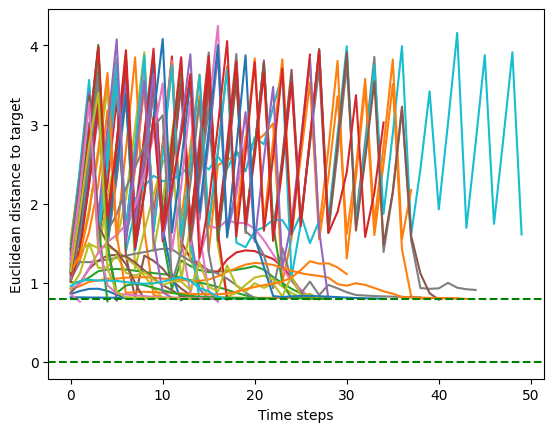

In [19]:
for i in range(50):
    plt.plot(euclids[i])
plt.axhline(y=0.8, color='g', linestyle='--')
plt.axhline(y=0, color='g', linestyle='--')
plt.plot()
plt.xlabel('Time steps')
plt.ylabel('Euclidean distance to target')
plt.show()